# Generate Unrecognizable Electrocardiogram (ECG) signals by Variational Autoencoder (VAE)
## Multi-Period Version

Ju-Hwan Kim (zzzz2605@kookmin.ac.kr)

# Libraries

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
import tqdm
import time
import sklearn
import imageio
import datetime
from IPython import display
from sklearn.manifold import TSNE

import wfdb

import torch
import torchsummary

In [2]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
torch.set_num_threads(3)
print(device)

plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size']   = 12
axisFontSize  = 14
titleFontSize = 20

cuda


# Parameters

In [3]:
dataName   = 'edb'
resultPath = './resultMulti'
dataPath   = './data'
intervalLen = 256
peakNum     = 3 # It must be odd (for generator).

epochs       = 2000
batchSize    = 200
learningRate = 1e-4
validRatio   = 0.1
classifierNodes  = [512, 512, 256, 256, 128, 128]
VAEnodes         = [1024, 1024, 1024, 1536, 1536, 1536]
KLDweight        = 1e-8

downloadData        = False
trainDiscriminator  = False
testPoisoningMethod = False
discriminatorPath  = './resultMulti/210205_153858/classifierWeight' # For load trained classifier

In [4]:
if dataName not in dict(wfdb.get_dbs()).keys():
    for i in range(100):
        print('[ERROR] Invalid data name!!')

Make the folder

In [5]:
def makeFolder(path, folderName):
    folders = path.split('/')
    path    = folders[0]
    for folder in folders[1:]:
        path += '/' + folder
        if not os.path.isdir(path):
            os.mkdir(path)
    
    folder = path + '/' + folderName
    if not os.path.isdir(folder):
        os.mkdir(folder)
    return folder

resultFolder = makeFolder(resultPath, datetime.datetime.now().strftime("%y%m%d_%H%M%S"))
dataFolder   = makeFolder(dataPath,   dataName)

Save the parameters

In [6]:
parametersFile = open(resultFolder + '/parameters.txt', 'w')

parametersFile.write('Data: {}\n'.format(dict(wfdb.get_dbs())[dataName]))
parametersFile.write('Length of peak interval: {}\n'.format(intervalLen))
parametersFile.write('Number of peaks: {}\n'.format(peakNum))
parametersFile.write('Epochs: {}\n'.format(epochs))
parametersFile.write('Batch size: {}\n'.format(batchSize))
parametersFile.write('Learning rate: {}\n'.format(learningRate))
parametersFile.write('Validation ratio: {}\n'.format(validRatio))
parametersFile.write('Classifier\'s Hidden nodes: {}\n'.format(classifierNodes))
parametersFile.write('VAE\'s        Hidden nodes: {}\n'.format(VAEnodes))
parametersFile.write('Weight of the KL-Divergence term: {}\n'.format(KLDweight))

parametersFile.close()

# Load the data

Download the data

In [7]:
if downloadData:
    print('Data name: {}'.format(dict(wfdb.get_dbs())[dataName]))
    wfdb.dl_database(dataName, dataFolder)

In [8]:
fileNames = wfdb.io.get_record_list(dataName)
redundants = ['e0119', 'e0121', 'e0122', 'e0124', 'e0125', 'e0126', 'e0133', 'e0139', 'e0148', 'e0155', 'e0163']
for redundant in redundants:
    if redundant not in fileNames:
        print(redundant)
    fileNames.remove(redundant)

In [9]:
data    = []
peaks   = []
dataNum = []
label   = []
halfLen = intervalLen // 2
currentLabel = 0
for fileName in tqdm.tqdm(fileNames):
    try:
        # Get the signal
        ECG  = wfdb.rdsamp(os.path.join(dataFolder, fileName))[0][:, 0]
        peak = np.array(wfdb.rdann(os.path.join(dataFolder, fileName), 'atr').sample)
        dataNum.append(len(peak))
        
        # Parsing the data
        ECGlen = len(ECG)
        for peakIndex in range(len(peak)):
            if 0 <= peak[peakIndex]-halfLen and peak[peakIndex]+halfLen+peakNum*intervalLen <= ECGlen and len(peak[peakIndex-1:peakIndex+peakNum]) == peakNum+1:
                data.append(ECG[peak[peakIndex]-halfLen : peak[peakIndex]+halfLen+peakNum*intervalLen])
                label.append(currentLabel)
                peaks.append(peak[peakIndex-1:peakIndex+peakNum])
        currentLabel += 1
    except Exception as e:
        print('Exception: File [{}] ({})'.format(fileName, e))

data  = np.array(data,  dtype=np.float32)
peaks = np.array(peaks, dtype=np.float32)
label = np.array(label, dtype=np.int)
print(data.shape)

100%|████████████████████████████████████████████████████████████████████████████████████████████████| 79/79 [00:23<00:00,  3.38it/s]


(704957, 1024)


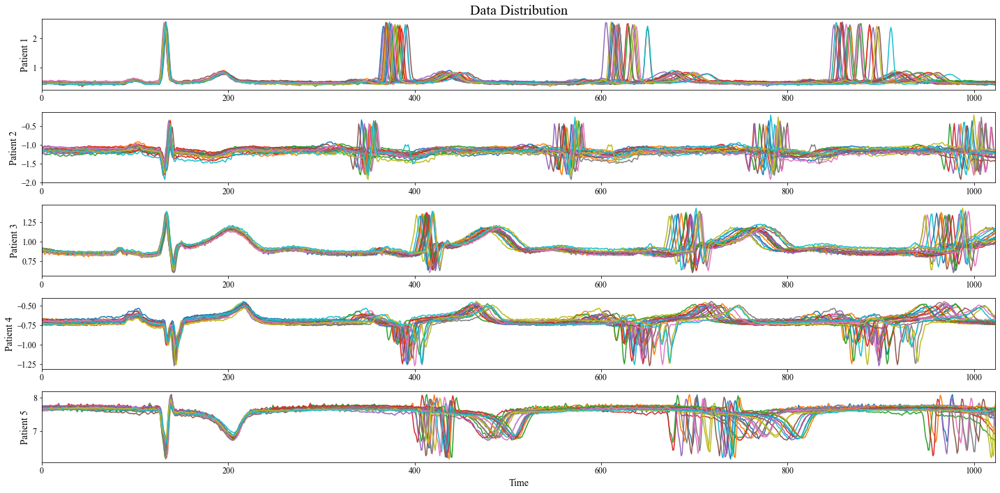

In [10]:
index = 0
plt.figure(figsize=(20, 10))
for i in range(5):
    plt.subplot(5, 1, i+1)
    plt.plot(data[index:index+20].T)
    plt.xlim(0, data.shape[1]-1)
    plt.ylabel('Patient {}'.format(i+1), fontsize=axisFontSize)
    index += dataNum[i]
    if i == 0:
        plt.title('Data Distribution', fontsize=titleFontSize)
plt.xlabel('Time', fontsize=axisFontSize)
plt.tight_layout()
plt.savefig(resultFolder + '/dataDistribution.png', dpi=200)
plt.show()

Normalize the data (data $\in \left[0, 1\right]$)

In [11]:
data = (data - data.min()) / (data.max() - data.min())

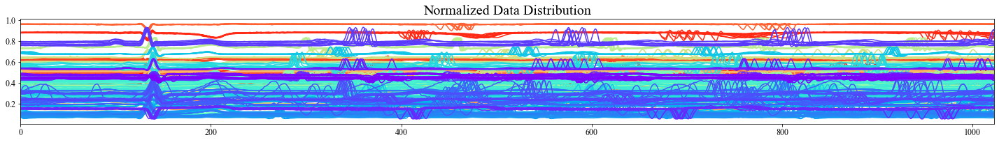

In [12]:
plt.figure(figsize=(20, 3))
currentIndex = 0
colorMap     = plt.cm.rainbow(np.linspace(1, 0, len(dataNum)))
for c, dnum in zip(colorMap, dataNum):
    plt.plot(data[currentIndex:currentIndex+10].T, c=c)
    currentIndex += dnum
plt.xlim(0, data.shape[1]-1)
plt.title('Normalized Data Distribution', fontsize=titleFontSize)

plt.tight_layout()
plt.savefig(resultFolder + '/normalizedDataDistribution.png', dpi=200)
plt.show()

Shuffle the data

In [13]:
data, label, peaks = sklearn.utils.shuffle(data, label, peaks)
if trainDiscriminator:
    validData,  trainData  = np.split(data,  [int(data.shape[0] * validRatio)])
    validLabel, trainLabel = np.split(label, [int(data.shape[0] * validRatio)])

# Classifier (MLP)

In [14]:
def HeInitialization(model):
    if type(model) == torch.nn.Conv1d:
        torch.nn.init.kaiming_uniform_(model.weight)
        model.bias.data.fill_(0.01)

In [15]:
class Classifier(torch.nn.Module):
    def __init__(self, hiddenNodes, inputDim, outputDim):
        super(Classifier, self).__init__()
        self.layers = []
        beforeNode = inputDim
        self.layers.append(torch.nn.BatchNorm1d(inputDim))
        for node in hiddenNodes:
            self.layers.append(torch.nn.Linear(in_features=beforeNode, out_features=node))
            self.layers.append(torch.nn.BatchNorm1d(node))
            self.layers.append(torch.nn.ReLU())
            beforeNode = node
        self.layers.append(torch.nn.Linear(in_features=beforeNode, out_features=outputDim))
        self.layers = torch.nn.Sequential(*self.layers)
        
    def forward(self, x):
        return self.layers(x)

In [16]:
if trainDiscriminator or testPoisoningMethod:
    classifier = Classifier(classifierNodes, data.shape[1], len(dataNum)).to(device)
    classifier.apply(HeInitialization)
    torchsummary.summary(classifier, (data.shape[1],), device=device)

In [17]:
class CustomDataset(torch.utils.data.Dataset): 
    def __init__(self, data, label, device=device):
        self.data  = torch.tensor(data,  dtype=torch.float).to(device)
        self.label = torch.tensor(label, dtype=torch.long).to(device)

    def __len__(self): 
        return len(self.data)
    
    def __getitem__(self, idx):
        return self.data[idx], self.label[idx]

In [18]:
if trainDiscriminator:
    trainDataset = CustomDataset(trainData, trainLabel)
    validDataset = CustomDataset(validData, validLabel)

    trainLoader  = torch.utils.data.DataLoader(trainDataset, batch_size=batchSize, shuffle=True)
    validLoader  = torch.utils.data.DataLoader(validDataset, batch_size=batchSize, shuffle=True)

In [19]:
criterion = torch.nn.CrossEntropyLoss()
def fit(model, optimizer, dataLoader, isTrain):
    if isTrain:
        model.train()
    else:
        model.eval()

    trainBatchNum = len(dataLoader)
    runningLoss   = 0.0
    runningAcc    = 0.0
    for batchIndex, data in enumerate(dataLoader):
        inputs, labels = data
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        if isTrain:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
        
        # calculate loss & correctness
        _, predicted = torch.max(outputs.data, 1)
        runningLoss += loss.item()
        runningAcc  += 100.0 * (predicted == labels).sum().item() / inputs.shape[0]
        if isTrain:
            print('{:5d} / {} - loss: {:4e} - acc: {:07.3f}'.format(batchIndex + 1, trainBatchNum, runningLoss / (batchIndex + 1), runningAcc / (batchIndex + 1)), end='\r', flush=True)

    loss = runningLoss / trainBatchNum
    acc  = runningAcc  / trainBatchNum
    if isTrain:
        print('{:5d} / {} - loss: {:4e} - acc: {:07.3f}'.format(trainBatchNum, trainBatchNum, loss, acc), end=' ')
    else:
        print('- val_loss: {:4e} - val_acc: {:07.3f}'.format(loss, acc), end=' ')
    
    return loss, acc

In [20]:
if trainDiscriminator:
    optimizer = torch.optim.Adam(classifier.parameters(), lr=learningRate)
    
    trainLosses     = []
    validLosses     = []
    trainAccuracies = []
    validAccuracies = []
    sumDuration = 0
    for epoch in range(1, epochs + 1):
        startTime = time.time()
        print('Epoch {:5d} / {}'.format(epoch, epochs))
        
        trainLoss, trainAcc  = fit(classifier, optimizer, trainLoader, True)
        validLoss, validAcc  = fit(classifier, optimizer, validLoader, False)
        trainLosses.append(trainLoss)
        validLosses.append(validLoss)
        trainAccuracies.append(trainAcc)
        validAccuracies.append(validAcc)
        if device == 'cuda':
            torch.cuda.empty_cache()
        
        endTime      = time.time()
        sumDuration += endTime - startTime
        remainSec    = int(sumDuration / epoch * (epochs - epoch))
        print('- Duration: {} sec - ETA: {} hour {} min {} sec'.format(int(endTime - startTime), remainSec // 3600, (remainSec % 3600) // 60, remainSec % 60))
        
    torch.save(classifier.state_dict(), resultFolder + '/classifierWeight')
elif testPoisoningMethod:
    classifier.load_state_dict(torch.load(discriminatorPath))

In [21]:
if trainDiscriminator:
    plt.figure(figsize=(11, 5))
    plt.subplot(1, 2, 1)
    plt.plot(trainLosses, label='train')
    plt.plot(validLosses, label='valid')
    plt.title('Loss',   fontsize=titleFontSize)
    plt.ylabel('Loss',  fontsize=axisFontSize)
    plt.xlabel('Epoch', fontsize=axisFontSize)
    plt.xlim(0, len(trainLosses)-1)
    plt.legend(fontsize=axisFontSize)
    
    plt.subplot(1, 2, 2)
    plt.plot(trainAccuracies, label='train')
    plt.plot(validAccuracies, label='valid')
    plt.title('Accuracy',  fontsize=titleFontSize)
    plt.ylabel('Accuracy', fontsize=axisFontSize)
    plt.xlabel('Epoch',    fontsize=axisFontSize)
    plt.xlim(0, len(trainAccuracies)-1)
    plt.ylim(0, 100)
    plt.legend(fontsize=axisFontSize)
    
    plt.tight_layout()
    plt.savefig(resultFolder + '/classifierTrainResults.png', dpi=200)
    plt.show()
    
    np.savetxt(resultFolder + '/classifierTrainLoss.txt',       trainLosses)
    np.savetxt(resultFolder + '/classifierValidLoss.txt',       validLosses)
    np.savetxt(resultFolder + '/classifierTrainAccuracies.txt', trainAccuracies)
    np.savetxt(resultFolder + '/classifierValidAccuracies.txt', validAccuracies)

## Test the classifier with poisoned data

In [22]:
def poisoningMethod2(data, poisoningStrength):
    poisonedData  = data.copy()
    for dataIndex in tqdm.tqdm(range(len(poisonedData))):
        poisonedData[dataIndex] += np.random.uniform(0, poisoningStrength)
    return poisonedData

In [23]:
def poisoningMethod3(data, peaks, poisoningStrength):
    poisonedData  = data.copy()
    unpoisonedNum = 0
    poisoningRegions = []
    poisoningLengths = []
    selectedPoints  = []
    for dataIndex in tqdm.tqdm(range(poisonedData.shape[0])):
        poisonedPeak = peaks[dataIndex].copy()
        currentData  = list(poisonedData[dataIndex])
        
        poisoned = True
        for p in range(peakNum):
            poisoningLength = np.random.randint(3, poisoningStrength) + 1
            
            poisoningStartPoint = (poisonedPeak[p]+poisonedPeak[p+1])//2 - poisonedPeak[1] + halfLen
            poisoningEndPoint   = poisoningStartPoint + (poisonedPeak[p+1]-poisonedPeak[p])//4 - poisoningLength
            if poisoningStartPoint >= poisoningEndPoint:
                poisoned = False
                continue
            if poisoningStartPoint < 0:
                poisoningStartPoint = 0
                poisoningEndPoint   = halfLen // 2
                
            poisoningPoint = np.random.randint(poisoningStartPoint, poisoningEndPoint)
            currentData    = currentData[:poisoningPoint] + currentData[poisoningPoint+poisoningLength:]
            poisonedPeak[p+1:] -= poisoningLength
            
            if dataIndex == 0:
                poisoningRegions.append([poisoningStartPoint, poisoningEndPoint+poisoningLength])
                poisoningLengths.append(poisoningLength)
                selectedPoints.append(poisoningPoint)
        if not poisoned:
            unpoisonedNum += 1
        poisonedData[dataIndex] = np.concatenate((currentData, currentData[-1] * np.ones(data.shape[1]-len(currentData))))  
        
        if dataIndex == 0:
            poisoningRegions = np.array(poisoningRegions)
            selectedPoints = np.array(selectedPoints)
            for i in range(1, len(poisoningLengths)):
                selectedPoints[i:]   += poisoningLengths[i]
                poisoningRegions[i:] += poisoningLengths[i]
                
            plt.figure(figsize=(10, 7))
            plt.subplot(3, 1, 1)
            plt.title('Poisonable Region', fontsize=titleFontSize)
            plt.plot(data[0])
            for poisoningRegion in poisoningRegions:
                plt.axvspan(poisoningRegion[0], poisoningRegion[1], color='blue', alpha=0.3, linewidth=0)
            plt.xlim(0, len(data[0])-1)
                
            plt.subplot(3, 1, 2)
            plt.title('Selected Region', fontsize=titleFontSize)
            plt.plot(data[0])
            for selectedPoint, poisoningLength in zip(selectedPoints, poisoningLengths):
                plt.axvspan(selectedPoint, selectedPoint+poisoningLength, color='red', alpha=0.3, linewidth=0.1)
            plt.xlim(0, len(data[0])-1)
            
            plt.subplot(3, 1, 3)
            plt.title('Poisoned Result', fontsize=titleFontSize)
            plt.plot(poisonedData[0])
            plt.xlim(0, len(data[0])-1)
                
            plt.tight_layout()
            plt.show()
    
    print('Unpoisoned Ratio: {}%'.format(100 * unpoisonedNum / poisonedData.shape[0]))
    return poisonedData

In [24]:
if testPoisoningMethod:
    for poisoningVersion in range(3):
        testNum    = 20
        losses     = []
        accuracies = []
        
        fp = open(resultFolder + '/poisonedDataResult_version{}.txt'.format(poisoningVersion), 'w')
        optimizer = torch.optim.Adam(classifier.parameters(), lr=learningRate)
        
        if poisoningVersion == 0:
            poisoningStrengthRange = range(5, 25+1, 5)
        elif poisoningVersion == 1:
            poisoningStrengthRange = range(5)
        elif poisoningVersion == 2: # Combination
            poisoningStrengthRange = range(5)
            
        for poisoningStrength in poisoningStrengthRange:
            print(   'Number of poisoned point: {}  '.format(poisoningStrength))
            fp.write('Number of poisoned point: {}\n'.format(poisoningStrength))
            data, label, peaks = sklearn.utils.shuffle(data, label, peaks)
            
            if poisoningVersion == 0:
                poisonedData = poisoningMethod3(data, peaks, poisoningStrength)
            elif poisoningVersion == 1:
                poisonedData = poisoningMethod2(data, poisoningStrength)
            elif poisoningVersion == 2:
                poisonedData = poisoningMethod2(data, poisoningStrength)
                poisonedData = poisoningMethod3(poisonedData, peaks, 20)
                
            poisonedDataset    = CustomDataset(poisonedData, label)
            poisonedDataLoader = torch.utils.data.DataLoader(poisonedDataset, batch_size=batchSize, shuffle=False)
            
            loss, accuracy = fit(classifier, optimizer, poisonedDataLoader, False)
            
            losses.append(loss)
            accuracies.append(accuracy)
            print()
            fp.write('loss:     {}\n'.format(loss))
            fp.write('accuracy: {}\n'.format(accuracy))
        
            classifier.eval()
            with torch.no_grad():
                testInputs   = torch.tensor(poisonedData[:testNum], dtype=torch.float).to(device)
                outputs      = classifier(testInputs)
                _, predicted = torch.max(outputs.data, 1)
                predicted    = predicted.to('cpu').numpy()
            
            print('predicted:   {}'.format(predicted))
            print('Truth:       {}'.format(label[:testNum]))
            print('Correctness: {}'.format(np.array(predicted == label[:testNum], dtype=np.int8)))
            fp.write('predicted:   {}\n'.format(predicted))
            fp.write('Truth:       {}\n'.format(label[:testNum]))
            fp.write('Correctness: {}\n'.format(np.array(predicted == label[:testNum], dtype=np.int8)))
            print()
            
            plt.figure(figsize=(20, 7))
            plt.subplot(2, 1, 1)
            plt.plot(data[:50].T)
            plt.xlim(0, len(data[0])-1)
            plt.title('Original Data', fontsize=titleFontSize)
            
            plt.subplot(2, 1, 2)
            plt.plot(poisonedData[:50].T)
            plt.xlim(0, len(poisonedData[0])-1)
            plt.title('Poisoned Data', fontsize=titleFontSize)
            
            plt.tight_layout()
            plt.show()
        
            del poisonedDataset, poisonedDataLoader, poisonedData; torch.cuda.empty_cache()
            
        fp.close()
        
        plt.figure(figsize=(11, 5))
        plt.subplot(1, 2, 1)
        plt.plot(range(5, 25+1, 5), losses)
        plt.title('Loss',   fontsize=titleFontSize)
        plt.ylabel('Loss',  fontsize=axisFontSize)
        plt.xlabel('Poisoning Strength', fontsize=axisFontSize)
        plt.xlim(5, 25)
        
        plt.subplot(1, 2, 2)
        plt.plot(range(5, 25+1, 5), accuracies)
        plt.title('Accuracy',  fontsize=titleFontSize)
        plt.ylabel('Accuracy', fontsize=axisFontSize)
        plt.xlabel('Poisoning Strength', fontsize=axisFontSize)
        plt.xlim(5, 25)
        plt.ylim(0, 100)
        
        plt.tight_layout()
        plt.savefig(resultFolder + '/poisoningResults.png', dpi=200)
        plt.show()

  0%|                                                                                                     | 0/704957 [00:00<?, ?it/s]

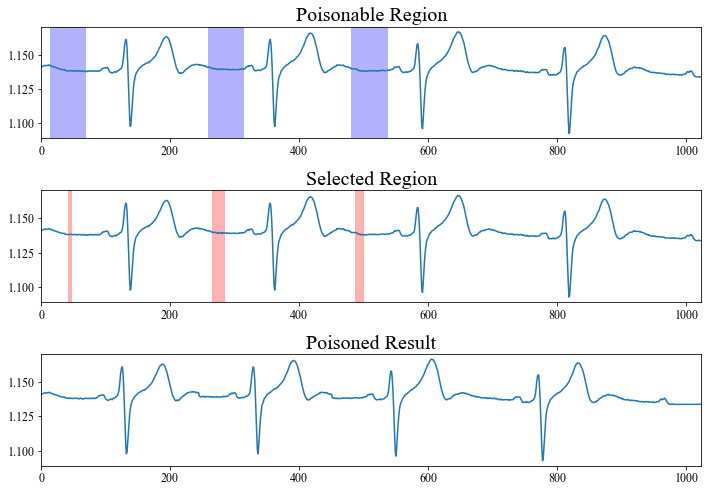

100%|██████████████████████████████████████████████████████████████████████████████████████| 704957/704957 [03:04<00:00, 3815.00it/s]

Unpoisoned Ratio: 1.1037552645054947%


In [25]:
poisonedData = poisoningMethod2(data, 1)
poisonedData = poisoningMethod3(poisonedData, peaks, 20)

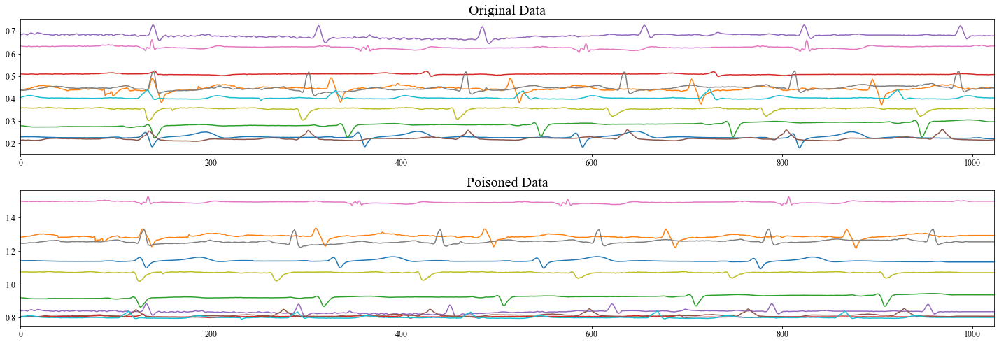

In [26]:
plt.figure(figsize=(20, 7))
plt.subplot(2, 1, 1)
plt.plot(data[:10].T)
plt.xlim(0, data.shape[1]-1)
plt.title('Original Data', fontsize=titleFontSize)

plt.subplot(2, 1, 2)
plt.plot(poisonedData[:10].T)
plt.xlim(0, poisonedData.shape[1]-1)
plt.title('Poisoned Data', fontsize=titleFontSize)

plt.tight_layout()
plt.savefig(resultFolder + '/originVsPoisoned.png', dpi=200)
plt.show()

In [27]:
# Normalization
poisonedData = (poisonedData - poisonedData.min()) / (poisonedData.max() - poisonedData.min())

# Generator (VAE)

In [28]:
class Generator(torch.nn.Module):
    def __init__(self, hiddenNodes, inputDim):
        super(Generator, self).__init__()
        
        self.hiddenNodes = hiddenNodes.copy()
        self.inputDim    = inputDim
        self.zDim = hiddenNodes[-1]
        
        ###########################
        ######### Encoder #########
        ###########################
        self.encoder = []
        self.encoder.append(torch.nn.Linear(in_features=self.inputDim, out_features=self.hiddenNodes[0]))
        for index in range(len(self.hiddenNodes) - 1):
            self.encoder.append(torch.nn.Linear(in_features=self.hiddenNodes[index], out_features=self.hiddenNodes[index+1]))
            self.encoder.append(torch.nn.BatchNorm1d(self.hiddenNodes[index+1]))
            self.encoder.append(torch.nn.LeakyReLU())
        self.encoder = torch.nn.Sequential(*self.encoder)
        
        self.meanFC   = torch.nn.Linear(in_features=self.hiddenNodes[-1], out_features=self.zDim)
        self.logStdFC = torch.nn.Linear(in_features=self.hiddenNodes[-1], out_features=self.zDim)
        
        ###########################
        ######### Decoder #########
        ###########################
        self.decoder = []
        self.hiddenNodes.reverse()
        for index in range(len(self.hiddenNodes) - 1):
            self.decoder.append(torch.nn.Linear(in_features=self.hiddenNodes[index], out_features=self.hiddenNodes[index+1]))
            self.decoder.append(torch.nn.BatchNorm1d(self.hiddenNodes[index+1]))
            self.decoder.append(torch.nn.LeakyReLU())
        self.decoder.append(torch.nn.Linear(in_features=self.hiddenNodes[-1], out_features=self.inputDim))
        self.decoder.append(torch.nn.Sigmoid())
        self.decoder = torch.nn.Sequential(*self.decoder)
        
    def encode(self, x):
        latentVector = self.encoder(x)
        return self.meanFC(latentVector), self.logStdFC(latentVector)
    
    def reparameterize(self, mean, logVar):
        std = torch.exp(0.5 * logVar)
        eps = torch.randn_like(std)
        return mean + eps * std
    
    def decode(self, z):
        return self.decoder(z)
        
    def forward(self, x):   
        mean, logVar = self.encode(x)
        z = self.reparameterize(mean, logVar)
        return self.decode(z), mean, logVar

In [29]:
vae = Generator(VAEnodes, poisonedData.shape[1]).to(device)
vae.apply(HeInitialization)
torchsummary.summary(vae, (poisonedData.shape[1],), device=device)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Linear-1                 [-1, 1024]       1,049,600
            Linear-2                 [-1, 1024]       1,049,600
       BatchNorm1d-3                 [-1, 1024]           2,048
         LeakyReLU-4                 [-1, 1024]               0
            Linear-5                 [-1, 1024]       1,049,600
       BatchNorm1d-6                 [-1, 1024]           2,048
         LeakyReLU-7                 [-1, 1024]               0
            Linear-8                 [-1, 1536]       1,574,400
       BatchNorm1d-9                 [-1, 1536]           3,072
        LeakyReLU-10                 [-1, 1536]               0
           Linear-11                 [-1, 1536]       2,360,832
      BatchNorm1d-12                 [-1, 1536]           3,072
        LeakyReLU-13                 [-1, 1536]               0
           Linear-14                 [-

In [30]:
class CustomDataset(torch.utils.data.Dataset): 
    def __init__(self, data):
        self.data = torch.tensor(data, dtype=torch.float).to(device)

    def __len__(self): 
        return len(self.data)
    
    def __getitem__(self, idx):
        return self.data[idx]

In [31]:
trainDataset = CustomDataset(poisonedData)
trainLoader  = torch.utils.data.DataLoader(trainDataset, batch_size=batchSize, shuffle=True)

In [32]:
def vaeLoss(reconstruct, data, mean, logVar):
    #BCE = torch.nn.functional.binary_cross_entropy(reconstruct, data)
    BCE = torch.nn.functional.mse_loss(reconstruct, data)
    KLD = -0.5 * torch.mean(torch.sum(1 + logVar - mean.pow(2) - logVar.exp(), dim=1))
    return BCE + KLDweight * KLD

In [33]:
def fit(model, optimizer, dataLoader, isTrain):
    if isTrain:
        model.train()
    else:
        model.eval()

    trainBatchNum = len(dataLoader)
    runningLoss = 0.0
    for batchIndex, data in enumerate(dataLoader):
        reconstruct, mean, logVar = model(data)
        loss = vaeLoss(reconstruct, data, mean, logVar)
        if isTrain:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
        
        # calculate loss & correctness
        runningLoss += loss.item()
        if isTrain:
            print('{:5d} / {} - loss: {:5e}'.format(batchIndex + 1, trainBatchNum, runningLoss / (batchIndex + 1)), end='\r', flush=True)

    loss = runningLoss / trainBatchNum
    if isTrain:
        print('{:5d} / {} - loss: {:5e}'.format(trainBatchNum, trainBatchNum, loss), end=' ')
    else:
        print('- val_loss: {:5e}'.format(loss), end=' ')
    
    return loss

In [34]:
def drawResult(vae, fileName='', rowNum=5, colNum=5):
    vae.eval()
    with torch.no_grad():
        zSample = torch.randn(rowNum * colNum, vae.zDim).to(device)
        xDecoded = vae.decode(zSample).squeeze().to('cpu').numpy()
        
    #minimum = np.min(xDecoded)
    #maximum = np.max(xDecoded)
    plt.figure(figsize=(10, 10))
    for i in range(rowNum*colNum):
        plt.subplot(rowNum, colNum, i+1)
        plt.plot(xDecoded[i])
        plt.xlim(0, len(xDecoded[i])-1)
        #plt.ylim(minimum, maximum)
    plt.tight_layout()
    plt.savefig(resultFolder + '/generatedECG_{}.png'.format(fileName))
    plt.show()

Epoch     1 / 2000
 3525 / 3525 - loss: 4.585735e-04 - Duration: 88 sec - ETA: 48 hour 56 min 45 sec
Epoch     2 / 2000
 3525 / 3525 - loss: 3.317477e-04 - Duration: 88 sec - ETA: 48 hour 57 min 1 sec
Epoch     3 / 2000
 3525 / 3525 - loss: 3.131612e-04 - Duration: 83 sec - ETA: 48 hour 5 min 12 sec
Epoch     4 / 2000
 3525 / 3525 - loss: 2.936654e-04 - Duration: 82 sec - ETA: 47 hour 30 min 48 sec
Epoch     5 / 2000
 3525 / 3525 - loss: 2.821373e-04 - Duration: 82 sec - ETA: 47 hour 9 min 5 sec
Epoch     6 / 2000
 3525 / 3525 - loss: 2.672933e-04 - Duration: 82 sec - ETA: 46 hour 54 min 2 sec
Epoch     7 / 2000
 3525 / 3525 - loss: 2.666680e-04 - Duration: 82 sec - ETA: 46 hour 43 min 48 sec
Epoch     8 / 2000
 3525 / 3525 - loss: 2.631473e-04 - Duration: 82 sec - ETA: 46 hour 34 min 58 sec
Epoch     9 / 2000
 3525 / 3525 - loss: 2.582421e-04 - Duration: 82 sec - ETA: 46 hour 27 min 40 sec
Epoch    10 / 2000
 3525 / 3525 - loss: 2.580064e-04 - Duration: 82 sec - ETA: 46 hour 21 min 41

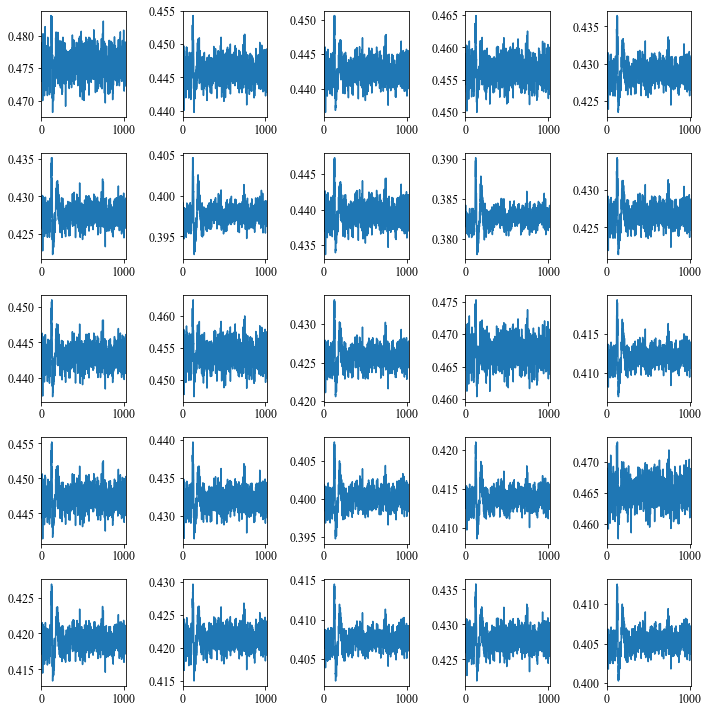

Epoch    11 / 2000
 3525 / 3525 - loss: 2.545716e-04 - Duration: 82 sec - ETA: 46 hour 17 min 2 sec
Epoch    12 / 2000
 3525 / 3525 - loss: 2.489921e-04 - Duration: 82 sec - ETA: 46 hour 12 min 45 sec
Epoch    13 / 2000
 3525 / 3525 - loss: 2.454537e-04 - Duration: 82 sec - ETA: 46 hour 9 min 23 sec
Epoch    14 / 2000
 3525 / 3525 - loss: 2.485711e-04 - Duration: 82 sec - ETA: 46 hour 5 min 49 sec
Epoch    15 / 2000
 3525 / 3525 - loss: 2.512988e-04 - Duration: 82 sec - ETA: 46 hour 2 min 33 sec
Epoch    16 / 2000
 3525 / 3525 - loss: 2.370289e-04 - Duration: 82 sec - ETA: 45 hour 59 min 26 sec
Epoch    17 / 2000
 3525 / 3525 - loss: 2.409003e-04 - Duration: 82 sec - ETA: 45 hour 56 min 34 sec
Epoch    18 / 2000
 3525 / 3525 - loss: 2.411292e-04 - Duration: 82 sec - ETA: 45 hour 54 min 23 sec
Epoch    19 / 2000
 3525 / 3525 - loss: 2.459578e-04 - Duration: 82 sec - ETA: 45 hour 51 min 48 sec
Epoch    20 / 2000
 3525 / 3525 - loss: 2.371614e-04 - Duration: 82 sec - ETA: 45 hour 49 min 2

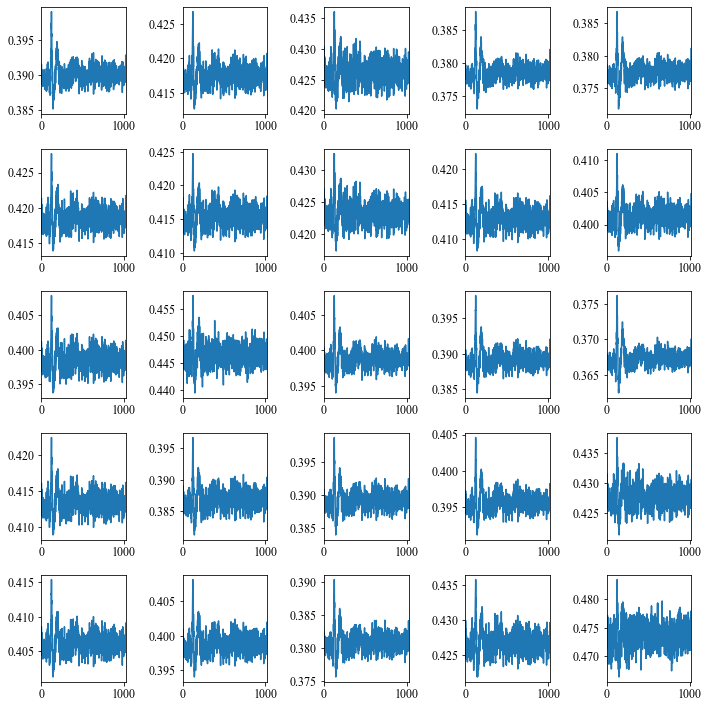

Epoch    21 / 2000
 3525 / 3525 - loss: 2.316758e-04 - Duration: 82 sec - ETA: 45 hour 47 min 0 sec
Epoch    22 / 2000
 3525 / 3525 - loss: 2.339836e-04 - Duration: 82 sec - ETA: 45 hour 44 min 35 sec
Epoch    23 / 2000
 3525 / 3525 - loss: 2.334018e-04 - Duration: 82 sec - ETA: 45 hour 42 min 16 sec
Epoch    24 / 2000
 3525 / 3525 - loss: 2.361748e-04 - Duration: 82 sec - ETA: 45 hour 40 min 6 sec
Epoch    25 / 2000
 3525 / 3525 - loss: 2.307849e-04 - Duration: 82 sec - ETA: 45 hour 37 min 58 sec
Epoch    26 / 2000
 3525 / 3525 - loss: 2.359605e-04 - Duration: 82 sec - ETA: 45 hour 35 min 50 sec
Epoch    27 / 2000
 3525 / 3525 - loss: 2.333119e-04 - Duration: 82 sec - ETA: 45 hour 33 min 45 sec
Epoch    28 / 2000
 3525 / 3525 - loss: 2.275562e-04 - Duration: 82 sec - ETA: 45 hour 31 min 41 sec
Epoch    29 / 2000
 3525 / 3525 - loss: 2.265033e-04 - Duration: 82 sec - ETA: 45 hour 29 min 45 sec
Epoch    30 / 2000
 3525 / 3525 - loss: 2.338025e-04 - Duration: 82 sec - ETA: 45 hour 27 min

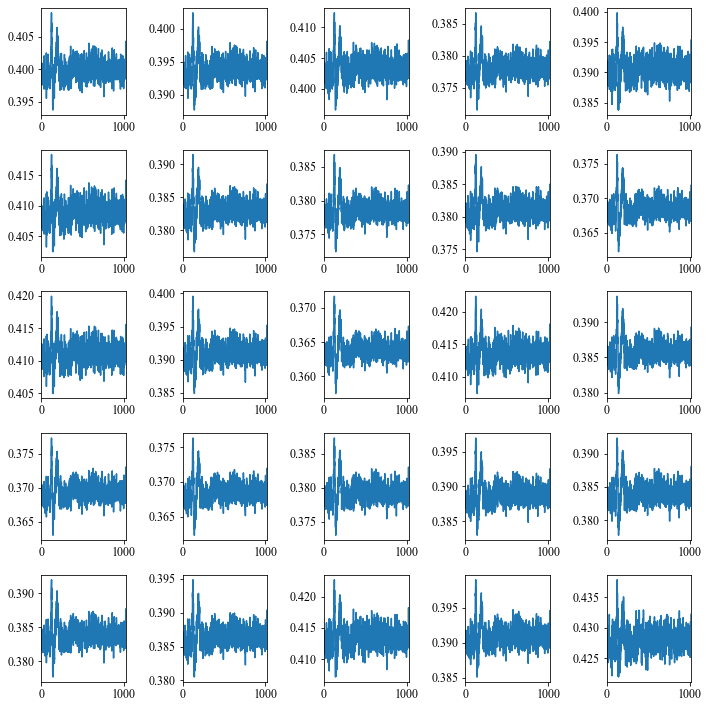

Epoch    31 / 2000
 3525 / 3525 - loss: 2.330001e-04 - Duration: 82 sec - ETA: 45 hour 25 min 45 sec
Epoch    32 / 2000
 3525 / 3525 - loss: 2.316858e-04 - Duration: 82 sec - ETA: 45 hour 23 min 54 sec
Epoch    33 / 2000
 3525 / 3525 - loss: 2.341458e-04 - Duration: 82 sec - ETA: 45 hour 22 min 6 sec
Epoch    34 / 2000
 3525 / 3525 - loss: 2.293556e-04 - Duration: 82 sec - ETA: 45 hour 20 min 20 sec
Epoch    35 / 2000
 3525 / 3525 - loss: 2.227777e-04 - Duration: 82 sec - ETA: 45 hour 18 min 44 sec
Epoch    36 / 2000
 3525 / 3525 - loss: 2.341849e-04 - Duration: 82 sec - ETA: 45 hour 17 min 1 sec
Epoch    37 / 2000
 3525 / 3525 - loss: 2.298984e-04 - Duration: 82 sec - ETA: 45 hour 15 min 15 sec
Epoch    38 / 2000
 3525 / 3525 - loss: 2.238103e-04 - Duration: 82 sec - ETA: 45 hour 13 min 30 sec
Epoch    39 / 2000
 3525 / 3525 - loss: 2.253695e-04 - Duration: 82 sec - ETA: 45 hour 11 min 43 sec
Epoch    40 / 2000
 3525 / 3525 - loss: 2.306322e-04 - Duration: 82 sec - ETA: 45 hour 10 min

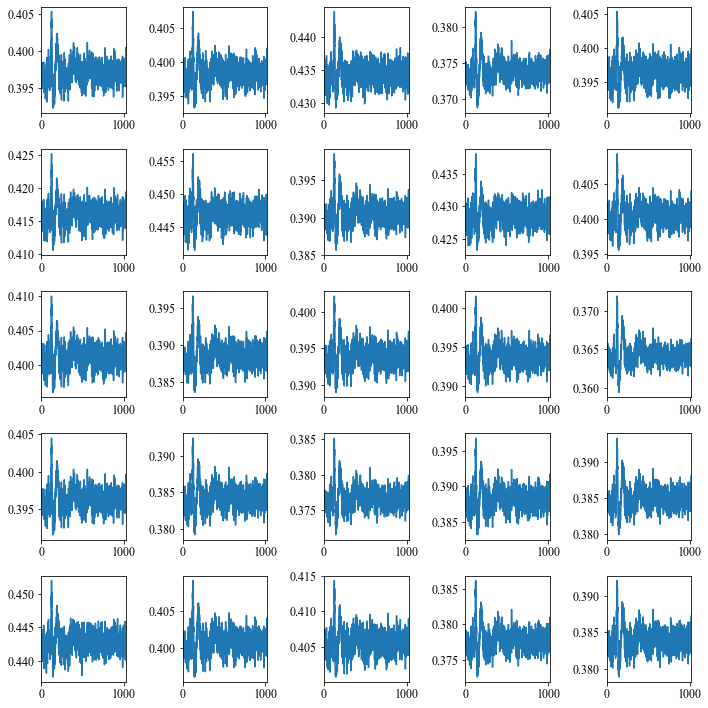

Epoch    41 / 2000
 3525 / 3525 - loss: 2.243513e-04 - Duration: 82 sec - ETA: 45 hour 8 min 27 sec
Epoch    42 / 2000
 3525 / 3525 - loss: 2.291340e-04 - Duration: 82 sec - ETA: 45 hour 6 min 46 sec
Epoch    43 / 2000
 3525 / 3525 - loss: 2.229138e-04 - Duration: 82 sec - ETA: 45 hour 5 min 6 sec
Epoch    44 / 2000
 3525 / 3525 - loss: 2.257255e-04 - Duration: 82 sec - ETA: 45 hour 3 min 26 sec
Epoch    45 / 2000
 3525 / 3525 - loss: 2.207338e-04 - Duration: 82 sec - ETA: 45 hour 1 min 47 sec
Epoch    46 / 2000
 3525 / 3525 - loss: 2.224809e-04 - Duration: 82 sec - ETA: 45 hour 0 min 12 sec
Epoch    47 / 2000
 3525 / 3525 - loss: 2.221020e-04 - Duration: 82 sec - ETA: 44 hour 58 min 35 sec
Epoch    48 / 2000
 3525 / 3525 - loss: 2.198572e-04 - Duration: 82 sec - ETA: 44 hour 56 min 59 sec
Epoch    49 / 2000
 3525 / 3525 - loss: 2.200333e-04 - Duration: 82 sec - ETA: 44 hour 55 min 24 sec
Epoch    50 / 2000
 3525 / 3525 - loss: 2.170904e-04 - Duration: 82 sec - ETA: 44 hour 53 min 48 s

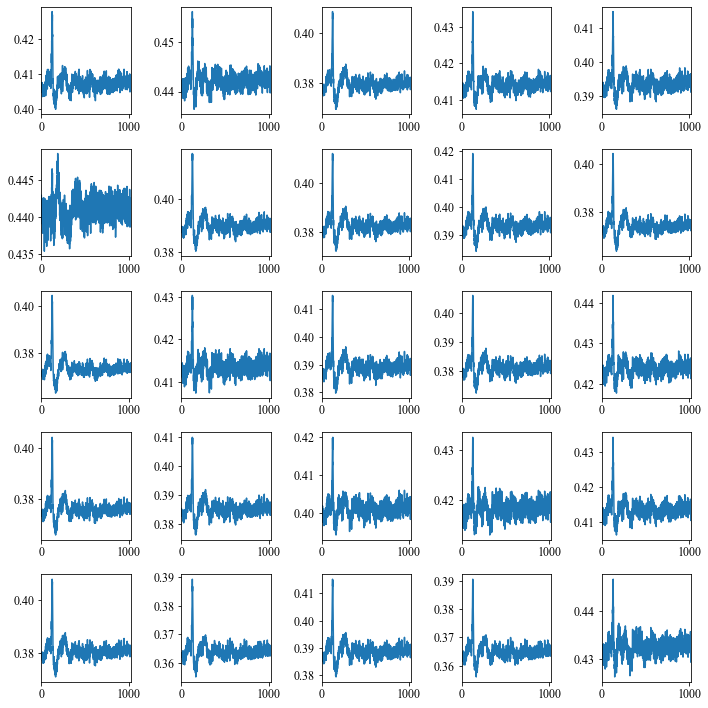

Epoch    51 / 2000
 3525 / 3525 - loss: 2.253723e-04 - Duration: 82 sec - ETA: 44 hour 52 min 13 sec
Epoch    52 / 2000
 3525 / 3525 - loss: 2.175333e-04 - Duration: 82 sec - ETA: 44 hour 50 min 38 sec
Epoch    53 / 2000
 3525 / 3525 - loss: 2.168091e-04 - Duration: 82 sec - ETA: 44 hour 49 min 2 sec
Epoch    54 / 2000
 3525 / 3525 - loss: 2.134620e-04 - Duration: 82 sec - ETA: 44 hour 47 min 32 sec
Epoch    55 / 2000
 3525 / 3525 - loss: 2.172844e-04 - Duration: 82 sec - ETA: 44 hour 46 min 0 sec
Epoch    56 / 2000
 3525 / 3525 - loss: 2.172966e-04 - Duration: 82 sec - ETA: 44 hour 44 min 31 sec
Epoch    57 / 2000
 3525 / 3525 - loss: 2.176868e-04 - Duration: 82 sec - ETA: 44 hour 42 min 57 sec
Epoch    58 / 2000
 3525 / 3525 - loss: 2.147011e-04 - Duration: 82 sec - ETA: 44 hour 41 min 24 sec
Epoch    59 / 2000
 3525 / 3525 - loss: 2.171454e-04 - Duration: 82 sec - ETA: 44 hour 39 min 52 sec
Epoch    60 / 2000
 3525 / 3525 - loss: 2.146599e-04 - Duration: 82 sec - ETA: 44 hour 38 min

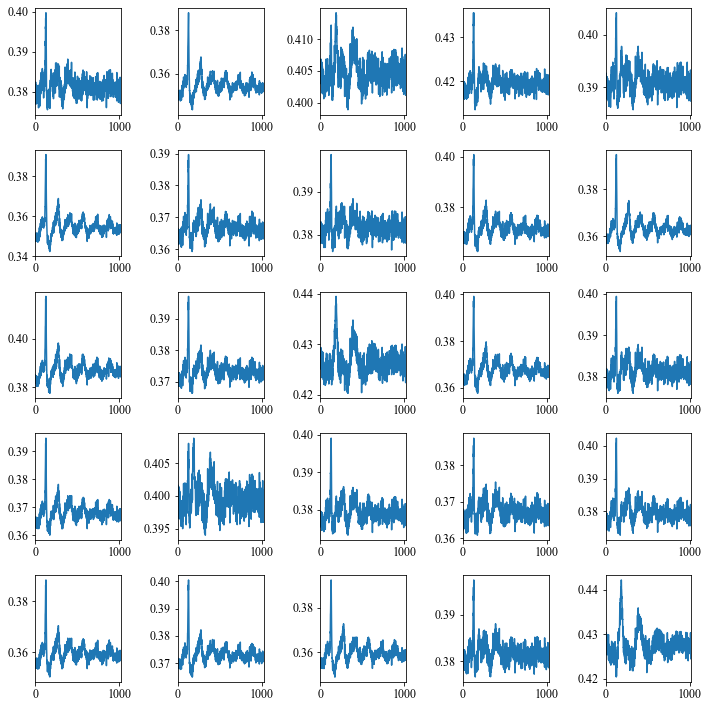

Epoch    61 / 2000
 3525 / 3525 - loss: 2.185044e-04 - Duration: 82 sec - ETA: 44 hour 36 min 53 sec
Epoch    62 / 2000
 3525 / 3525 - loss: 2.219186e-04 - Duration: 82 sec - ETA: 44 hour 35 min 22 sec
Epoch    63 / 2000
 3525 / 3525 - loss: 2.184118e-04 - Duration: 82 sec - ETA: 44 hour 33 min 52 sec
Epoch    64 / 2000
 3525 / 3525 - loss: 2.146057e-04 - Duration: 82 sec - ETA: 44 hour 32 min 24 sec
Epoch    65 / 2000
 3525 / 3525 - loss: 2.171673e-04 - Duration: 82 sec - ETA: 44 hour 30 min 54 sec
Epoch    66 / 2000
 3525 / 3525 - loss: 2.179917e-04 - Duration: 82 sec - ETA: 44 hour 29 min 25 sec
Epoch    67 / 2000
 3525 / 3525 - loss: 2.136090e-04 - Duration: 82 sec - ETA: 44 hour 28 min 1 sec
Epoch    68 / 2000
 3525 / 3525 - loss: 2.194493e-04 - Duration: 82 sec - ETA: 44 hour 26 min 32 sec
Epoch    69 / 2000
 3525 / 3525 - loss: 2.199641e-04 - Duration: 82 sec - ETA: 44 hour 25 min 3 sec
Epoch    70 / 2000
 3525 / 3525 - loss: 2.146485e-04 - Duration: 82 sec - ETA: 44 hour 23 min

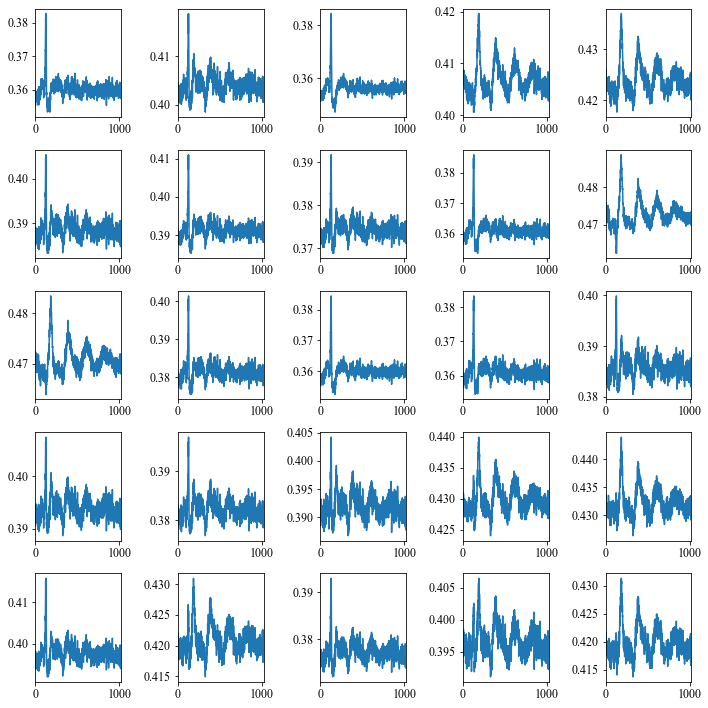

Epoch    71 / 2000
 3525 / 3525 - loss: 2.145655e-04 - Duration: 82 sec - ETA: 44 hour 22 min 5 sec
Epoch    72 / 2000
 3525 / 3525 - loss: 2.130646e-04 - Duration: 82 sec - ETA: 44 hour 20 min 41 sec
Epoch    73 / 2000
 3525 / 3525 - loss: 2.220506e-04 - Duration: 82 sec - ETA: 44 hour 19 min 18 sec
Epoch    74 / 2000
 3525 / 3525 - loss: 2.215434e-04 - Duration: 82 sec - ETA: 44 hour 17 min 52 sec
Epoch    75 / 2000
 3525 / 3525 - loss: 2.174783e-04 - Duration: 82 sec - ETA: 44 hour 16 min 23 sec
Epoch    76 / 2000
 3525 / 3525 - loss: 2.128601e-04 - Duration: 82 sec - ETA: 44 hour 14 min 58 sec
Epoch    77 / 2000
 3525 / 3525 - loss: 2.111231e-04 - Duration: 82 sec - ETA: 44 hour 13 min 32 sec
Epoch    78 / 2000
 3525 / 3525 - loss: 2.129685e-04 - Duration: 82 sec - ETA: 44 hour 12 min 8 sec
Epoch    79 / 2000
 3525 / 3525 - loss: 2.137276e-04 - Duration: 82 sec - ETA: 44 hour 10 min 42 sec
Epoch    80 / 2000
 3525 / 3525 - loss: 2.101114e-04 - Duration: 82 sec - ETA: 44 hour 9 min 

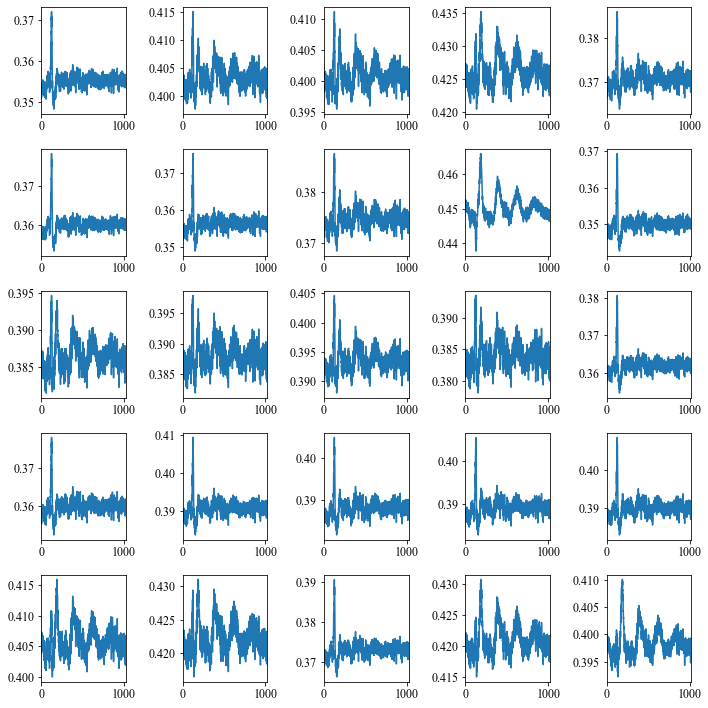

Epoch    81 / 2000
 3525 / 3525 - loss: 2.188474e-04 - Duration: 82 sec - ETA: 44 hour 7 min 50 sec
Epoch    82 / 2000
 3525 / 3525 - loss: 2.096832e-04 - Duration: 82 sec - ETA: 44 hour 6 min 22 sec
Epoch    83 / 2000
 3525 / 3525 - loss: 2.093563e-04 - Duration: 82 sec - ETA: 44 hour 4 min 57 sec
Epoch    84 / 2000
 3525 / 3525 - loss: 2.106756e-04 - Duration: 82 sec - ETA: 44 hour 3 min 29 sec
Epoch    85 / 2000
 3525 / 3525 - loss: 2.165424e-04 - Duration: 82 sec - ETA: 44 hour 2 min 2 sec
Epoch    86 / 2000
 3525 / 3525 - loss: 2.108053e-04 - Duration: 82 sec - ETA: 44 hour 0 min 35 sec
Epoch    87 / 2000
 3525 / 3525 - loss: 2.130074e-04 - Duration: 82 sec - ETA: 43 hour 59 min 11 sec
Epoch    88 / 2000
 3525 / 3525 - loss: 2.141705e-04 - Duration: 82 sec - ETA: 43 hour 57 min 45 sec
Epoch    89 / 2000
 3525 / 3525 - loss: 2.142364e-04 - Duration: 82 sec - ETA: 43 hour 56 min 24 sec
Epoch    90 / 2000
 3525 / 3525 - loss: 2.178179e-04 - Duration: 82 sec - ETA: 43 hour 54 min 57 s

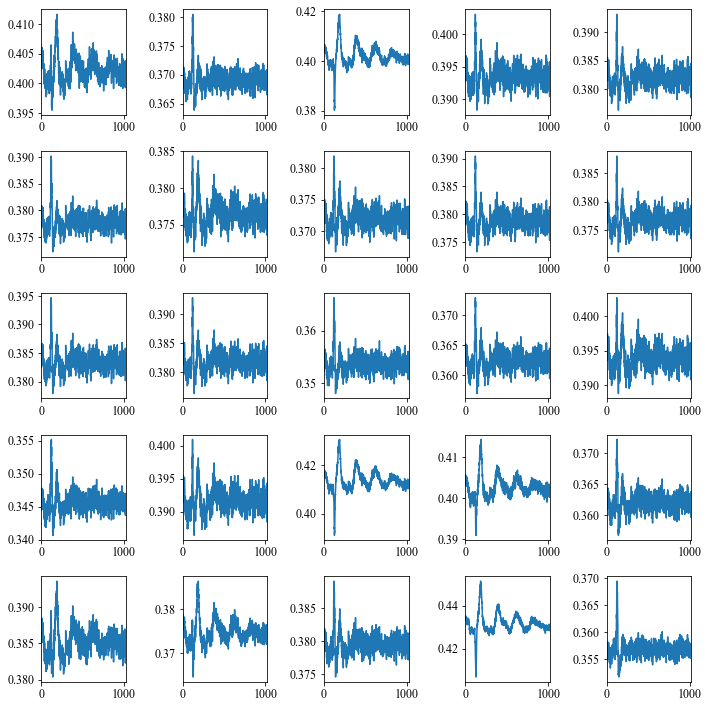

Epoch    91 / 2000
 3525 / 3525 - loss: 2.123227e-04 - Duration: 82 sec - ETA: 43 hour 53 min 31 sec
Epoch    92 / 2000
 3525 / 3525 - loss: 2.148659e-04 - Duration: 82 sec - ETA: 43 hour 52 min 5 sec
Epoch    93 / 2000
 3525 / 3525 - loss: 2.123395e-04 - Duration: 82 sec - ETA: 43 hour 50 min 38 sec
Epoch    94 / 2000
 3525 / 3525 - loss: 2.110492e-04 - Duration: 82 sec - ETA: 43 hour 49 min 12 sec
Epoch    95 / 2000
 3525 / 3525 - loss: 2.093777e-04 - Duration: 82 sec - ETA: 43 hour 47 min 46 sec
Epoch    96 / 2000
 3525 / 3525 - loss: 2.062345e-04 - Duration: 82 sec - ETA: 43 hour 46 min 21 sec
Epoch    97 / 2000
 3525 / 3525 - loss: 2.075750e-04 - Duration: 82 sec - ETA: 43 hour 44 min 55 sec
Epoch    98 / 2000
 3525 / 3525 - loss: 2.069873e-04 - Duration: 82 sec - ETA: 43 hour 43 min 29 sec
Epoch    99 / 2000
 3525 / 3525 - loss: 2.094390e-04 - Duration: 82 sec - ETA: 43 hour 42 min 4 sec
Epoch   100 / 2000
 3525 / 3525 - loss: 2.081608e-04 - Duration: 82 sec - ETA: 43 hour 40 min

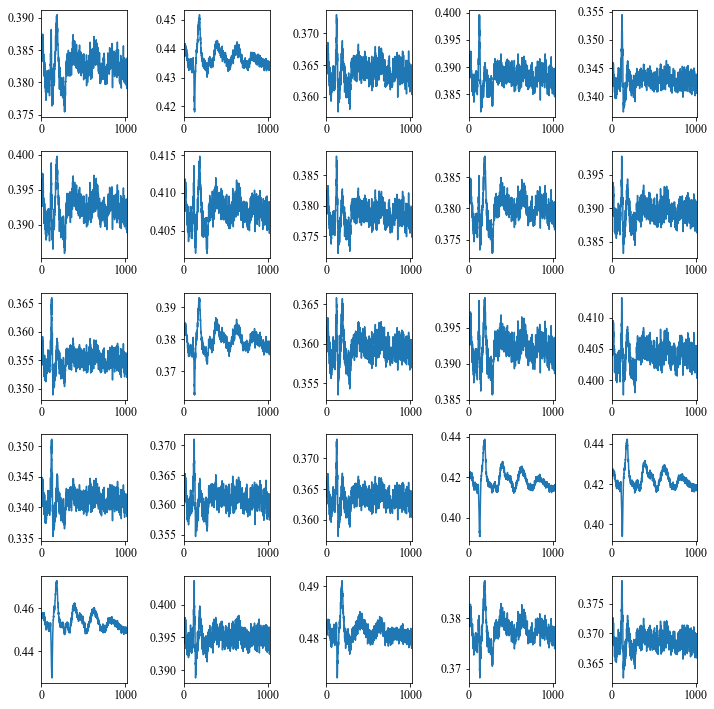

Epoch   101 / 2000
 3525 / 3525 - loss: 2.117253e-04 - Duration: 82 sec - ETA: 43 hour 39 min 15 sec
Epoch   102 / 2000
 3525 / 3525 - loss: 2.068225e-04 - Duration: 82 sec - ETA: 43 hour 37 min 50 sec
Epoch   103 / 2000
 3525 / 3525 - loss: 2.098564e-04 - Duration: 82 sec - ETA: 43 hour 36 min 25 sec
Epoch   104 / 2000
 3525 / 3525 - loss: 2.135237e-04 - Duration: 82 sec - ETA: 43 hour 34 min 59 sec
Epoch   105 / 2000
 3525 / 3525 - loss: 2.071365e-04 - Duration: 82 sec - ETA: 43 hour 33 min 34 sec
Epoch   106 / 2000
 3525 / 3525 - loss: 2.065834e-04 - Duration: 82 sec - ETA: 43 hour 32 min 8 sec
Epoch   107 / 2000
 3525 / 3525 - loss: 2.059828e-04 - Duration: 82 sec - ETA: 43 hour 30 min 41 sec
Epoch   108 / 2000
 3525 / 3525 - loss: 2.015064e-04 - Duration: 82 sec - ETA: 43 hour 29 min 15 sec
Epoch   109 / 2000
 3525 / 3525 - loss: 2.038099e-04 - Duration: 82 sec - ETA: 43 hour 27 min 49 sec
Epoch   110 / 2000
 3525 / 3525 - loss: 2.067624e-04 - Duration: 82 sec - ETA: 43 hour 26 mi

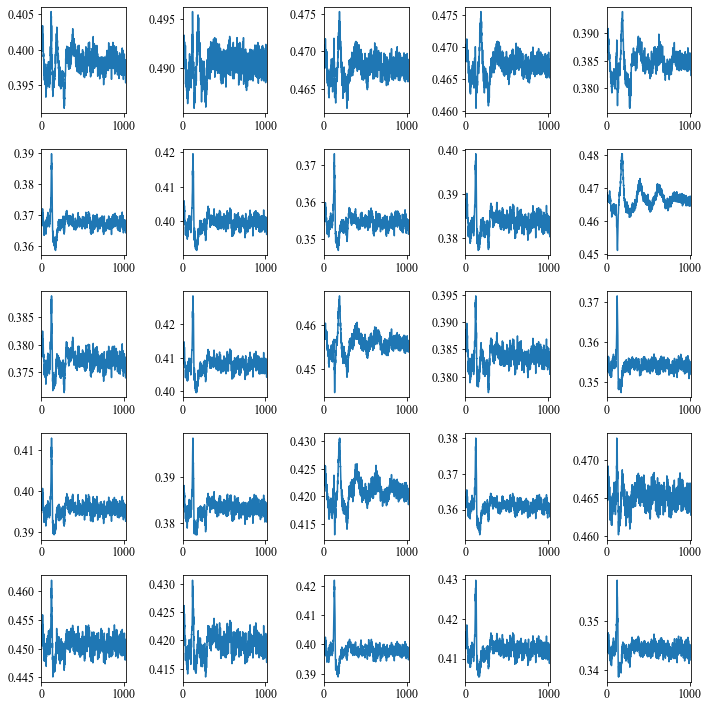

Epoch   111 / 2000
 3525 / 3525 - loss: 2.072187e-04 - Duration: 82 sec - ETA: 43 hour 25 min 1 sec
Epoch   112 / 2000
 3525 / 3525 - loss: 2.050839e-04 - Duration: 83 sec - ETA: 43 hour 23 min 46 sec
Epoch   113 / 2000
 3525 / 3525 - loss: 2.052152e-04 - Duration: 82 sec - ETA: 43 hour 22 min 21 sec
Epoch   114 / 2000
 3525 / 3525 - loss: 2.019907e-04 - Duration: 82 sec - ETA: 43 hour 20 min 55 sec
Epoch   115 / 2000
 3525 / 3525 - loss: 2.005441e-04 - Duration: 82 sec - ETA: 43 hour 19 min 30 sec
Epoch   116 / 2000
 3525 / 3525 - loss: 2.028244e-04 - Duration: 82 sec - ETA: 43 hour 18 min 5 sec
Epoch   117 / 2000
 3525 / 3525 - loss: 2.045938e-04 - Duration: 83 sec - ETA: 43 hour 16 min 55 sec
Epoch   118 / 2000
 3525 / 3525 - loss: 2.050427e-04 - Duration: 82 sec - ETA: 43 hour 15 min 30 sec
Epoch   119 / 2000
 3525 / 3525 - loss: 2.041198e-04 - Duration: 82 sec - ETA: 43 hour 14 min 5 sec
Epoch   120 / 2000
 3525 / 3525 - loss: 2.001785e-04 - Duration: 82 sec - ETA: 43 hour 12 min 

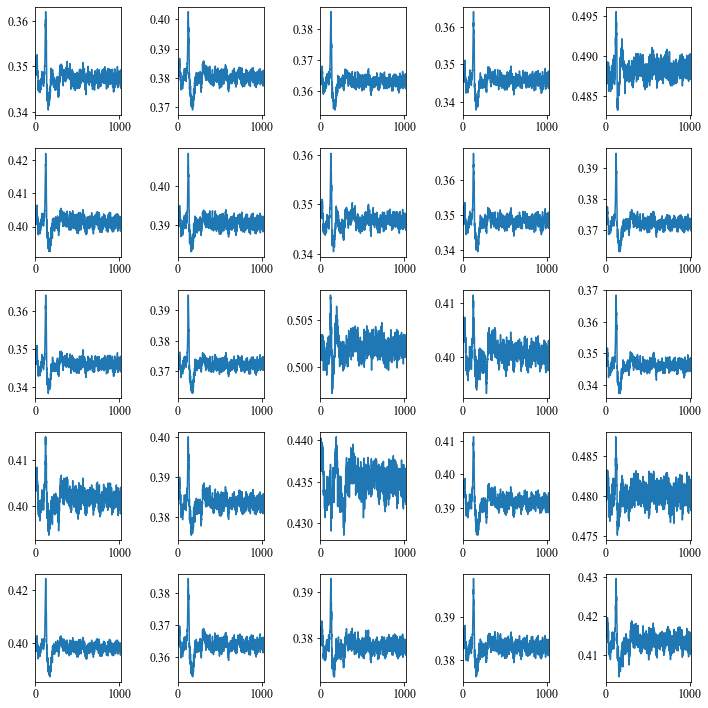

Epoch   121 / 2000
 3525 / 3525 - loss: 2.009906e-04 - Duration: 82 sec - ETA: 43 hour 11 min 18 sec
Epoch   122 / 2000
 3525 / 3525 - loss: 2.076898e-04 - Duration: 82 sec - ETA: 43 hour 9 min 56 sec
Epoch   123 / 2000
 3525 / 3525 - loss: 2.008262e-04 - Duration: 82 sec - ETA: 43 hour 8 min 31 sec
Epoch   124 / 2000
 3525 / 3525 - loss: 2.002318e-04 - Duration: 82 sec - ETA: 43 hour 7 min 6 sec
Epoch   125 / 2000
 3525 / 3525 - loss: 2.005681e-04 - Duration: 82 sec - ETA: 43 hour 5 min 41 sec
Epoch   126 / 2000
 3525 / 3525 - loss: 1.952114e-04 - Duration: 82 sec - ETA: 43 hour 4 min 17 sec
Epoch   127 / 2000
 3525 / 3525 - loss: 2.010675e-04 - Duration: 82 sec - ETA: 43 hour 2 min 53 sec
Epoch   128 / 2000
 3525 / 3525 - loss: 1.953766e-04 - Duration: 82 sec - ETA: 43 hour 1 min 31 sec
Epoch   129 / 2000
 3525 / 3525 - loss: 1.975459e-04 - Duration: 82 sec - ETA: 43 hour 0 min 7 sec
Epoch   130 / 2000
 3525 / 3525 - loss: 2.009998e-04 - Duration: 82 sec - ETA: 42 hour 58 min 43 sec


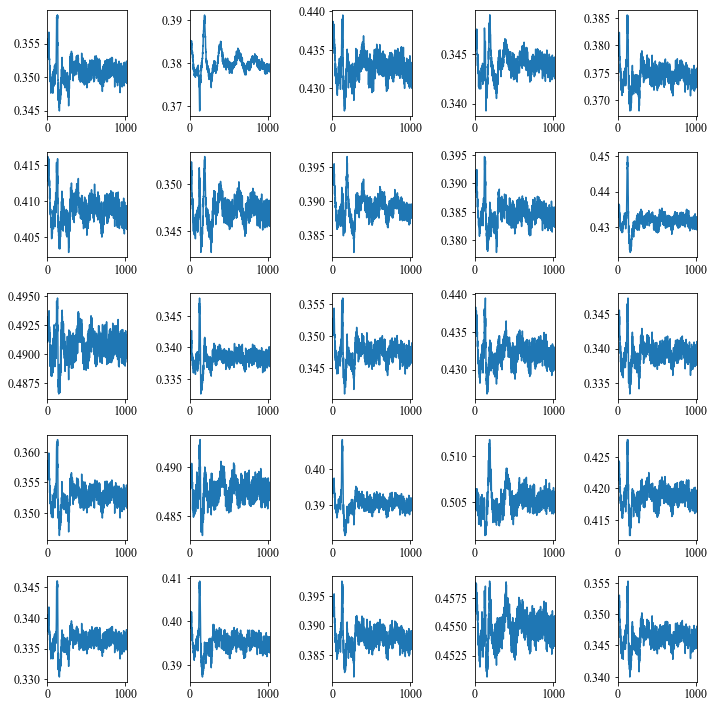

Epoch   131 / 2000
 3525 / 3525 - loss: 1.959614e-04 - Duration: 82 sec - ETA: 42 hour 57 min 19 sec
Epoch   132 / 2000
 3525 / 3525 - loss: 2.018961e-04 - Duration: 82 sec - ETA: 42 hour 55 min 53 sec
Epoch   133 / 2000
 3525 / 3525 - loss: 2.002274e-04 - Duration: 82 sec - ETA: 42 hour 54 min 32 sec
Epoch   134 / 2000
 3525 / 3525 - loss: 1.959813e-04 - Duration: 82 sec - ETA: 42 hour 53 min 7 sec
Epoch   135 / 2000
 3525 / 3525 - loss: 1.949455e-04 - Duration: 82 sec - ETA: 42 hour 51 min 43 sec
Epoch   136 / 2000
 3525 / 3525 - loss: 1.992502e-04 - Duration: 82 sec - ETA: 42 hour 50 min 18 sec
Epoch   137 / 2000
 3525 / 3525 - loss: 2.007551e-04 - Duration: 82 sec - ETA: 42 hour 48 min 56 sec
Epoch   138 / 2000
 3525 / 3525 - loss: 1.954102e-04 - Duration: 82 sec - ETA: 42 hour 47 min 31 sec
Epoch   139 / 2000
 3525 / 3525 - loss: 1.932647e-04 - Duration: 82 sec - ETA: 42 hour 46 min 7 sec
Epoch   140 / 2000
 3525 / 3525 - loss: 1.922874e-04 - Duration: 82 sec - ETA: 42 hour 44 min

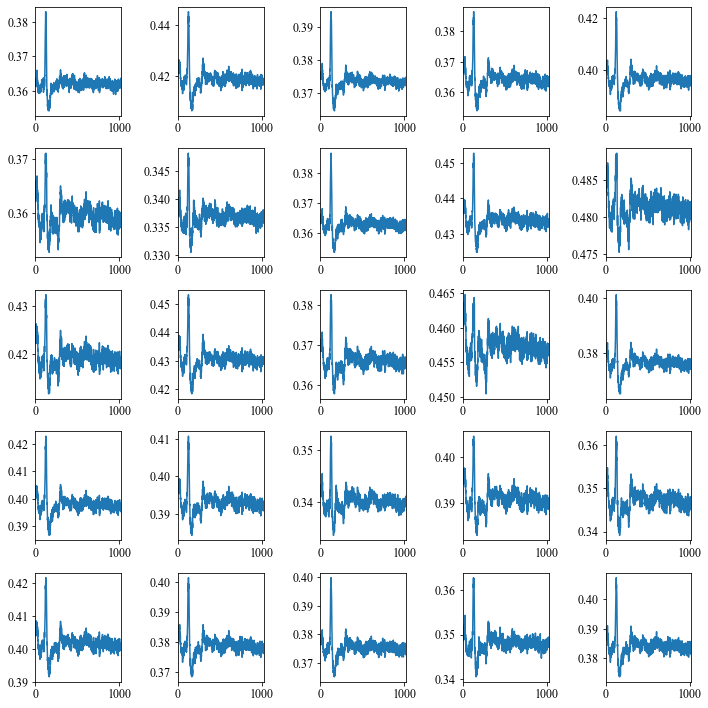

Epoch   141 / 2000
 3525 / 3525 - loss: 1.944766e-04 - Duration: 82 sec - ETA: 42 hour 43 min 18 sec
Epoch   142 / 2000
 3525 / 3525 - loss: 1.955614e-04 - Duration: 82 sec - ETA: 42 hour 41 min 55 sec
Epoch   143 / 2000
 3525 / 3525 - loss: 1.926029e-04 - Duration: 82 sec - ETA: 42 hour 40 min 31 sec
Epoch   144 / 2000
 3525 / 3525 - loss: 1.934552e-04 - Duration: 82 sec - ETA: 42 hour 39 min 8 sec
Epoch   145 / 2000
 3525 / 3525 - loss: 1.909223e-04 - Duration: 82 sec - ETA: 42 hour 37 min 44 sec
Epoch   146 / 2000
 3525 / 3525 - loss: 1.927434e-04 - Duration: 82 sec - ETA: 42 hour 36 min 21 sec
Epoch   147 / 2000
 3525 / 3525 - loss: 1.935143e-04 - Duration: 82 sec - ETA: 42 hour 34 min 57 sec
Epoch   148 / 2000
 3525 / 3525 - loss: 1.914992e-04 - Duration: 82 sec - ETA: 42 hour 33 min 31 sec
Epoch   149 / 2000
 3525 / 3525 - loss: 1.930693e-04 - Duration: 82 sec - ETA: 42 hour 32 min 10 sec
Epoch   150 / 2000
 3525 / 3525 - loss: 1.895750e-04 - Duration: 82 sec - ETA: 42 hour 30 mi

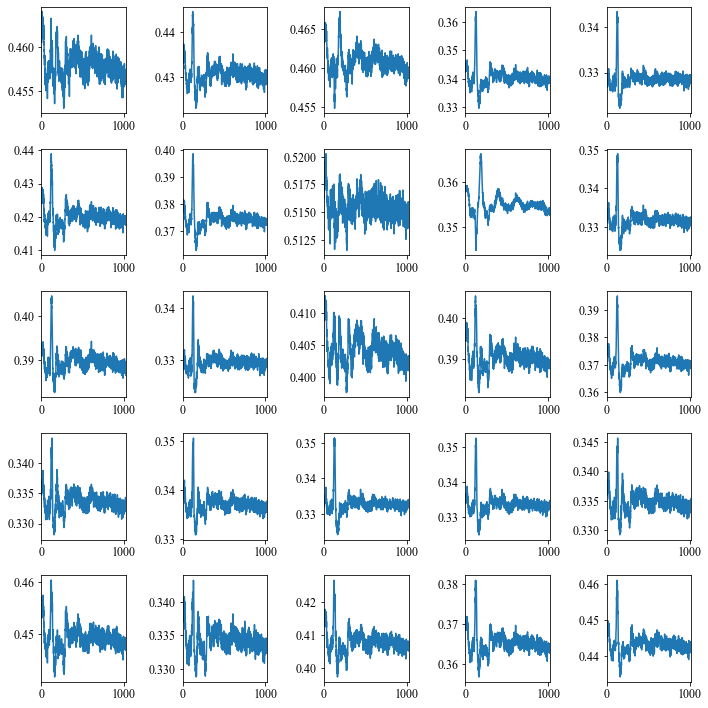

Epoch   151 / 2000
 3525 / 3525 - loss: 1.890586e-04 - Duration: 82 sec - ETA: 42 hour 29 min 21 sec
Epoch   152 / 2000
 3525 / 3525 - loss: 1.941313e-04 - Duration: 82 sec - ETA: 42 hour 27 min 58 sec
Epoch   153 / 2000
 3525 / 3525 - loss: 1.900340e-04 - Duration: 82 sec - ETA: 42 hour 26 min 38 sec
Epoch   154 / 2000
 3525 / 3525 - loss: 1.877679e-04 - Duration: 82 sec - ETA: 42 hour 25 min 14 sec
Epoch   155 / 2000
 3525 / 3525 - loss: 1.865685e-04 - Duration: 82 sec - ETA: 42 hour 23 min 52 sec
Epoch   156 / 2000
 3525 / 3525 - loss: 1.881391e-04 - Duration: 82 sec - ETA: 42 hour 22 min 28 sec
Epoch   157 / 2000
 3525 / 3525 - loss: 1.834864e-04 - Duration: 82 sec - ETA: 42 hour 21 min 4 sec
Epoch   158 / 2000
 3525 / 3525 - loss: 1.848596e-04 - Duration: 82 sec - ETA: 42 hour 19 min 40 sec
Epoch   159 / 2000
 3525 / 3525 - loss: 1.837558e-04 - Duration: 82 sec - ETA: 42 hour 18 min 16 sec
Epoch   160 / 2000
 3525 / 3525 - loss: 1.805677e-04 - Duration: 82 sec - ETA: 42 hour 16 mi

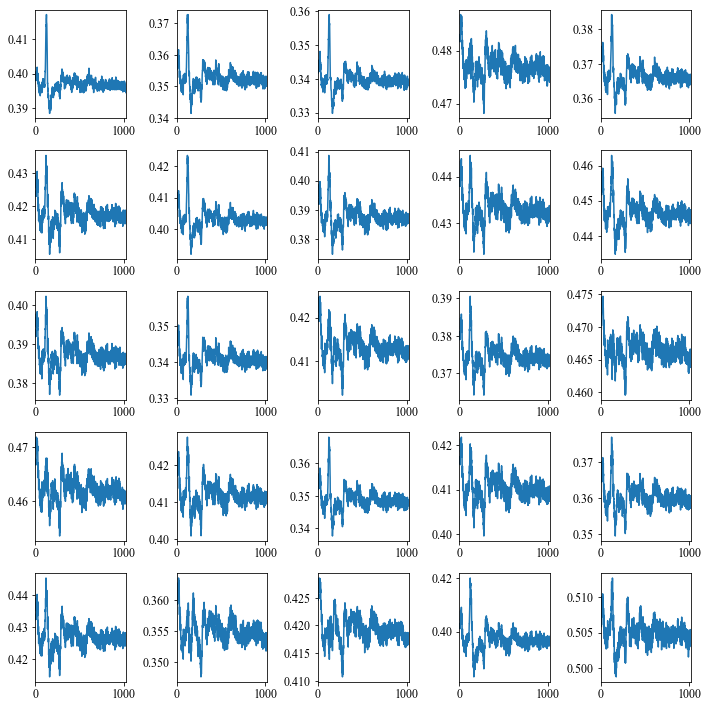

Epoch   161 / 2000
 3525 / 3525 - loss: 1.827979e-04 - Duration: 82 sec - ETA: 42 hour 15 min 29 sec
Epoch   162 / 2000
 3525 / 3525 - loss: 1.844022e-04 - Duration: 82 sec - ETA: 42 hour 14 min 6 sec
Epoch   163 / 2000
 3525 / 3525 - loss: 1.810683e-04 - Duration: 82 sec - ETA: 42 hour 12 min 43 sec
Epoch   164 / 2000
 3525 / 3525 - loss: 1.814169e-04 - Duration: 82 sec - ETA: 42 hour 11 min 20 sec
Epoch   165 / 2000
 3525 / 3525 - loss: 1.809797e-04 - Duration: 82 sec - ETA: 42 hour 9 min 58 sec
Epoch   166 / 2000
 3525 / 3525 - loss: 1.792836e-04 - Duration: 82 sec - ETA: 42 hour 8 min 35 sec
Epoch   167 / 2000
 3525 / 3525 - loss: 1.801139e-04 - Duration: 82 sec - ETA: 42 hour 7 min 12 sec
Epoch   168 / 2000
 3525 / 3525 - loss: 1.790439e-04 - Duration: 82 sec - ETA: 42 hour 5 min 49 sec
Epoch   169 / 2000
 3525 / 3525 - loss: 1.777190e-04 - Duration: 82 sec - ETA: 42 hour 4 min 25 sec
Epoch   170 / 2000
 3525 / 3525 - loss: 1.808082e-04 - Duration: 82 sec - ETA: 42 hour 3 min 1 se

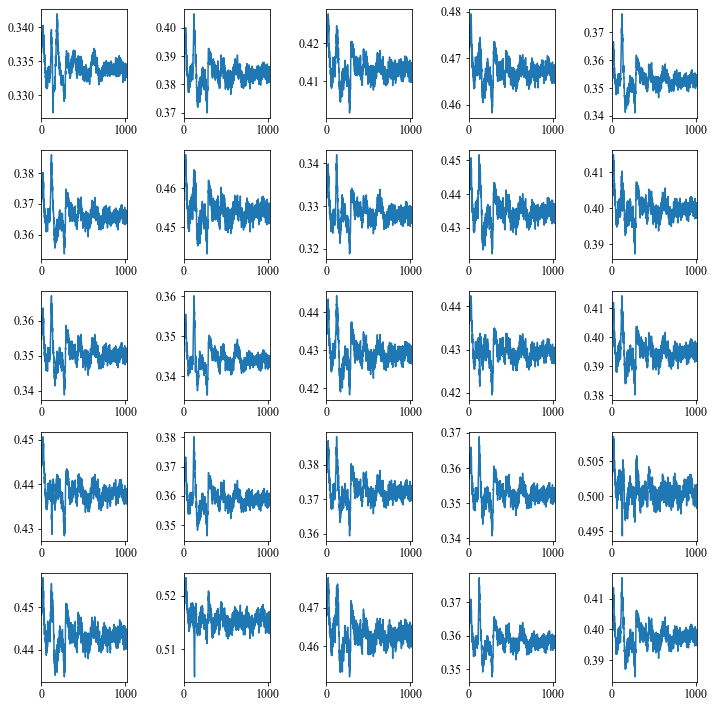

Epoch   171 / 2000
 3525 / 3525 - loss: 1.778441e-04 - Duration: 82 sec - ETA: 42 hour 1 min 38 sec
Epoch   172 / 2000
 3525 / 3525 - loss: 1.759112e-04 - Duration: 82 sec - ETA: 42 hour 0 min 14 sec
Epoch   173 / 2000
 3525 / 3525 - loss: 1.805037e-04 - Duration: 82 sec - ETA: 41 hour 58 min 49 sec
Epoch   174 / 2000
 3525 / 3525 - loss: 1.801760e-04 - Duration: 82 sec - ETA: 41 hour 57 min 26 sec
Epoch   175 / 2000
 3525 / 3525 - loss: 1.770727e-04 - Duration: 82 sec - ETA: 41 hour 56 min 3 sec
Epoch   176 / 2000
 3525 / 3525 - loss: 1.747444e-04 - Duration: 82 sec - ETA: 41 hour 54 min 40 sec
Epoch   177 / 2000
 3525 / 3525 - loss: 1.759292e-04 - Duration: 82 sec - ETA: 41 hour 53 min 16 sec
Epoch   178 / 2000
 3525 / 3525 - loss: 1.753501e-04 - Duration: 82 sec - ETA: 41 hour 51 min 52 sec
Epoch   179 / 2000
 3525 / 3525 - loss: 1.775601e-04 - Duration: 82 sec - ETA: 41 hour 50 min 29 sec
Epoch   180 / 2000
 3525 / 3525 - loss: 1.763412e-04 - Duration: 82 sec - ETA: 41 hour 49 min 

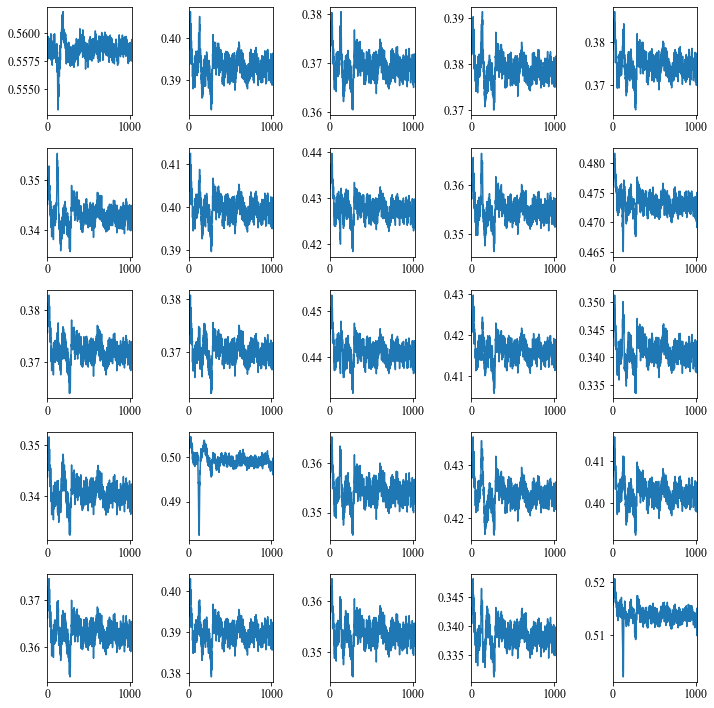

Epoch   181 / 2000
 3525 / 3525 - loss: 1.747128e-04 - Duration: 82 sec - ETA: 41 hour 47 min 42 sec
Epoch   182 / 2000
 3525 / 3525 - loss: 1.784218e-04 - Duration: 82 sec - ETA: 41 hour 46 min 19 sec
Epoch   183 / 2000
 3525 / 3525 - loss: 1.766366e-04 - Duration: 82 sec - ETA: 41 hour 44 min 54 sec
Epoch   184 / 2000
 3525 / 3525 - loss: 1.761512e-04 - Duration: 82 sec - ETA: 41 hour 43 min 31 sec
Epoch   185 / 2000
 3525 / 3525 - loss: 1.751336e-04 - Duration: 82 sec - ETA: 41 hour 42 min 7 sec
Epoch   186 / 2000
 3525 / 3525 - loss: 1.737703e-04 - Duration: 82 sec - ETA: 41 hour 40 min 42 sec
Epoch   187 / 2000
 3525 / 3525 - loss: 1.763908e-04 - Duration: 82 sec - ETA: 41 hour 39 min 20 sec
Epoch   188 / 2000
 3525 / 3525 - loss: 1.720677e-04 - Duration: 82 sec - ETA: 41 hour 37 min 57 sec
Epoch   189 / 2000
 3525 / 3525 - loss: 1.711300e-04 - Duration: 82 sec - ETA: 41 hour 36 min 34 sec
Epoch   190 / 2000
 3525 / 3525 - loss: 1.779150e-04 - Duration: 82 sec - ETA: 41 hour 35 mi

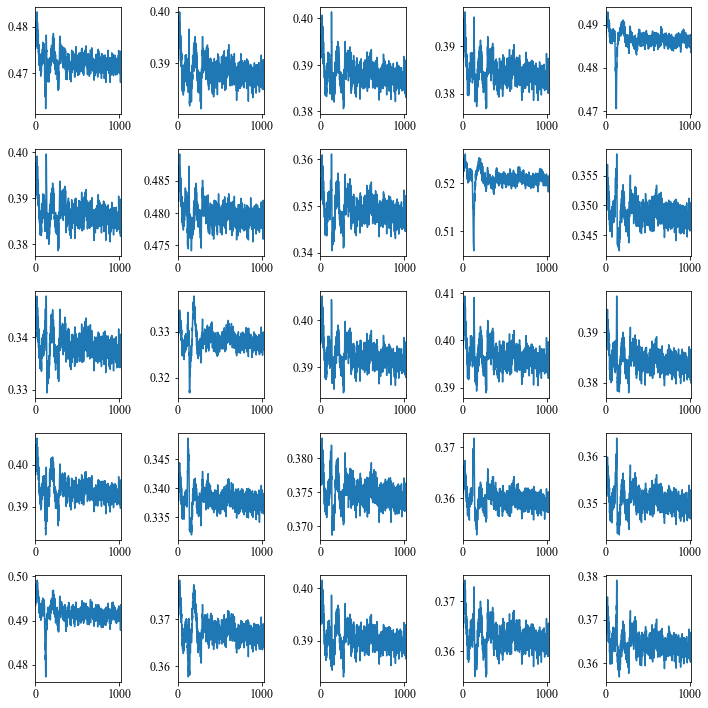

Epoch   191 / 2000
 3525 / 3525 - loss: 1.747179e-04 - Duration: 82 sec - ETA: 41 hour 33 min 48 sec
Epoch   192 / 2000
 3525 / 3525 - loss: 1.748174e-04 - Duration: 83 sec - ETA: 41 hour 32 min 37 sec
Epoch   193 / 2000
 3525 / 3525 - loss: 1.728894e-04 - Duration: 84 sec - ETA: 41 hour 31 min 34 sec
Epoch   194 / 2000
 3525 / 3525 - loss: 1.754629e-04 - Duration: 83 sec - ETA: 41 hour 30 min 17 sec
Epoch   195 / 2000
 3525 / 3525 - loss: 1.716746e-04 - Duration: 82 sec - ETA: 41 hour 28 min 54 sec
Epoch   196 / 2000
 3525 / 3525 - loss: 1.700936e-04 - Duration: 82 sec - ETA: 41 hour 27 min 31 sec
Epoch   197 / 2000
 3525 / 3525 - loss: 1.702139e-04 - Duration: 82 sec - ETA: 41 hour 26 min 7 sec
Epoch   198 / 2000
 3525 / 3525 - loss: 1.716150e-04 - Duration: 82 sec - ETA: 41 hour 24 min 46 sec
Epoch   199 / 2000
 3525 / 3525 - loss: 1.700106e-04 - Duration: 82 sec - ETA: 41 hour 23 min 23 sec
Epoch   200 / 2000
 3525 / 3525 - loss: 1.717017e-04 - Duration: 82 sec - ETA: 41 hour 21 mi

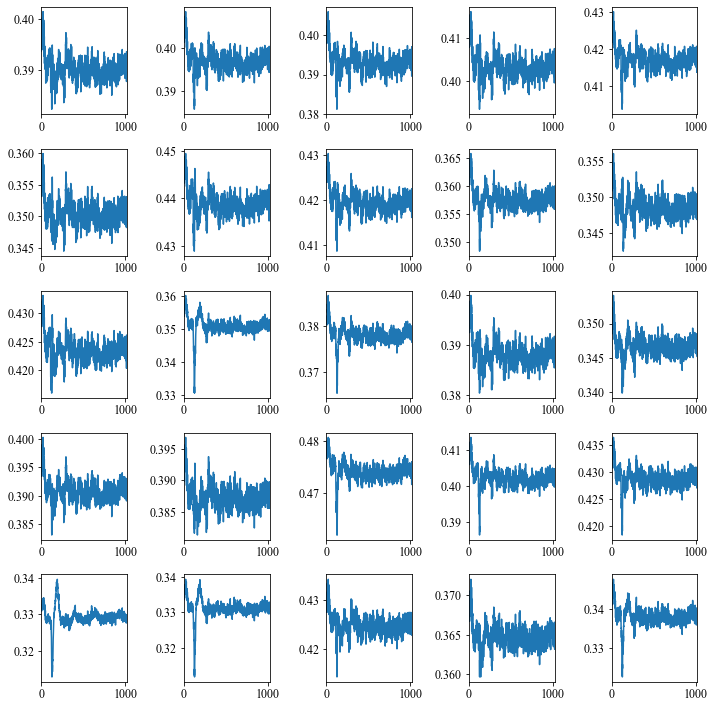

Epoch   201 / 2000
 3525 / 3525 - loss: 1.720758e-04 - Duration: 82 sec - ETA: 41 hour 20 min 36 sec
Epoch   202 / 2000
 3525 / 3525 - loss: 1.704120e-04 - Duration: 82 sec - ETA: 41 hour 19 min 12 sec
Epoch   203 / 2000
 3525 / 3525 - loss: 1.675136e-04 - Duration: 82 sec - ETA: 41 hour 17 min 49 sec
Epoch   204 / 2000
 3525 / 3525 - loss: 1.674645e-04 - Duration: 82 sec - ETA: 41 hour 16 min 24 sec
Epoch   205 / 2000
 3525 / 3525 - loss: 1.689359e-04 - Duration: 82 sec - ETA: 41 hour 15 min 0 sec
Epoch   206 / 2000
 3525 / 3525 - loss: 1.674667e-04 - Duration: 82 sec - ETA: 41 hour 13 min 37 sec
Epoch   207 / 2000
 3525 / 3525 - loss: 1.667469e-04 - Duration: 82 sec - ETA: 41 hour 12 min 14 sec
Epoch   208 / 2000
 3525 / 3525 - loss: 1.685640e-04 - Duration: 82 sec - ETA: 41 hour 10 min 50 sec
Epoch   209 / 2000
 3525 / 3525 - loss: 1.682413e-04 - Duration: 82 sec - ETA: 41 hour 9 min 26 sec
Epoch   210 / 2000
 3525 / 3525 - loss: 1.679580e-04 - Duration: 82 sec - ETA: 41 hour 8 min 

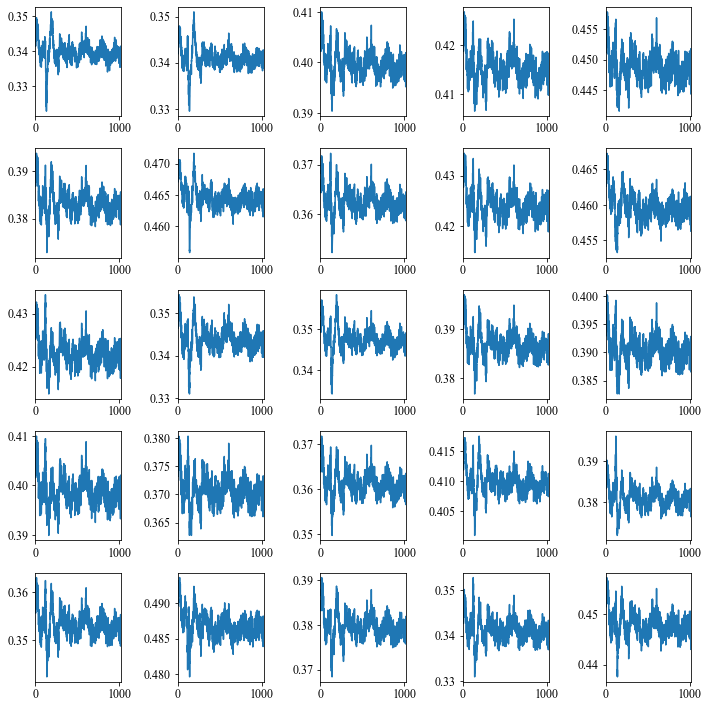

Epoch   211 / 2000
 3525 / 3525 - loss: 1.681275e-04 - Duration: 82 sec - ETA: 41 hour 6 min 40 sec
Epoch   212 / 2000
 3525 / 3525 - loss: 1.687642e-04 - Duration: 82 sec - ETA: 41 hour 5 min 15 sec
Epoch   213 / 2000
 3525 / 3525 - loss: 1.687649e-04 - Duration: 82 sec - ETA: 41 hour 3 min 52 sec
Epoch   214 / 2000
 3525 / 3525 - loss: 1.645944e-04 - Duration: 82 sec - ETA: 41 hour 2 min 29 sec
Epoch   215 / 2000
 3525 / 3525 - loss: 1.649238e-04 - Duration: 82 sec - ETA: 41 hour 1 min 5 sec
Epoch   216 / 2000
 3525 / 3525 - loss: 1.647760e-04 - Duration: 82 sec - ETA: 40 hour 59 min 41 sec
Epoch   217 / 2000
 3525 / 3525 - loss: 1.712979e-04 - Duration: 82 sec - ETA: 40 hour 58 min 18 sec
Epoch   218 / 2000
 3525 / 3525 - loss: 1.700189e-04 - Duration: 82 sec - ETA: 40 hour 56 min 54 sec
Epoch   219 / 2000
 3525 / 3525 - loss: 1.700899e-04 - Duration: 82 sec - ETA: 40 hour 55 min 30 sec
Epoch   220 / 2000
 3525 / 3525 - loss: 1.677658e-04 - Duration: 82 sec - ETA: 40 hour 54 min 8 s

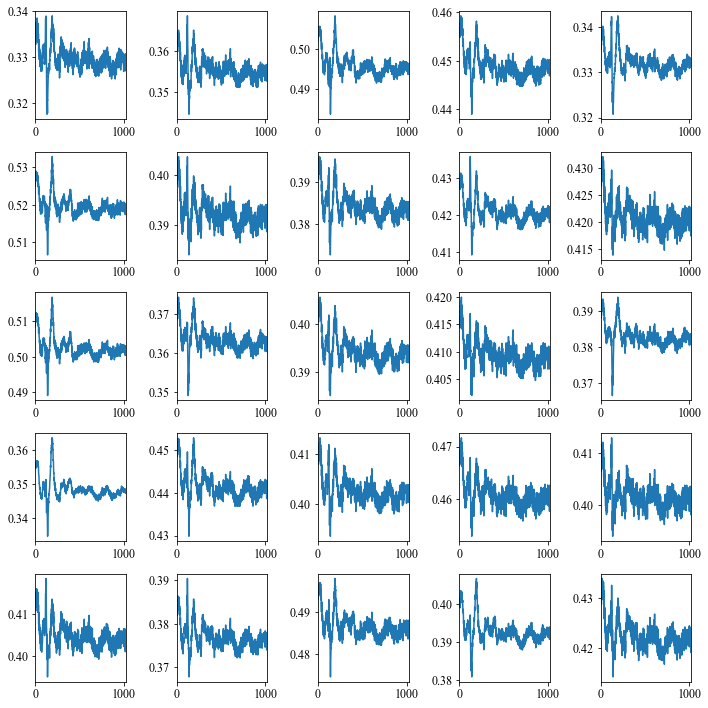

Epoch   221 / 2000
 3525 / 3525 - loss: 1.670778e-04 - Duration: 82 sec - ETA: 40 hour 52 min 44 sec
Epoch   222 / 2000
 3525 / 3525 - loss: 1.649301e-04 - Duration: 82 sec - ETA: 40 hour 51 min 20 sec
Epoch   223 / 2000
 3525 / 3525 - loss: 1.627625e-04 - Duration: 82 sec - ETA: 40 hour 49 min 55 sec
Epoch   224 / 2000
 3525 / 3525 - loss: 1.677346e-04 - Duration: 82 sec - ETA: 40 hour 48 min 32 sec
Epoch   225 / 2000
 3525 / 3525 - loss: 1.658930e-04 - Duration: 82 sec - ETA: 40 hour 47 min 8 sec
Epoch   226 / 2000
 3525 / 3525 - loss: 1.638111e-04 - Duration: 82 sec - ETA: 40 hour 45 min 43 sec
Epoch   227 / 2000
 3525 / 3525 - loss: 1.671665e-04 - Duration: 82 sec - ETA: 40 hour 44 min 19 sec
Epoch   228 / 2000
 3525 / 3525 - loss: 1.684698e-04 - Duration: 82 sec - ETA: 40 hour 42 min 55 sec
Epoch   229 / 2000
 3525 / 3525 - loss: 1.667767e-04 - Duration: 82 sec - ETA: 40 hour 41 min 31 sec
Epoch   230 / 2000
 3525 / 3525 - loss: 1.648105e-04 - Duration: 82 sec - ETA: 40 hour 40 mi

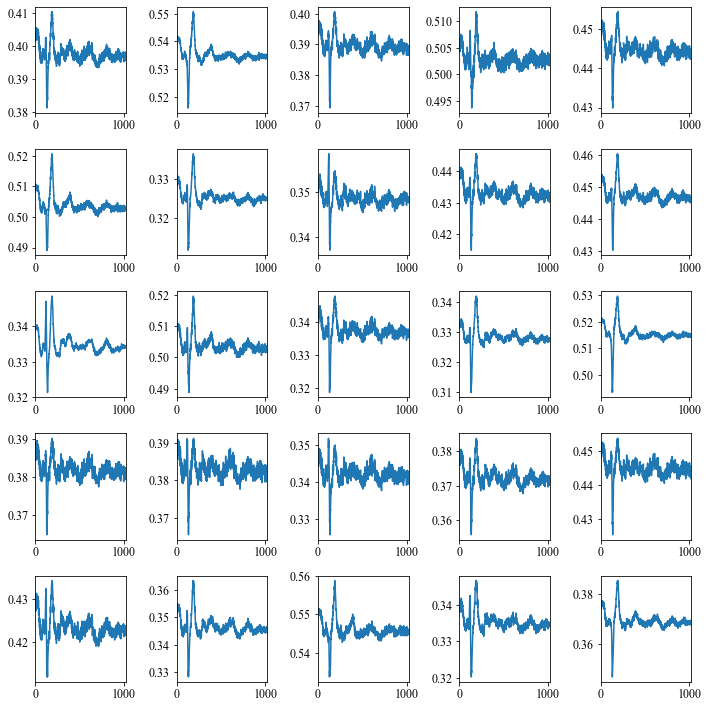

Epoch   231 / 2000
 3525 / 3525 - loss: 1.676422e-04 - Duration: 82 sec - ETA: 40 hour 38 min 44 sec
Epoch   232 / 2000
 3525 / 3525 - loss: 1.649486e-04 - Duration: 82 sec - ETA: 40 hour 37 min 21 sec
Epoch   233 / 2000
 3525 / 3525 - loss: 1.654384e-04 - Duration: 82 sec - ETA: 40 hour 35 min 57 sec
Epoch   234 / 2000
 3525 / 3525 - loss: 1.715285e-04 - Duration: 82 sec - ETA: 40 hour 34 min 33 sec
Epoch   235 / 2000
 3525 / 3525 - loss: 1.696498e-04 - Duration: 82 sec - ETA: 40 hour 33 min 10 sec
Epoch   236 / 2000
 3525 / 3525 - loss: 1.705285e-04 - Duration: 82 sec - ETA: 40 hour 31 min 46 sec
Epoch   237 / 2000
 3525 / 3525 - loss: 1.752158e-04 - Duration: 82 sec - ETA: 40 hour 30 min 22 sec
Epoch   238 / 2000
 3525 / 3525 - loss: 1.691874e-04 - Duration: 82 sec - ETA: 40 hour 28 min 58 sec
Epoch   239 / 2000
 3525 / 3525 - loss: 1.688045e-04 - Duration: 82 sec - ETA: 40 hour 27 min 34 sec
Epoch   240 / 2000
 3525 / 3525 - loss: 1.598797e-04 - Duration: 82 sec - ETA: 40 hour 26 m

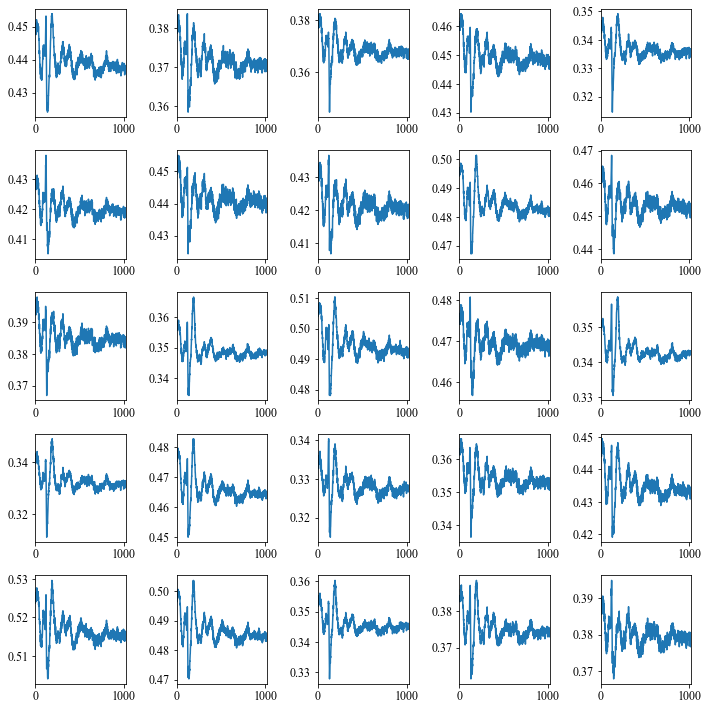

Epoch   241 / 2000
 3525 / 3525 - loss: 1.703146e-04 - Duration: 82 sec - ETA: 40 hour 24 min 47 sec
Epoch   242 / 2000
 3525 / 3525 - loss: 1.669773e-04 - Duration: 82 sec - ETA: 40 hour 23 min 24 sec
Epoch   243 / 2000
 3525 / 3525 - loss: 1.652885e-04 - Duration: 82 sec - ETA: 40 hour 22 min 1 sec
Epoch   244 / 2000
 3525 / 3525 - loss: 1.666036e-04 - Duration: 82 sec - ETA: 40 hour 20 min 37 sec
Epoch   245 / 2000
 3525 / 3525 - loss: 1.618357e-04 - Duration: 82 sec - ETA: 40 hour 19 min 13 sec
Epoch   246 / 2000
 3525 / 3525 - loss: 1.675163e-04 - Duration: 82 sec - ETA: 40 hour 17 min 50 sec
Epoch   247 / 2000
 3525 / 3525 - loss: 1.659616e-04 - Duration: 82 sec - ETA: 40 hour 16 min 28 sec
Epoch   248 / 2000
 3525 / 3525 - loss: 1.657793e-04 - Duration: 82 sec - ETA: 40 hour 15 min 5 sec
Epoch   249 / 2000
 3525 / 3525 - loss: 1.642103e-04 - Duration: 82 sec - ETA: 40 hour 13 min 42 sec
Epoch   250 / 2000
 3525 / 3525 - loss: 1.617772e-04 - Duration: 82 sec - ETA: 40 hour 12 min

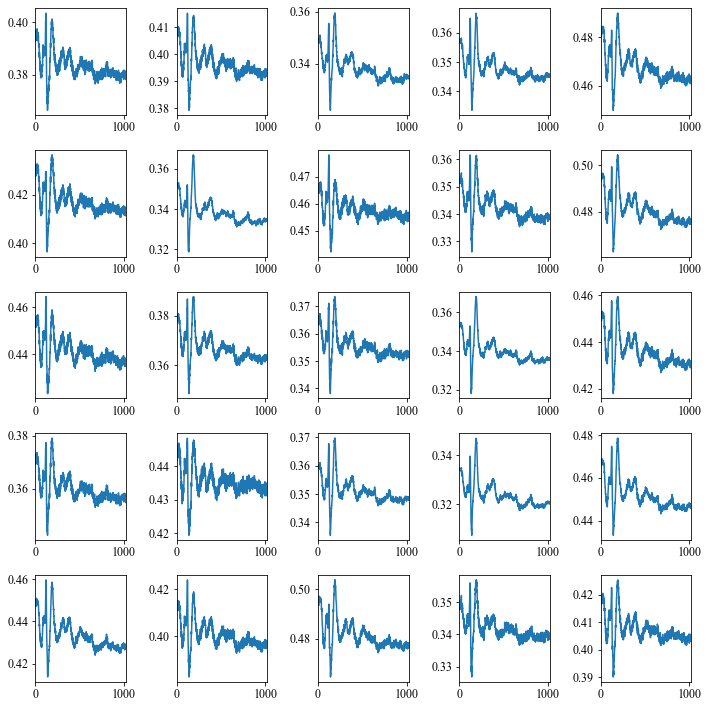

Epoch   251 / 2000
 3525 / 3525 - loss: 1.625450e-04 - Duration: 82 sec - ETA: 40 hour 10 min 55 sec
Epoch   252 / 2000
 3525 / 3525 - loss: 1.632408e-04 - Duration: 82 sec - ETA: 40 hour 9 min 31 sec
Epoch   253 / 2000
 3525 / 3525 - loss: 1.630328e-04 - Duration: 82 sec - ETA: 40 hour 8 min 9 sec
Epoch   254 / 2000
 3525 / 3525 - loss: 1.597872e-04 - Duration: 82 sec - ETA: 40 hour 6 min 45 sec
Epoch   255 / 2000
 3525 / 3525 - loss: 1.646375e-04 - Duration: 82 sec - ETA: 40 hour 5 min 22 sec
Epoch   256 / 2000
 3525 / 3525 - loss: 1.649266e-04 - Duration: 82 sec - ETA: 40 hour 3 min 58 sec
Epoch   257 / 2000
 3525 / 3525 - loss: 1.658865e-04 - Duration: 82 sec - ETA: 40 hour 2 min 34 sec
Epoch   258 / 2000
 3525 / 3525 - loss: 1.611944e-04 - Duration: 82 sec - ETA: 40 hour 1 min 11 sec
Epoch   259 / 2000
 3525 / 3525 - loss: 1.619635e-04 - Duration: 82 sec - ETA: 39 hour 59 min 47 sec
Epoch   260 / 2000
 3525 / 3525 - loss: 1.627664e-04 - Duration: 82 sec - ETA: 39 hour 58 min 24 se

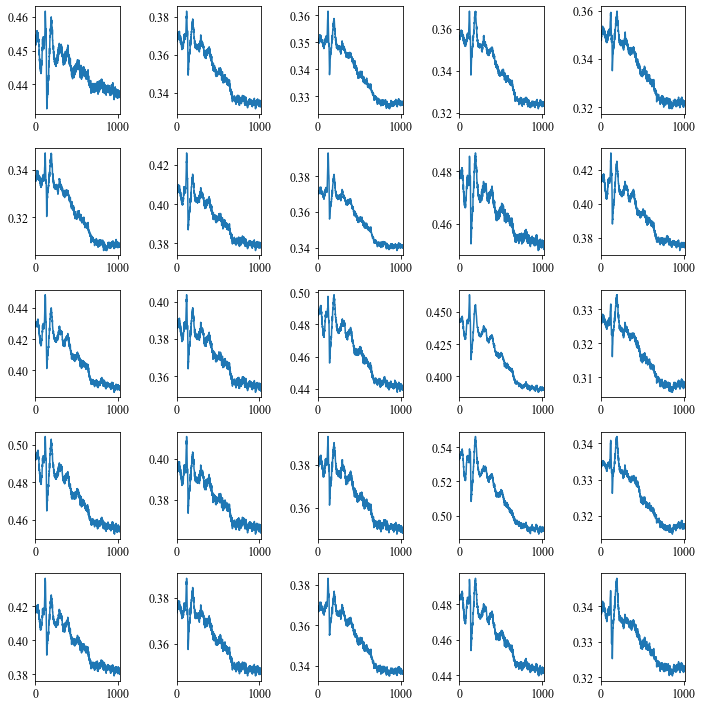

Epoch   261 / 2000
 3525 / 3525 - loss: 1.631180e-04 - Duration: 82 sec - ETA: 39 hour 57 min 1 sec
Epoch   262 / 2000
 3525 / 3525 - loss: 1.603353e-04 - Duration: 82 sec - ETA: 39 hour 55 min 38 sec
Epoch   263 / 2000
 3525 / 3525 - loss: 1.629535e-04 - Duration: 82 sec - ETA: 39 hour 54 min 14 sec
Epoch   264 / 2000
 3525 / 3525 - loss: 1.623151e-04 - Duration: 82 sec - ETA: 39 hour 52 min 52 sec
Epoch   265 / 2000
 3525 / 3525 - loss: 1.622512e-04 - Duration: 82 sec - ETA: 39 hour 51 min 29 sec
Epoch   266 / 2000
 3525 / 3525 - loss: 1.565282e-04 - Duration: 82 sec - ETA: 39 hour 50 min 5 sec
Epoch   267 / 2000
 3525 / 3525 - loss: 1.643160e-04 - Duration: 82 sec - ETA: 39 hour 48 min 42 sec
Epoch   268 / 2000
 3525 / 3525 - loss: 1.595882e-04 - Duration: 82 sec - ETA: 39 hour 47 min 19 sec
Epoch   269 / 2000
 3525 / 3525 - loss: 1.631251e-04 - Duration: 82 sec - ETA: 39 hour 45 min 55 sec
Epoch   270 / 2000
 3525 / 3525 - loss: 1.621069e-04 - Duration: 82 sec - ETA: 39 hour 44 min

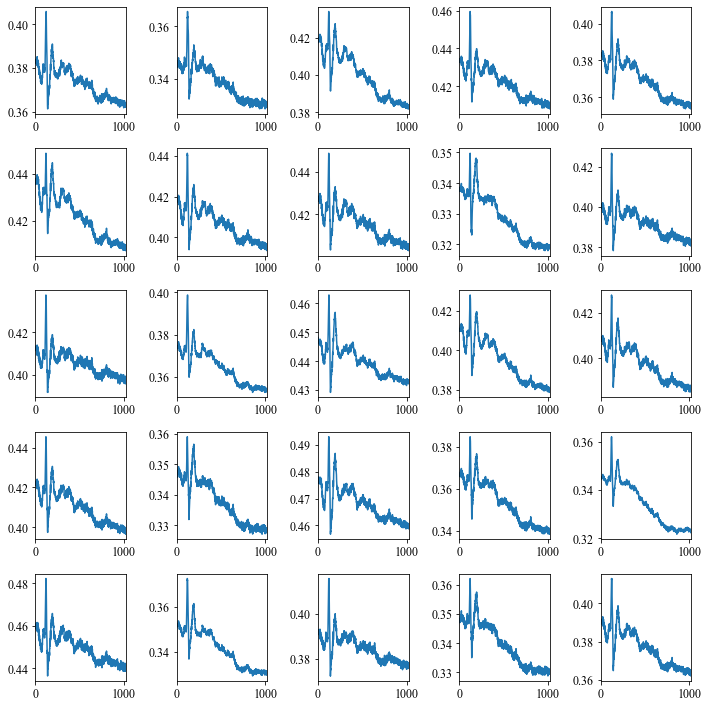

Epoch   271 / 2000
 3525 / 3525 - loss: 1.582318e-04 - Duration: 82 sec - ETA: 39 hour 43 min 8 sec
Epoch   272 / 2000
 3525 / 3525 - loss: 1.610796e-04 - Duration: 82 sec - ETA: 39 hour 41 min 45 sec
Epoch   273 / 2000
 3525 / 3525 - loss: 1.578807e-04 - Duration: 82 sec - ETA: 39 hour 40 min 21 sec
Epoch   274 / 2000
 3525 / 3525 - loss: 1.615772e-04 - Duration: 82 sec - ETA: 39 hour 38 min 58 sec
Epoch   275 / 2000
 3525 / 3525 - loss: 1.606130e-04 - Duration: 83 sec - ETA: 39 hour 37 min 42 sec
Epoch   276 / 2000
 3525 / 3525 - loss: 1.588658e-04 - Duration: 82 sec - ETA: 39 hour 36 min 20 sec
Epoch   277 / 2000
 3525 / 3525 - loss: 1.547870e-04 - Duration: 82 sec - ETA: 39 hour 34 min 58 sec
Epoch   278 / 2000
 3525 / 3525 - loss: 1.563640e-04 - Duration: 82 sec - ETA: 39 hour 33 min 35 sec
Epoch   279 / 2000
 3525 / 3525 - loss: 1.579996e-04 - Duration: 83 sec - ETA: 39 hour 32 min 15 sec
Epoch   280 / 2000
 3525 / 3525 - loss: 1.588335e-04 - Duration: 82 sec - ETA: 39 hour 30 mi

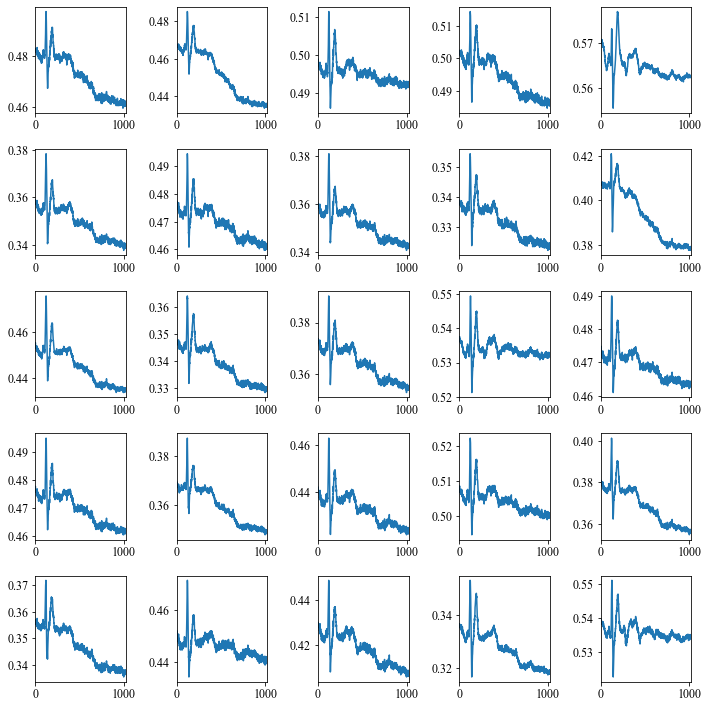

Epoch   281 / 2000
 3525 / 3525 - loss: 1.549322e-04 - Duration: 82 sec - ETA: 39 hour 29 min 31 sec
Epoch   282 / 2000
 3525 / 3525 - loss: 1.586607e-04 - Duration: 82 sec - ETA: 39 hour 28 min 9 sec
Epoch   283 / 2000
 3525 / 3525 - loss: 1.554457e-04 - Duration: 82 sec - ETA: 39 hour 26 min 46 sec
Epoch   284 / 2000
 3525 / 3525 - loss: 1.563364e-04 - Duration: 82 sec - ETA: 39 hour 25 min 24 sec
Epoch   285 / 2000
 3525 / 3525 - loss: 1.585284e-04 - Duration: 82 sec - ETA: 39 hour 24 min 2 sec
Epoch   286 / 2000
 3525 / 3525 - loss: 1.571089e-04 - Duration: 82 sec - ETA: 39 hour 22 min 40 sec
Epoch   287 / 2000
 3525 / 3525 - loss: 1.609466e-04 - Duration: 82 sec - ETA: 39 hour 21 min 18 sec
Epoch   288 / 2000
 3525 / 3525 - loss: 1.595804e-04 - Duration: 82 sec - ETA: 39 hour 19 min 55 sec
Epoch   289 / 2000
 3525 / 3525 - loss: 1.560688e-04 - Duration: 82 sec - ETA: 39 hour 18 min 33 sec
Epoch   290 / 2000
 3525 / 3525 - loss: 1.578797e-04 - Duration: 83 sec - ETA: 39 hour 17 min

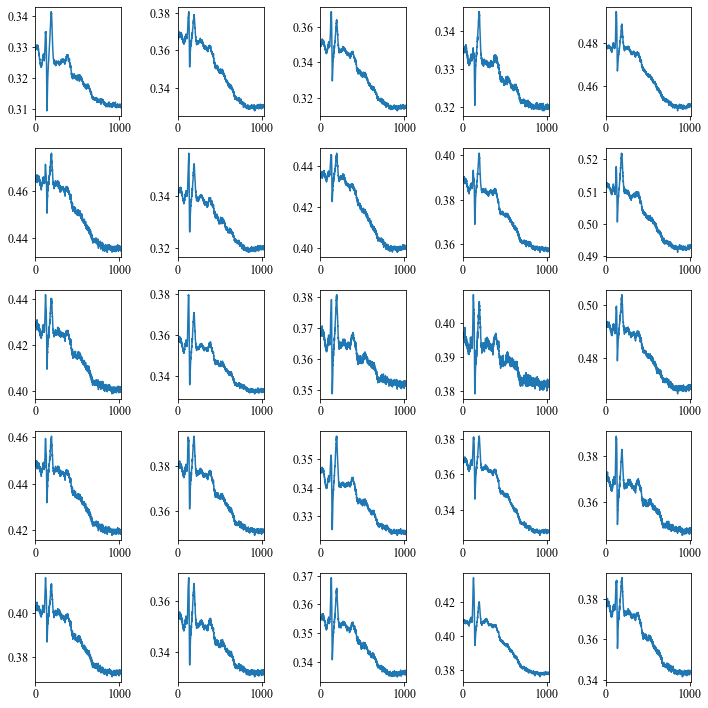

Epoch   291 / 2000
 3525 / 3525 - loss: 1.554507e-04 - Duration: 82 sec - ETA: 39 hour 15 min 50 sec
Epoch   292 / 2000
 3525 / 3525 - loss: 1.588788e-04 - Duration: 82 sec - ETA: 39 hour 14 min 29 sec
Epoch   293 / 2000
 3525 / 3525 - loss: 1.588893e-04 - Duration: 82 sec - ETA: 39 hour 13 min 7 sec
Epoch   294 / 2000
 3525 / 3525 - loss: 1.558676e-04 - Duration: 82 sec - ETA: 39 hour 11 min 46 sec
Epoch   295 / 2000
 3525 / 3525 - loss: 1.538241e-04 - Duration: 82 sec - ETA: 39 hour 10 min 24 sec
Epoch   296 / 2000
 3525 / 3525 - loss: 1.546648e-04 - Duration: 82 sec - ETA: 39 hour 9 min 3 sec
Epoch   297 / 2000
 3525 / 3525 - loss: 1.548050e-04 - Duration: 82 sec - ETA: 39 hour 7 min 41 sec
Epoch   298 / 2000
 3525 / 3525 - loss: 1.586868e-04 - Duration: 82 sec - ETA: 39 hour 6 min 18 sec
Epoch   299 / 2000
 3525 / 3525 - loss: 1.542137e-04 - Duration: 82 sec - ETA: 39 hour 4 min 57 sec
Epoch   300 / 2000
 3525 / 3525 - loss: 1.560839e-04 - Duration: 82 sec - ETA: 39 hour 3 min 35 s

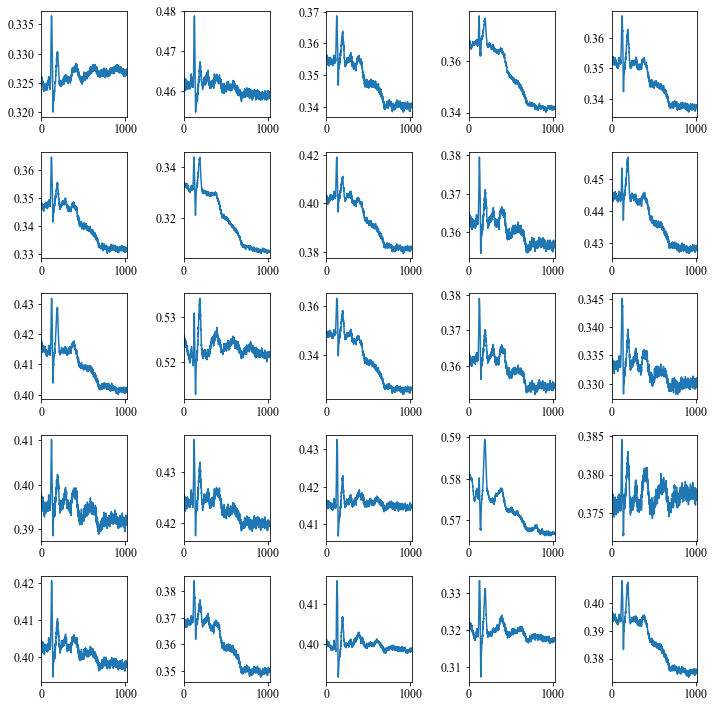

Epoch   301 / 2000
 3525 / 3525 - loss: 1.510281e-04 - Duration: 82 sec - ETA: 39 hour 2 min 13 sec
Epoch   302 / 2000
 3525 / 3525 - loss: 1.578294e-04 - Duration: 82 sec - ETA: 39 hour 0 min 51 sec
Epoch   303 / 2000
 3525 / 3525 - loss: 1.553498e-04 - Duration: 82 sec - ETA: 38 hour 59 min 29 sec
Epoch   304 / 2000
 3525 / 3525 - loss: 1.575409e-04 - Duration: 83 sec - ETA: 38 hour 58 min 7 sec
Epoch   305 / 2000
 3525 / 3525 - loss: 1.541266e-04 - Duration: 82 sec - ETA: 38 hour 56 min 46 sec
Epoch   306 / 2000
 3525 / 3525 - loss: 1.501236e-04 - Duration: 82 sec - ETA: 38 hour 55 min 24 sec
Epoch   307 / 2000
 3525 / 3525 - loss: 1.521809e-04 - Duration: 83 sec - ETA: 38 hour 54 min 3 sec
Epoch   308 / 2000
 3525 / 3525 - loss: 1.515579e-04 - Duration: 82 sec - ETA: 38 hour 52 min 41 sec
Epoch   309 / 2000
 3525 / 3525 - loss: 1.518429e-04 - Duration: 82 sec - ETA: 38 hour 51 min 19 sec
Epoch   310 / 2000
 3525 / 3525 - loss: 1.505658e-04 - Duration: 82 sec - ETA: 38 hour 49 min 5

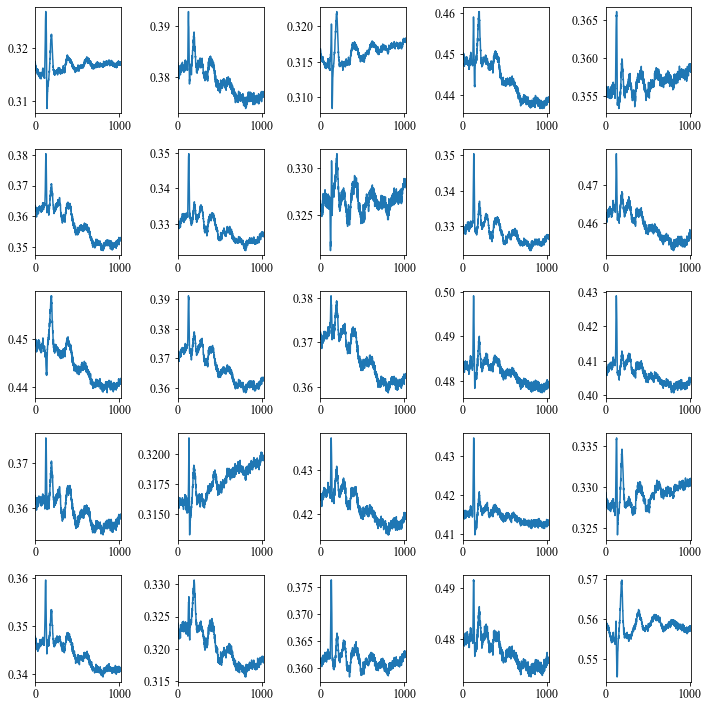

Epoch   311 / 2000
 3525 / 3525 - loss: 1.523706e-04 - Duration: 82 sec - ETA: 38 hour 48 min 34 sec
Epoch   312 / 2000
 3525 / 3525 - loss: 1.522815e-04 - Duration: 82 sec - ETA: 38 hour 47 min 13 sec
Epoch   313 / 2000
 3525 / 3525 - loss: 1.521167e-04 - Duration: 82 sec - ETA: 38 hour 45 min 50 sec
Epoch   314 / 2000
 3525 / 3525 - loss: 1.529943e-04 - Duration: 82 sec - ETA: 38 hour 44 min 27 sec
Epoch   315 / 2000
 3525 / 3525 - loss: 1.523866e-04 - Duration: 82 sec - ETA: 38 hour 43 min 5 sec
Epoch   316 / 2000
 3525 / 3525 - loss: 1.502549e-04 - Duration: 82 sec - ETA: 38 hour 41 min 43 sec
Epoch   317 / 2000
 3525 / 3525 - loss: 1.522810e-04 - Duration: 82 sec - ETA: 38 hour 40 min 20 sec
Epoch   318 / 2000
 3525 / 3525 - loss: 1.489466e-04 - Duration: 82 sec - ETA: 38 hour 38 min 58 sec
Epoch   319 / 2000
 3525 / 3525 - loss: 1.443647e-04 - Duration: 82 sec - ETA: 38 hour 37 min 35 sec
Epoch   320 / 2000
 3525 / 3525 - loss: 1.487275e-04 - Duration: 82 sec - ETA: 38 hour 36 mi

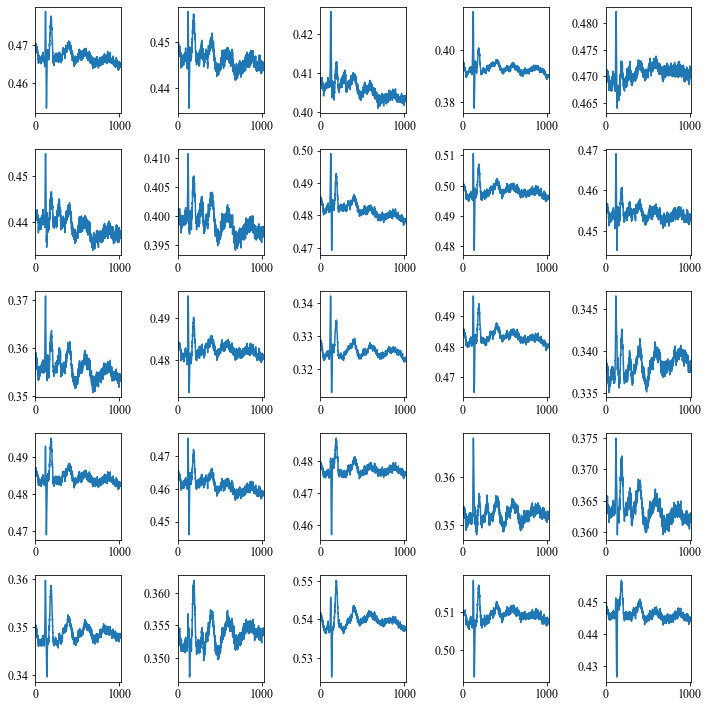

Epoch   321 / 2000
 3525 / 3525 - loss: 1.516899e-04 - Duration: 82 sec - ETA: 38 hour 34 min 48 sec
Epoch   322 / 2000
 3525 / 3525 - loss: 1.488687e-04 - Duration: 82 sec - ETA: 38 hour 33 min 25 sec
Epoch   323 / 2000
 3525 / 3525 - loss: 1.485889e-04 - Duration: 82 sec - ETA: 38 hour 32 min 1 sec
Epoch   324 / 2000
 3525 / 3525 - loss: 1.488000e-04 - Duration: 82 sec - ETA: 38 hour 30 min 38 sec
Epoch   325 / 2000
 3525 / 3525 - loss: 1.510579e-04 - Duration: 82 sec - ETA: 38 hour 29 min 15 sec
Epoch   326 / 2000
 3525 / 3525 - loss: 1.475006e-04 - Duration: 82 sec - ETA: 38 hour 27 min 52 sec
Epoch   327 / 2000
 3525 / 3525 - loss: 1.470573e-04 - Duration: 82 sec - ETA: 38 hour 26 min 29 sec
Epoch   328 / 2000
 3525 / 3525 - loss: 1.487458e-04 - Duration: 82 sec - ETA: 38 hour 25 min 6 sec
Epoch   329 / 2000
 3525 / 3525 - loss: 1.479186e-04 - Duration: 82 sec - ETA: 38 hour 23 min 43 sec
Epoch   330 / 2000
 3525 / 3525 - loss: 1.485104e-04 - Duration: 82 sec - ETA: 38 hour 22 min

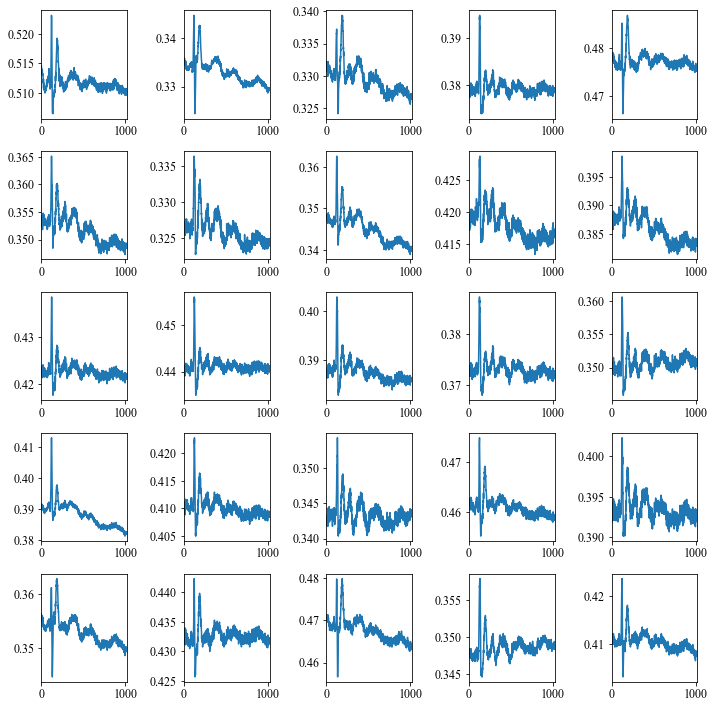

Epoch   331 / 2000
 3525 / 3525 - loss: 1.510674e-04 - Duration: 82 sec - ETA: 38 hour 20 min 57 sec
Epoch   332 / 2000
 3525 / 3525 - loss: 1.508210e-04 - Duration: 82 sec - ETA: 38 hour 19 min 34 sec
Epoch   333 / 2000
 3525 / 3525 - loss: 1.485739e-04 - Duration: 82 sec - ETA: 38 hour 18 min 12 sec
Epoch   334 / 2000
 3525 / 3525 - loss: 1.452232e-04 - Duration: 82 sec - ETA: 38 hour 16 min 49 sec
Epoch   335 / 2000
 3525 / 3525 - loss: 1.486373e-04 - Duration: 82 sec - ETA: 38 hour 15 min 26 sec
Epoch   336 / 2000
 3525 / 3525 - loss: 1.465418e-04 - Duration: 82 sec - ETA: 38 hour 14 min 3 sec
Epoch   337 / 2000
 3525 / 3525 - loss: 1.522564e-04 - Duration: 82 sec - ETA: 38 hour 12 min 39 sec
Epoch   338 / 2000
 3525 / 3525 - loss: 1.488913e-04 - Duration: 82 sec - ETA: 38 hour 11 min 16 sec
Epoch   339 / 2000
 3525 / 3525 - loss: 1.472082e-04 - Duration: 82 sec - ETA: 38 hour 9 min 53 sec
Epoch   340 / 2000
 3525 / 3525 - loss: 1.452980e-04 - Duration: 82 sec - ETA: 38 hour 8 min 

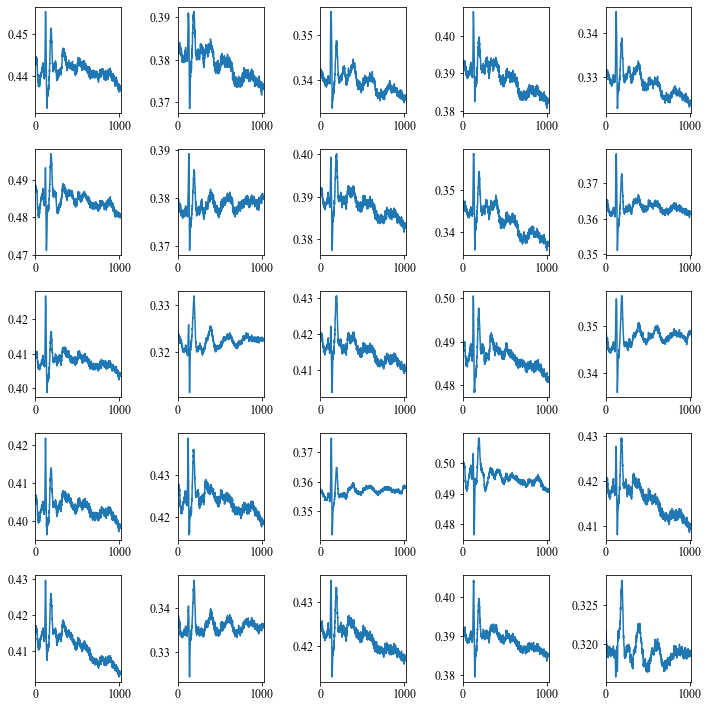

Epoch   341 / 2000
 3525 / 3525 - loss: 1.460775e-04 - Duration: 82 sec - ETA: 38 hour 7 min 8 sec
Epoch   342 / 2000
 3525 / 3525 - loss: 1.481996e-04 - Duration: 82 sec - ETA: 38 hour 5 min 45 sec
Epoch   343 / 2000
 3525 / 3525 - loss: 1.424231e-04 - Duration: 82 sec - ETA: 38 hour 4 min 22 sec
Epoch   344 / 2000
 3525 / 3525 - loss: 1.441055e-04 - Duration: 82 sec - ETA: 38 hour 2 min 59 sec
Epoch   345 / 2000
 3525 / 3525 - loss: 1.451549e-04 - Duration: 82 sec - ETA: 38 hour 1 min 36 sec
Epoch   346 / 2000
 3525 / 3525 - loss: 1.447128e-04 - Duration: 82 sec - ETA: 38 hour 0 min 13 sec
Epoch   347 / 2000
 3525 / 3525 - loss: 1.457021e-04 - Duration: 82 sec - ETA: 37 hour 58 min 51 sec
Epoch   348 / 2000
 3525 / 3525 - loss: 1.424331e-04 - Duration: 82 sec - ETA: 37 hour 57 min 28 sec
Epoch   349 / 2000
 3525 / 3525 - loss: 1.439891e-04 - Duration: 82 sec - ETA: 37 hour 56 min 5 sec
Epoch   350 / 2000
 3525 / 3525 - loss: 1.449127e-04 - Duration: 82 sec - ETA: 37 hour 54 min 42 se

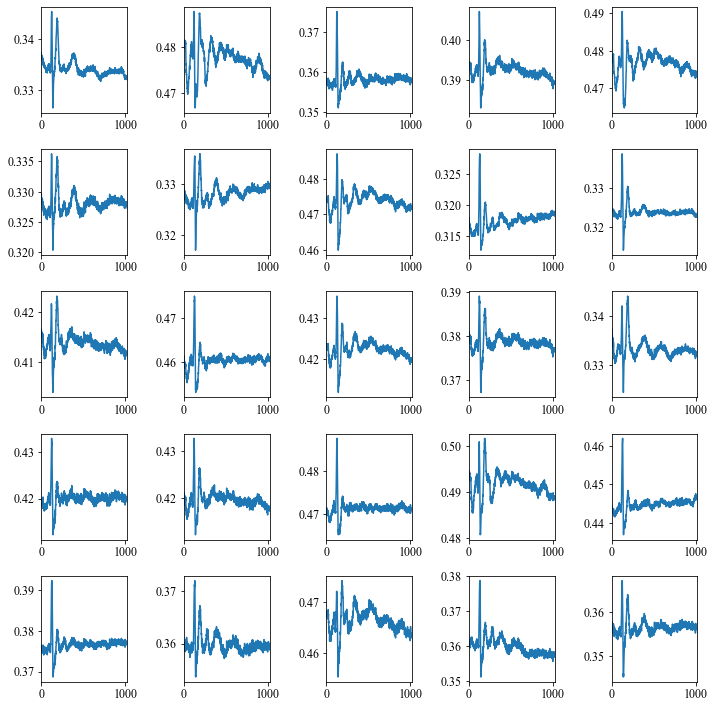

Epoch   351 / 2000
 3525 / 3525 - loss: 1.432721e-04 - Duration: 82 sec - ETA: 37 hour 53 min 20 sec
Epoch   352 / 2000
 3525 / 3525 - loss: 1.435839e-04 - Duration: 82 sec - ETA: 37 hour 51 min 57 sec
Epoch   353 / 2000
 3525 / 3525 - loss: 1.399825e-04 - Duration: 82 sec - ETA: 37 hour 50 min 33 sec
Epoch   354 / 2000
 3525 / 3525 - loss: 1.388684e-04 - Duration: 82 sec - ETA: 37 hour 49 min 11 sec
Epoch   355 / 2000
 3525 / 3525 - loss: 1.425418e-04 - Duration: 82 sec - ETA: 37 hour 47 min 47 sec
Epoch   356 / 2000
 3525 / 3525 - loss: 1.414015e-04 - Duration: 82 sec - ETA: 37 hour 46 min 24 sec
Epoch   357 / 2000
 3525 / 3525 - loss: 1.450281e-04 - Duration: 82 sec - ETA: 37 hour 45 min 1 sec
Epoch   358 / 2000
 3525 / 3525 - loss: 1.430866e-04 - Duration: 82 sec - ETA: 37 hour 43 min 37 sec
Epoch   359 / 2000
 3525 / 3525 - loss: 1.431993e-04 - Duration: 82 sec - ETA: 37 hour 42 min 14 sec
Epoch   360 / 2000
 3525 / 3525 - loss: 1.427548e-04 - Duration: 82 sec - ETA: 37 hour 40 mi

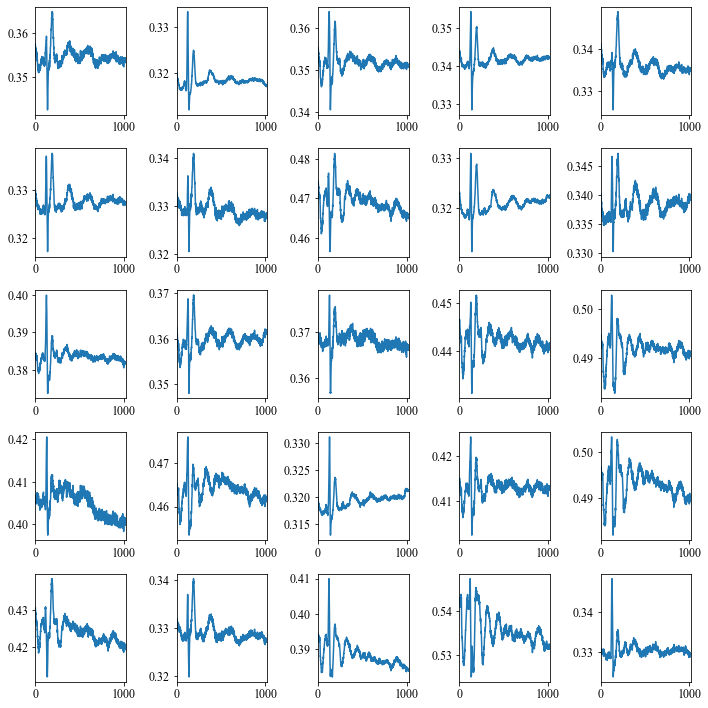

Epoch   361 / 2000
 3525 / 3525 - loss: 1.422822e-04 - Duration: 82 sec - ETA: 37 hour 39 min 28 sec
Epoch   362 / 2000
 3525 / 3525 - loss: 1.395693e-04 - Duration: 82 sec - ETA: 37 hour 38 min 5 sec
Epoch   363 / 2000
 3525 / 3525 - loss: 1.429574e-04 - Duration: 82 sec - ETA: 37 hour 36 min 42 sec
Epoch   364 / 2000
 3525 / 3525 - loss: 1.405662e-04 - Duration: 82 sec - ETA: 37 hour 35 min 19 sec
Epoch   365 / 2000
 3525 / 3525 - loss: 1.423606e-04 - Duration: 82 sec - ETA: 37 hour 33 min 56 sec
Epoch   366 / 2000
 3525 / 3525 - loss: 1.440515e-04 - Duration: 82 sec - ETA: 37 hour 32 min 33 sec
Epoch   367 / 2000
 3525 / 3525 - loss: 1.394116e-04 - Duration: 82 sec - ETA: 37 hour 31 min 10 sec
Epoch   368 / 2000
 3525 / 3525 - loss: 1.409180e-04 - Duration: 82 sec - ETA: 37 hour 29 min 47 sec
Epoch   369 / 2000
 3525 / 3525 - loss: 1.392350e-04 - Duration: 82 sec - ETA: 37 hour 28 min 24 sec
Epoch   370 / 2000
 3525 / 3525 - loss: 1.401950e-04 - Duration: 82 sec - ETA: 37 hour 27 mi

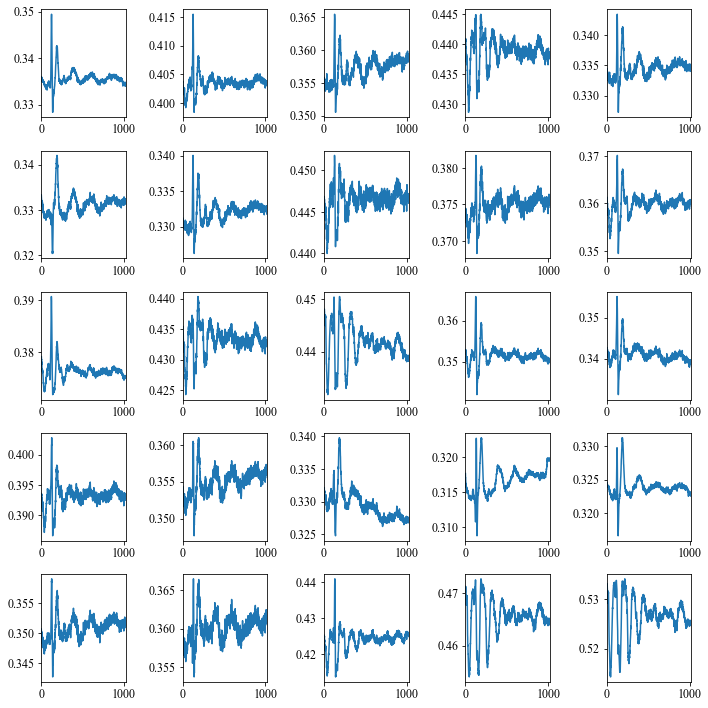

Epoch   371 / 2000
 3525 / 3525 - loss: 1.448378e-04 - Duration: 82 sec - ETA: 37 hour 25 min 38 sec
Epoch   372 / 2000
 3525 / 3525 - loss: 1.383923e-04 - Duration: 82 sec - ETA: 37 hour 24 min 15 sec
Epoch   373 / 2000
 3525 / 3525 - loss: 1.421515e-04 - Duration: 82 sec - ETA: 37 hour 22 min 53 sec
Epoch   374 / 2000
 3525 / 3525 - loss: 1.389858e-04 - Duration: 82 sec - ETA: 37 hour 21 min 29 sec
Epoch   375 / 2000
 3525 / 3525 - loss: 1.395825e-04 - Duration: 82 sec - ETA: 37 hour 20 min 6 sec
Epoch   376 / 2000
 3525 / 3525 - loss: 1.401823e-04 - Duration: 82 sec - ETA: 37 hour 18 min 43 sec
Epoch   377 / 2000
 3525 / 3525 - loss: 1.406760e-04 - Duration: 82 sec - ETA: 37 hour 17 min 20 sec
Epoch   378 / 2000
 3525 / 3525 - loss: 1.418385e-04 - Duration: 82 sec - ETA: 37 hour 15 min 58 sec
Epoch   379 / 2000
 3525 / 3525 - loss: 1.370179e-04 - Duration: 82 sec - ETA: 37 hour 14 min 35 sec
Epoch   380 / 2000
 3525 / 3525 - loss: 1.425598e-04 - Duration: 82 sec - ETA: 37 hour 13 mi

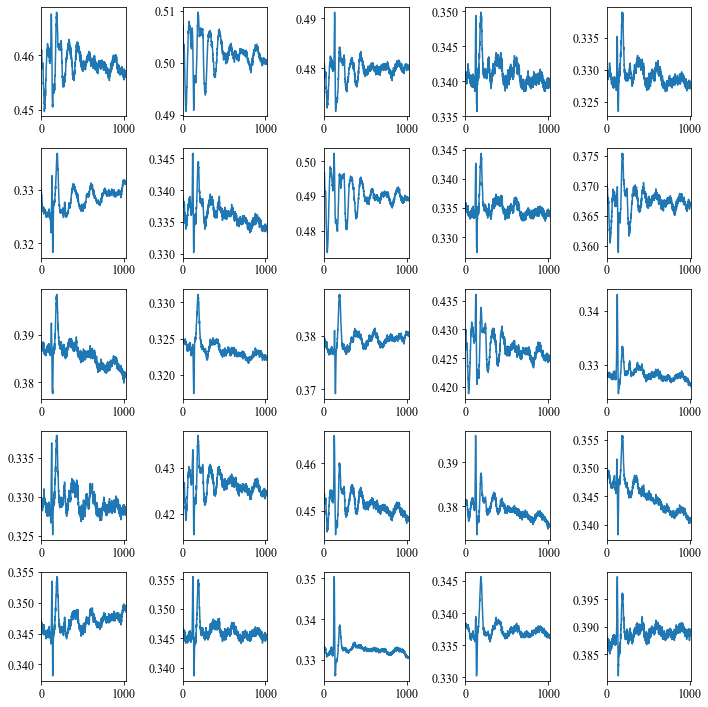

Epoch   381 / 2000
 3525 / 3525 - loss: 1.413254e-04 - Duration: 82 sec - ETA: 37 hour 11 min 49 sec
Epoch   382 / 2000
 3525 / 3525 - loss: 1.419442e-04 - Duration: 82 sec - ETA: 37 hour 10 min 26 sec
Epoch   383 / 2000
 3525 / 3525 - loss: 1.395828e-04 - Duration: 82 sec - ETA: 37 hour 9 min 4 sec
Epoch   384 / 2000
 3525 / 3525 - loss: 1.415743e-04 - Duration: 82 sec - ETA: 37 hour 7 min 41 sec
Epoch   385 / 2000
 3525 / 3525 - loss: 1.349438e-04 - Duration: 82 sec - ETA: 37 hour 6 min 18 sec
Epoch   386 / 2000
 3525 / 3525 - loss: 1.419956e-04 - Duration: 82 sec - ETA: 37 hour 4 min 54 sec
Epoch   387 / 2000
 3525 / 3525 - loss: 1.367504e-04 - Duration: 82 sec - ETA: 37 hour 3 min 32 sec
Epoch   388 / 2000
 3525 / 3525 - loss: 1.384029e-04 - Duration: 82 sec - ETA: 37 hour 2 min 9 sec
Epoch   389 / 2000
 3525 / 3525 - loss: 1.363367e-04 - Duration: 82 sec - ETA: 37 hour 0 min 46 sec
Epoch   390 / 2000
 3525 / 3525 - loss: 1.421652e-04 - Duration: 82 sec - ETA: 36 hour 59 min 23 sec

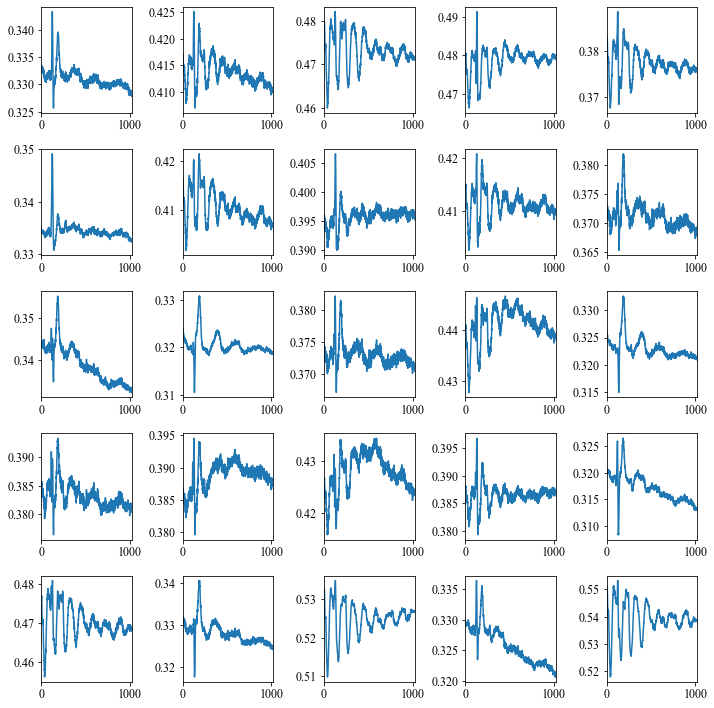

Epoch   391 / 2000
 3525 / 3525 - loss: 1.384310e-04 - Duration: 82 sec - ETA: 36 hour 58 min 0 sec
Epoch   392 / 2000
 3525 / 3525 - loss: 1.412272e-04 - Duration: 82 sec - ETA: 36 hour 56 min 37 sec
Epoch   393 / 2000
 3525 / 3525 - loss: 1.402390e-04 - Duration: 82 sec - ETA: 36 hour 55 min 14 sec
Epoch   394 / 2000
 3525 / 3525 - loss: 1.371733e-04 - Duration: 82 sec - ETA: 36 hour 53 min 52 sec
Epoch   395 / 2000
 3525 / 3525 - loss: 1.403043e-04 - Duration: 82 sec - ETA: 36 hour 52 min 29 sec
Epoch   396 / 2000
 3525 / 3525 - loss: 1.357095e-04 - Duration: 82 sec - ETA: 36 hour 51 min 5 sec
Epoch   397 / 2000
 3525 / 3525 - loss: 1.373953e-04 - Duration: 82 sec - ETA: 36 hour 49 min 42 sec
Epoch   398 / 2000
 3525 / 3525 - loss: 1.373647e-04 - Duration: 82 sec - ETA: 36 hour 48 min 19 sec
Epoch   399 / 2000
 3525 / 3525 - loss: 1.358409e-04 - Duration: 82 sec - ETA: 36 hour 46 min 56 sec
Epoch   400 / 2000
 3525 / 3525 - loss: 1.409858e-04 - Duration: 82 sec - ETA: 36 hour 45 min

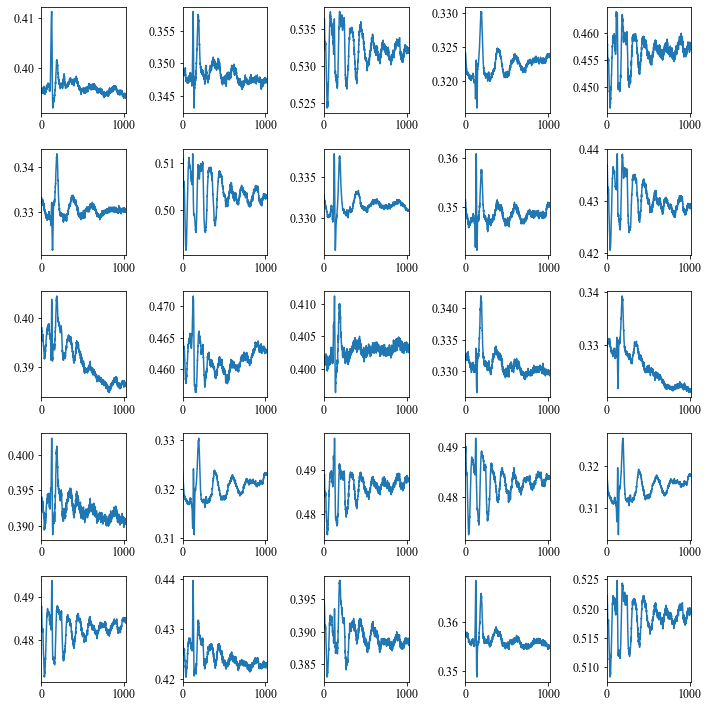

Epoch   401 / 2000
 3525 / 3525 - loss: 1.397172e-04 - Duration: 82 sec - ETA: 36 hour 44 min 10 sec
Epoch   402 / 2000
 3525 / 3525 - loss: 1.402700e-04 - Duration: 82 sec - ETA: 36 hour 42 min 47 sec
Epoch   403 / 2000
 3525 / 3525 - loss: 1.376646e-04 - Duration: 82 sec - ETA: 36 hour 41 min 25 sec
Epoch   404 / 2000
 3525 / 3525 - loss: 1.374221e-04 - Duration: 82 sec - ETA: 36 hour 40 min 2 sec
Epoch   405 / 2000
 3525 / 3525 - loss: 1.394011e-04 - Duration: 82 sec - ETA: 36 hour 38 min 40 sec
Epoch   406 / 2000
 3525 / 3525 - loss: 1.382851e-04 - Duration: 82 sec - ETA: 36 hour 37 min 16 sec
Epoch   407 / 2000
 3525 / 3525 - loss: 1.388274e-04 - Duration: 82 sec - ETA: 36 hour 35 min 54 sec
Epoch   408 / 2000
 3525 / 3525 - loss: 1.370882e-04 - Duration: 82 sec - ETA: 36 hour 34 min 31 sec
Epoch   409 / 2000
 3525 / 3525 - loss: 1.401206e-04 - Duration: 82 sec - ETA: 36 hour 33 min 8 sec
Epoch   410 / 2000
 3525 / 3525 - loss: 1.385305e-04 - Duration: 82 sec - ETA: 36 hour 31 min

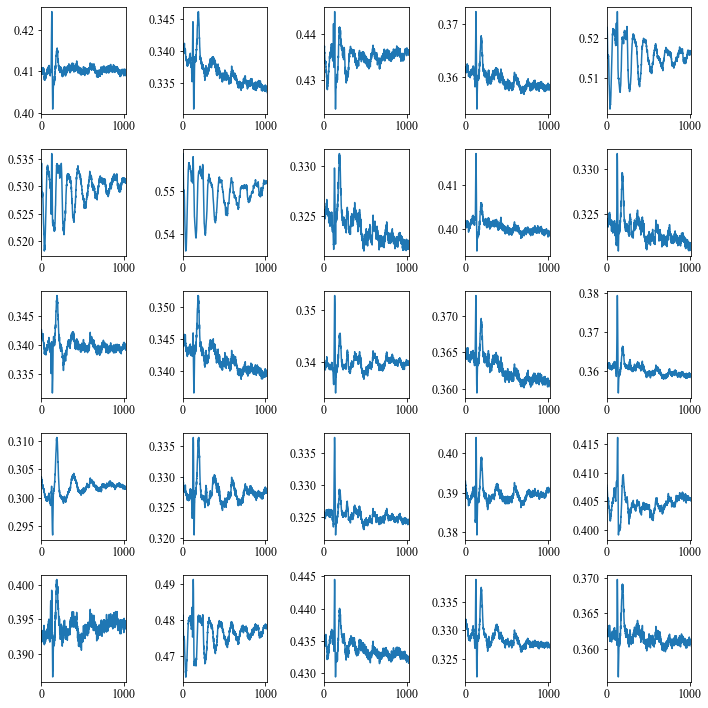

Epoch   411 / 2000
 3525 / 3525 - loss: 1.359454e-04 - Duration: 82 sec - ETA: 36 hour 30 min 22 sec
Epoch   412 / 2000
 3525 / 3525 - loss: 1.365810e-04 - Duration: 82 sec - ETA: 36 hour 28 min 59 sec
Epoch   413 / 2000
 3525 / 3525 - loss: 1.376001e-04 - Duration: 82 sec - ETA: 36 hour 27 min 36 sec
Epoch   414 / 2000
 3525 / 3525 - loss: 1.364294e-04 - Duration: 82 sec - ETA: 36 hour 26 min 13 sec
Epoch   415 / 2000
 3525 / 3525 - loss: 1.376277e-04 - Duration: 82 sec - ETA: 36 hour 24 min 50 sec
Epoch   416 / 2000
 3525 / 3525 - loss: 1.341688e-04 - Duration: 82 sec - ETA: 36 hour 23 min 27 sec
Epoch   417 / 2000
 3525 / 3525 - loss: 1.402123e-04 - Duration: 82 sec - ETA: 36 hour 22 min 4 sec
Epoch   418 / 2000
 3525 / 3525 - loss: 1.381719e-04 - Duration: 82 sec - ETA: 36 hour 20 min 41 sec
Epoch   419 / 2000
 3525 / 3525 - loss: 1.334330e-04 - Duration: 82 sec - ETA: 36 hour 19 min 18 sec
Epoch   420 / 2000
 3525 / 3525 - loss: 1.367925e-04 - Duration: 82 sec - ETA: 36 hour 17 mi

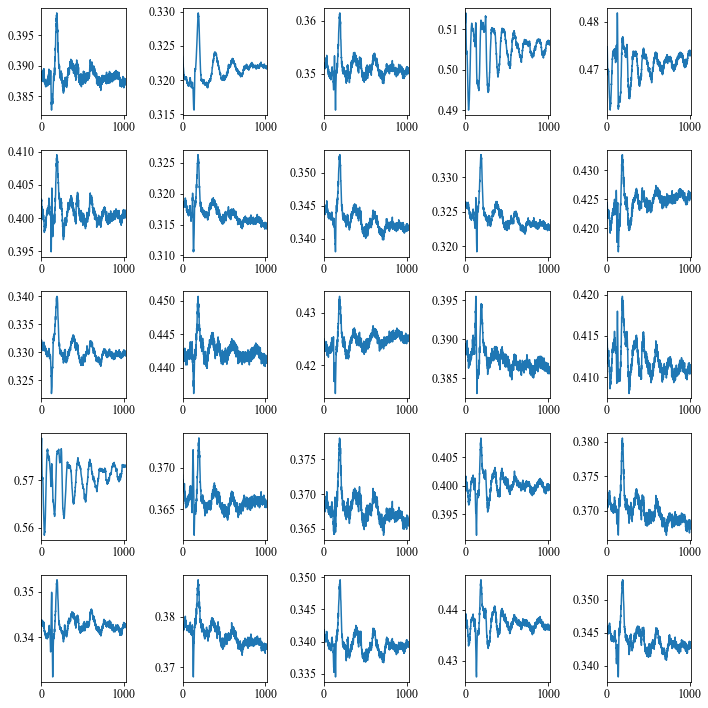

Epoch   421 / 2000
 3525 / 3525 - loss: 1.328176e-04 - Duration: 82 sec - ETA: 36 hour 16 min 32 sec
Epoch   422 / 2000
 3525 / 3525 - loss: 1.403155e-04 - Duration: 82 sec - ETA: 36 hour 15 min 9 sec
Epoch   423 / 2000
 3525 / 3525 - loss: 1.353526e-04 - Duration: 82 sec - ETA: 36 hour 13 min 46 sec
Epoch   424 / 2000
 3525 / 3525 - loss: 1.374350e-04 - Duration: 82 sec - ETA: 36 hour 12 min 24 sec
Epoch   425 / 2000
 3525 / 3525 - loss: 1.343242e-04 - Duration: 82 sec - ETA: 36 hour 11 min 1 sec
Epoch   426 / 2000
 3525 / 3525 - loss: 1.336095e-04 - Duration: 82 sec - ETA: 36 hour 9 min 38 sec
Epoch   427 / 2000
 3525 / 3525 - loss: 1.360036e-04 - Duration: 82 sec - ETA: 36 hour 8 min 16 sec
Epoch   428 / 2000
 3525 / 3525 - loss: 1.356895e-04 - Duration: 82 sec - ETA: 36 hour 6 min 53 sec
Epoch   429 / 2000
 3525 / 3525 - loss: 1.350083e-04 - Duration: 82 sec - ETA: 36 hour 5 min 30 sec
Epoch   430 / 2000
 3525 / 3525 - loss: 1.361875e-04 - Duration: 82 sec - ETA: 36 hour 4 min 8 se

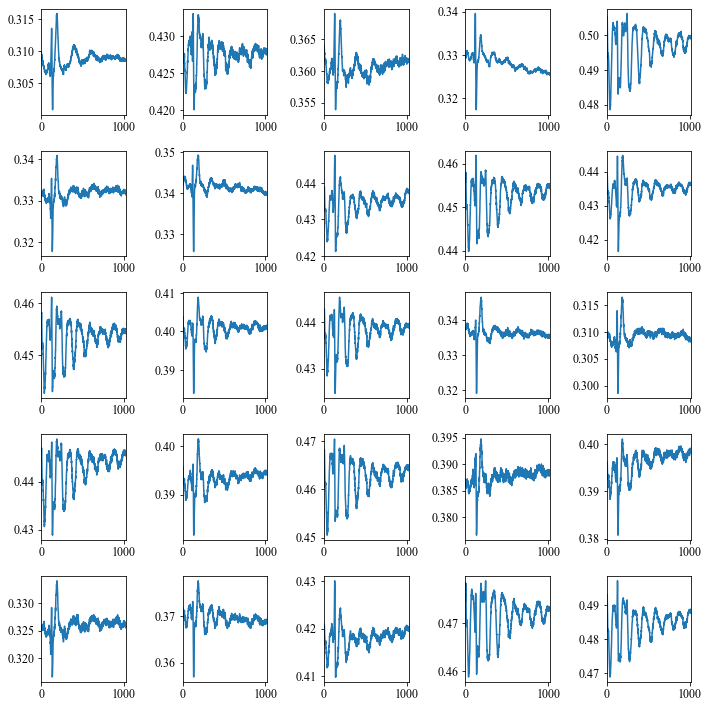

Epoch   431 / 2000
 3525 / 3525 - loss: 1.332490e-04 - Duration: 82 sec - ETA: 36 hour 2 min 44 sec
Epoch   432 / 2000
 3525 / 3525 - loss: 1.384011e-04 - Duration: 82 sec - ETA: 36 hour 1 min 22 sec
Epoch   433 / 2000
 3525 / 3525 - loss: 1.311453e-04 - Duration: 82 sec - ETA: 35 hour 59 min 59 sec
Epoch   434 / 2000
 3525 / 3525 - loss: 1.337180e-04 - Duration: 82 sec - ETA: 35 hour 58 min 36 sec
Epoch   435 / 2000
 3525 / 3525 - loss: 1.351398e-04 - Duration: 82 sec - ETA: 35 hour 57 min 13 sec
Epoch   436 / 2000
 3525 / 3525 - loss: 1.315938e-04 - Duration: 82 sec - ETA: 35 hour 55 min 50 sec
Epoch   437 / 2000
 3525 / 3525 - loss: 1.347360e-04 - Duration: 82 sec - ETA: 35 hour 54 min 26 sec
Epoch   438 / 2000
 3525 / 3525 - loss: 1.309004e-04 - Duration: 82 sec - ETA: 35 hour 53 min 4 sec
Epoch   439 / 2000
 3525 / 3525 - loss: 1.324832e-04 - Duration: 82 sec - ETA: 35 hour 51 min 41 sec
Epoch   440 / 2000
 3525 / 3525 - loss: 1.307927e-04 - Duration: 82 sec - ETA: 35 hour 50 min 

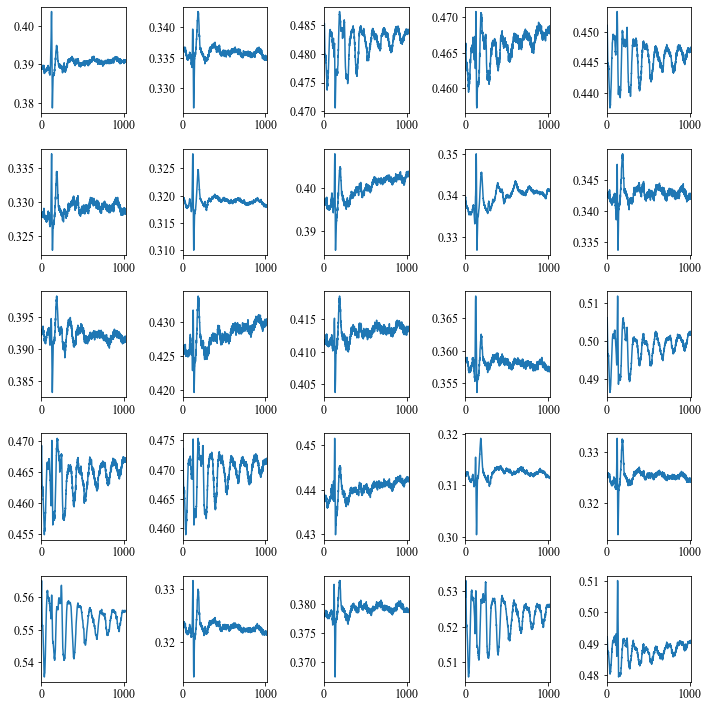

Epoch   441 / 2000
 3525 / 3525 - loss: 1.323796e-04 - Duration: 82 sec - ETA: 35 hour 48 min 55 sec
Epoch   442 / 2000
 3525 / 3525 - loss: 1.360212e-04 - Duration: 82 sec - ETA: 35 hour 47 min 33 sec
Epoch   443 / 2000
 3525 / 3525 - loss: 1.335237e-04 - Duration: 82 sec - ETA: 35 hour 46 min 9 sec
Epoch   444 / 2000
 3525 / 3525 - loss: 1.323706e-04 - Duration: 82 sec - ETA: 35 hour 44 min 45 sec
Epoch   445 / 2000
 3525 / 3525 - loss: 1.339441e-04 - Duration: 82 sec - ETA: 35 hour 43 min 22 sec
Epoch   446 / 2000
 3525 / 3525 - loss: 1.357901e-04 - Duration: 82 sec - ETA: 35 hour 41 min 58 sec
Epoch   447 / 2000
 3525 / 3525 - loss: 1.332553e-04 - Duration: 82 sec - ETA: 35 hour 40 min 35 sec
Epoch   448 / 2000
 3525 / 3525 - loss: 1.331996e-04 - Duration: 82 sec - ETA: 35 hour 39 min 12 sec
Epoch   449 / 2000
 3525 / 3525 - loss: 1.368680e-04 - Duration: 82 sec - ETA: 35 hour 37 min 50 sec
Epoch   450 / 2000
 3525 / 3525 - loss: 1.364941e-04 - Duration: 82 sec - ETA: 35 hour 36 mi

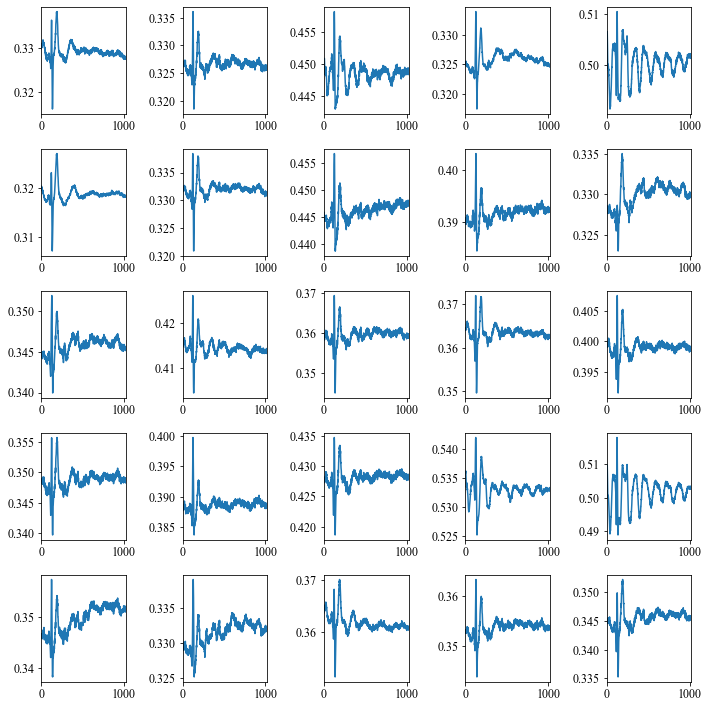

Epoch   451 / 2000
 3525 / 3525 - loss: 1.352447e-04 - Duration: 82 sec - ETA: 35 hour 35 min 3 sec
Epoch   452 / 2000
 3525 / 3525 - loss: 1.337850e-04 - Duration: 82 sec - ETA: 35 hour 33 min 40 sec
Epoch   453 / 2000
 3525 / 3525 - loss: 1.329222e-04 - Duration: 82 sec - ETA: 35 hour 32 min 17 sec
Epoch   454 / 2000
 3525 / 3525 - loss: 1.341497e-04 - Duration: 82 sec - ETA: 35 hour 30 min 54 sec
Epoch   455 / 2000
 3525 / 3525 - loss: 1.336865e-04 - Duration: 82 sec - ETA: 35 hour 29 min 31 sec
Epoch   456 / 2000
 3525 / 3525 - loss: 1.292187e-04 - Duration: 82 sec - ETA: 35 hour 28 min 8 sec
Epoch   457 / 2000
 3525 / 3525 - loss: 1.299057e-04 - Duration: 82 sec - ETA: 35 hour 26 min 45 sec
Epoch   458 / 2000
 3525 / 3525 - loss: 1.311594e-04 - Duration: 82 sec - ETA: 35 hour 25 min 21 sec
Epoch   459 / 2000
 3525 / 3525 - loss: 1.327570e-04 - Duration: 82 sec - ETA: 35 hour 23 min 59 sec
Epoch   460 / 2000
 3525 / 3525 - loss: 1.329541e-04 - Duration: 82 sec - ETA: 35 hour 22 min

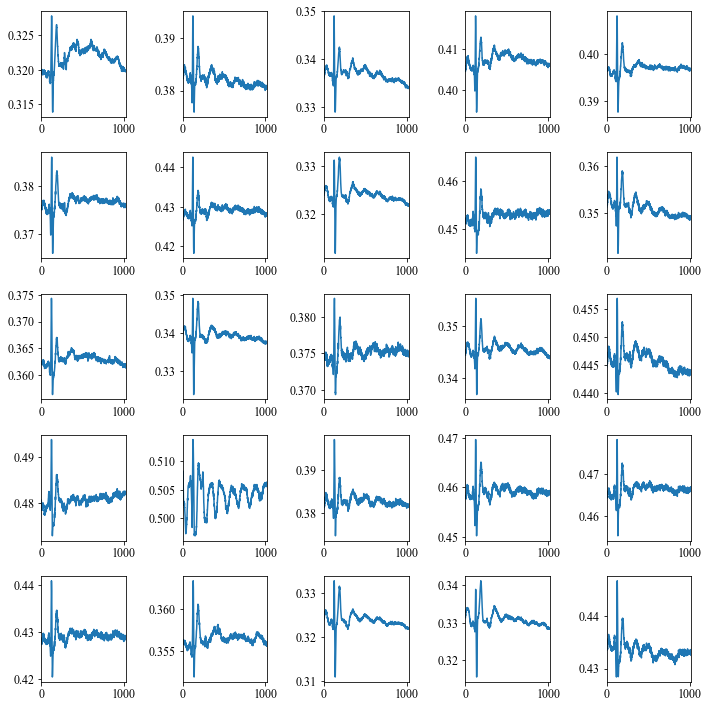

Epoch   461 / 2000
 3525 / 3525 - loss: 1.318554e-04 - Duration: 82 sec - ETA: 35 hour 21 min 13 sec
Epoch   462 / 2000
 3525 / 3525 - loss: 1.327298e-04 - Duration: 82 sec - ETA: 35 hour 19 min 51 sec
Epoch   463 / 2000
 3525 / 3525 - loss: 1.330115e-04 - Duration: 82 sec - ETA: 35 hour 18 min 27 sec
Epoch   464 / 2000
 3525 / 3525 - loss: 1.315465e-04 - Duration: 82 sec - ETA: 35 hour 17 min 5 sec
Epoch   465 / 2000
 3525 / 3525 - loss: 1.305151e-04 - Duration: 82 sec - ETA: 35 hour 15 min 43 sec
Epoch   466 / 2000
 3525 / 3525 - loss: 1.280497e-04 - Duration: 82 sec - ETA: 35 hour 14 min 20 sec
Epoch   467 / 2000
 3525 / 3525 - loss: 1.315227e-04 - Duration: 82 sec - ETA: 35 hour 12 min 57 sec
Epoch   468 / 2000
 3525 / 3525 - loss: 1.286227e-04 - Duration: 82 sec - ETA: 35 hour 11 min 35 sec
Epoch   469 / 2000
 3525 / 3525 - loss: 1.339489e-04 - Duration: 82 sec - ETA: 35 hour 10 min 12 sec
Epoch   470 / 2000
 3525 / 3525 - loss: 1.325119e-04 - Duration: 82 sec - ETA: 35 hour 8 min

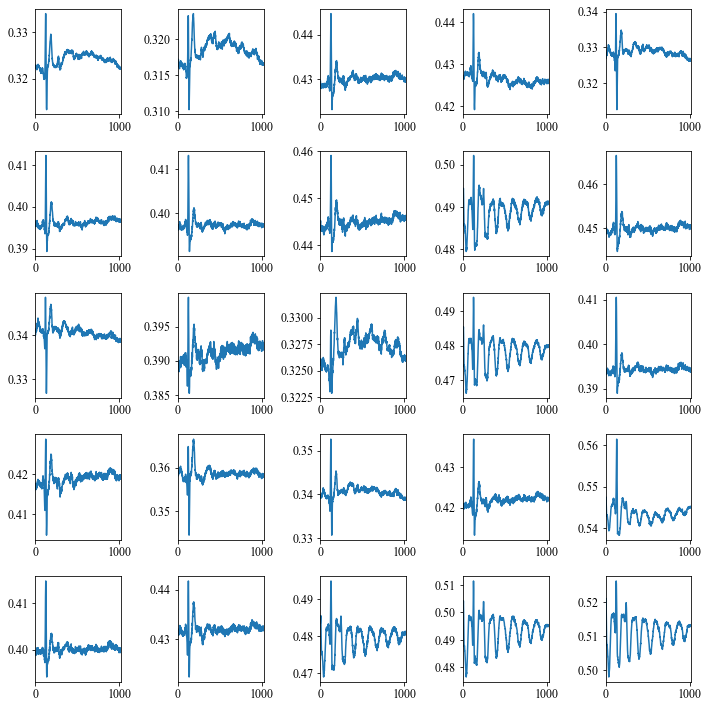

Epoch   471 / 2000
 3525 / 3525 - loss: 1.292529e-04 - Duration: 82 sec - ETA: 35 hour 7 min 27 sec
Epoch   472 / 2000
 3525 / 3525 - loss: 1.300840e-04 - Duration: 82 sec - ETA: 35 hour 6 min 3 sec
Epoch   473 / 2000
 3525 / 3525 - loss: 1.280930e-04 - Duration: 82 sec - ETA: 35 hour 4 min 40 sec
Epoch   474 / 2000
 3525 / 3525 - loss: 1.332342e-04 - Duration: 82 sec - ETA: 35 hour 3 min 17 sec
Epoch   475 / 2000
 3525 / 3525 - loss: 1.321491e-04 - Duration: 82 sec - ETA: 35 hour 1 min 54 sec
Epoch   476 / 2000
 3525 / 3525 - loss: 1.310793e-04 - Duration: 82 sec - ETA: 35 hour 0 min 31 sec
Epoch   477 / 2000
 3525 / 3525 - loss: 1.305188e-04 - Duration: 82 sec - ETA: 34 hour 59 min 9 sec
Epoch   478 / 2000
 3525 / 3525 - loss: 1.283481e-04 - Duration: 82 sec - ETA: 34 hour 57 min 46 sec
Epoch   479 / 2000
 3525 / 3525 - loss: 1.277392e-04 - Duration: 82 sec - ETA: 34 hour 56 min 23 sec
Epoch   480 / 2000
 3525 / 3525 - loss: 1.274824e-04 - Duration: 82 sec - ETA: 34 hour 55 min 0 sec

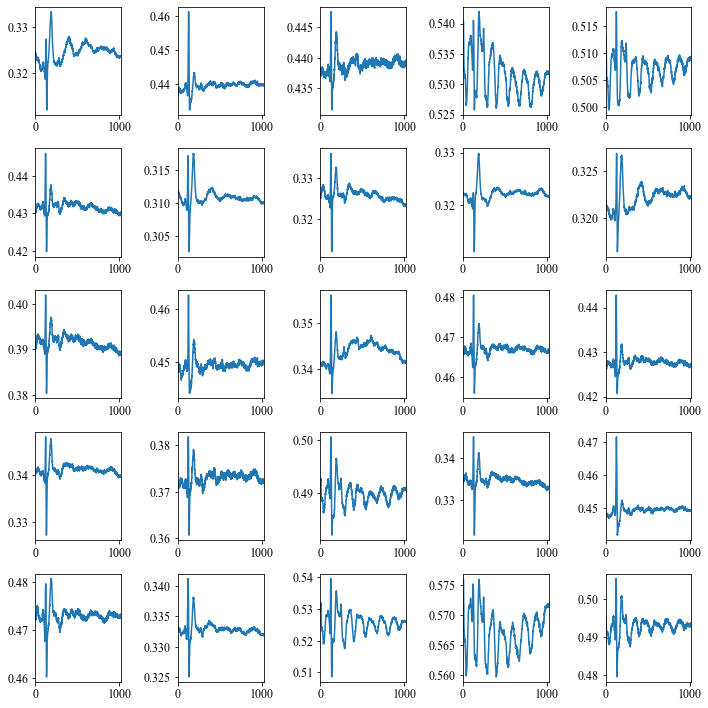

Epoch   481 / 2000
 3525 / 3525 - loss: 1.332491e-04 - Duration: 82 sec - ETA: 34 hour 53 min 37 sec
Epoch   482 / 2000
 3525 / 3525 - loss: 1.319213e-04 - Duration: 82 sec - ETA: 34 hour 52 min 15 sec
Epoch   483 / 2000
 3525 / 3525 - loss: 1.254445e-04 - Duration: 82 sec - ETA: 34 hour 50 min 52 sec
Epoch   484 / 2000
 3525 / 3525 - loss: 1.308891e-04 - Duration: 82 sec - ETA: 34 hour 49 min 30 sec
Epoch   485 / 2000
 3525 / 3525 - loss: 1.310837e-04 - Duration: 82 sec - ETA: 34 hour 48 min 7 sec
Epoch   486 / 2000
 3525 / 3525 - loss: 1.321519e-04 - Duration: 82 sec - ETA: 34 hour 46 min 44 sec
Epoch   487 / 2000
 3525 / 3525 - loss: 1.311881e-04 - Duration: 82 sec - ETA: 34 hour 45 min 21 sec
Epoch   488 / 2000
 3525 / 3525 - loss: 1.307679e-04 - Duration: 82 sec - ETA: 34 hour 43 min 58 sec
Epoch   489 / 2000
 3525 / 3525 - loss: 1.290151e-04 - Duration: 82 sec - ETA: 34 hour 42 min 35 sec
Epoch   490 / 2000
 3525 / 3525 - loss: 1.271412e-04 - Duration: 82 sec - ETA: 34 hour 41 mi

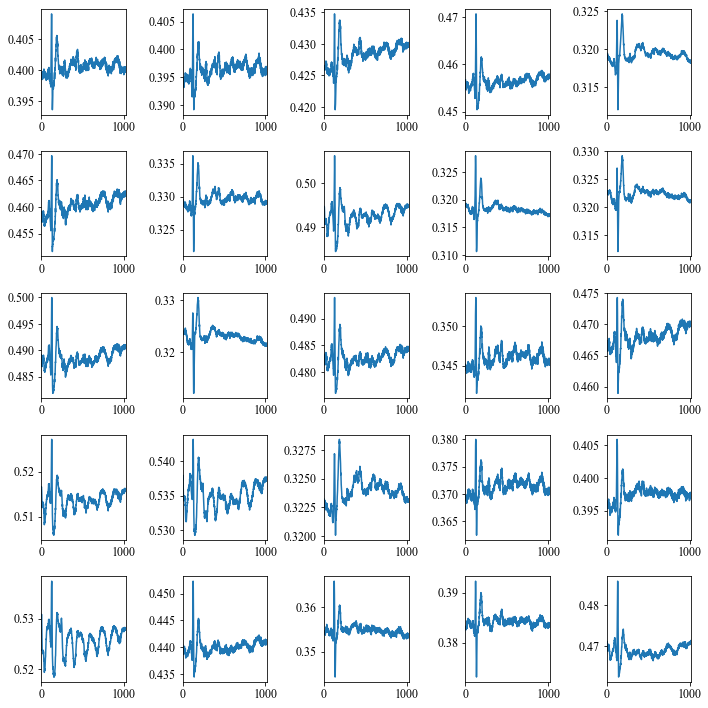

Epoch   491 / 2000
 3525 / 3525 - loss: 1.277273e-04 - Duration: 82 sec - ETA: 34 hour 39 min 49 sec
Epoch   492 / 2000
 3525 / 3525 - loss: 1.283512e-04 - Duration: 82 sec - ETA: 34 hour 38 min 26 sec
Epoch   493 / 2000
 3525 / 3525 - loss: 1.257515e-04 - Duration: 82 sec - ETA: 34 hour 37 min 4 sec
Epoch   494 / 2000
 3525 / 3525 - loss: 1.293593e-04 - Duration: 82 sec - ETA: 34 hour 35 min 41 sec
Epoch   495 / 2000
 3525 / 3525 - loss: 1.281649e-04 - Duration: 83 sec - ETA: 34 hour 34 min 19 sec
Epoch   496 / 2000
 3525 / 3525 - loss: 1.284948e-04 - Duration: 82 sec - ETA: 34 hour 32 min 56 sec
Epoch   497 / 2000
 3525 / 3525 - loss: 1.282137e-04 - Duration: 82 sec - ETA: 34 hour 31 min 33 sec
Epoch   498 / 2000
 3525 / 3525 - loss: 1.308973e-04 - Duration: 83 sec - ETA: 34 hour 30 min 12 sec
Epoch   499 / 2000
 3525 / 3525 - loss: 1.291412e-04 - Duration: 82 sec - ETA: 34 hour 28 min 49 sec
Epoch   500 / 2000
 3525 / 3525 - loss: 1.265171e-04 - Duration: 82 sec - ETA: 34 hour 27 mi

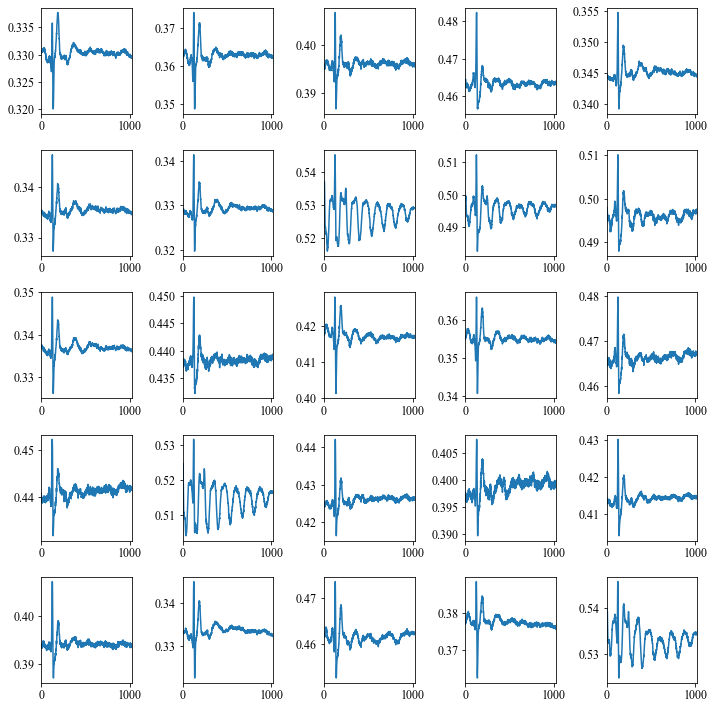

Epoch   501 / 2000
 3525 / 3525 - loss: 1.297086e-04 - Duration: 82 sec - ETA: 34 hour 26 min 3 sec
Epoch   502 / 2000
 3525 / 3525 - loss: 1.265442e-04 - Duration: 82 sec - ETA: 34 hour 24 min 40 sec
Epoch   503 / 2000
 3525 / 3525 - loss: 1.286663e-04 - Duration: 82 sec - ETA: 34 hour 23 min 17 sec
Epoch   504 / 2000
 3525 / 3525 - loss: 1.261537e-04 - Duration: 82 sec - ETA: 34 hour 21 min 54 sec
Epoch   505 / 2000
 3525 / 3525 - loss: 1.274807e-04 - Duration: 82 sec - ETA: 34 hour 20 min 31 sec
Epoch   506 / 2000
 3525 / 3525 - loss: 1.305583e-04 - Duration: 82 sec - ETA: 34 hour 19 min 8 sec
Epoch   507 / 2000
 3525 / 3525 - loss: 1.267698e-04 - Duration: 82 sec - ETA: 34 hour 17 min 45 sec
Epoch   508 / 2000
 3525 / 3525 - loss: 1.289573e-04 - Duration: 82 sec - ETA: 34 hour 16 min 23 sec
Epoch   509 / 2000
 3525 / 3525 - loss: 1.291935e-04 - Duration: 82 sec - ETA: 34 hour 15 min 0 sec
Epoch   510 / 2000
 3525 / 3525 - loss: 1.295743e-04 - Duration: 82 sec - ETA: 34 hour 13 min 

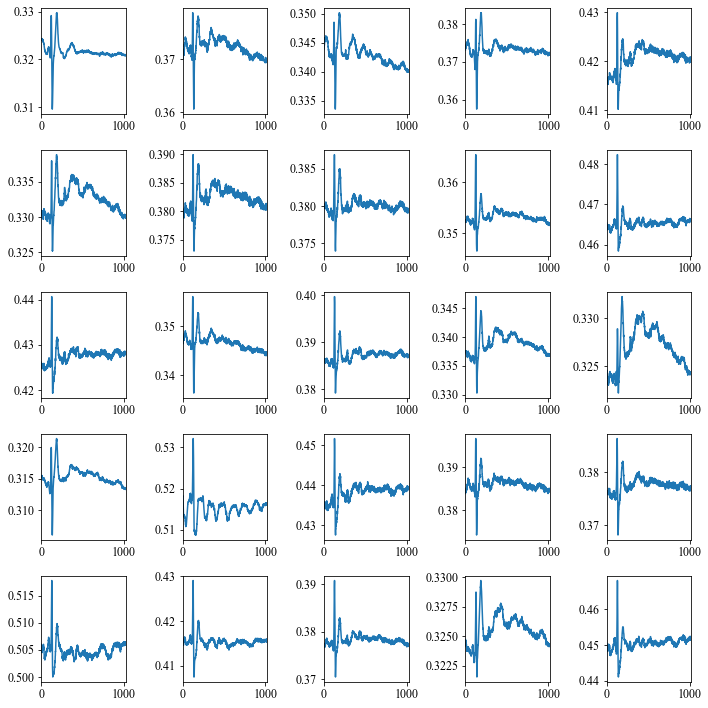

Epoch   511 / 2000
 3525 / 3525 - loss: 1.280073e-04 - Duration: 82 sec - ETA: 34 hour 12 min 15 sec
Epoch   512 / 2000
 3525 / 3525 - loss: 1.281946e-04 - Duration: 82 sec - ETA: 34 hour 10 min 52 sec
Epoch   513 / 2000
 3525 / 3525 - loss: 1.275228e-04 - Duration: 82 sec - ETA: 34 hour 9 min 29 sec
Epoch   514 / 2000
 3525 / 3525 - loss: 1.275732e-04 - Duration: 82 sec - ETA: 34 hour 8 min 7 sec
Epoch   515 / 2000
 3525 / 3525 - loss: 1.248658e-04 - Duration: 82 sec - ETA: 34 hour 6 min 44 sec
Epoch   516 / 2000
 3525 / 3525 - loss: 1.253153e-04 - Duration: 82 sec - ETA: 34 hour 5 min 21 sec
Epoch   517 / 2000
 3525 / 3525 - loss: 1.262641e-04 - Duration: 82 sec - ETA: 34 hour 3 min 58 sec
Epoch   518 / 2000
 3525 / 3525 - loss: 1.254747e-04 - Duration: 82 sec - ETA: 34 hour 2 min 35 sec
Epoch   519 / 2000
 3525 / 3525 - loss: 1.217550e-04 - Duration: 82 sec - ETA: 34 hour 1 min 12 sec
Epoch   520 / 2000
 3525 / 3525 - loss: 1.286756e-04 - Duration: 82 sec - ETA: 33 hour 59 min 48 se

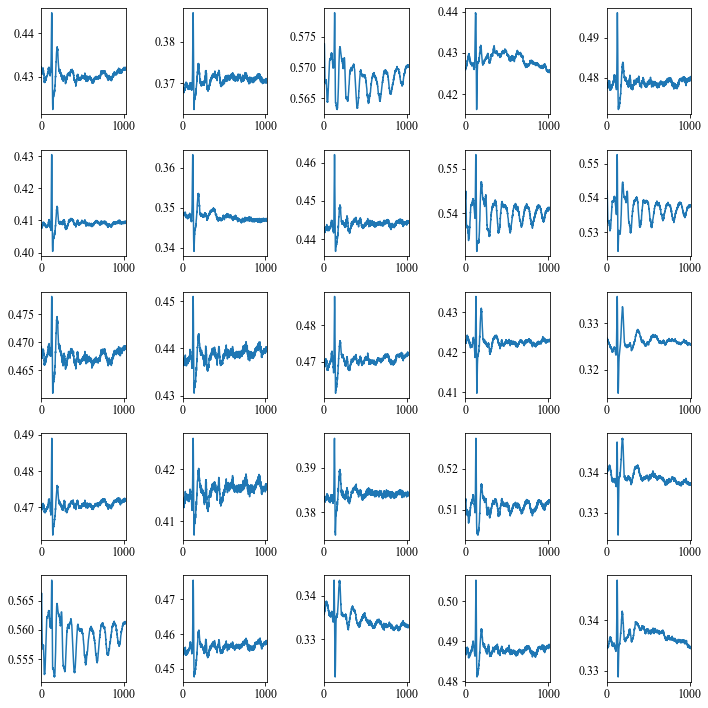

Epoch   521 / 2000
 3525 / 3525 - loss: 1.265052e-04 - Duration: 82 sec - ETA: 33 hour 58 min 26 sec
Epoch   522 / 2000
 3525 / 3525 - loss: 1.285043e-04 - Duration: 82 sec - ETA: 33 hour 57 min 3 sec
Epoch   523 / 2000
 3525 / 3525 - loss: 1.246787e-04 - Duration: 82 sec - ETA: 33 hour 55 min 40 sec
Epoch   524 / 2000
 3525 / 3525 - loss: 1.242871e-04 - Duration: 82 sec - ETA: 33 hour 54 min 17 sec
Epoch   525 / 2000
 3525 / 3525 - loss: 1.271208e-04 - Duration: 83 sec - ETA: 33 hour 52 min 56 sec
Epoch   526 / 2000
 3525 / 3525 - loss: 1.248405e-04 - Duration: 82 sec - ETA: 33 hour 51 min 33 sec
Epoch   527 / 2000
 3525 / 3525 - loss: 1.280592e-04 - Duration: 82 sec - ETA: 33 hour 50 min 11 sec
Epoch   528 / 2000
 3525 / 3525 - loss: 1.257932e-04 - Duration: 84 sec - ETA: 33 hour 48 min 53 sec
Epoch   529 / 2000
 3525 / 3525 - loss: 1.257214e-04 - Duration: 82 sec - ETA: 33 hour 47 min 30 sec
Epoch   530 / 2000
 3525 / 3525 - loss: 1.265413e-04 - Duration: 82 sec - ETA: 33 hour 46 mi

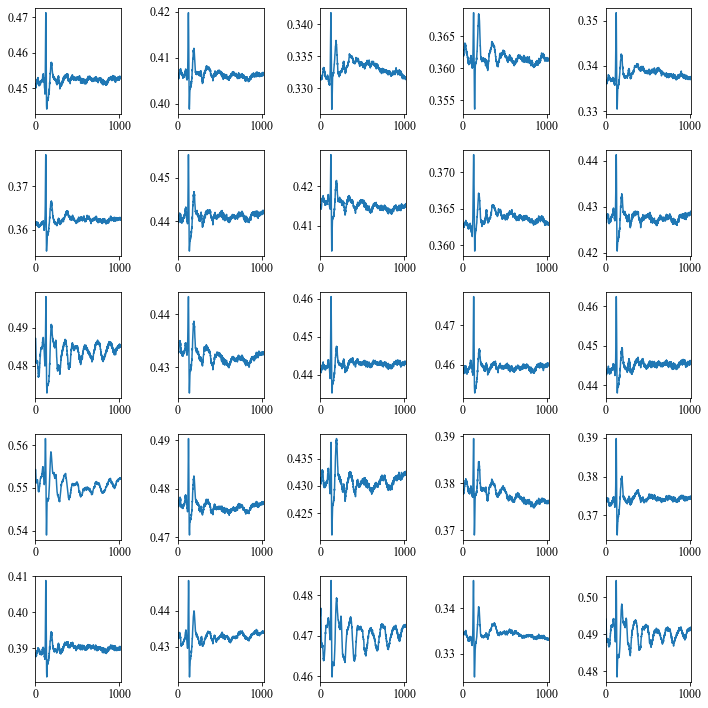

Epoch   531 / 2000
 3525 / 3525 - loss: 1.263253e-04 - Duration: 82 sec - ETA: 33 hour 44 min 45 sec
Epoch   532 / 2000
 3525 / 3525 - loss: 1.240382e-04 - Duration: 82 sec - ETA: 33 hour 43 min 23 sec
Epoch   533 / 2000
 3525 / 3525 - loss: 1.240407e-04 - Duration: 82 sec - ETA: 33 hour 42 min 1 sec
Epoch   534 / 2000
 3525 / 3525 - loss: 1.228388e-04 - Duration: 82 sec - ETA: 33 hour 40 min 39 sec
Epoch   535 / 2000
 3525 / 3525 - loss: 1.241830e-04 - Duration: 82 sec - ETA: 33 hour 39 min 16 sec
Epoch   536 / 2000
 3525 / 3525 - loss: 1.219516e-04 - Duration: 82 sec - ETA: 33 hour 37 min 54 sec
Epoch   537 / 2000
 3525 / 3525 - loss: 1.266062e-04 - Duration: 82 sec - ETA: 33 hour 36 min 31 sec
Epoch   538 / 2000
 3525 / 3525 - loss: 1.233443e-04 - Duration: 82 sec - ETA: 33 hour 35 min 9 sec
Epoch   539 / 2000
 3525 / 3525 - loss: 1.259948e-04 - Duration: 83 sec - ETA: 33 hour 33 min 47 sec
Epoch   540 / 2000
 3525 / 3525 - loss: 1.248499e-04 - Duration: 83 sec - ETA: 33 hour 32 min

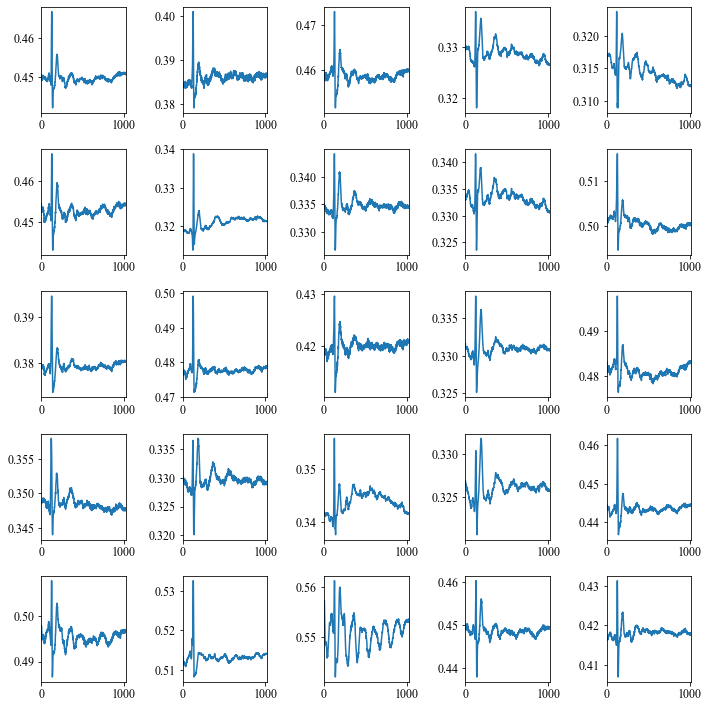

Epoch   541 / 2000
 3525 / 3525 - loss: 1.247838e-04 - Duration: 83 sec - ETA: 33 hour 31 min 4 sec
Epoch   542 / 2000
 3525 / 3525 - loss: 1.262314e-04 - Duration: 82 sec - ETA: 33 hour 29 min 42 sec
Epoch   543 / 2000
 3525 / 3525 - loss: 1.226515e-04 - Duration: 82 sec - ETA: 33 hour 28 min 20 sec
Epoch   544 / 2000
 3525 / 3525 - loss: 1.240320e-04 - Duration: 83 sec - ETA: 33 hour 26 min 58 sec
Epoch   545 / 2000
 3525 / 3525 - loss: 1.269529e-04 - Duration: 82 sec - ETA: 33 hour 25 min 35 sec
Epoch   546 / 2000
 3525 / 3525 - loss: 1.226957e-04 - Duration: 82 sec - ETA: 33 hour 24 min 13 sec
Epoch   547 / 2000
 3525 / 3525 - loss: 1.237367e-04 - Duration: 82 sec - ETA: 33 hour 22 min 51 sec
Epoch   548 / 2000
 3525 / 3525 - loss: 1.261385e-04 - Duration: 82 sec - ETA: 33 hour 21 min 28 sec
Epoch   549 / 2000
 3525 / 3525 - loss: 1.256325e-04 - Duration: 82 sec - ETA: 33 hour 20 min 6 sec
Epoch   550 / 2000
 3525 / 3525 - loss: 1.255062e-04 - Duration: 82 sec - ETA: 33 hour 18 min

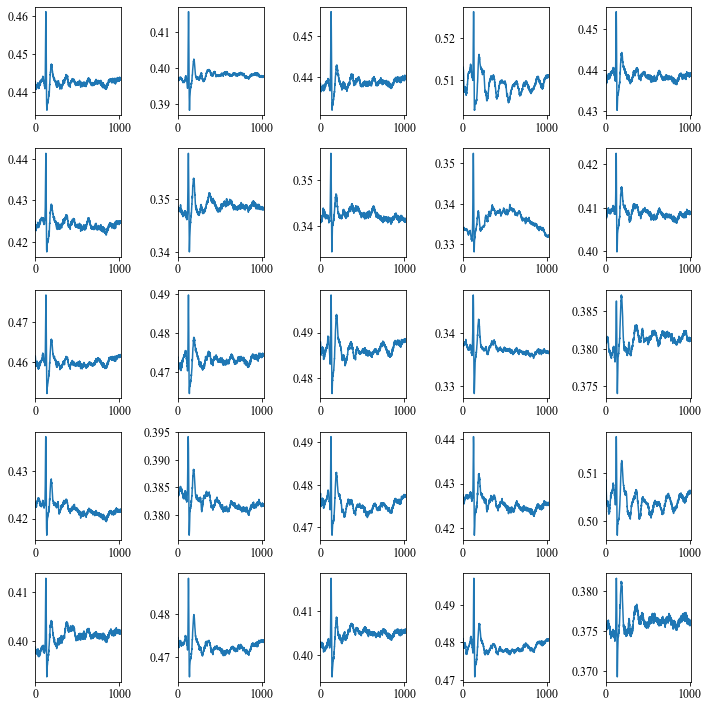

Epoch   551 / 2000
 3525 / 3525 - loss: 1.238550e-04 - Duration: 82 sec - ETA: 33 hour 17 min 21 sec
Epoch   552 / 2000
 3525 / 3525 - loss: 1.235795e-04 - Duration: 82 sec - ETA: 33 hour 15 min 58 sec
Epoch   553 / 2000
 3525 / 3525 - loss: 1.243027e-04 - Duration: 82 sec - ETA: 33 hour 14 min 36 sec
Epoch   554 / 2000
 3525 / 3525 - loss: 1.248421e-04 - Duration: 82 sec - ETA: 33 hour 13 min 13 sec
Epoch   555 / 2000
 3525 / 3525 - loss: 1.239998e-04 - Duration: 82 sec - ETA: 33 hour 11 min 50 sec
Epoch   556 / 2000
 3525 / 3525 - loss: 1.228830e-04 - Duration: 82 sec - ETA: 33 hour 10 min 28 sec
Epoch   557 / 2000
 3525 / 3525 - loss: 1.256095e-04 - Duration: 82 sec - ETA: 33 hour 9 min 5 sec
Epoch   558 / 2000
 3525 / 3525 - loss: 1.219421e-04 - Duration: 82 sec - ETA: 33 hour 7 min 43 sec
Epoch   559 / 2000
 3525 / 3525 - loss: 1.239072e-04 - Duration: 82 sec - ETA: 33 hour 6 min 20 sec
Epoch   560 / 2000
 3525 / 3525 - loss: 1.242678e-04 - Duration: 82 sec - ETA: 33 hour 4 min 57

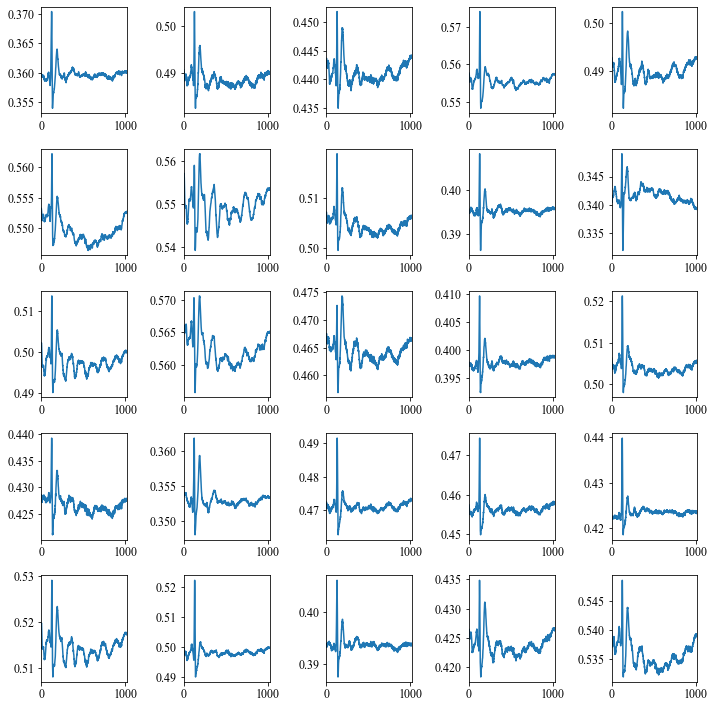

Epoch   561 / 2000
 3525 / 3525 - loss: 1.245583e-04 - Duration: 82 sec - ETA: 33 hour 3 min 35 sec
Epoch   562 / 2000
 3525 / 3525 - loss: 1.207069e-04 - Duration: 82 sec - ETA: 33 hour 2 min 13 sec
Epoch   563 / 2000
 3525 / 3525 - loss: 1.194927e-04 - Duration: 82 sec - ETA: 33 hour 0 min 50 sec
Epoch   564 / 2000
 3525 / 3525 - loss: 1.223959e-04 - Duration: 82 sec - ETA: 32 hour 59 min 28 sec
Epoch   565 / 2000
 3525 / 3525 - loss: 1.248126e-04 - Duration: 82 sec - ETA: 32 hour 58 min 6 sec
Epoch   566 / 2000
 3525 / 3525 - loss: 1.220670e-04 - Duration: 82 sec - ETA: 32 hour 56 min 43 sec
Epoch   567 / 2000
 3525 / 3525 - loss: 1.227742e-04 - Duration: 82 sec - ETA: 32 hour 55 min 21 sec
Epoch   568 / 2000
 3525 / 3525 - loss: 1.219153e-04 - Duration: 82 sec - ETA: 32 hour 53 min 59 sec
Epoch   569 / 2000
 3525 / 3525 - loss: 1.227096e-04 - Duration: 82 sec - ETA: 32 hour 52 min 36 sec
Epoch   570 / 2000
 3525 / 3525 - loss: 1.227041e-04 - Duration: 82 sec - ETA: 32 hour 51 min 1

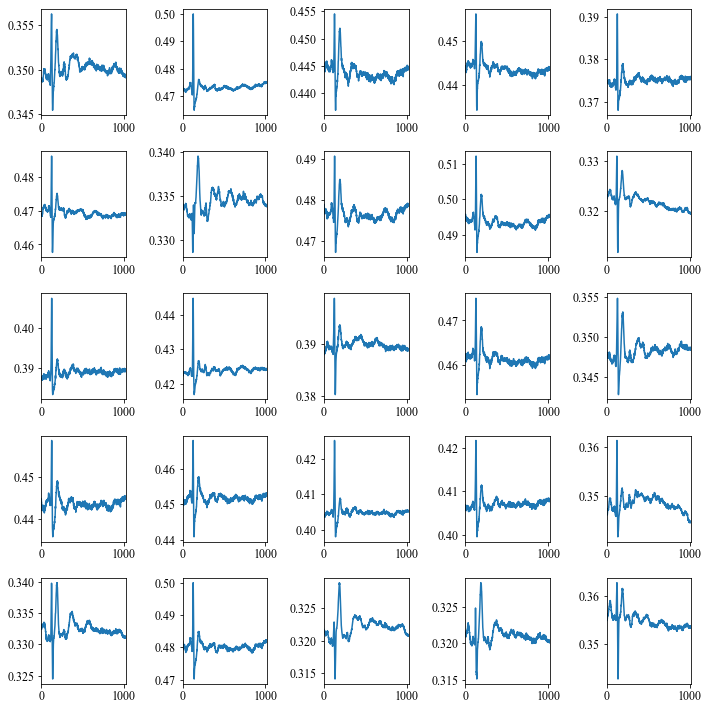

Epoch   571 / 2000
 3525 / 3525 - loss: 1.255504e-04 - Duration: 82 sec - ETA: 32 hour 49 min 51 sec
Epoch   572 / 2000
 3525 / 3525 - loss: 1.205919e-04 - Duration: 83 sec - ETA: 32 hour 48 min 29 sec
Epoch   573 / 2000
 3525 / 3525 - loss: 1.220411e-04 - Duration: 82 sec - ETA: 32 hour 47 min 7 sec
Epoch   574 / 2000
 3525 / 3525 - loss: 1.203329e-04 - Duration: 82 sec - ETA: 32 hour 45 min 44 sec
Epoch   575 / 2000
 3525 / 3525 - loss: 1.230495e-04 - Duration: 82 sec - ETA: 32 hour 44 min 21 sec
Epoch   576 / 2000
 3525 / 3525 - loss: 1.210122e-04 - Duration: 82 sec - ETA: 32 hour 42 min 59 sec
Epoch   577 / 2000
 3525 / 3525 - loss: 1.221850e-04 - Duration: 82 sec - ETA: 32 hour 41 min 37 sec
Epoch   578 / 2000
 3525 / 3525 - loss: 1.208923e-04 - Duration: 82 sec - ETA: 32 hour 40 min 14 sec
Epoch   579 / 2000
 3525 / 3525 - loss: 1.213765e-04 - Duration: 82 sec - ETA: 32 hour 38 min 52 sec
Epoch   580 / 2000
 3525 / 3525 - loss: 1.208189e-04 - Duration: 82 sec - ETA: 32 hour 37 mi

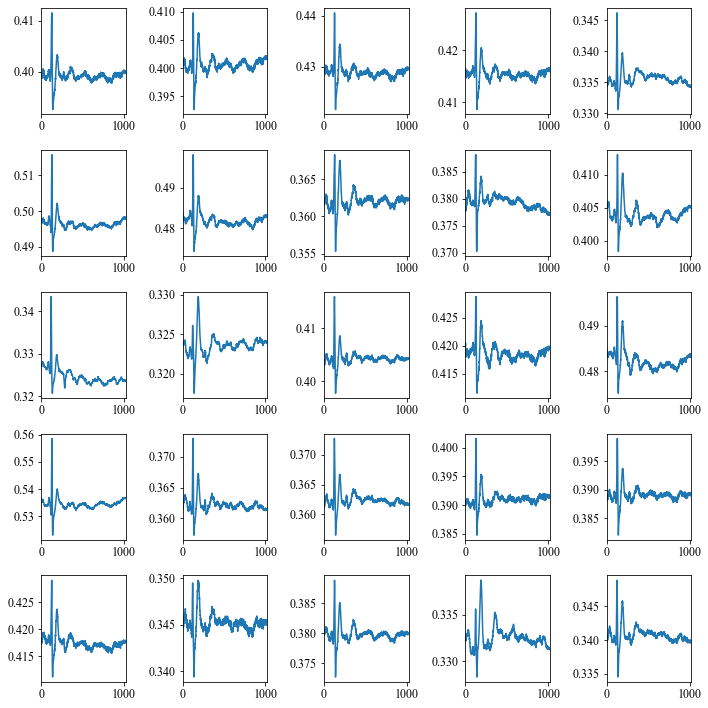

Epoch   581 / 2000
 3525 / 3525 - loss: 1.192501e-04 - Duration: 82 sec - ETA: 32 hour 36 min 6 sec
Epoch   582 / 2000
 3525 / 3525 - loss: 1.210552e-04 - Duration: 82 sec - ETA: 32 hour 34 min 44 sec
Epoch   583 / 2000
 3525 / 3525 - loss: 1.211760e-04 - Duration: 83 sec - ETA: 32 hour 33 min 22 sec
Epoch   584 / 2000
 3525 / 3525 - loss: 1.213060e-04 - Duration: 82 sec - ETA: 32 hour 32 min 0 sec
Epoch   585 / 2000
 3525 / 3525 - loss: 1.200173e-04 - Duration: 82 sec - ETA: 32 hour 30 min 37 sec
Epoch   586 / 2000
 3525 / 3525 - loss: 1.228866e-04 - Duration: 82 sec - ETA: 32 hour 29 min 15 sec
Epoch   587 / 2000
 3525 / 3525 - loss: 1.202096e-04 - Duration: 82 sec - ETA: 32 hour 27 min 52 sec
Epoch   588 / 2000
 3525 / 3525 - loss: 1.213299e-04 - Duration: 82 sec - ETA: 32 hour 26 min 30 sec
Epoch   589 / 2000
 3525 / 3525 - loss: 1.224892e-04 - Duration: 82 sec - ETA: 32 hour 25 min 7 sec
Epoch   590 / 2000
 3525 / 3525 - loss: 1.212528e-04 - Duration: 82 sec - ETA: 32 hour 23 min 

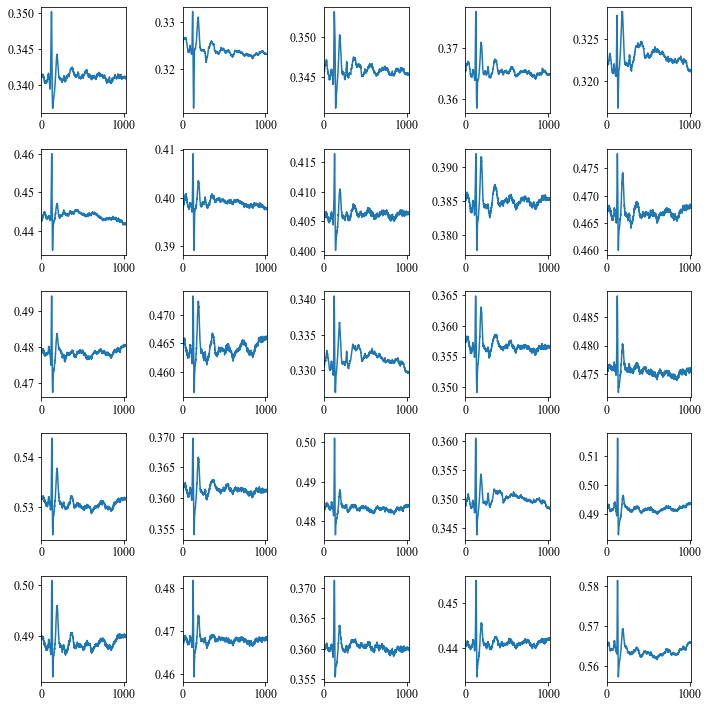

Epoch   591 / 2000
 3525 / 3525 - loss: 1.216228e-04 - Duration: 82 sec - ETA: 32 hour 22 min 22 sec
Epoch   592 / 2000
 3525 / 3525 - loss: 1.222495e-04 - Duration: 82 sec - ETA: 32 hour 20 min 59 sec
Epoch   593 / 2000
 3525 / 3525 - loss: 1.186916e-04 - Duration: 82 sec - ETA: 32 hour 19 min 37 sec
Epoch   594 / 2000
 3525 / 3525 - loss: 1.192113e-04 - Duration: 82 sec - ETA: 32 hour 18 min 15 sec
Epoch   595 / 2000
 3525 / 3525 - loss: 1.209867e-04 - Duration: 82 sec - ETA: 32 hour 16 min 52 sec
Epoch   596 / 2000
 3525 / 3525 - loss: 1.189690e-04 - Duration: 82 sec - ETA: 32 hour 15 min 30 sec
Epoch   597 / 2000
 3525 / 3525 - loss: 1.231670e-04 - Duration: 82 sec - ETA: 32 hour 14 min 7 sec
Epoch   598 / 2000
 3525 / 3525 - loss: 1.212433e-04 - Duration: 82 sec - ETA: 32 hour 12 min 45 sec
Epoch   599 / 2000
 3525 / 3525 - loss: 1.179519e-04 - Duration: 82 sec - ETA: 32 hour 11 min 22 sec
Epoch   600 / 2000
 3525 / 3525 - loss: 1.190667e-04 - Duration: 82 sec - ETA: 32 hour 10 mi

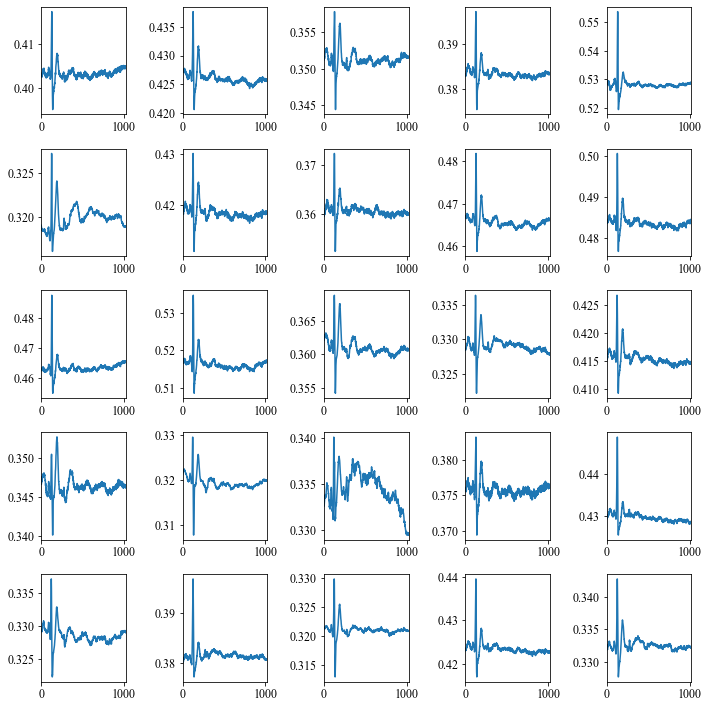

Epoch   601 / 2000
 3525 / 3525 - loss: 1.173969e-04 - Duration: 82 sec - ETA: 32 hour 8 min 37 sec
Epoch   602 / 2000
 3525 / 3525 - loss: 1.185699e-04 - Duration: 82 sec - ETA: 32 hour 7 min 15 sec
Epoch   603 / 2000
 3525 / 3525 - loss: 1.195599e-04 - Duration: 82 sec - ETA: 32 hour 5 min 52 sec
Epoch   604 / 2000
 3525 / 3525 - loss: 1.166810e-04 - Duration: 82 sec - ETA: 32 hour 4 min 30 sec
Epoch   605 / 2000
 3525 / 3525 - loss: 1.189119e-04 - Duration: 82 sec - ETA: 32 hour 3 min 8 sec
Epoch   606 / 2000
 3525 / 3525 - loss: 1.210391e-04 - Duration: 82 sec - ETA: 32 hour 1 min 45 sec
Epoch   607 / 2000
 3525 / 3525 - loss: 1.150573e-04 - Duration: 82 sec - ETA: 32 hour 0 min 23 sec
Epoch   608 / 2000
 3525 / 3525 - loss: 1.187412e-04 - Duration: 82 sec - ETA: 31 hour 59 min 0 sec
Epoch   609 / 2000
 3525 / 3525 - loss: 1.160117e-04 - Duration: 82 sec - ETA: 31 hour 57 min 38 sec
Epoch   610 / 2000
 3525 / 3525 - loss: 1.157147e-04 - Duration: 83 sec - ETA: 31 hour 56 min 16 sec

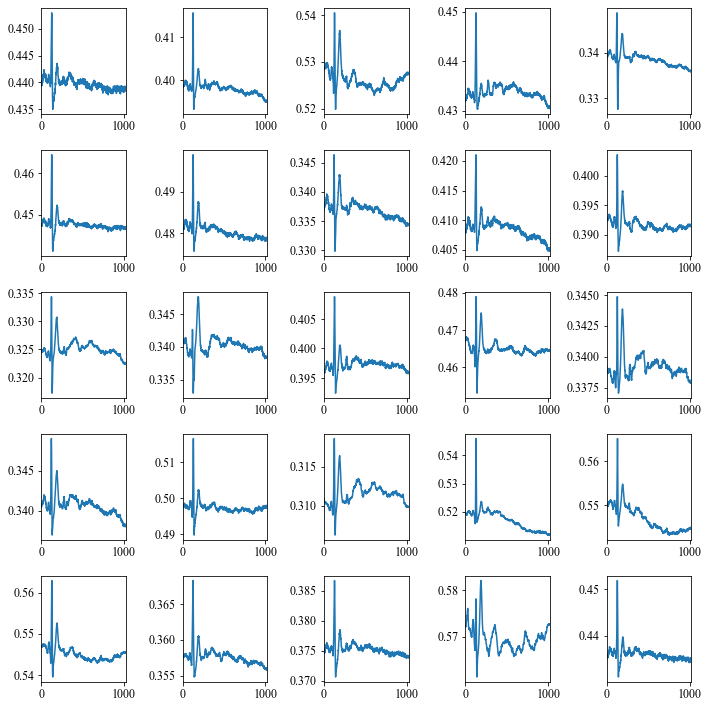

Epoch   611 / 2000
 3525 / 3525 - loss: 1.178332e-04 - Duration: 83 sec - ETA: 31 hour 54 min 54 sec
Epoch   612 / 2000
 3525 / 3525 - loss: 1.190903e-04 - Duration: 82 sec - ETA: 31 hour 53 min 31 sec
Epoch   613 / 2000
 3525 / 3525 - loss: 1.225732e-04 - Duration: 82 sec - ETA: 31 hour 52 min 8 sec
Epoch   614 / 2000
 3525 / 3525 - loss: 1.191733e-04 - Duration: 82 sec - ETA: 31 hour 50 min 46 sec
Epoch   615 / 2000
 3525 / 3525 - loss: 1.169478e-04 - Duration: 83 sec - ETA: 31 hour 49 min 24 sec
Epoch   616 / 2000
 3525 / 3525 - loss: 1.146946e-04 - Duration: 82 sec - ETA: 31 hour 48 min 2 sec
Epoch   617 / 2000
 3525 / 3525 - loss: 1.174060e-04 - Duration: 82 sec - ETA: 31 hour 46 min 39 sec
Epoch   618 / 2000
 3525 / 3525 - loss: 1.192923e-04 - Duration: 82 sec - ETA: 31 hour 45 min 17 sec
Epoch   619 / 2000
 3525 / 3525 - loss: 1.202183e-04 - Duration: 82 sec - ETA: 31 hour 43 min 54 sec
Epoch   620 / 2000
 3525 / 3525 - loss: 1.178775e-04 - Duration: 82 sec - ETA: 31 hour 42 min

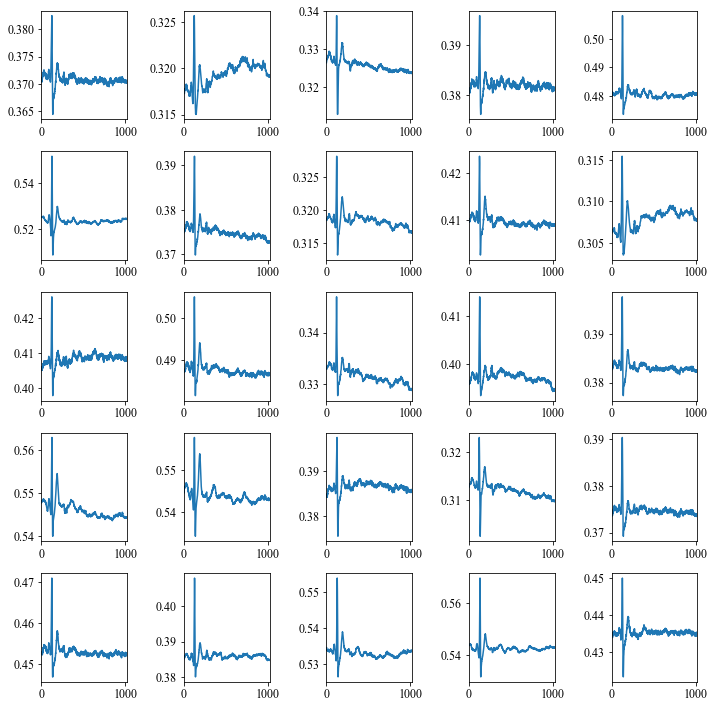

Epoch   621 / 2000
 3525 / 3525 - loss: 1.193152e-04 - Duration: 82 sec - ETA: 31 hour 41 min 10 sec
Epoch   622 / 2000
 3525 / 3525 - loss: 1.181761e-04 - Duration: 82 sec - ETA: 31 hour 39 min 47 sec
Epoch   623 / 2000
 3525 / 3525 - loss: 1.182625e-04 - Duration: 82 sec - ETA: 31 hour 38 min 25 sec
Epoch   624 / 2000
 3525 / 3525 - loss: 1.179260e-04 - Duration: 82 sec - ETA: 31 hour 37 min 2 sec
Epoch   625 / 2000
 3525 / 3525 - loss: 1.177306e-04 - Duration: 82 sec - ETA: 31 hour 35 min 39 sec
Epoch   626 / 2000
 3525 / 3525 - loss: 1.173557e-04 - Duration: 82 sec - ETA: 31 hour 34 min 17 sec
Epoch   627 / 2000
 3525 / 3525 - loss: 1.168705e-04 - Duration: 82 sec - ETA: 31 hour 32 min 55 sec
Epoch   628 / 2000
 3525 / 3525 - loss: 1.179439e-04 - Duration: 82 sec - ETA: 31 hour 31 min 32 sec
Epoch   629 / 2000
 3525 / 3525 - loss: 1.169583e-04 - Duration: 82 sec - ETA: 31 hour 30 min 10 sec
Epoch   630 / 2000
 3525 / 3525 - loss: 1.156786e-04 - Duration: 82 sec - ETA: 31 hour 28 mi

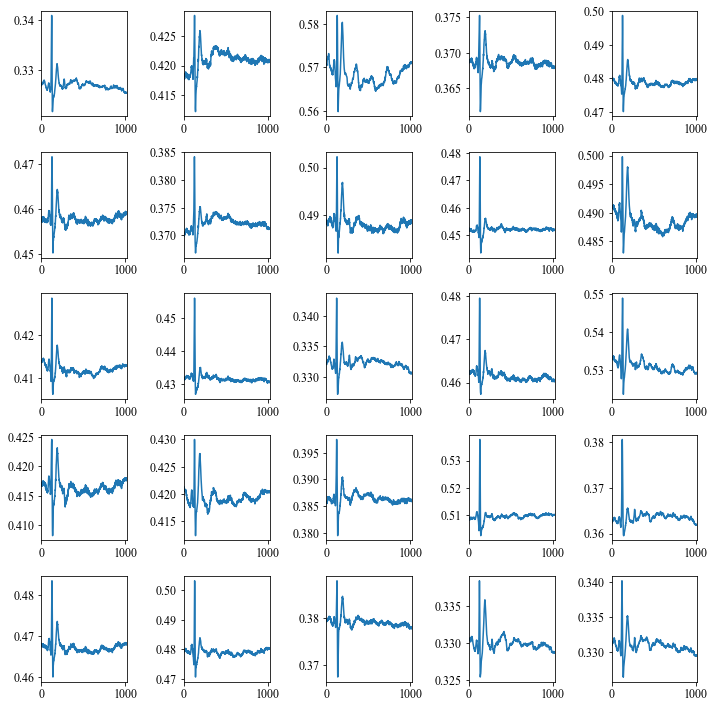

Epoch   631 / 2000
 3525 / 3525 - loss: 1.177620e-04 - Duration: 82 sec - ETA: 31 hour 27 min 25 sec
Epoch   632 / 2000
 3525 / 3525 - loss: 1.158010e-04 - Duration: 82 sec - ETA: 31 hour 26 min 2 sec
Epoch   633 / 2000
 3525 / 3525 - loss: 1.179821e-04 - Duration: 82 sec - ETA: 31 hour 24 min 40 sec
Epoch   634 / 2000
 3525 / 3525 - loss: 1.175414e-04 - Duration: 82 sec - ETA: 31 hour 23 min 18 sec
Epoch   635 / 2000
 3525 / 3525 - loss: 1.177742e-04 - Duration: 82 sec - ETA: 31 hour 21 min 55 sec
Epoch   636 / 2000
 3525 / 3525 - loss: 1.153940e-04 - Duration: 82 sec - ETA: 31 hour 20 min 33 sec
Epoch   637 / 2000
 3525 / 3525 - loss: 1.197959e-04 - Duration: 83 sec - ETA: 31 hour 19 min 11 sec
Epoch   638 / 2000
 3525 / 3525 - loss: 1.165378e-04 - Duration: 83 sec - ETA: 31 hour 17 min 49 sec
Epoch   639 / 2000
 3525 / 3525 - loss: 1.160544e-04 - Duration: 82 sec - ETA: 31 hour 16 min 27 sec
Epoch   640 / 2000
 3525 / 3525 - loss: 1.149109e-04 - Duration: 83 sec - ETA: 31 hour 15 mi

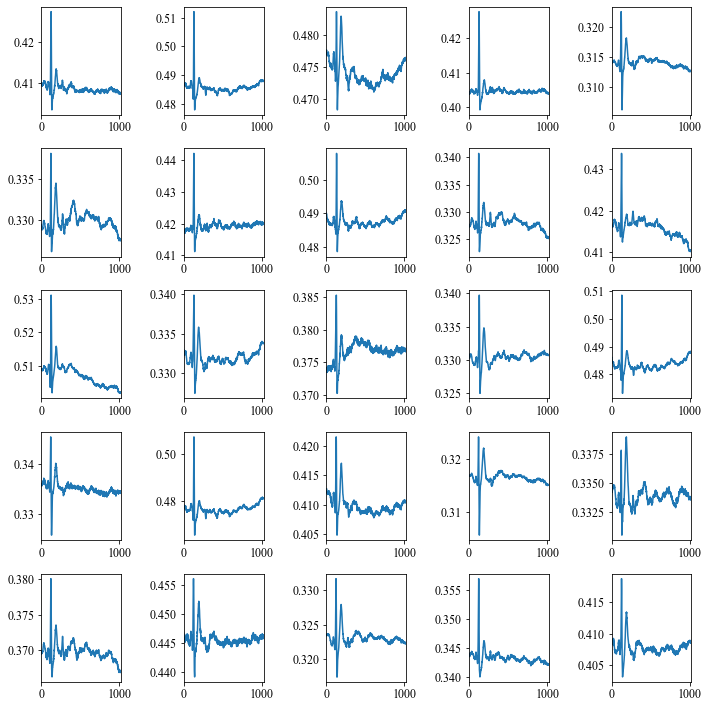

Epoch   641 / 2000
 3525 / 3525 - loss: 1.213719e-04 - Duration: 82 sec - ETA: 31 hour 13 min 43 sec
Epoch   642 / 2000
 3525 / 3525 - loss: 1.153271e-04 - Duration: 82 sec - ETA: 31 hour 12 min 20 sec
Epoch   643 / 2000
 3525 / 3525 - loss: 1.180644e-04 - Duration: 82 sec - ETA: 31 hour 10 min 58 sec
Epoch   644 / 2000
 3525 / 3525 - loss: 1.169541e-04 - Duration: 82 sec - ETA: 31 hour 9 min 35 sec
Epoch   645 / 2000
 3525 / 3525 - loss: 1.156036e-04 - Duration: 82 sec - ETA: 31 hour 8 min 13 sec
Epoch   646 / 2000
 3525 / 3525 - loss: 1.137020e-04 - Duration: 82 sec - ETA: 31 hour 6 min 50 sec
Epoch   647 / 2000
 3525 / 3525 - loss: 1.156989e-04 - Duration: 82 sec - ETA: 31 hour 5 min 28 sec
Epoch   648 / 2000
 3525 / 3525 - loss: 1.134454e-04 - Duration: 85 sec - ETA: 31 hour 4 min 11 sec
Epoch   649 / 2000
 3525 / 3525 - loss: 1.154798e-04 - Duration: 86 sec - ETA: 31 hour 2 min 55 sec
Epoch   650 / 2000
 3525 / 3525 - loss: 1.166926e-04 - Duration: 85 sec - ETA: 31 hour 1 min 39 s

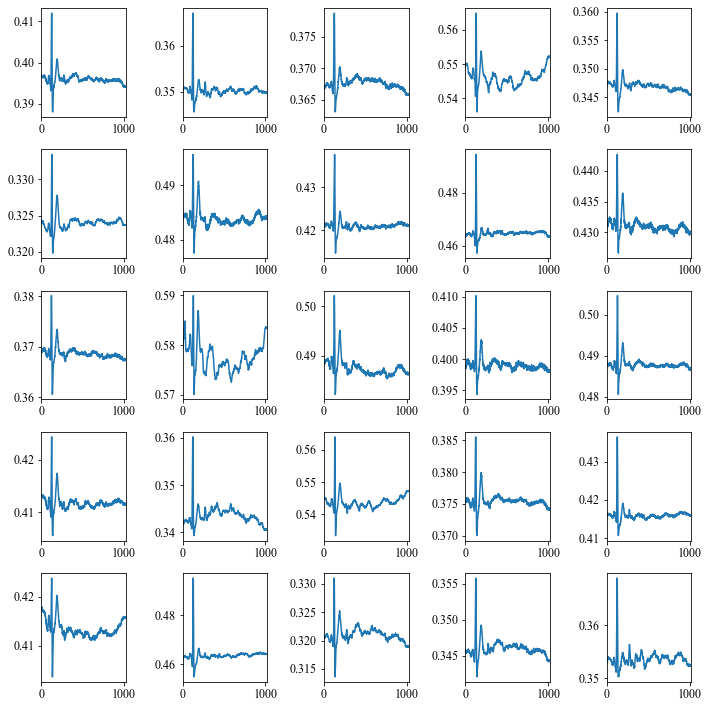

Epoch   651 / 2000
 3525 / 3525 - loss: 1.158608e-04 - Duration: 86 sec - ETA: 31 hour 0 min 24 sec
Epoch   652 / 2000
 3525 / 3525 - loss: 1.182407e-04 - Duration: 85 sec - ETA: 30 hour 59 min 8 sec
Epoch   653 / 2000
 3525 / 3525 - loss: 1.140502e-04 - Duration: 84 sec - ETA: 30 hour 57 min 49 sec
Epoch   654 / 2000
 3525 / 3525 - loss: 1.143443e-04 - Duration: 84 sec - ETA: 30 hour 56 min 30 sec
Epoch   655 / 2000
 3525 / 3525 - loss: 1.149481e-04 - Duration: 85 sec - ETA: 30 hour 55 min 12 sec
Epoch   656 / 2000
 3525 / 3525 - loss: 1.140393e-04 - Duration: 84 sec - ETA: 30 hour 53 min 53 sec
Epoch   657 / 2000
 3525 / 3525 - loss: 1.175837e-04 - Duration: 83 sec - ETA: 30 hour 52 min 31 sec
Epoch   658 / 2000
 3525 / 3525 - loss: 1.144560e-04 - Duration: 83 sec - ETA: 30 hour 51 min 9 sec
Epoch   659 / 2000
 3525 / 3525 - loss: 1.172345e-04 - Duration: 83 sec - ETA: 30 hour 49 min 47 sec
Epoch   660 / 2000
 3525 / 3525 - loss: 1.170526e-04 - Duration: 82 sec - ETA: 30 hour 48 min 

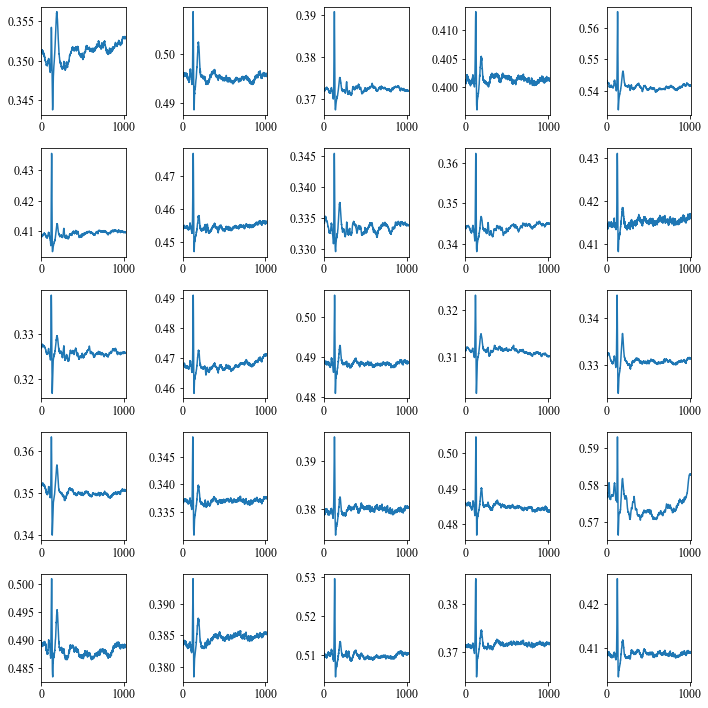

Epoch   661 / 2000
 3525 / 3525 - loss: 1.138306e-04 - Duration: 82 sec - ETA: 30 hour 47 min 2 sec
Epoch   662 / 2000
 3525 / 3525 - loss: 1.126090e-04 - Duration: 83 sec - ETA: 30 hour 45 min 40 sec
Epoch   663 / 2000
 3525 / 3525 - loss: 1.143789e-04 - Duration: 85 sec - ETA: 30 hour 44 min 23 sec
Epoch   664 / 2000
 3525 / 3525 - loss: 1.134591e-04 - Duration: 82 sec - ETA: 30 hour 43 min 1 sec
Epoch   665 / 2000
 3525 / 3525 - loss: 1.138336e-04 - Duration: 82 sec - ETA: 30 hour 41 min 38 sec
Epoch   666 / 2000
 3525 / 3525 - loss: 1.140437e-04 - Duration: 82 sec - ETA: 30 hour 40 min 16 sec
Epoch   667 / 2000
 3525 / 3525 - loss: 1.139731e-04 - Duration: 82 sec - ETA: 30 hour 38 min 53 sec
Epoch   668 / 2000
 3525 / 3525 - loss: 1.152067e-04 - Duration: 82 sec - ETA: 30 hour 37 min 31 sec
Epoch   669 / 2000
 3525 / 3525 - loss: 1.156945e-04 - Duration: 83 sec - ETA: 30 hour 36 min 9 sec
Epoch   670 / 2000
 3525 / 3525 - loss: 1.142759e-04 - Duration: 83 sec - ETA: 30 hour 34 min 

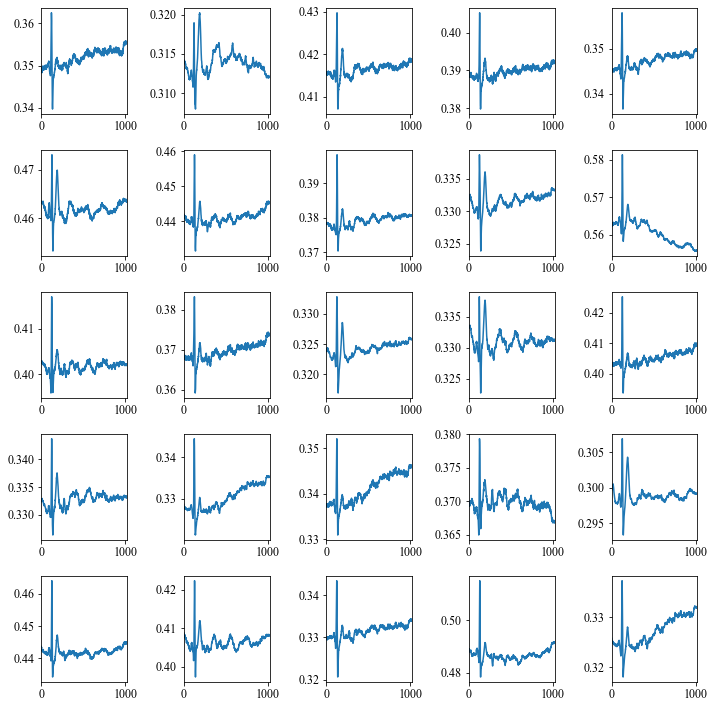

Epoch   671 / 2000
 3525 / 3525 - loss: 1.150316e-04 - Duration: 82 sec - ETA: 30 hour 33 min 24 sec
Epoch   672 / 2000
 3525 / 3525 - loss: 1.126312e-04 - Duration: 82 sec - ETA: 30 hour 32 min 2 sec
Epoch   673 / 2000
 3525 / 3525 - loss: 1.146461e-04 - Duration: 83 sec - ETA: 30 hour 30 min 40 sec
Epoch   674 / 2000
 3525 / 3525 - loss: 1.115882e-04 - Duration: 82 sec - ETA: 30 hour 29 min 17 sec
Epoch   675 / 2000
 3525 / 3525 - loss: 1.119159e-04 - Duration: 82 sec - ETA: 30 hour 27 min 55 sec
Epoch   676 / 2000
 3525 / 3525 - loss: 1.099527e-04 - Duration: 83 sec - ETA: 30 hour 26 min 33 sec
Epoch   677 / 2000
 3525 / 3525 - loss: 1.115434e-04 - Duration: 82 sec - ETA: 30 hour 25 min 10 sec
Epoch   678 / 2000
 3525 / 3525 - loss: 1.139494e-04 - Duration: 82 sec - ETA: 30 hour 23 min 47 sec
Epoch   679 / 2000
 3525 / 3525 - loss: 1.146734e-04 - Duration: 83 sec - ETA: 30 hour 22 min 25 sec
Epoch   680 / 2000
 3525 / 3525 - loss: 1.097829e-04 - Duration: 82 sec - ETA: 30 hour 21 mi

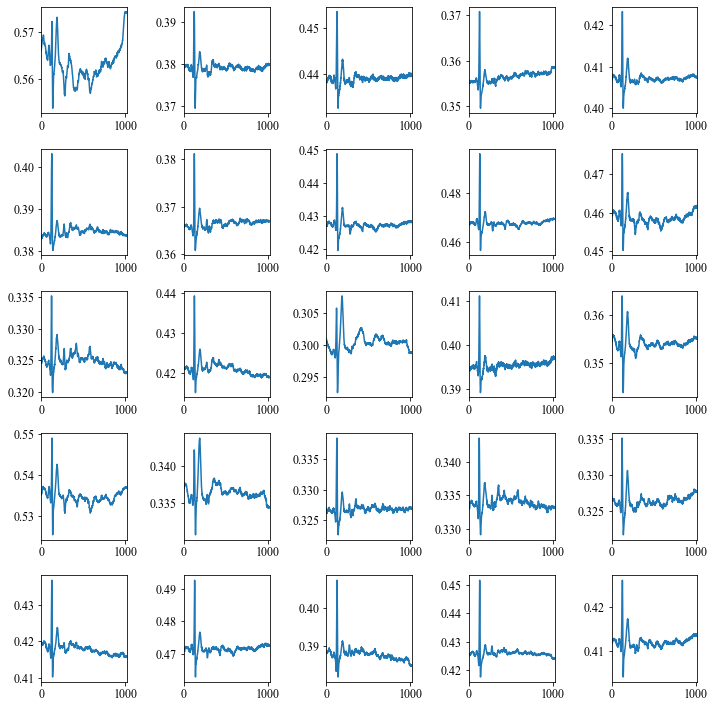

Epoch   681 / 2000
 3525 / 3525 - loss: 1.140131e-04 - Duration: 82 sec - ETA: 30 hour 19 min 40 sec
Epoch   682 / 2000
 3525 / 3525 - loss: 1.151922e-04 - Duration: 82 sec - ETA: 30 hour 18 min 17 sec
Epoch   683 / 2000
 3525 / 3525 - loss: 1.109172e-04 - Duration: 82 sec - ETA: 30 hour 16 min 55 sec
Epoch   684 / 2000
 3525 / 3525 - loss: 1.140500e-04 - Duration: 82 sec - ETA: 30 hour 15 min 32 sec
Epoch   685 / 2000
 3525 / 3525 - loss: 1.139966e-04 - Duration: 82 sec - ETA: 30 hour 14 min 9 sec
Epoch   686 / 2000
 3525 / 3525 - loss: 1.120203e-04 - Duration: 82 sec - ETA: 30 hour 12 min 47 sec
Epoch   687 / 2000
 3525 / 3525 - loss: 1.147239e-04 - Duration: 82 sec - ETA: 30 hour 11 min 24 sec
Epoch   688 / 2000
 3525 / 3525 - loss: 1.127962e-04 - Duration: 82 sec - ETA: 30 hour 10 min 1 sec
Epoch   689 / 2000
 3525 / 3525 - loss: 1.106231e-04 - Duration: 82 sec - ETA: 30 hour 8 min 39 sec
Epoch   690 / 2000
 3525 / 3525 - loss: 1.142444e-04 - Duration: 82 sec - ETA: 30 hour 7 min 1

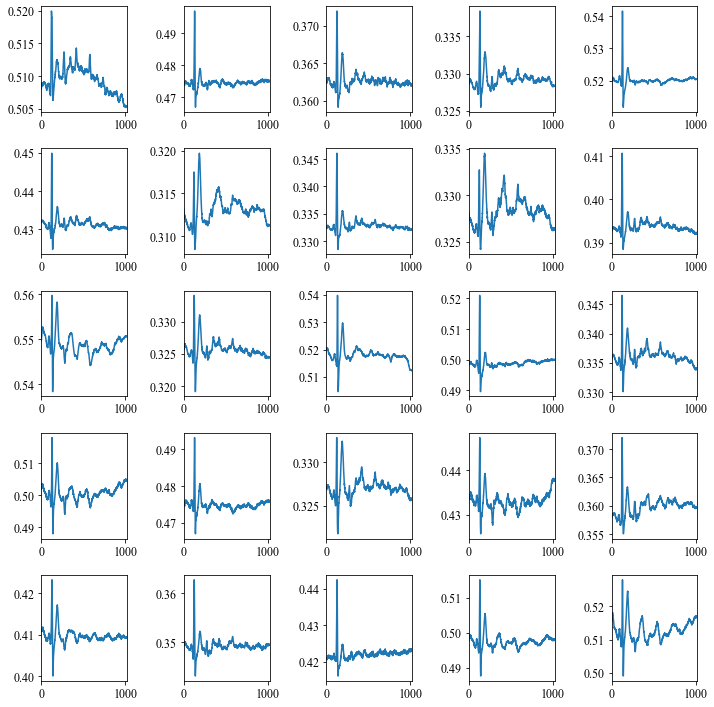

Epoch   691 / 2000
 3525 / 3525 - loss: 1.148069e-04 - Duration: 82 sec - ETA: 30 hour 5 min 53 sec
Epoch   692 / 2000
 3525 / 3525 - loss: 1.129912e-04 - Duration: 82 sec - ETA: 30 hour 4 min 31 sec
Epoch   693 / 2000
 3525 / 3525 - loss: 1.096936e-04 - Duration: 82 sec - ETA: 30 hour 3 min 8 sec
Epoch   694 / 2000
 3525 / 3525 - loss: 1.148606e-04 - Duration: 83 sec - ETA: 30 hour 1 min 46 sec
Epoch   695 / 2000
 3525 / 3525 - loss: 1.126070e-04 - Duration: 82 sec - ETA: 30 hour 0 min 23 sec
Epoch   696 / 2000
 3525 / 3525 - loss: 1.124574e-04 - Duration: 82 sec - ETA: 29 hour 59 min 0 sec
Epoch   697 / 2000
 3525 / 3525 - loss: 1.127507e-04 - Duration: 82 sec - ETA: 29 hour 57 min 38 sec
Epoch   698 / 2000
 3525 / 3525 - loss: 1.113804e-04 - Duration: 82 sec - ETA: 29 hour 56 min 15 sec
Epoch   699 / 2000
 3525 / 3525 - loss: 1.109927e-04 - Duration: 82 sec - ETA: 29 hour 54 min 53 sec
Epoch   700 / 2000
 3525 / 3525 - loss: 1.121409e-04 - Duration: 82 sec - ETA: 29 hour 53 min 30 s

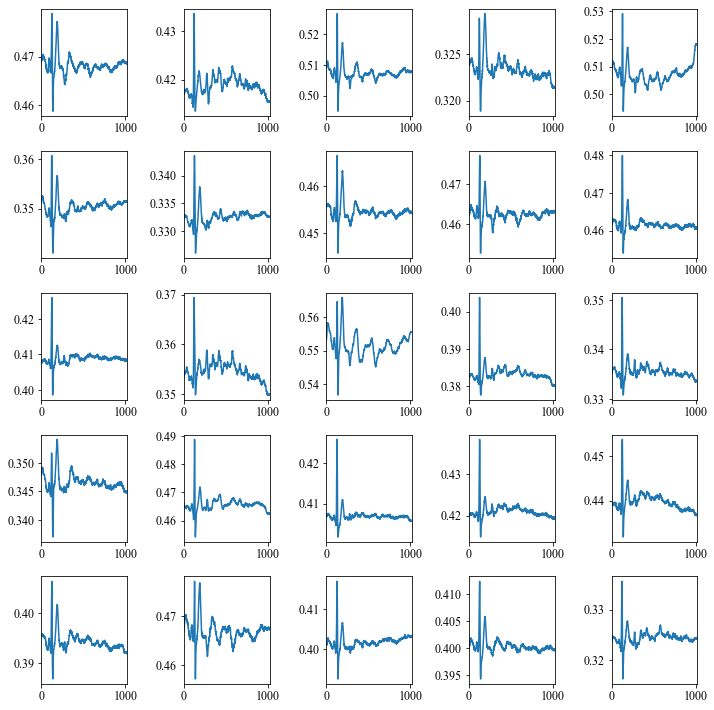

Epoch   701 / 2000
 3525 / 3525 - loss: 1.121101e-04 - Duration: 83 sec - ETA: 29 hour 52 min 8 sec
Epoch   702 / 2000
 3525 / 3525 - loss: 1.121304e-04 - Duration: 83 sec - ETA: 29 hour 50 min 46 sec
Epoch   703 / 2000
 3525 / 3525 - loss: 1.133488e-04 - Duration: 82 sec - ETA: 29 hour 49 min 24 sec
Epoch   704 / 2000
 3525 / 3525 - loss: 1.122967e-04 - Duration: 82 sec - ETA: 29 hour 48 min 1 sec
Epoch   705 / 2000
 3525 / 3525 - loss: 1.118876e-04 - Duration: 82 sec - ETA: 29 hour 46 min 39 sec
Epoch   706 / 2000
 3525 / 3525 - loss: 1.114842e-04 - Duration: 82 sec - ETA: 29 hour 45 min 16 sec
Epoch   707 / 2000
 3525 / 3525 - loss: 1.098109e-04 - Duration: 82 sec - ETA: 29 hour 43 min 53 sec
Epoch   708 / 2000
 3525 / 3525 - loss: 1.112098e-04 - Duration: 82 sec - ETA: 29 hour 42 min 30 sec
Epoch   709 / 2000
 3525 / 3525 - loss: 1.117488e-04 - Duration: 82 sec - ETA: 29 hour 41 min 8 sec
Epoch   710 / 2000
 3525 / 3525 - loss: 1.122191e-04 - Duration: 82 sec - ETA: 29 hour 39 min 

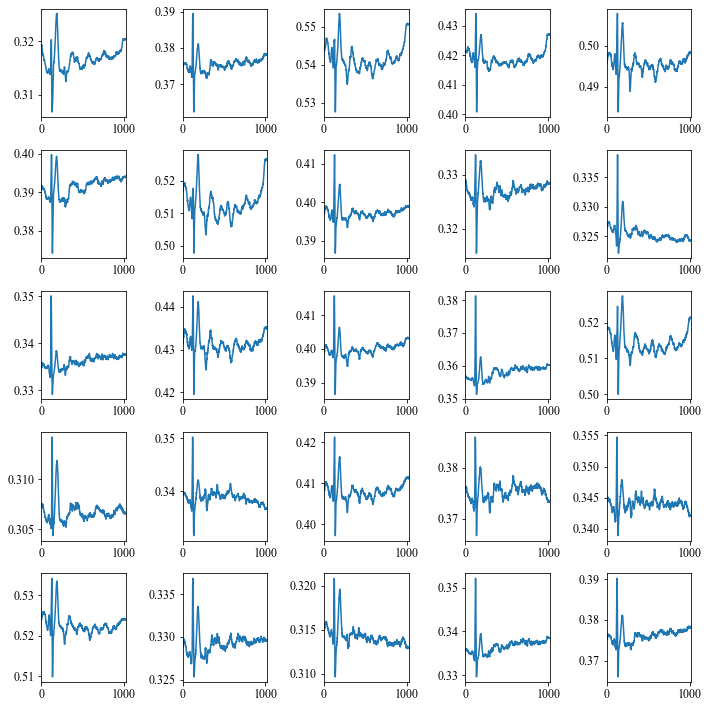

Epoch   711 / 2000
 3525 / 3525 - loss: 1.097719e-04 - Duration: 82 sec - ETA: 29 hour 38 min 23 sec
Epoch   712 / 2000
 3525 / 3525 - loss: 1.099846e-04 - Duration: 82 sec - ETA: 29 hour 37 min 0 sec
Epoch   713 / 2000
 3525 / 3525 - loss: 1.119141e-04 - Duration: 83 sec - ETA: 29 hour 35 min 38 sec
Epoch   714 / 2000
 3525 / 3525 - loss: 1.088807e-04 - Duration: 85 sec - ETA: 29 hour 34 min 19 sec
Epoch   715 / 2000
 3525 / 3525 - loss: 1.101585e-04 - Duration: 90 sec - ETA: 29 hour 33 min 10 sec
Epoch   716 / 2000
 3525 / 3525 - loss: 1.109058e-04 - Duration: 88 sec - ETA: 29 hour 31 min 57 sec
Epoch   717 / 2000
 3525 / 3525 - loss: 1.087976e-04 - Duration: 88 sec - ETA: 29 hour 30 min 45 sec
Epoch   718 / 2000
 3525 / 3525 - loss: 1.127120e-04 - Duration: 88 sec - ETA: 29 hour 29 min 33 sec
Epoch   719 / 2000
 3525 / 3525 - loss: 1.110098e-04 - Duration: 88 sec - ETA: 29 hour 28 min 20 sec
Epoch   720 / 2000
 3525 / 3525 - loss: 1.107074e-04 - Duration: 88 sec - ETA: 29 hour 27 mi

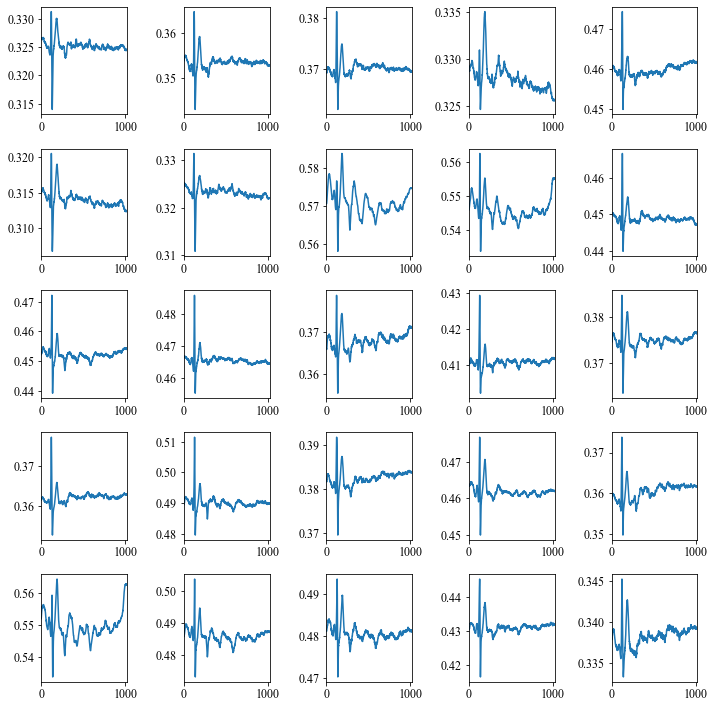

Epoch   721 / 2000
 3525 / 3525 - loss: 1.131752e-04 - Duration: 87 sec - ETA: 29 hour 25 min 53 sec
Epoch   722 / 2000
 3525 / 3525 - loss: 1.096389e-04 - Duration: 87 sec - ETA: 29 hour 24 min 39 sec
Epoch   723 / 2000
 3525 / 3525 - loss: 1.107798e-04 - Duration: 87 sec - ETA: 29 hour 23 min 25 sec
Epoch   724 / 2000
 3525 / 3525 - loss: 1.094637e-04 - Duration: 88 sec - ETA: 29 hour 22 min 11 sec
Epoch   725 / 2000
 3525 / 3525 - loss: 1.092928e-04 - Duration: 88 sec - ETA: 29 hour 20 min 58 sec
Epoch   726 / 2000
 3525 / 3525 - loss: 1.107842e-04 - Duration: 88 sec - ETA: 29 hour 19 min 44 sec
Epoch   727 / 2000
 3525 / 3525 - loss: 1.103263e-04 - Duration: 88 sec - ETA: 29 hour 18 min 30 sec
Epoch   728 / 2000
 3525 / 3525 - loss: 1.084754e-04 - Duration: 87 sec - ETA: 29 hour 17 min 16 sec
Epoch   729 / 2000
 3525 / 3525 - loss: 1.105031e-04 - Duration: 88 sec - ETA: 29 hour 16 min 2 sec
Epoch   730 / 2000
 3525 / 3525 - loss: 1.071543e-04 - Duration: 88 sec - ETA: 29 hour 14 mi

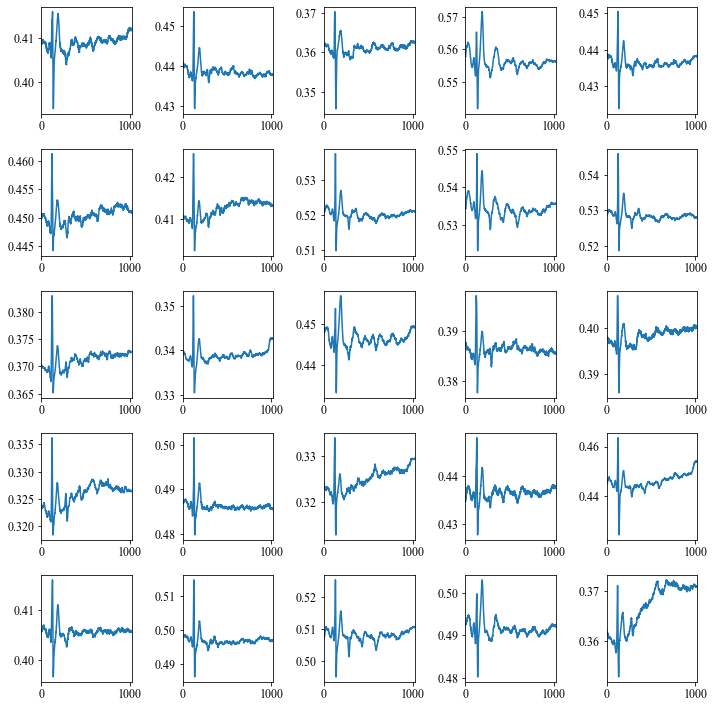

Epoch   731 / 2000
 3525 / 3525 - loss: 1.086493e-04 - Duration: 87 sec - ETA: 29 hour 13 min 34 sec
Epoch   732 / 2000
 3525 / 3525 - loss: 1.098606e-04 - Duration: 88 sec - ETA: 29 hour 12 min 21 sec
Epoch   733 / 2000
 3525 / 3525 - loss: 1.099291e-04 - Duration: 88 sec - ETA: 29 hour 11 min 6 sec
Epoch   734 / 2000
 3525 / 3525 - loss: 1.095586e-04 - Duration: 88 sec - ETA: 29 hour 9 min 53 sec
Epoch   735 / 2000
 3525 / 3525 - loss: 1.093676e-04 - Duration: 87 sec - ETA: 29 hour 8 min 38 sec
Epoch   736 / 2000
 3525 / 3525 - loss: 1.103574e-04 - Duration: 88 sec - ETA: 29 hour 7 min 24 sec
Epoch   737 / 2000
 3525 / 3525 - loss: 1.084025e-04 - Duration: 88 sec - ETA: 29 hour 6 min 10 sec
Epoch   738 / 2000
 3525 / 3525 - loss: 1.115318e-04 - Duration: 88 sec - ETA: 29 hour 4 min 56 sec
Epoch   739 / 2000
 3525 / 3525 - loss: 1.084493e-04 - Duration: 88 sec - ETA: 29 hour 3 min 42 sec
Epoch   740 / 2000
 3525 / 3525 - loss: 1.078801e-04 - Duration: 87 sec - ETA: 29 hour 2 min 27 se

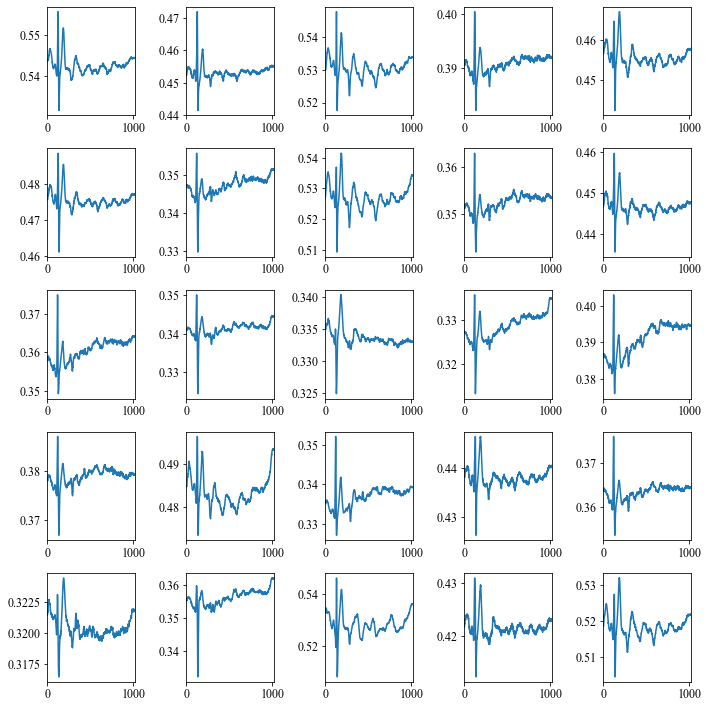

Epoch   741 / 2000
 3525 / 3525 - loss: 1.090180e-04 - Duration: 88 sec - ETA: 29 hour 1 min 13 sec
Epoch   742 / 2000
 3525 / 3525 - loss: 1.074959e-04 - Duration: 88 sec - ETA: 28 hour 59 min 59 sec
Epoch   743 / 2000
 3525 / 3525 - loss: 1.079261e-04 - Duration: 88 sec - ETA: 28 hour 58 min 44 sec
Epoch   744 / 2000
 3525 / 3525 - loss: 1.093221e-04 - Duration: 88 sec - ETA: 28 hour 57 min 30 sec
Epoch   745 / 2000
 3525 / 3525 - loss: 1.056470e-04 - Duration: 88 sec - ETA: 28 hour 56 min 16 sec
Epoch   746 / 2000
 3525 / 3525 - loss: 1.092152e-04 - Duration: 88 sec - ETA: 28 hour 55 min 1 sec
Epoch   747 / 2000
 3525 / 3525 - loss: 1.089070e-04 - Duration: 88 sec - ETA: 28 hour 53 min 47 sec
Epoch   748 / 2000
 3525 / 3525 - loss: 1.065917e-04 - Duration: 88 sec - ETA: 28 hour 52 min 32 sec
Epoch   749 / 2000
 3525 / 3525 - loss: 1.076696e-04 - Duration: 88 sec - ETA: 28 hour 51 min 17 sec
Epoch   750 / 2000
 3525 / 3525 - loss: 1.081323e-04 - Duration: 87 sec - ETA: 28 hour 50 min

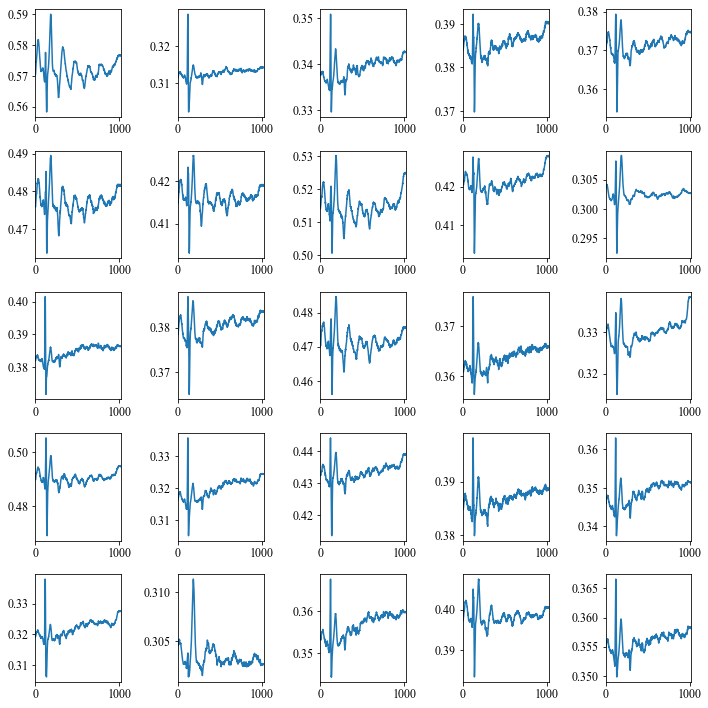

Epoch   751 / 2000
 3525 / 3525 - loss: 1.077886e-04 - Duration: 88 sec - ETA: 28 hour 48 min 48 sec
Epoch   752 / 2000
 3525 / 3525 - loss: 1.079262e-04 - Duration: 88 sec - ETA: 28 hour 47 min 33 sec
Epoch   753 / 2000
 3525 / 3525 - loss: 1.088085e-04 - Duration: 88 sec - ETA: 28 hour 46 min 19 sec
Epoch   754 / 2000
 3525 / 3525 - loss: 1.070556e-04 - Duration: 88 sec - ETA: 28 hour 45 min 4 sec
Epoch   755 / 2000
 3525 / 3525 - loss: 1.101081e-04 - Duration: 88 sec - ETA: 28 hour 43 min 50 sec
Epoch   756 / 2000
 3525 / 3525 - loss: 1.061409e-04 - Duration: 88 sec - ETA: 28 hour 42 min 35 sec
Epoch   757 / 2000
 3525 / 3525 - loss: 1.075505e-04 - Duration: 88 sec - ETA: 28 hour 41 min 21 sec
Epoch   758 / 2000
 3525 / 3525 - loss: 1.061847e-04 - Duration: 91 sec - ETA: 28 hour 40 min 11 sec
Epoch   759 / 2000
 3525 / 3525 - loss: 1.082098e-04 - Duration: 90 sec - ETA: 28 hour 39 min 0 sec
Epoch   760 / 2000
 3525 / 3525 - loss: 1.084353e-04 - Duration: 88 sec - ETA: 28 hour 37 min

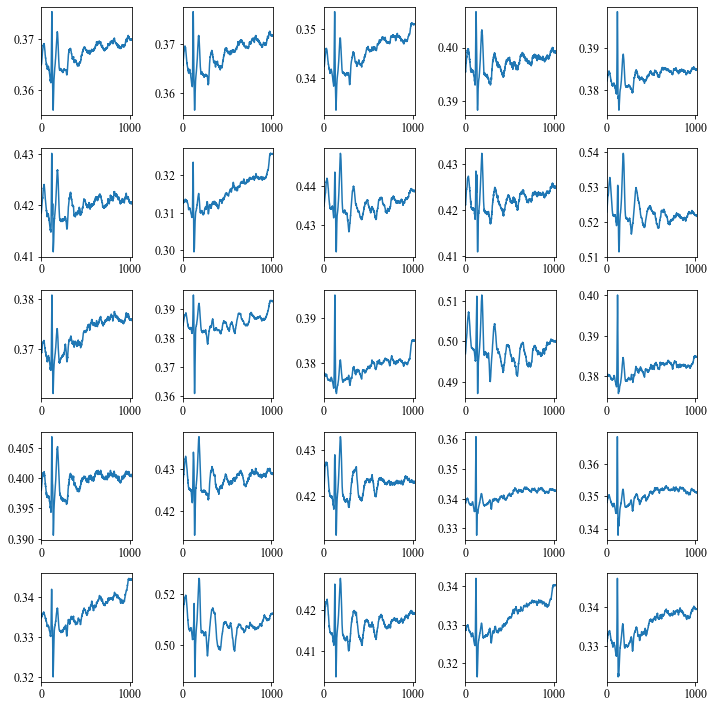

Epoch   761 / 2000
 3525 / 3525 - loss: 1.060831e-04 - Duration: 88 sec - ETA: 28 hour 36 min 30 sec
Epoch   762 / 2000
 3525 / 3525 - loss: 1.067573e-04 - Duration: 88 sec - ETA: 28 hour 35 min 15 sec
Epoch   763 / 2000
 3525 / 3525 - loss: 1.090685e-04 - Duration: 88 sec - ETA: 28 hour 34 min 0 sec
Epoch   764 / 2000
 3525 / 3525 - loss: 1.064948e-04 - Duration: 88 sec - ETA: 28 hour 32 min 45 sec
Epoch   765 / 2000
 3525 / 3525 - loss: 1.071283e-04 - Duration: 88 sec - ETA: 28 hour 31 min 30 sec
Epoch   766 / 2000
 3525 / 3525 - loss: 1.069983e-04 - Duration: 88 sec - ETA: 28 hour 30 min 15 sec
Epoch   767 / 2000
 3525 / 3525 - loss: 1.071502e-04 - Duration: 88 sec - ETA: 28 hour 29 min 0 sec
Epoch   768 / 2000
 3525 / 3525 - loss: 1.091832e-04 - Duration: 88 sec - ETA: 28 hour 27 min 44 sec
Epoch   769 / 2000
 3525 / 3525 - loss: 1.078490e-04 - Duration: 88 sec - ETA: 28 hour 26 min 29 sec
Epoch   770 / 2000
 3525 / 3525 - loss: 1.070604e-04 - Duration: 88 sec - ETA: 28 hour 25 min

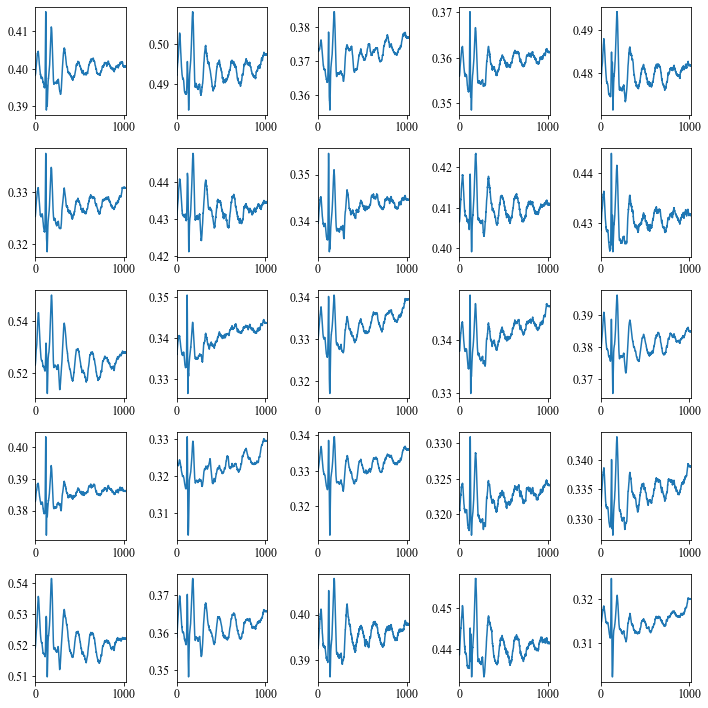

Epoch   771 / 2000
 3525 / 3525 - loss: 1.057555e-04 - Duration: 88 sec - ETA: 28 hour 23 min 59 sec
Epoch   772 / 2000
 3525 / 3525 - loss: 1.076674e-04 - Duration: 87 sec - ETA: 28 hour 22 min 43 sec
Epoch   773 / 2000
 3525 / 3525 - loss: 1.056974e-04 - Duration: 88 sec - ETA: 28 hour 21 min 28 sec
Epoch   774 / 2000
 3525 / 3525 - loss: 1.044291e-04 - Duration: 87 sec - ETA: 28 hour 20 min 12 sec
Epoch   775 / 2000
 3525 / 3525 - loss: 1.046300e-04 - Duration: 87 sec - ETA: 28 hour 18 min 56 sec
Epoch   776 / 2000
 3525 / 3525 - loss: 1.041741e-04 - Duration: 87 sec - ETA: 28 hour 17 min 40 sec
Epoch   777 / 2000
 3525 / 3525 - loss: 1.053178e-04 - Duration: 88 sec - ETA: 28 hour 16 min 25 sec
Epoch   778 / 2000
 3525 / 3525 - loss: 1.055039e-04 - Duration: 87 sec - ETA: 28 hour 15 min 9 sec
Epoch   779 / 2000
 3525 / 3525 - loss: 1.055848e-04 - Duration: 87 sec - ETA: 28 hour 13 min 53 sec
Epoch   780 / 2000
 3525 / 3525 - loss: 1.066870e-04 - Duration: 87 sec - ETA: 28 hour 12 mi

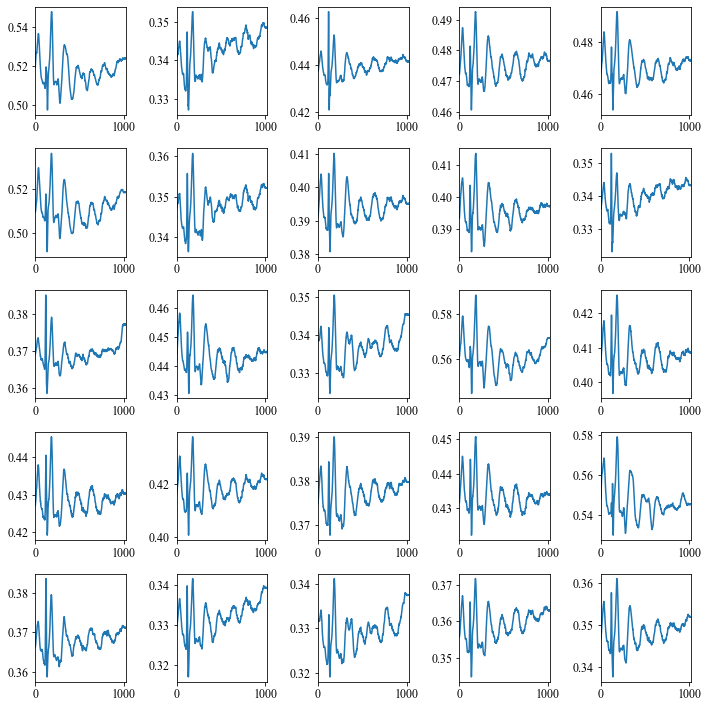

Epoch   781 / 2000
 3525 / 3525 - loss: 1.043444e-04 - Duration: 88 sec - ETA: 28 hour 11 min 21 sec
Epoch   782 / 2000
 3525 / 3525 - loss: 1.057510e-04 - Duration: 87 sec - ETA: 28 hour 10 min 5 sec
Epoch   783 / 2000
 3525 / 3525 - loss: 1.054631e-04 - Duration: 87 sec - ETA: 28 hour 8 min 49 sec
Epoch   784 / 2000
 3525 / 3525 - loss: 1.036538e-04 - Duration: 87 sec - ETA: 28 hour 7 min 33 sec
Epoch   785 / 2000
 3525 / 3525 - loss: 1.060073e-04 - Duration: 88 sec - ETA: 28 hour 6 min 17 sec
Epoch   786 / 2000
 3525 / 3525 - loss: 1.054847e-04 - Duration: 88 sec - ETA: 28 hour 5 min 1 sec
Epoch   787 / 2000
 3525 / 3525 - loss: 1.034626e-04 - Duration: 88 sec - ETA: 28 hour 3 min 46 sec
Epoch   788 / 2000
 3525 / 3525 - loss: 1.069539e-04 - Duration: 88 sec - ETA: 28 hour 2 min 30 sec
Epoch   789 / 2000
 3525 / 3525 - loss: 1.035381e-04 - Duration: 87 sec - ETA: 28 hour 1 min 14 sec
Epoch   790 / 2000
 3525 / 3525 - loss: 1.048359e-04 - Duration: 88 sec - ETA: 27 hour 59 min 58 sec

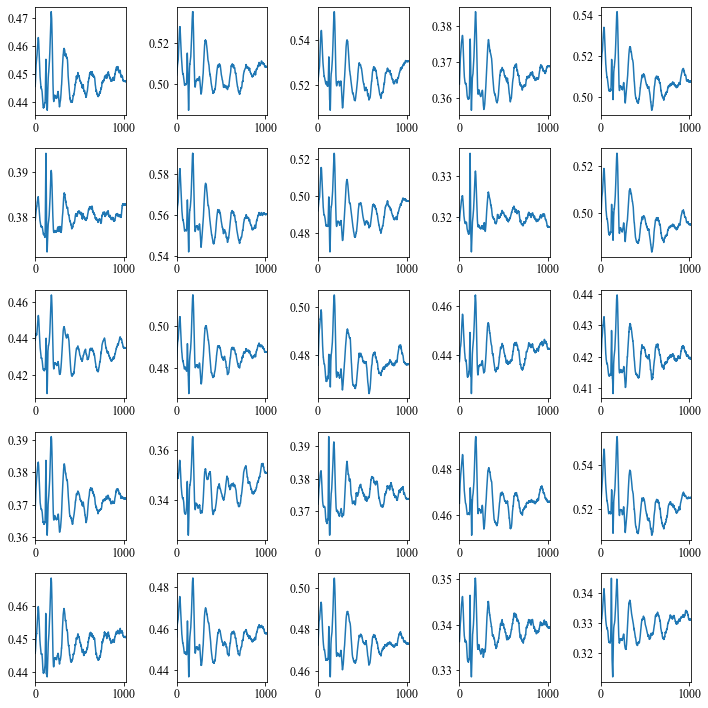

Epoch   791 / 2000
 3525 / 3525 - loss: 1.063444e-04 - Duration: 88 sec - ETA: 27 hour 58 min 42 sec
Epoch   792 / 2000
 3525 / 3525 - loss: 1.064099e-04 - Duration: 88 sec - ETA: 27 hour 57 min 25 sec
Epoch   793 / 2000
 3525 / 3525 - loss: 1.048299e-04 - Duration: 88 sec - ETA: 27 hour 56 min 9 sec
Epoch   794 / 2000
 3525 / 3525 - loss: 1.029462e-04 - Duration: 88 sec - ETA: 27 hour 54 min 54 sec
Epoch   795 / 2000
 3525 / 3525 - loss: 1.040863e-04 - Duration: 88 sec - ETA: 27 hour 53 min 38 sec
Epoch   796 / 2000
 3525 / 3525 - loss: 1.016743e-04 - Duration: 88 sec - ETA: 27 hour 52 min 22 sec
Epoch   797 / 2000
 3525 / 3525 - loss: 1.027759e-04 - Duration: 88 sec - ETA: 27 hour 51 min 5 sec
Epoch   798 / 2000
 3525 / 3525 - loss: 1.058690e-04 - Duration: 88 sec - ETA: 27 hour 49 min 49 sec
Epoch   799 / 2000
 3525 / 3525 - loss: 1.038766e-04 - Duration: 88 sec - ETA: 27 hour 48 min 33 sec
Epoch   800 / 2000
 3525 / 3525 - loss: 1.021816e-04 - Duration: 88 sec - ETA: 27 hour 47 min

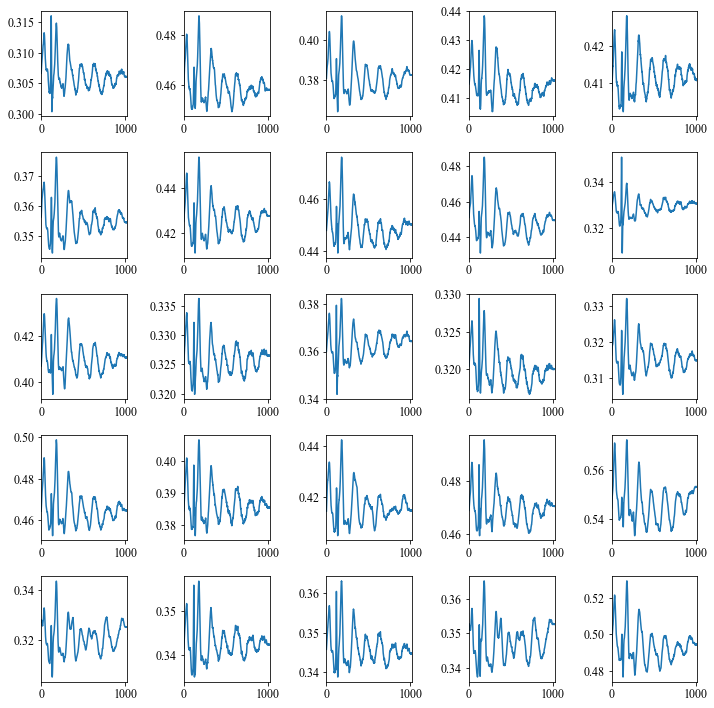

Epoch   801 / 2000
 3525 / 3525 - loss: 1.044609e-04 - Duration: 87 sec - ETA: 27 hour 46 min 0 sec
Epoch   802 / 2000
 3525 / 3525 - loss: 1.049059e-04 - Duration: 88 sec - ETA: 27 hour 44 min 44 sec
Epoch   803 / 2000
 3525 / 3525 - loss: 1.024295e-04 - Duration: 88 sec - ETA: 27 hour 43 min 28 sec
Epoch   804 / 2000
 3525 / 3525 - loss: 1.047319e-04 - Duration: 88 sec - ETA: 27 hour 42 min 12 sec
Epoch   805 / 2000
 3525 / 3525 - loss: 1.047503e-04 - Duration: 88 sec - ETA: 27 hour 40 min 55 sec
Epoch   806 / 2000
 3525 / 3525 - loss: 1.017715e-04 - Duration: 87 sec - ETA: 27 hour 39 min 39 sec
Epoch   807 / 2000
 3525 / 3525 - loss: 1.025618e-04 - Duration: 88 sec - ETA: 27 hour 38 min 22 sec
Epoch   808 / 2000
 3525 / 3525 - loss: 1.061650e-04 - Duration: 88 sec - ETA: 27 hour 37 min 5 sec
Epoch   809 / 2000
 3525 / 3525 - loss: 1.027713e-04 - Duration: 88 sec - ETA: 27 hour 35 min 49 sec
Epoch   810 / 2000
 3525 / 3525 - loss: 1.029041e-04 - Duration: 87 sec - ETA: 27 hour 34 min

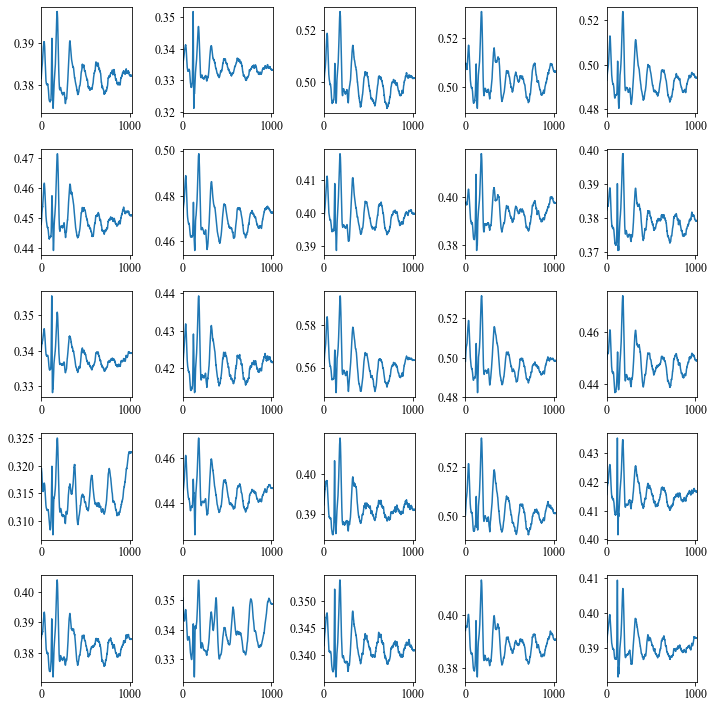

Epoch   811 / 2000
 3525 / 3525 - loss: 1.040219e-04 - Duration: 88 sec - ETA: 27 hour 33 min 16 sec
Epoch   812 / 2000
 3525 / 3525 - loss: 1.014110e-04 - Duration: 87 sec - ETA: 27 hour 31 min 59 sec
Epoch   813 / 2000
 3525 / 3525 - loss: 1.037316e-04 - Duration: 87 sec - ETA: 27 hour 30 min 42 sec
Epoch   814 / 2000
 3525 / 3525 - loss: 1.025851e-04 - Duration: 87 sec - ETA: 27 hour 29 min 25 sec
Epoch   815 / 2000
 3525 / 3525 - loss: 1.040839e-04 - Duration: 87 sec - ETA: 27 hour 28 min 8 sec
Epoch   816 / 2000
 3525 / 3525 - loss: 1.026950e-04 - Duration: 88 sec - ETA: 27 hour 26 min 51 sec
Epoch   817 / 2000
 3525 / 3525 - loss: 1.007104e-04 - Duration: 87 sec - ETA: 27 hour 25 min 34 sec
Epoch   818 / 2000
 3525 / 3525 - loss: 1.070980e-04 - Duration: 88 sec - ETA: 27 hour 24 min 18 sec
Epoch   819 / 2000
 3525 / 3525 - loss: 1.017445e-04 - Duration: 87 sec - ETA: 27 hour 23 min 1 sec
Epoch   820 / 2000
 3525 / 3525 - loss: 1.006447e-04 - Duration: 88 sec - ETA: 27 hour 21 min

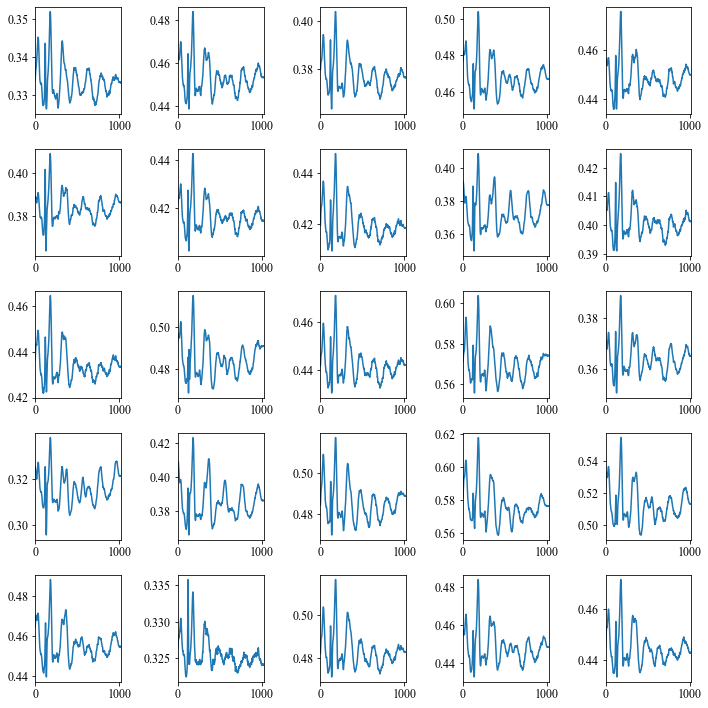

Epoch   821 / 2000
 3525 / 3525 - loss: 1.038462e-04 - Duration: 88 sec - ETA: 27 hour 20 min 27 sec
Epoch   822 / 2000
 3525 / 3525 - loss: 1.044324e-04 - Duration: 87 sec - ETA: 27 hour 19 min 10 sec
Epoch   823 / 2000
 3525 / 3525 - loss: 1.039775e-04 - Duration: 87 sec - ETA: 27 hour 17 min 52 sec
Epoch   824 / 2000
 3525 / 3525 - loss: 1.040185e-04 - Duration: 87 sec - ETA: 27 hour 16 min 35 sec
Epoch   825 / 2000
 3525 / 3525 - loss: 1.020123e-04 - Duration: 90 sec - ETA: 27 hour 15 min 21 sec
Epoch   826 / 2000
 3525 / 3525 - loss: 1.031235e-04 - Duration: 87 sec - ETA: 27 hour 14 min 4 sec
Epoch   827 / 2000
 3525 / 3525 - loss: 1.019003e-04 - Duration: 87 sec - ETA: 27 hour 12 min 47 sec
Epoch   828 / 2000
 3525 / 3525 - loss: 1.041245e-04 - Duration: 87 sec - ETA: 27 hour 11 min 29 sec
Epoch   829 / 2000
 3525 / 3525 - loss: 1.015518e-04 - Duration: 87 sec - ETA: 27 hour 10 min 12 sec
Epoch   830 / 2000
 3525 / 3525 - loss: 1.024978e-04 - Duration: 87 sec - ETA: 27 hour 8 min

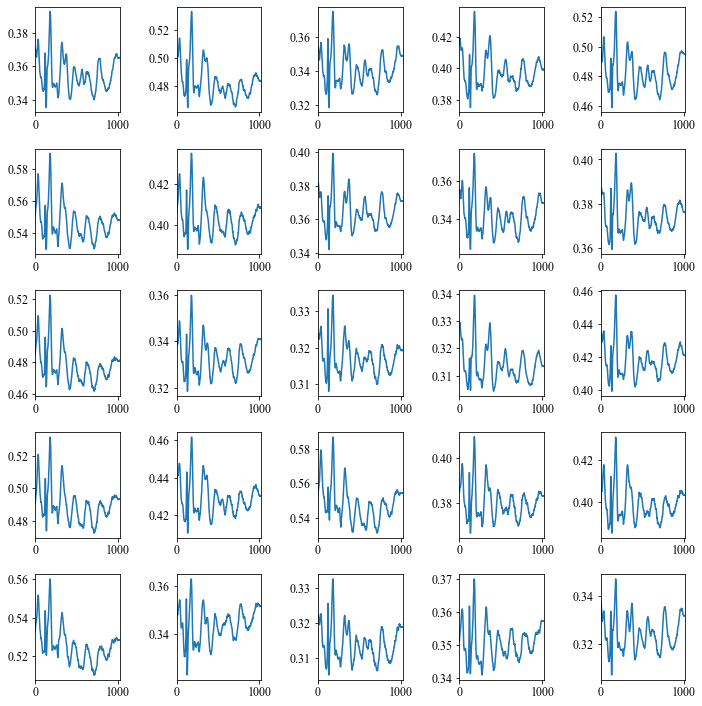

Epoch   831 / 2000
 3525 / 3525 - loss: 1.042994e-04 - Duration: 88 sec - ETA: 27 hour 7 min 37 sec
Epoch   832 / 2000
 3525 / 3525 - loss: 1.031358e-04 - Duration: 87 sec - ETA: 27 hour 6 min 20 sec
Epoch   833 / 2000
 3525 / 3525 - loss: 1.034025e-04 - Duration: 87 sec - ETA: 27 hour 5 min 3 sec
Epoch   834 / 2000
 3525 / 3525 - loss: 1.012057e-04 - Duration: 87 sec - ETA: 27 hour 3 min 45 sec
Epoch   835 / 2000
 3525 / 3525 - loss: 1.009645e-04 - Duration: 87 sec - ETA: 27 hour 2 min 28 sec
Epoch   836 / 2000
 3525 / 3525 - loss: 1.034894e-04 - Duration: 88 sec - ETA: 27 hour 1 min 11 sec
Epoch   837 / 2000
 3525 / 3525 - loss: 1.007238e-04 - Duration: 88 sec - ETA: 26 hour 59 min 53 sec
Epoch   838 / 2000
 3525 / 3525 - loss: 1.022534e-04 - Duration: 87 sec - ETA: 26 hour 58 min 36 sec
Epoch   839 / 2000
 3525 / 3525 - loss: 1.024305e-04 - Duration: 88 sec - ETA: 26 hour 57 min 19 sec
Epoch   840 / 2000
 3525 / 3525 - loss: 9.912725e-05 - Duration: 87 sec - ETA: 26 hour 56 min 1 se

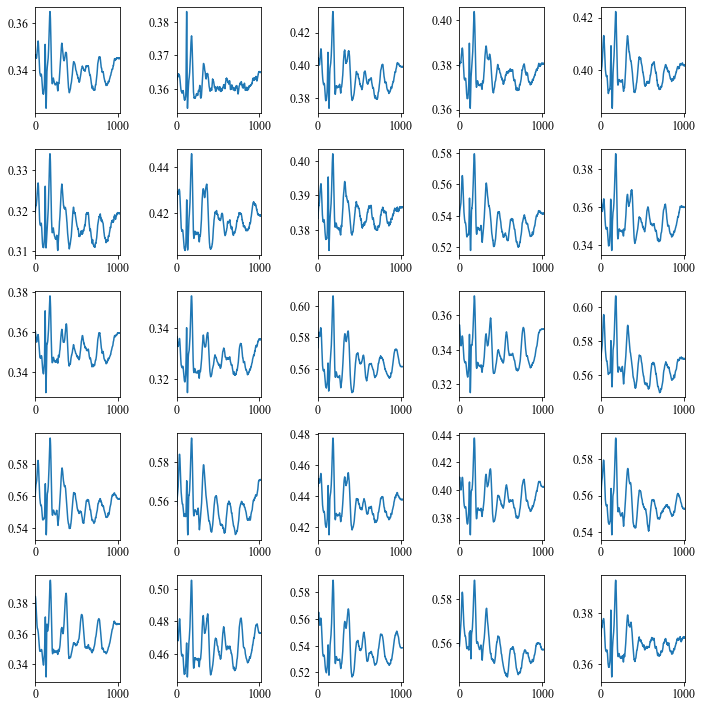

Epoch   841 / 2000
 3525 / 3525 - loss: 1.028669e-04 - Duration: 88 sec - ETA: 26 hour 54 min 44 sec
Epoch   842 / 2000
 3525 / 3525 - loss: 1.001758e-04 - Duration: 88 sec - ETA: 26 hour 53 min 26 sec
Epoch   843 / 2000
 3525 / 3525 - loss: 1.016671e-04 - Duration: 88 sec - ETA: 26 hour 52 min 9 sec
Epoch   844 / 2000
 3525 / 3525 - loss: 1.031960e-04 - Duration: 88 sec - ETA: 26 hour 50 min 52 sec
Epoch   845 / 2000
 3525 / 3525 - loss: 1.030236e-04 - Duration: 88 sec - ETA: 26 hour 49 min 34 sec
Epoch   846 / 2000
 3525 / 3525 - loss: 1.020796e-04 - Duration: 88 sec - ETA: 26 hour 48 min 17 sec
Epoch   847 / 2000
 3525 / 3525 - loss: 1.000292e-04 - Duration: 88 sec - ETA: 26 hour 46 min 59 sec
Epoch   848 / 2000
 3525 / 3525 - loss: 9.920679e-05 - Duration: 88 sec - ETA: 26 hour 45 min 42 sec
Epoch   849 / 2000
 3525 / 3525 - loss: 1.011199e-04 - Duration: 88 sec - ETA: 26 hour 44 min 25 sec
Epoch   850 / 2000
 3525 / 3525 - loss: 1.000002e-04 - Duration: 88 sec - ETA: 26 hour 43 mi

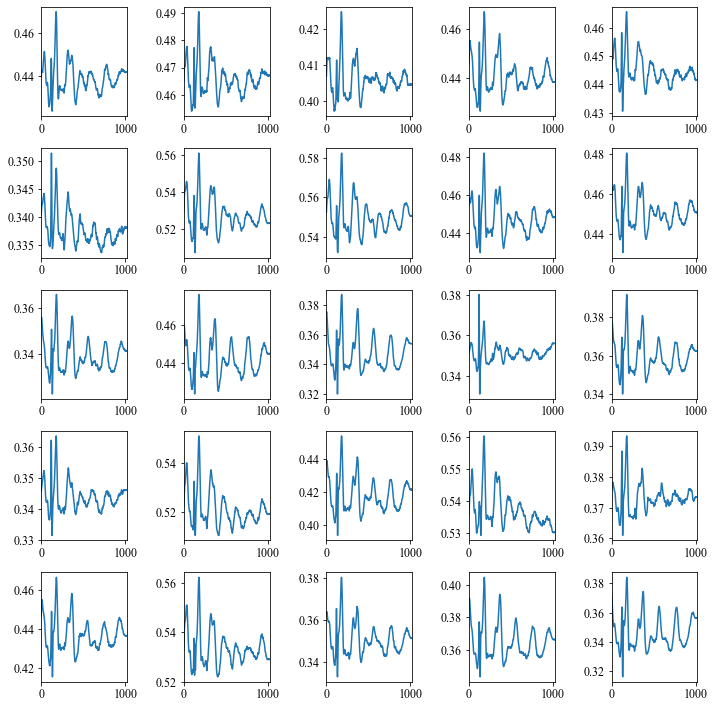

Epoch   851 / 2000
 3525 / 3525 - loss: 9.997315e-05 - Duration: 88 sec - ETA: 26 hour 41 min 49 sec
Epoch   852 / 2000
 3525 / 3525 - loss: 9.733700e-05 - Duration: 87 sec - ETA: 26 hour 40 min 31 sec
Epoch   853 / 2000
 3525 / 3525 - loss: 1.004895e-04 - Duration: 88 sec - ETA: 26 hour 39 min 14 sec
Epoch   854 / 2000
 3525 / 3525 - loss: 9.985812e-05 - Duration: 88 sec - ETA: 26 hour 37 min 56 sec
Epoch   855 / 2000
 3525 / 3525 - loss: 9.931780e-05 - Duration: 88 sec - ETA: 26 hour 36 min 38 sec
Epoch   856 / 2000
 3525 / 3525 - loss: 1.023889e-04 - Duration: 88 sec - ETA: 26 hour 35 min 20 sec
Epoch   857 / 2000
 3525 / 3525 - loss: 1.000290e-04 - Duration: 88 sec - ETA: 26 hour 34 min 3 sec
Epoch   858 / 2000
 3525 / 3525 - loss: 9.883880e-05 - Duration: 88 sec - ETA: 26 hour 32 min 45 sec
Epoch   859 / 2000
 3525 / 3525 - loss: 1.015431e-04 - Duration: 88 sec - ETA: 26 hour 31 min 27 sec
Epoch   860 / 2000
 3525 / 3525 - loss: 1.004966e-04 - Duration: 88 sec - ETA: 26 hour 30 mi

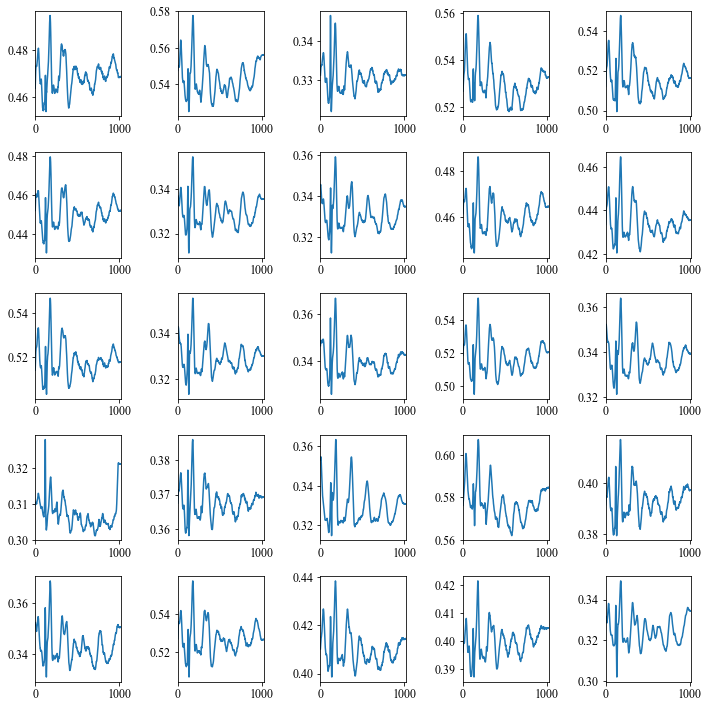

Epoch   861 / 2000
 3525 / 3525 - loss: 9.924751e-05 - Duration: 88 sec - ETA: 26 hour 28 min 52 sec
Epoch   862 / 2000
 3525 / 3525 - loss: 1.018925e-04 - Duration: 88 sec - ETA: 26 hour 27 min 35 sec
Epoch   863 / 2000
 3525 / 3525 - loss: 9.971632e-05 - Duration: 91 sec - ETA: 26 hour 26 min 22 sec
Epoch   864 / 2000
 3525 / 3525 - loss: 9.782877e-05 - Duration: 90 sec - ETA: 26 hour 25 min 6 sec
Epoch   865 / 2000
 3525 / 3525 - loss: 9.995674e-05 - Duration: 89 sec - ETA: 26 hour 23 min 50 sec
Epoch   866 / 2000
 3525 / 3525 - loss: 9.938720e-05 - Duration: 87 sec - ETA: 26 hour 22 min 31 sec
Epoch   867 / 2000
 3525 / 3525 - loss: 9.997222e-05 - Duration: 87 sec - ETA: 26 hour 21 min 12 sec
Epoch   868 / 2000
 3525 / 3525 - loss: 9.814345e-05 - Duration: 85 sec - ETA: 26 hour 19 min 51 sec
Epoch   869 / 2000
 3525 / 3525 - loss: 9.927275e-05 - Duration: 82 sec - ETA: 26 hour 18 min 25 sec
Epoch   870 / 2000
 3525 / 3525 - loss: 9.885664e-05 - Duration: 82 sec - ETA: 26 hour 17 mi

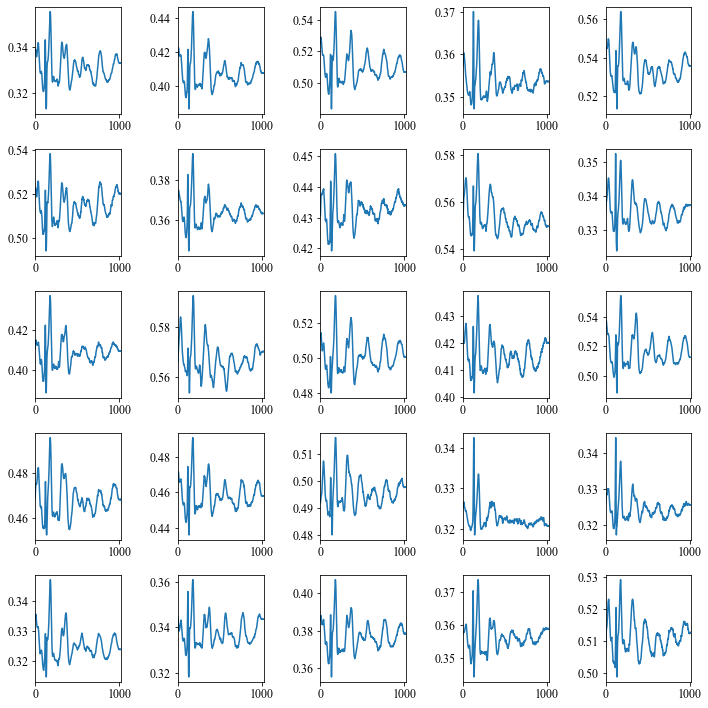

Epoch   871 / 2000
 3525 / 3525 - loss: 1.009208e-04 - Duration: 84 sec - ETA: 26 hour 15 min 38 sec
Epoch   872 / 2000
 3525 / 3525 - loss: 9.672040e-05 - Duration: 85 sec - ETA: 26 hour 14 min 16 sec
Epoch   873 / 2000
 3525 / 3525 - loss: 9.853562e-05 - Duration: 84 sec - ETA: 26 hour 12 min 53 sec
Epoch   874 / 2000
 3525 / 3525 - loss: 9.961981e-05 - Duration: 83 sec - ETA: 26 hour 11 min 28 sec
Epoch   875 / 2000
 3525 / 3525 - loss: 9.841480e-05 - Duration: 83 sec - ETA: 26 hour 10 min 3 sec
Epoch   876 / 2000
 3525 / 3525 - loss: 9.852605e-05 - Duration: 82 sec - ETA: 26 hour 8 min 39 sec
Epoch   877 / 2000
 3525 / 3525 - loss: 9.881929e-05 - Duration: 82 sec - ETA: 26 hour 7 min 14 sec
Epoch   878 / 2000
 3525 / 3525 - loss: 9.809919e-05 - Duration: 83 sec - ETA: 26 hour 5 min 49 sec
Epoch   879 / 2000
 3525 / 3525 - loss: 9.736124e-05 - Duration: 83 sec - ETA: 26 hour 4 min 25 sec
Epoch   880 / 2000
 3525 / 3525 - loss: 9.952338e-05 - Duration: 83 sec - ETA: 26 hour 3 min 0 s

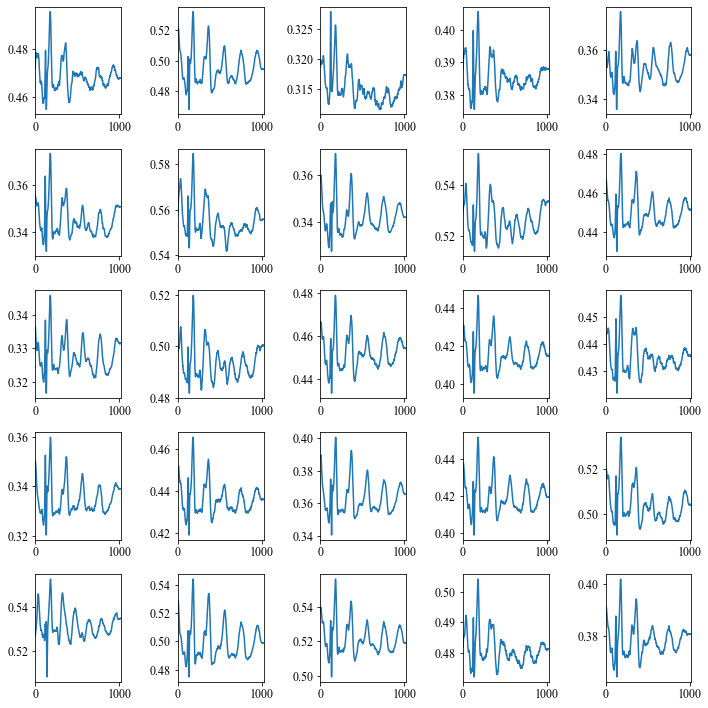

Epoch   881 / 2000
 3525 / 3525 - loss: 9.817778e-05 - Duration: 83 sec - ETA: 26 hour 1 min 36 sec
Epoch   882 / 2000
 3525 / 3525 - loss: 9.878913e-05 - Duration: 82 sec - ETA: 26 hour 0 min 11 sec
Epoch   883 / 2000
 3525 / 3525 - loss: 9.869697e-05 - Duration: 82 sec - ETA: 25 hour 58 min 45 sec
Epoch   884 / 2000
 3525 / 3525 - loss: 9.975595e-05 - Duration: 82 sec - ETA: 25 hour 57 min 20 sec
Epoch   885 / 2000
 3525 / 3525 - loss: 1.005997e-04 - Duration: 82 sec - ETA: 25 hour 55 min 55 sec
Epoch   886 / 2000
 3525 / 3525 - loss: 9.835525e-05 - Duration: 82 sec - ETA: 25 hour 54 min 29 sec
Epoch   887 / 2000
 3525 / 3525 - loss: 9.672403e-05 - Duration: 82 sec - ETA: 25 hour 53 min 4 sec
Epoch   888 / 2000
 3525 / 3525 - loss: 9.753430e-05 - Duration: 82 sec - ETA: 25 hour 51 min 39 sec
Epoch   889 / 2000
 3525 / 3525 - loss: 9.645660e-05 - Duration: 82 sec - ETA: 25 hour 50 min 14 sec
Epoch   890 / 2000
 3525 / 3525 - loss: 9.766246e-05 - Duration: 82 sec - ETA: 25 hour 48 min 

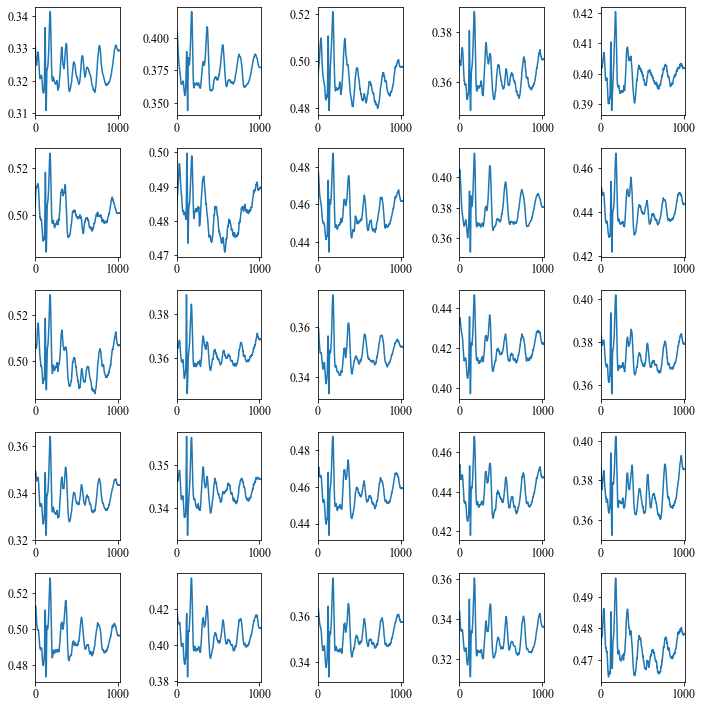

Epoch   891 / 2000
 3525 / 3525 - loss: 9.638040e-05 - Duration: 82 sec - ETA: 25 hour 47 min 23 sec
Epoch   892 / 2000
 3525 / 3525 - loss: 9.956748e-05 - Duration: 82 sec - ETA: 25 hour 45 min 58 sec
Epoch   893 / 2000
 3525 / 3525 - loss: 9.974993e-05 - Duration: 82 sec - ETA: 25 hour 44 min 33 sec
Epoch   894 / 2000
 3525 / 3525 - loss: 9.614452e-05 - Duration: 82 sec - ETA: 25 hour 43 min 7 sec
Epoch   895 / 2000
 3525 / 3525 - loss: 9.774542e-05 - Duration: 82 sec - ETA: 25 hour 41 min 42 sec
Epoch   896 / 2000
 3525 / 3525 - loss: 9.727605e-05 - Duration: 82 sec - ETA: 25 hour 40 min 17 sec
Epoch   897 / 2000
 3525 / 3525 - loss: 9.508736e-05 - Duration: 82 sec - ETA: 25 hour 38 min 52 sec
Epoch   898 / 2000
 3525 / 3525 - loss: 9.820117e-05 - Duration: 82 sec - ETA: 25 hour 37 min 26 sec
Epoch   899 / 2000
 3525 / 3525 - loss: 9.679990e-05 - Duration: 82 sec - ETA: 25 hour 36 min 1 sec
Epoch   900 / 2000
 3525 / 3525 - loss: 9.653521e-05 - Duration: 82 sec - ETA: 25 hour 34 min

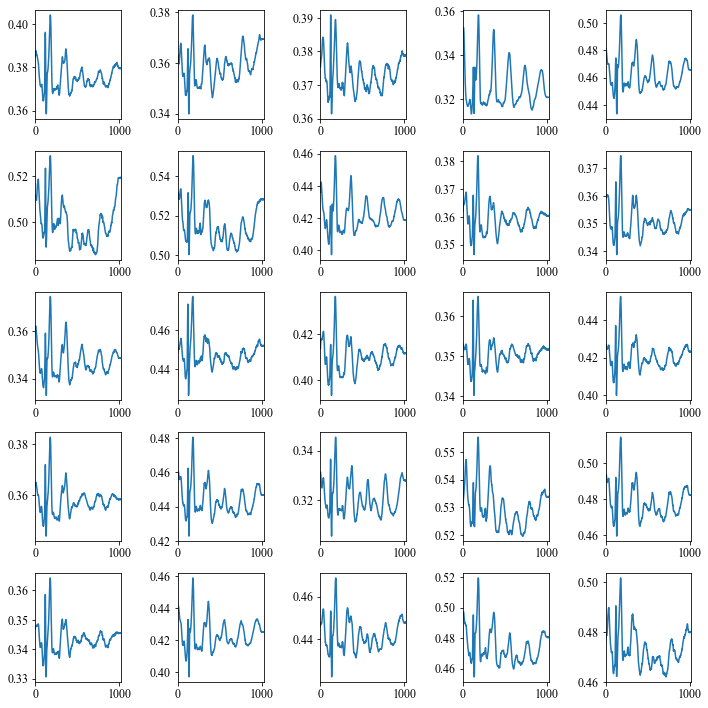

Epoch   901 / 2000
 3525 / 3525 - loss: 9.647421e-05 - Duration: 82 sec - ETA: 25 hour 33 min 11 sec
Epoch   902 / 2000
 3525 / 3525 - loss: 9.781866e-05 - Duration: 82 sec - ETA: 25 hour 31 min 45 sec
Epoch   903 / 2000
 3525 / 3525 - loss: 9.664768e-05 - Duration: 82 sec - ETA: 25 hour 30 min 20 sec
Epoch   904 / 2000
 3525 / 3525 - loss: 9.500448e-05 - Duration: 82 sec - ETA: 25 hour 28 min 55 sec
Epoch   905 / 2000
 3525 / 3525 - loss: 9.820115e-05 - Duration: 82 sec - ETA: 25 hour 27 min 30 sec
Epoch   906 / 2000
 3525 / 3525 - loss: 9.721039e-05 - Duration: 82 sec - ETA: 25 hour 26 min 4 sec
Epoch   907 / 2000
 3525 / 3525 - loss: 9.604249e-05 - Duration: 82 sec - ETA: 25 hour 24 min 39 sec
Epoch   908 / 2000
 3525 / 3525 - loss: 9.747266e-05 - Duration: 82 sec - ETA: 25 hour 23 min 14 sec
Epoch   909 / 2000
 3525 / 3525 - loss: 9.579207e-05 - Duration: 82 sec - ETA: 25 hour 21 min 49 sec
Epoch   910 / 2000
 3525 / 3525 - loss: 9.741694e-05 - Duration: 82 sec - ETA: 25 hour 20 mi

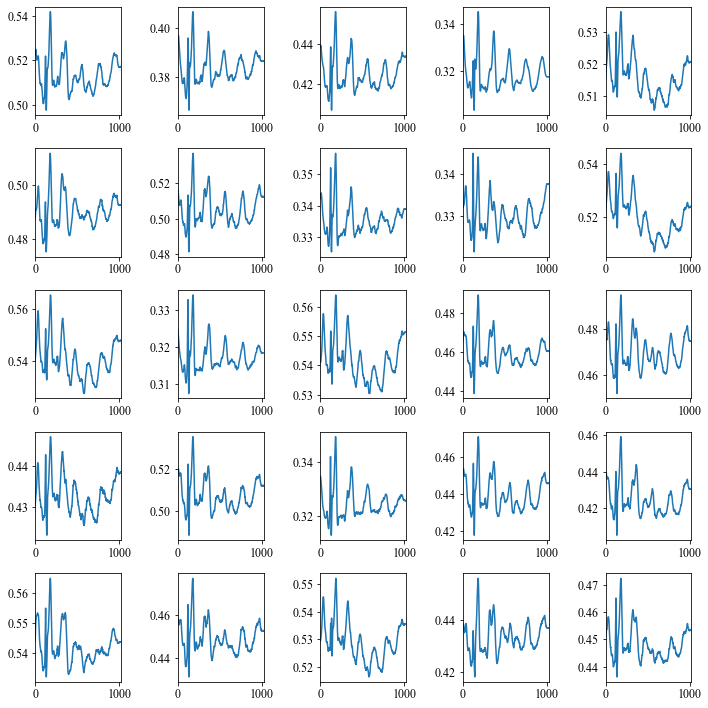

Epoch   911 / 2000
 3525 / 3525 - loss: 9.487251e-05 - Duration: 82 sec - ETA: 25 hour 18 min 59 sec
Epoch   912 / 2000
 3525 / 3525 - loss: 9.508115e-05 - Duration: 82 sec - ETA: 25 hour 17 min 33 sec
Epoch   913 / 2000
 3525 / 3525 - loss: 9.721876e-05 - Duration: 82 sec - ETA: 25 hour 16 min 8 sec
Epoch   914 / 2000
 3525 / 3525 - loss: 9.783895e-05 - Duration: 82 sec - ETA: 25 hour 14 min 43 sec
Epoch   915 / 2000
 3525 / 3525 - loss: 9.369200e-05 - Duration: 82 sec - ETA: 25 hour 13 min 18 sec
Epoch   916 / 2000
 3525 / 3525 - loss: 9.575120e-05 - Duration: 82 sec - ETA: 25 hour 11 min 53 sec
Epoch   917 / 2000
 3525 / 3525 - loss: 9.731075e-05 - Duration: 82 sec - ETA: 25 hour 10 min 28 sec
Epoch   918 / 2000
 3525 / 3525 - loss: 9.552259e-05 - Duration: 82 sec - ETA: 25 hour 9 min 3 sec
Epoch   919 / 2000
 3525 / 3525 - loss: 9.525445e-05 - Duration: 83 sec - ETA: 25 hour 7 min 38 sec
Epoch   920 / 2000
 3525 / 3525 - loss: 9.576813e-05 - Duration: 82 sec - ETA: 25 hour 6 min 13

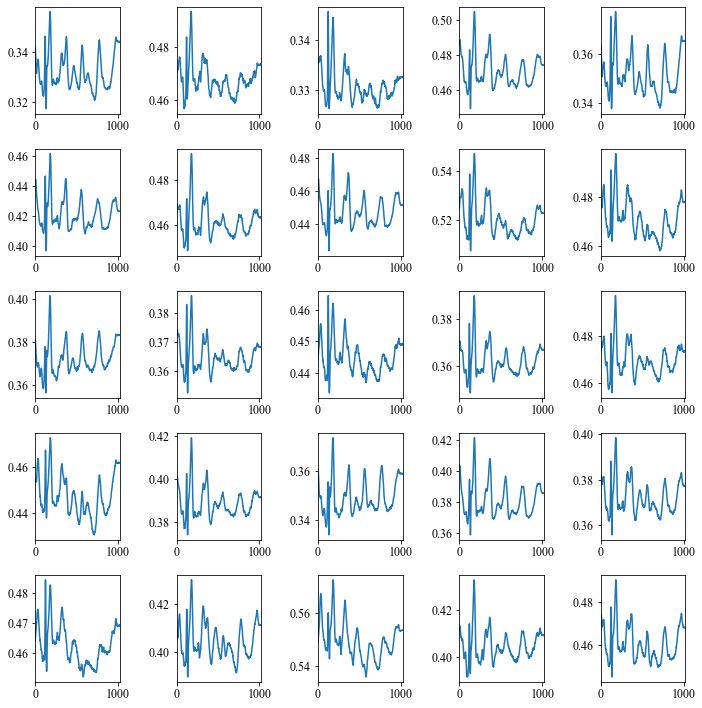

Epoch   921 / 2000
 3525 / 3525 - loss: 9.711006e-05 - Duration: 82 sec - ETA: 25 hour 4 min 48 sec
Epoch   922 / 2000
 3525 / 3525 - loss: 9.479143e-05 - Duration: 82 sec - ETA: 25 hour 3 min 23 sec
Epoch   923 / 2000
 3525 / 3525 - loss: 9.774373e-05 - Duration: 82 sec - ETA: 25 hour 1 min 58 sec
Epoch   924 / 2000
 3525 / 3525 - loss: 9.624230e-05 - Duration: 82 sec - ETA: 25 hour 0 min 32 sec
Epoch   925 / 2000
 3525 / 3525 - loss: 9.452021e-05 - Duration: 82 sec - ETA: 24 hour 59 min 7 sec
Epoch   926 / 2000
 3525 / 3525 - loss: 9.559411e-05 - Duration: 82 sec - ETA: 24 hour 57 min 42 sec
Epoch   927 / 2000
 3525 / 3525 - loss: 9.610972e-05 - Duration: 82 sec - ETA: 24 hour 56 min 17 sec
Epoch   928 / 2000
 3525 / 3525 - loss: 9.384610e-05 - Duration: 82 sec - ETA: 24 hour 54 min 52 sec
Epoch   929 / 2000
 3525 / 3525 - loss: 9.333317e-05 - Duration: 82 sec - ETA: 24 hour 53 min 27 sec
Epoch   930 / 2000
 3525 / 3525 - loss: 9.675946e-05 - Duration: 82 sec - ETA: 24 hour 52 min 2 

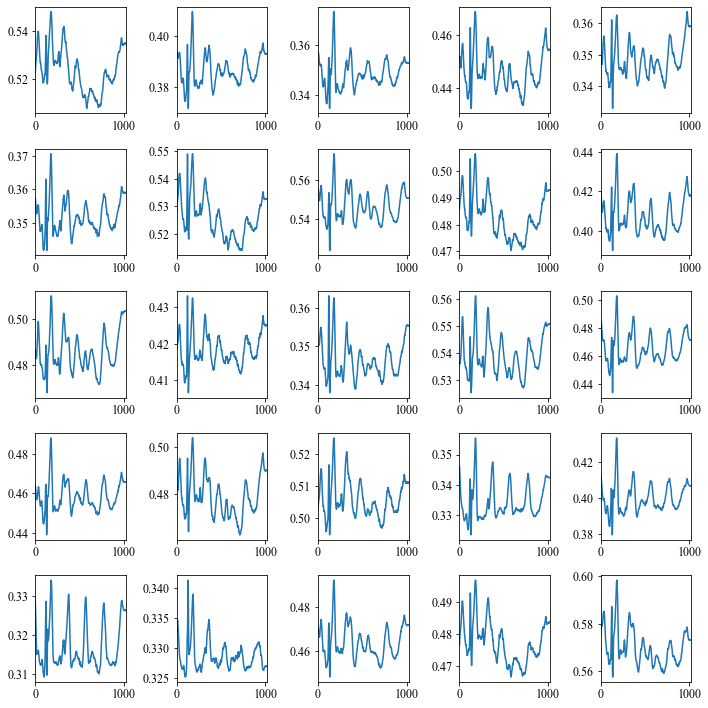

Epoch   931 / 2000
 3525 / 3525 - loss: 9.402484e-05 - Duration: 82 sec - ETA: 24 hour 50 min 37 sec
Epoch   932 / 2000
 3525 / 3525 - loss: 9.537966e-05 - Duration: 82 sec - ETA: 24 hour 49 min 12 sec
Epoch   933 / 2000
 3525 / 3525 - loss: 9.451080e-05 - Duration: 82 sec - ETA: 24 hour 47 min 46 sec
Epoch   934 / 2000
 3525 / 3525 - loss: 9.664911e-05 - Duration: 82 sec - ETA: 24 hour 46 min 21 sec
Epoch   935 / 2000
 3525 / 3525 - loss: 9.415705e-05 - Duration: 83 sec - ETA: 24 hour 44 min 57 sec
Epoch   936 / 2000
 3525 / 3525 - loss: 9.404438e-05 - Duration: 82 sec - ETA: 24 hour 43 min 32 sec
Epoch   937 / 2000
 3525 / 3525 - loss: 9.475483e-05 - Duration: 82 sec - ETA: 24 hour 42 min 7 sec
Epoch   938 / 2000
 3525 / 3525 - loss: 9.342187e-05 - Duration: 82 sec - ETA: 24 hour 40 min 42 sec
Epoch   939 / 2000
 3525 / 3525 - loss: 9.435658e-05 - Duration: 82 sec - ETA: 24 hour 39 min 17 sec
Epoch   940 / 2000
 3525 / 3525 - loss: 9.569363e-05 - Duration: 82 sec - ETA: 24 hour 37 mi

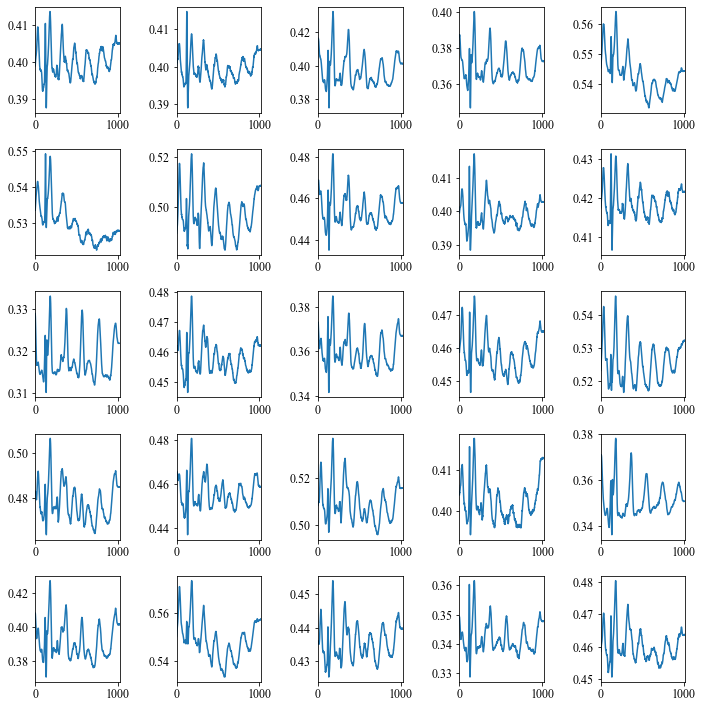

Epoch   941 / 2000
 3525 / 3525 - loss: 9.489118e-05 - Duration: 82 sec - ETA: 24 hour 36 min 27 sec
Epoch   942 / 2000
 3525 / 3525 - loss: 9.780695e-05 - Duration: 82 sec - ETA: 24 hour 35 min 2 sec
Epoch   943 / 2000
 3525 / 3525 - loss: 9.447338e-05 - Duration: 82 sec - ETA: 24 hour 33 min 37 sec
Epoch   944 / 2000
 3525 / 3525 - loss: 9.387624e-05 - Duration: 82 sec - ETA: 24 hour 32 min 12 sec
Epoch   945 / 2000
 3525 / 3525 - loss: 9.228871e-05 - Duration: 82 sec - ETA: 24 hour 30 min 47 sec
Epoch   946 / 2000
 3525 / 3525 - loss: 9.578115e-05 - Duration: 82 sec - ETA: 24 hour 29 min 22 sec
Epoch   947 / 2000
 3525 / 3525 - loss: 9.687061e-05 - Duration: 82 sec - ETA: 24 hour 27 min 57 sec
Epoch   948 / 2000
 3525 / 3525 - loss: 9.495016e-05 - Duration: 82 sec - ETA: 24 hour 26 min 32 sec
Epoch   949 / 2000
 3525 / 3525 - loss: 9.501207e-05 - Duration: 82 sec - ETA: 24 hour 25 min 7 sec
Epoch   950 / 2000
 3525 / 3525 - loss: 9.324208e-05 - Duration: 82 sec - ETA: 24 hour 23 min

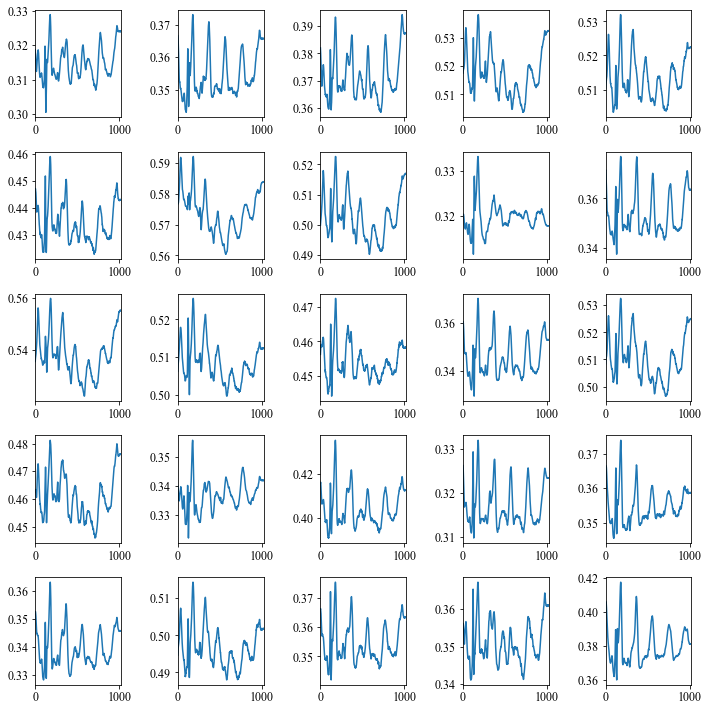

Epoch   951 / 2000
 3525 / 3525 - loss: 9.393130e-05 - Duration: 82 sec - ETA: 24 hour 22 min 17 sec
Epoch   952 / 2000
 3525 / 3525 - loss: 9.362262e-05 - Duration: 82 sec - ETA: 24 hour 20 min 53 sec
Epoch   953 / 2000
 3525 / 3525 - loss: 9.603527e-05 - Duration: 82 sec - ETA: 24 hour 19 min 28 sec
Epoch   954 / 2000
 3525 / 3525 - loss: 9.358321e-05 - Duration: 82 sec - ETA: 24 hour 18 min 3 sec
Epoch   955 / 2000
 3525 / 3525 - loss: 9.369966e-05 - Duration: 82 sec - ETA: 24 hour 16 min 38 sec
Epoch   956 / 2000
 3525 / 3525 - loss: 9.308999e-05 - Duration: 82 sec - ETA: 24 hour 15 min 14 sec
Epoch   957 / 2000
 3525 / 3525 - loss: 9.271565e-05 - Duration: 82 sec - ETA: 24 hour 13 min 49 sec
Epoch   958 / 2000
 3525 / 3525 - loss: 9.345511e-05 - Duration: 82 sec - ETA: 24 hour 12 min 24 sec
Epoch   959 / 2000
 3525 / 3525 - loss: 9.448197e-05 - Duration: 82 sec - ETA: 24 hour 11 min 0 sec
Epoch   960 / 2000
 3525 / 3525 - loss: 9.279600e-05 - Duration: 82 sec - ETA: 24 hour 9 min 

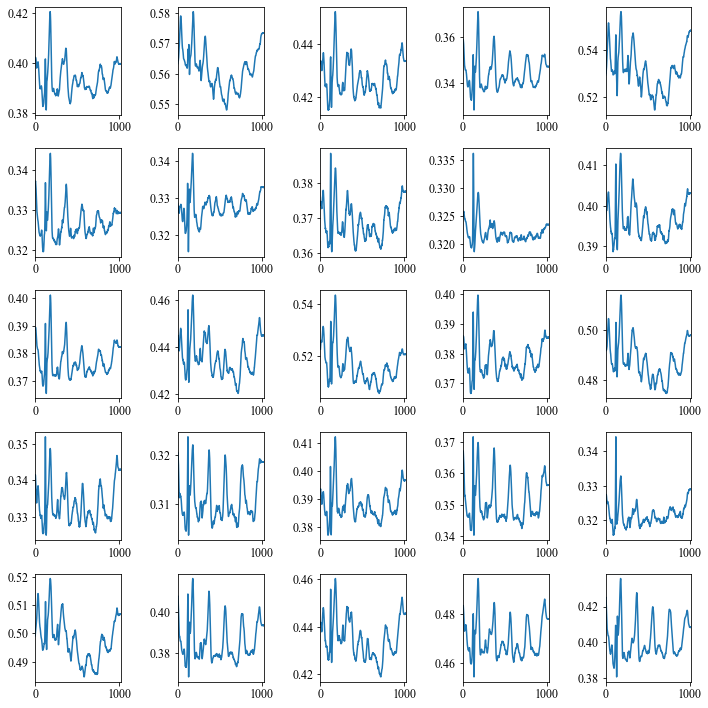

Epoch   961 / 2000
 3525 / 3525 - loss: 9.381796e-05 - Duration: 82 sec - ETA: 24 hour 8 min 10 sec
Epoch   962 / 2000
 3525 / 3525 - loss: 9.370627e-05 - Duration: 82 sec - ETA: 24 hour 6 min 46 sec
Epoch   963 / 2000
 3525 / 3525 - loss: 9.530531e-05 - Duration: 82 sec - ETA: 24 hour 5 min 21 sec
Epoch   964 / 2000
 3525 / 3525 - loss: 9.307617e-05 - Duration: 82 sec - ETA: 24 hour 3 min 56 sec
Epoch   965 / 2000
 3525 / 3525 - loss: 9.285014e-05 - Duration: 82 sec - ETA: 24 hour 2 min 31 sec
Epoch   966 / 2000
 3525 / 3525 - loss: 9.118973e-05 - Duration: 82 sec - ETA: 24 hour 1 min 6 sec
Epoch   967 / 2000
 3525 / 3525 - loss: 9.278128e-05 - Duration: 82 sec - ETA: 23 hour 59 min 42 sec
Epoch   968 / 2000
 3525 / 3525 - loss: 9.226396e-05 - Duration: 82 sec - ETA: 23 hour 58 min 17 sec
Epoch   969 / 2000
 3525 / 3525 - loss: 9.328717e-05 - Duration: 82 sec - ETA: 23 hour 56 min 52 sec
Epoch   970 / 2000
 3525 / 3525 - loss: 9.158318e-05 - Duration: 82 sec - ETA: 23 hour 55 min 27 s

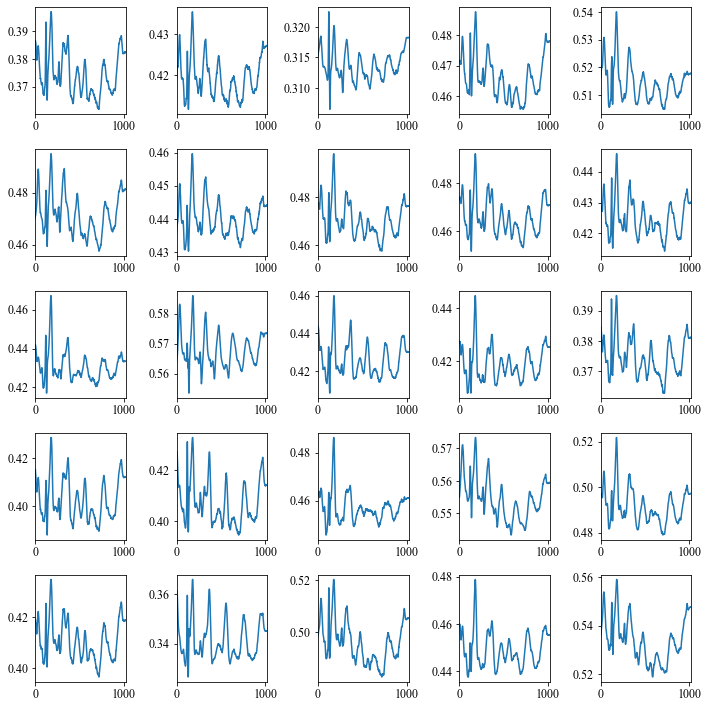

Epoch   971 / 2000
 3525 / 3525 - loss: 9.251366e-05 - Duration: 82 sec - ETA: 23 hour 54 min 3 sec
Epoch   972 / 2000
 3525 / 3525 - loss: 9.168560e-05 - Duration: 82 sec - ETA: 23 hour 52 min 38 sec
Epoch   973 / 2000
 3525 / 3525 - loss: 9.210589e-05 - Duration: 82 sec - ETA: 23 hour 51 min 13 sec
Epoch   974 / 2000
 3525 / 3525 - loss: 9.323361e-05 - Duration: 82 sec - ETA: 23 hour 49 min 49 sec
Epoch   975 / 2000
 3525 / 3525 - loss: 9.220009e-05 - Duration: 82 sec - ETA: 23 hour 48 min 24 sec
Epoch   976 / 2000
 3525 / 3525 - loss: 9.156245e-05 - Duration: 82 sec - ETA: 23 hour 46 min 59 sec
Epoch   977 / 2000
 3525 / 3525 - loss: 9.197329e-05 - Duration: 82 sec - ETA: 23 hour 45 min 34 sec
Epoch   978 / 2000
 3525 / 3525 - loss: 9.143697e-05 - Duration: 82 sec - ETA: 23 hour 44 min 9 sec
Epoch   979 / 2000
 3525 / 3525 - loss: 9.209628e-05 - Duration: 82 sec - ETA: 23 hour 42 min 45 sec
Epoch   980 / 2000
 3525 / 3525 - loss: 9.243621e-05 - Duration: 82 sec - ETA: 23 hour 41 min

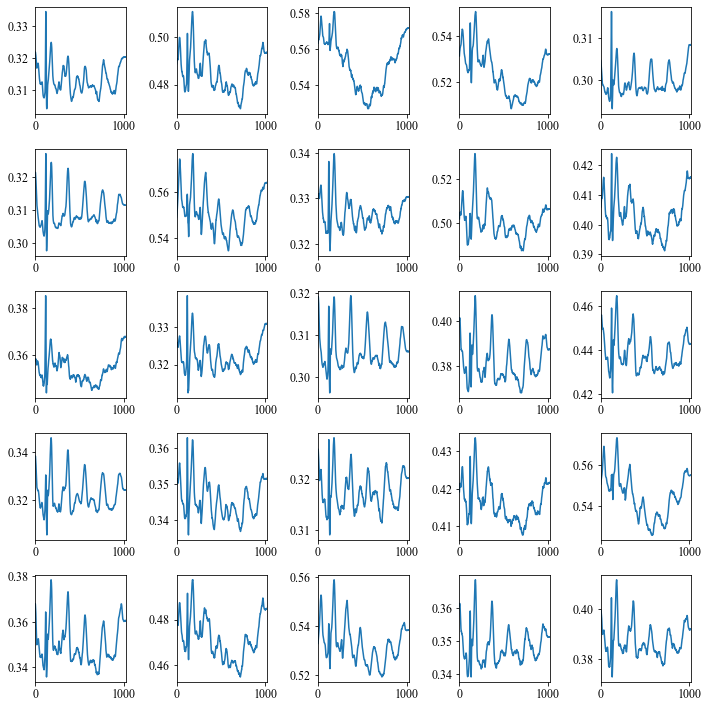

Epoch   981 / 2000
 3525 / 3525 - loss: 9.343588e-05 - Duration: 82 sec - ETA: 23 hour 39 min 55 sec
Epoch   982 / 2000
 3525 / 3525 - loss: 9.244715e-05 - Duration: 82 sec - ETA: 23 hour 38 min 30 sec
Epoch   983 / 2000
 3525 / 3525 - loss: 9.170678e-05 - Duration: 82 sec - ETA: 23 hour 37 min 5 sec
Epoch   984 / 2000
 3525 / 3525 - loss: 8.962864e-05 - Duration: 82 sec - ETA: 23 hour 35 min 41 sec
Epoch   985 / 2000
 3525 / 3525 - loss: 9.067026e-05 - Duration: 82 sec - ETA: 23 hour 34 min 16 sec
Epoch   986 / 2000
 3525 / 3525 - loss: 9.197232e-05 - Duration: 82 sec - ETA: 23 hour 32 min 51 sec
Epoch   987 / 2000
 3525 / 3525 - loss: 9.210450e-05 - Duration: 82 sec - ETA: 23 hour 31 min 27 sec
Epoch   988 / 2000
 3525 / 3525 - loss: 9.284775e-05 - Duration: 82 sec - ETA: 23 hour 30 min 2 sec
Epoch   989 / 2000
 3525 / 3525 - loss: 9.053474e-05 - Duration: 82 sec - ETA: 23 hour 28 min 37 sec
Epoch   990 / 2000
 3525 / 3525 - loss: 9.081492e-05 - Duration: 82 sec - ETA: 23 hour 27 min

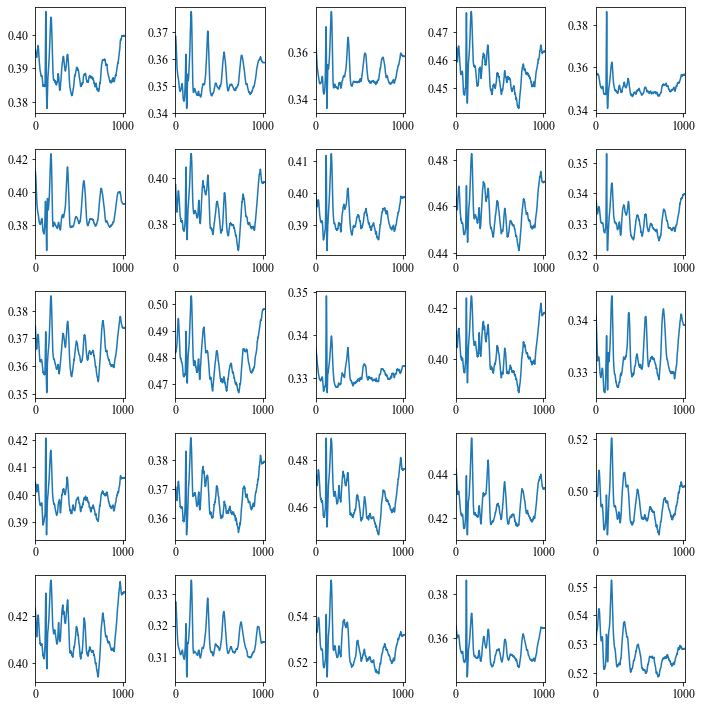

Epoch   991 / 2000
 3525 / 3525 - loss: 8.953952e-05 - Duration: 82 sec - ETA: 23 hour 25 min 48 sec
Epoch   992 / 2000
 3525 / 3525 - loss: 9.253694e-05 - Duration: 82 sec - ETA: 23 hour 24 min 23 sec
Epoch   993 / 2000
 3525 / 3525 - loss: 9.251088e-05 - Duration: 82 sec - ETA: 23 hour 22 min 58 sec
Epoch   994 / 2000
 3525 / 3525 - loss: 8.996491e-05 - Duration: 82 sec - ETA: 23 hour 21 min 33 sec
Epoch   995 / 2000
 3525 / 3525 - loss: 8.961086e-05 - Duration: 82 sec - ETA: 23 hour 20 min 9 sec
Epoch   996 / 2000
 3525 / 3525 - loss: 9.153584e-05 - Duration: 82 sec - ETA: 23 hour 18 min 44 sec
Epoch   997 / 2000
 3525 / 3525 - loss: 9.050086e-05 - Duration: 82 sec - ETA: 23 hour 17 min 19 sec
Epoch   998 / 2000
 3525 / 3525 - loss: 9.152009e-05 - Duration: 82 sec - ETA: 23 hour 15 min 54 sec
Epoch   999 / 2000
 3525 / 3525 - loss: 9.068111e-05 - Duration: 82 sec - ETA: 23 hour 14 min 29 sec
Epoch  1000 / 2000
 3525 / 3525 - loss: 8.995389e-05 - Duration: 82 sec - ETA: 23 hour 13 mi

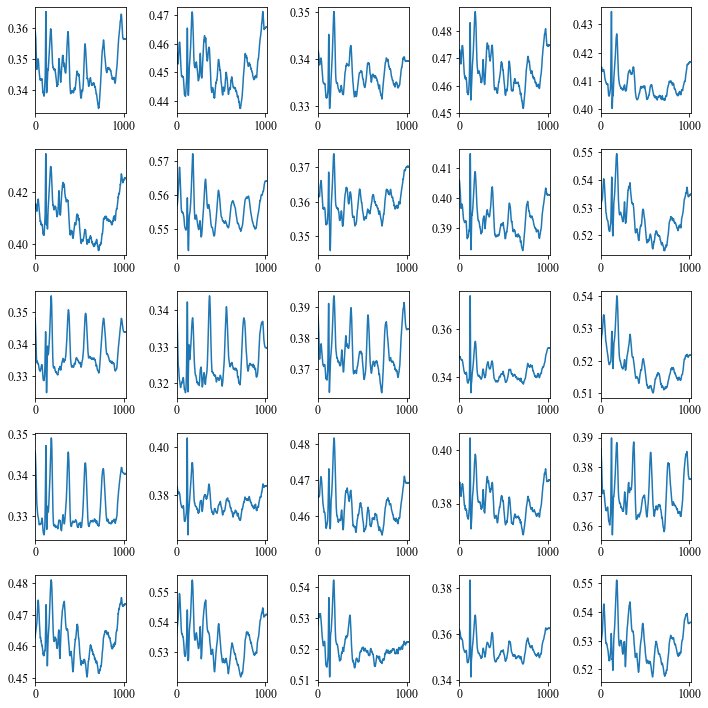

Epoch  1001 / 2000
 3525 / 3525 - loss: 9.098806e-05 - Duration: 82 sec - ETA: 23 hour 11 min 40 sec
Epoch  1002 / 2000
 3525 / 3525 - loss: 9.003121e-05 - Duration: 82 sec - ETA: 23 hour 10 min 15 sec
Epoch  1003 / 2000
 3525 / 3525 - loss: 9.132455e-05 - Duration: 82 sec - ETA: 23 hour 8 min 51 sec
Epoch  1004 / 2000
 3525 / 3525 - loss: 8.931728e-05 - Duration: 82 sec - ETA: 23 hour 7 min 26 sec
Epoch  1005 / 2000
 3525 / 3525 - loss: 9.028310e-05 - Duration: 82 sec - ETA: 23 hour 6 min 1 sec
Epoch  1006 / 2000
 3525 / 3525 - loss: 9.105003e-05 - Duration: 82 sec - ETA: 23 hour 4 min 37 sec
Epoch  1007 / 2000
 3525 / 3525 - loss: 9.053960e-05 - Duration: 82 sec - ETA: 23 hour 3 min 12 sec
Epoch  1008 / 2000
 3525 / 3525 - loss: 9.073789e-05 - Duration: 82 sec - ETA: 23 hour 1 min 47 sec
Epoch  1009 / 2000
 3525 / 3525 - loss: 8.974632e-05 - Duration: 83 sec - ETA: 23 hour 0 min 24 sec
Epoch  1010 / 2000
 3525 / 3525 - loss: 9.084211e-05 - Duration: 84 sec - ETA: 22 hour 59 min 2 sec

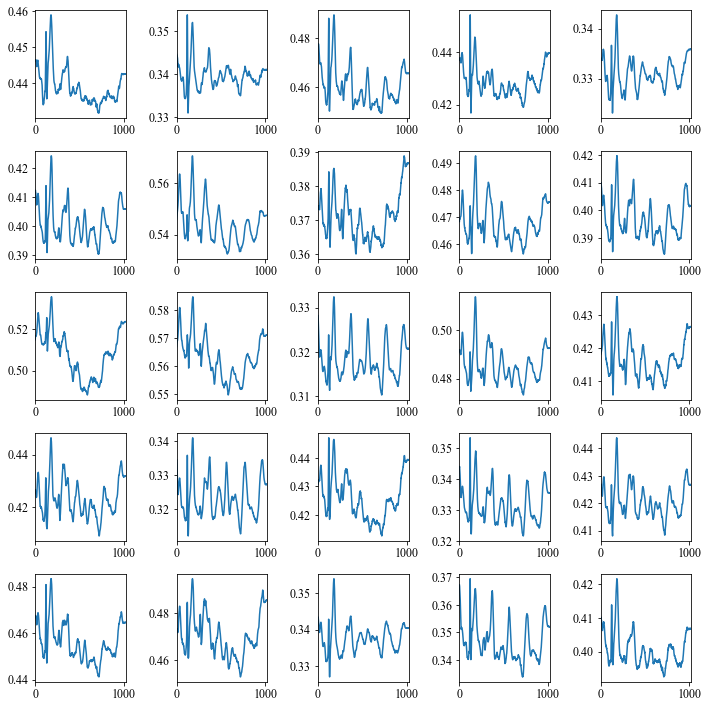

Epoch  1011 / 2000
 3525 / 3525 - loss: 8.989978e-05 - Duration: 84 sec - ETA: 22 hour 57 min 40 sec
Epoch  1012 / 2000
 3525 / 3525 - loss: 8.914051e-05 - Duration: 85 sec - ETA: 22 hour 56 min 17 sec
Epoch  1013 / 2000
 3525 / 3525 - loss: 9.211979e-05 - Duration: 84 sec - ETA: 22 hour 54 min 55 sec
Epoch  1014 / 2000
 3525 / 3525 - loss: 9.023301e-05 - Duration: 84 sec - ETA: 22 hour 53 min 33 sec
Epoch  1015 / 2000
 3525 / 3525 - loss: 8.946924e-05 - Duration: 82 sec - ETA: 22 hour 52 min 8 sec
Epoch  1016 / 2000
 3525 / 3525 - loss: 8.856674e-05 - Duration: 82 sec - ETA: 22 hour 50 min 44 sec
Epoch  1017 / 2000
 3525 / 3525 - loss: 9.154159e-05 - Duration: 82 sec - ETA: 22 hour 49 min 19 sec
Epoch  1018 / 2000
 3525 / 3525 - loss: 9.037028e-05 - Duration: 82 sec - ETA: 22 hour 47 min 54 sec
Epoch  1019 / 2000
 3525 / 3525 - loss: 8.804908e-05 - Duration: 82 sec - ETA: 22 hour 46 min 30 sec
Epoch  1020 / 2000
 3525 / 3525 - loss: 9.095450e-05 - Duration: 82 sec - ETA: 22 hour 45 mi

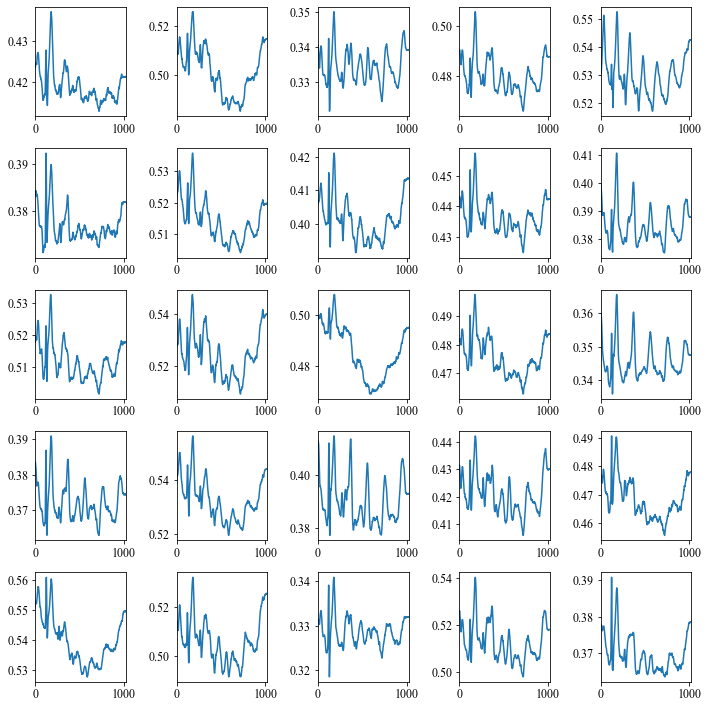

Epoch  1021 / 2000
 3525 / 3525 - loss: 8.803189e-05 - Duration: 82 sec - ETA: 22 hour 43 min 41 sec
Epoch  1022 / 2000
 3525 / 3525 - loss: 8.878177e-05 - Duration: 82 sec - ETA: 22 hour 42 min 16 sec
Epoch  1023 / 2000
 3525 / 3525 - loss: 9.099806e-05 - Duration: 82 sec - ETA: 22 hour 40 min 51 sec
Epoch  1024 / 2000
 3525 / 3525 - loss: 8.931737e-05 - Duration: 82 sec - ETA: 22 hour 39 min 27 sec
Epoch  1025 / 2000
 3525 / 3525 - loss: 8.940731e-05 - Duration: 82 sec - ETA: 22 hour 38 min 2 sec
Epoch  1026 / 2000
 3525 / 3525 - loss: 8.876539e-05 - Duration: 82 sec - ETA: 22 hour 36 min 37 sec
Epoch  1027 / 2000
 3525 / 3525 - loss: 9.110393e-05 - Duration: 82 sec - ETA: 22 hour 35 min 13 sec
Epoch  1028 / 2000
 3525 / 3525 - loss: 9.044277e-05 - Duration: 82 sec - ETA: 22 hour 33 min 48 sec
Epoch  1029 / 2000
 3525 / 3525 - loss: 9.012106e-05 - Duration: 82 sec - ETA: 22 hour 32 min 24 sec
Epoch  1030 / 2000
 3525 / 3525 - loss: 8.881709e-05 - Duration: 82 sec - ETA: 22 hour 30 mi

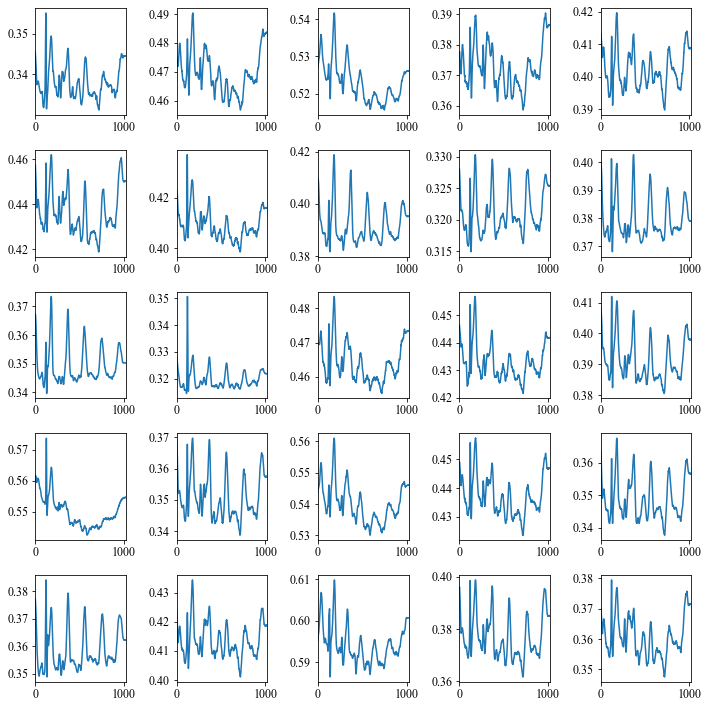

Epoch  1031 / 2000
 3525 / 3525 - loss: 8.949009e-05 - Duration: 82 sec - ETA: 22 hour 29 min 34 sec
Epoch  1032 / 2000
 3525 / 3525 - loss: 8.833049e-05 - Duration: 82 sec - ETA: 22 hour 28 min 10 sec
Epoch  1033 / 2000
 3525 / 3525 - loss: 9.015529e-05 - Duration: 82 sec - ETA: 22 hour 26 min 45 sec
Epoch  1034 / 2000
 3525 / 3525 - loss: 8.836994e-05 - Duration: 82 sec - ETA: 22 hour 25 min 21 sec
Epoch  1035 / 2000
 3525 / 3525 - loss: 8.866494e-05 - Duration: 82 sec - ETA: 22 hour 23 min 56 sec
Epoch  1036 / 2000
 3525 / 3525 - loss: 8.878014e-05 - Duration: 82 sec - ETA: 22 hour 22 min 31 sec
Epoch  1037 / 2000
 3525 / 3525 - loss: 8.856568e-05 - Duration: 82 sec - ETA: 22 hour 21 min 7 sec
Epoch  1038 / 2000
 3525 / 3525 - loss: 8.813927e-05 - Duration: 82 sec - ETA: 22 hour 19 min 43 sec
Epoch  1039 / 2000
 3525 / 3525 - loss: 8.667486e-05 - Duration: 82 sec - ETA: 22 hour 18 min 18 sec
Epoch  1040 / 2000
 3525 / 3525 - loss: 8.861149e-05 - Duration: 82 sec - ETA: 22 hour 16 mi

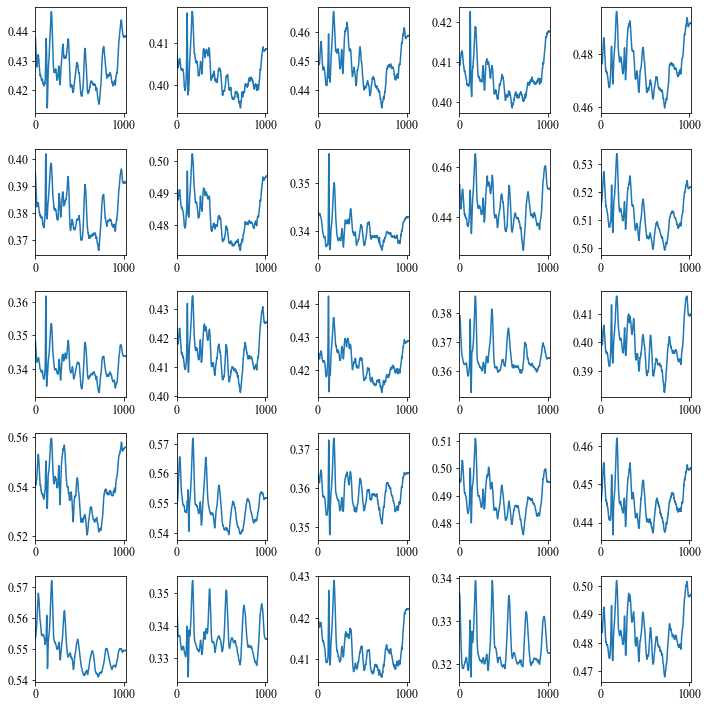

Epoch  1041 / 2000
 3525 / 3525 - loss: 8.813069e-05 - Duration: 82 sec - ETA: 22 hour 15 min 29 sec
Epoch  1042 / 2000
 3525 / 3525 - loss: 8.814690e-05 - Duration: 82 sec - ETA: 22 hour 14 min 4 sec
Epoch  1043 / 2000
 3525 / 3525 - loss: 8.862749e-05 - Duration: 82 sec - ETA: 22 hour 12 min 40 sec
Epoch  1044 / 2000
 3525 / 3525 - loss: 8.945155e-05 - Duration: 82 sec - ETA: 22 hour 11 min 15 sec
Epoch  1045 / 2000
 3525 / 3525 - loss: 8.662565e-05 - Duration: 82 sec - ETA: 22 hour 9 min 51 sec
Epoch  1046 / 2000
 3525 / 3525 - loss: 8.711117e-05 - Duration: 82 sec - ETA: 22 hour 8 min 26 sec
Epoch  1047 / 2000
 3525 / 3525 - loss: 8.815658e-05 - Duration: 82 sec - ETA: 22 hour 7 min 2 sec
Epoch  1048 / 2000
 3525 / 3525 - loss: 8.836548e-05 - Duration: 82 sec - ETA: 22 hour 5 min 37 sec
Epoch  1049 / 2000
 3525 / 3525 - loss: 8.918189e-05 - Duration: 82 sec - ETA: 22 hour 4 min 13 sec
Epoch  1050 / 2000
 3525 / 3525 - loss: 8.875996e-05 - Duration: 82 sec - ETA: 22 hour 2 min 48 se

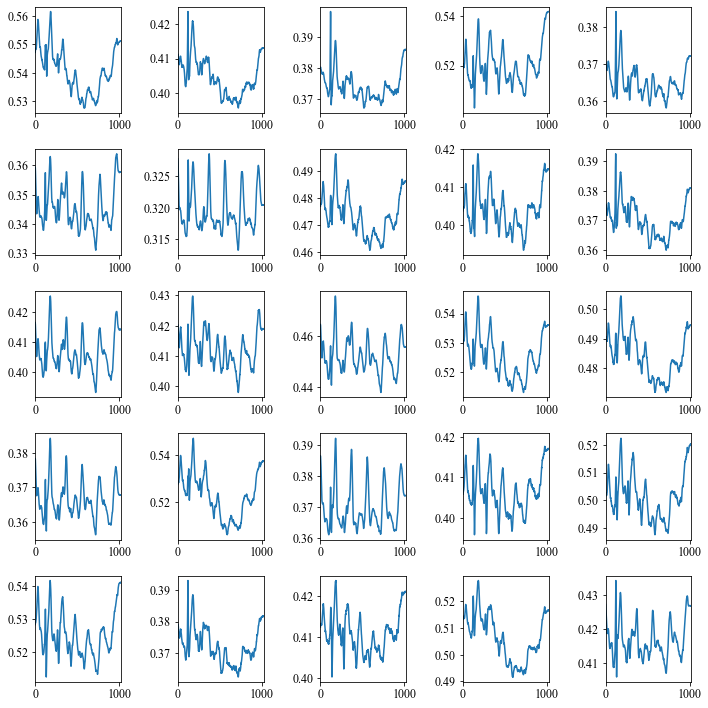

Epoch  1051 / 2000
 3525 / 3525 - loss: 8.926662e-05 - Duration: 82 sec - ETA: 22 hour 1 min 24 sec
Epoch  1052 / 2000
 3525 / 3525 - loss: 8.724492e-05 - Duration: 84 sec - ETA: 22 hour 0 min 1 sec
Epoch  1053 / 2000
 3525 / 3525 - loss: 8.820786e-05 - Duration: 88 sec - ETA: 21 hour 58 min 42 sec
Epoch  1054 / 2000
 3525 / 3525 - loss: 8.862535e-05 - Duration: 88 sec - ETA: 21 hour 57 min 23 sec
Epoch  1055 / 2000
 3525 / 3525 - loss: 8.706394e-05 - Duration: 88 sec - ETA: 21 hour 56 min 4 sec
Epoch  1056 / 2000
 3525 / 3525 - loss: 8.781876e-05 - Duration: 88 sec - ETA: 21 hour 54 min 45 sec
Epoch  1057 / 2000
 3525 / 3525 - loss: 8.854378e-05 - Duration: 88 sec - ETA: 21 hour 53 min 26 sec
Epoch  1058 / 2000
 3525 / 3525 - loss: 8.763841e-05 - Duration: 88 sec - ETA: 21 hour 52 min 6 sec
Epoch  1059 / 2000
 3525 / 3525 - loss: 8.987739e-05 - Duration: 88 sec - ETA: 21 hour 50 min 47 sec
Epoch  1060 / 2000
 3525 / 3525 - loss: 8.758026e-05 - Duration: 88 sec - ETA: 21 hour 49 min 28

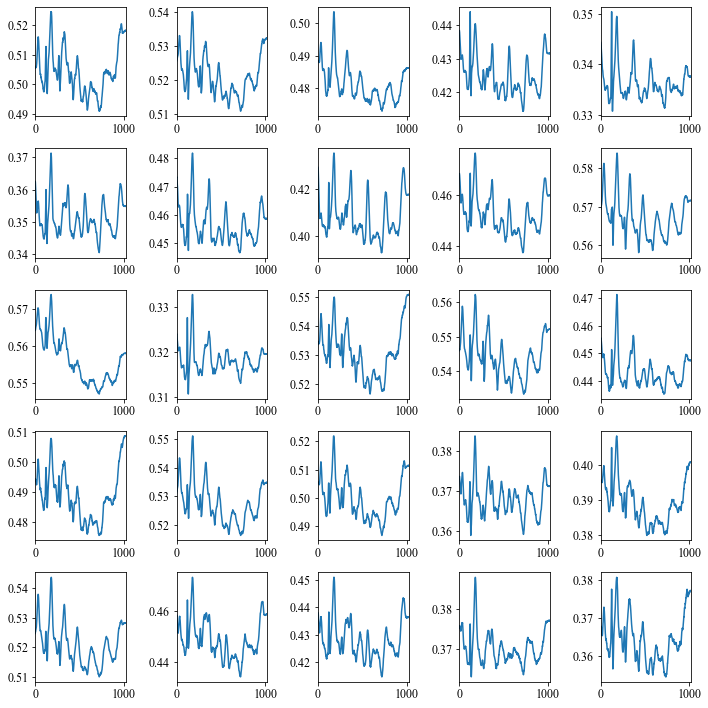

Epoch  1061 / 2000
 3525 / 3525 - loss: 8.823660e-05 - Duration: 88 sec - ETA: 21 hour 48 min 9 sec
Epoch  1062 / 2000
 3525 / 3525 - loss: 8.687009e-05 - Duration: 88 sec - ETA: 21 hour 46 min 49 sec
Epoch  1063 / 2000
 3525 / 3525 - loss: 8.747040e-05 - Duration: 88 sec - ETA: 21 hour 45 min 29 sec
Epoch  1064 / 2000
 3525 / 3525 - loss: 8.941646e-05 - Duration: 88 sec - ETA: 21 hour 44 min 10 sec
Epoch  1065 / 2000
 3525 / 3525 - loss: 8.751776e-05 - Duration: 88 sec - ETA: 21 hour 42 min 50 sec
Epoch  1066 / 2000
 3525 / 3525 - loss: 8.711805e-05 - Duration: 88 sec - ETA: 21 hour 41 min 30 sec
Epoch  1067 / 2000
 3525 / 3525 - loss: 8.617271e-05 - Duration: 88 sec - ETA: 21 hour 40 min 11 sec
Epoch  1068 / 2000
 3525 / 3525 - loss: 8.574771e-05 - Duration: 88 sec - ETA: 21 hour 38 min 51 sec
Epoch  1069 / 2000
 3525 / 3525 - loss: 8.666138e-05 - Duration: 88 sec - ETA: 21 hour 37 min 31 sec
Epoch  1070 / 2000
 3525 / 3525 - loss: 8.662551e-05 - Duration: 88 sec - ETA: 21 hour 36 mi

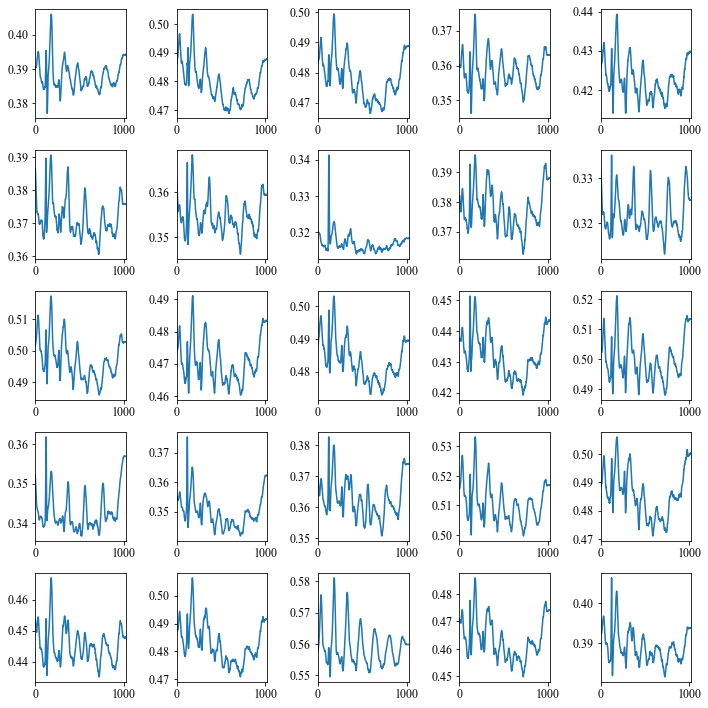

Epoch  1071 / 2000
 3525 / 3525 - loss: 8.696707e-05 - Duration: 88 sec - ETA: 21 hour 34 min 52 sec
Epoch  1072 / 2000
 3525 / 3525 - loss: 8.777575e-05 - Duration: 88 sec - ETA: 21 hour 33 min 32 sec
Epoch  1073 / 2000
 3525 / 3525 - loss: 8.799097e-05 - Duration: 88 sec - ETA: 21 hour 32 min 12 sec
Epoch  1074 / 2000
 3525 / 3525 - loss: 8.645906e-05 - Duration: 88 sec - ETA: 21 hour 30 min 53 sec
Epoch  1075 / 2000
 3525 / 3525 - loss: 8.638470e-05 - Duration: 88 sec - ETA: 21 hour 29 min 33 sec
Epoch  1076 / 2000
 3525 / 3525 - loss: 8.666658e-05 - Duration: 88 sec - ETA: 21 hour 28 min 13 sec
Epoch  1077 / 2000
 3525 / 3525 - loss: 8.635878e-05 - Duration: 88 sec - ETA: 21 hour 26 min 53 sec
Epoch  1078 / 2000
 3525 / 3525 - loss: 8.722522e-05 - Duration: 88 sec - ETA: 21 hour 25 min 33 sec
Epoch  1079 / 2000
 3525 / 3525 - loss: 8.756800e-05 - Duration: 88 sec - ETA: 21 hour 24 min 13 sec
Epoch  1080 / 2000
 3525 / 3525 - loss: 8.824832e-05 - Duration: 87 sec - ETA: 21 hour 22 m

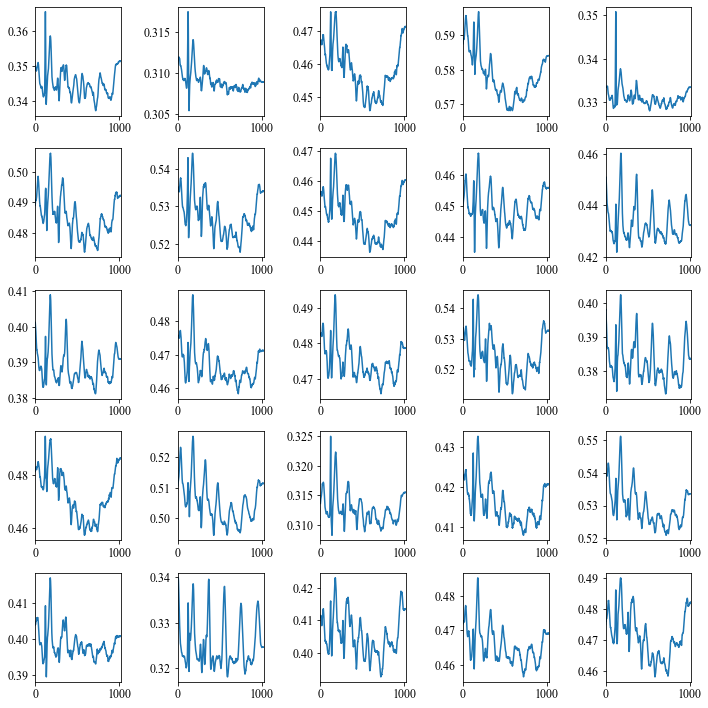

Epoch  1081 / 2000
 3525 / 3525 - loss: 8.856534e-05 - Duration: 88 sec - ETA: 21 hour 21 min 33 sec
Epoch  1082 / 2000
 3525 / 3525 - loss: 8.713865e-05 - Duration: 88 sec - ETA: 21 hour 20 min 14 sec
Epoch  1083 / 2000
 3525 / 3525 - loss: 8.536357e-05 - Duration: 88 sec - ETA: 21 hour 18 min 54 sec
Epoch  1084 / 2000
 3525 / 3525 - loss: 8.748468e-05 - Duration: 88 sec - ETA: 21 hour 17 min 34 sec
Epoch  1085 / 2000
 3525 / 3525 - loss: 8.660016e-05 - Duration: 88 sec - ETA: 21 hour 16 min 14 sec
Epoch  1086 / 2000
 3525 / 3525 - loss: 8.715186e-05 - Duration: 88 sec - ETA: 21 hour 14 min 54 sec
Epoch  1087 / 2000
 3525 / 3525 - loss: 8.497541e-05 - Duration: 88 sec - ETA: 21 hour 13 min 34 sec
Epoch  1088 / 2000
 3525 / 3525 - loss: 8.510769e-05 - Duration: 88 sec - ETA: 21 hour 12 min 14 sec
Epoch  1089 / 2000
 3525 / 3525 - loss: 8.650319e-05 - Duration: 88 sec - ETA: 21 hour 10 min 54 sec
Epoch  1090 / 2000
 3525 / 3525 - loss: 8.681250e-05 - Duration: 88 sec - ETA: 21 hour 9 mi

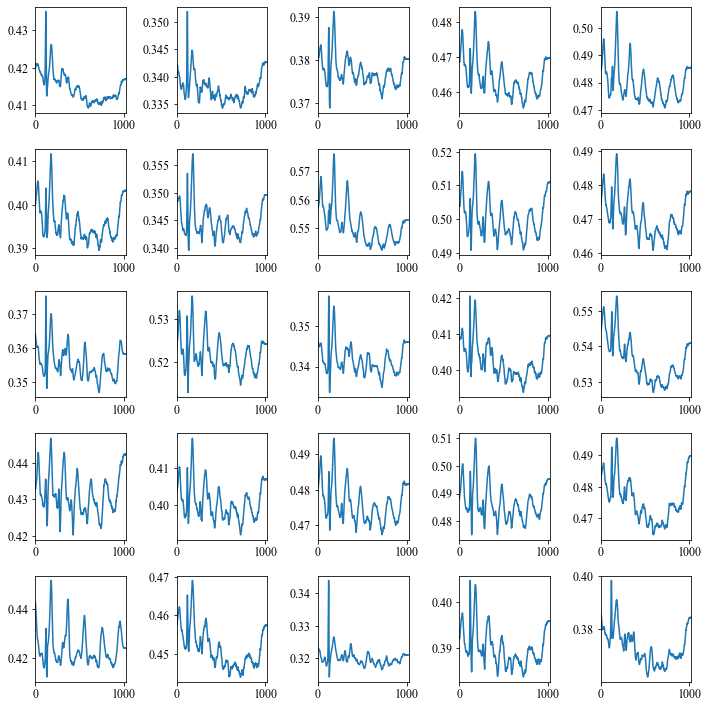

Epoch  1091 / 2000
 3525 / 3525 - loss: 8.742050e-05 - Duration: 88 sec - ETA: 21 hour 8 min 14 sec
Epoch  1092 / 2000
 3525 / 3525 - loss: 8.578741e-05 - Duration: 88 sec - ETA: 21 hour 6 min 53 sec
Epoch  1093 / 2000
 3525 / 3525 - loss: 8.527229e-05 - Duration: 88 sec - ETA: 21 hour 5 min 34 sec
Epoch  1094 / 2000
 3525 / 3525 - loss: 8.438742e-05 - Duration: 88 sec - ETA: 21 hour 4 min 13 sec
Epoch  1095 / 2000
 3525 / 3525 - loss: 8.492141e-05 - Duration: 88 sec - ETA: 21 hour 2 min 53 sec
Epoch  1096 / 2000
 3525 / 3525 - loss: 8.654673e-05 - Duration: 88 sec - ETA: 21 hour 1 min 33 sec
Epoch  1097 / 2000
 3525 / 3525 - loss: 8.392792e-05 - Duration: 88 sec - ETA: 21 hour 0 min 13 sec
Epoch  1098 / 2000
 3525 / 3525 - loss: 8.656982e-05 - Duration: 88 sec - ETA: 20 hour 58 min 53 sec
Epoch  1099 / 2000
 3525 / 3525 - loss: 8.758969e-05 - Duration: 88 sec - ETA: 20 hour 57 min 33 sec
Epoch  1100 / 2000
 3525 / 3525 - loss: 8.563157e-05 - Duration: 88 sec - ETA: 20 hour 56 min 13 s

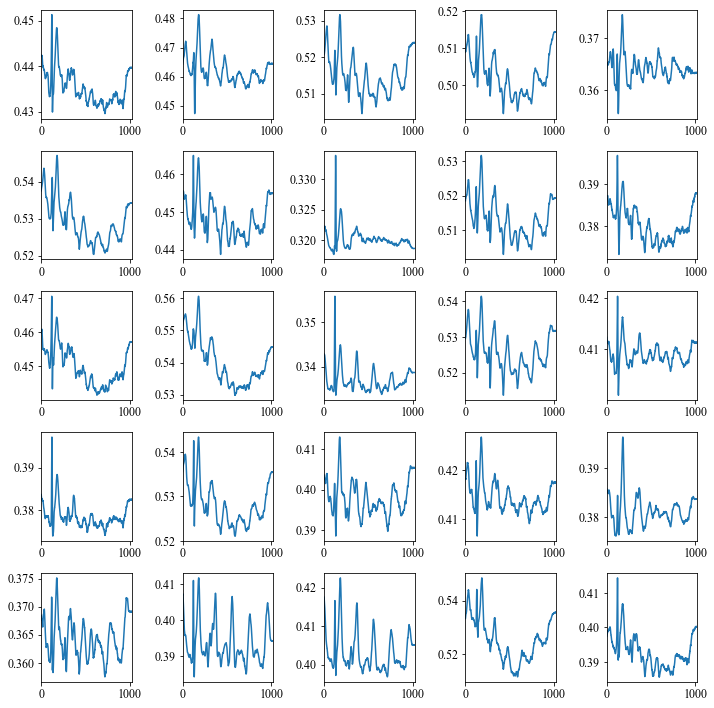

Epoch  1101 / 2000
 3525 / 3525 - loss: 8.553927e-05 - Duration: 88 sec - ETA: 20 hour 54 min 53 sec
Epoch  1102 / 2000
 3525 / 3525 - loss: 8.445354e-05 - Duration: 88 sec - ETA: 20 hour 53 min 33 sec
Epoch  1103 / 2000
 3525 / 3525 - loss: 8.502339e-05 - Duration: 88 sec - ETA: 20 hour 52 min 13 sec
Epoch  1104 / 2000
 3525 / 3525 - loss: 8.629880e-05 - Duration: 88 sec - ETA: 20 hour 50 min 53 sec
Epoch  1105 / 2000
 3525 / 3525 - loss: 8.538644e-05 - Duration: 88 sec - ETA: 20 hour 49 min 33 sec
Epoch  1106 / 2000
 3525 / 3525 - loss: 8.477180e-05 - Duration: 88 sec - ETA: 20 hour 48 min 12 sec
Epoch  1107 / 2000
 3525 / 3525 - loss: 8.635170e-05 - Duration: 88 sec - ETA: 20 hour 46 min 52 sec
Epoch  1108 / 2000
 3525 / 3525 - loss: 8.534832e-05 - Duration: 88 sec - ETA: 20 hour 45 min 32 sec
Epoch  1109 / 2000
 3525 / 3525 - loss: 8.530239e-05 - Duration: 88 sec - ETA: 20 hour 44 min 12 sec
Epoch  1110 / 2000
 3525 / 3525 - loss: 8.561530e-05 - Duration: 88 sec - ETA: 20 hour 42 m

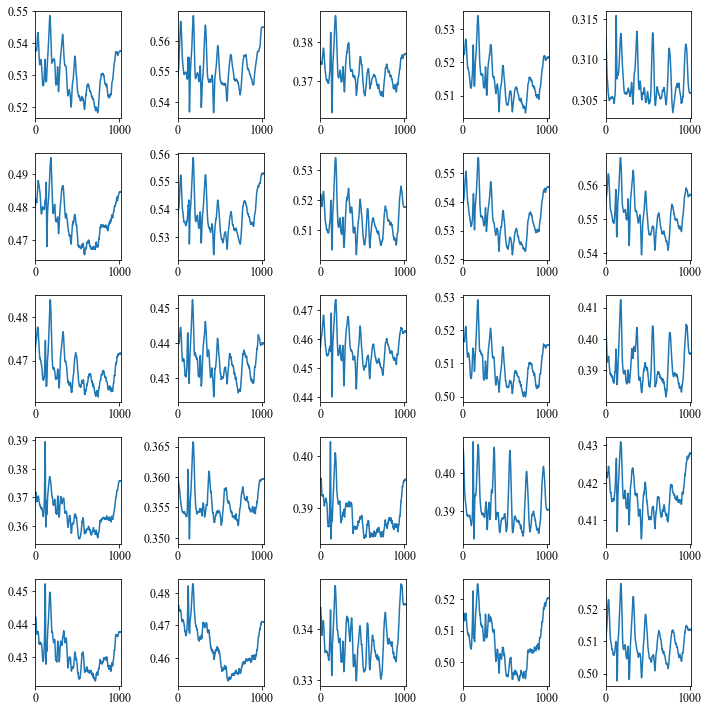

Epoch  1111 / 2000
 3525 / 3525 - loss: 8.420738e-05 - Duration: 88 sec - ETA: 20 hour 41 min 31 sec
Epoch  1112 / 2000
 3525 / 3525 - loss: 8.325612e-05 - Duration: 88 sec - ETA: 20 hour 40 min 11 sec
Epoch  1113 / 2000
 3525 / 3525 - loss: 8.565128e-05 - Duration: 87 sec - ETA: 20 hour 38 min 50 sec
Epoch  1114 / 2000
 3525 / 3525 - loss: 8.620641e-05 - Duration: 88 sec - ETA: 20 hour 37 min 30 sec
Epoch  1115 / 2000
 3525 / 3525 - loss: 8.525993e-05 - Duration: 88 sec - ETA: 20 hour 36 min 9 sec
Epoch  1116 / 2000
 3525 / 3525 - loss: 8.595126e-05 - Duration: 88 sec - ETA: 20 hour 34 min 49 sec
Epoch  1117 / 2000
 3525 / 3525 - loss: 8.672251e-05 - Duration: 88 sec - ETA: 20 hour 33 min 28 sec
Epoch  1118 / 2000
 3525 / 3525 - loss: 8.472885e-05 - Duration: 88 sec - ETA: 20 hour 32 min 8 sec
Epoch  1119 / 2000
 3525 / 3525 - loss: 8.555551e-05 - Duration: 88 sec - ETA: 20 hour 30 min 48 sec
Epoch  1120 / 2000
 3525 / 3525 - loss: 8.425413e-05 - Duration: 88 sec - ETA: 20 hour 29 min

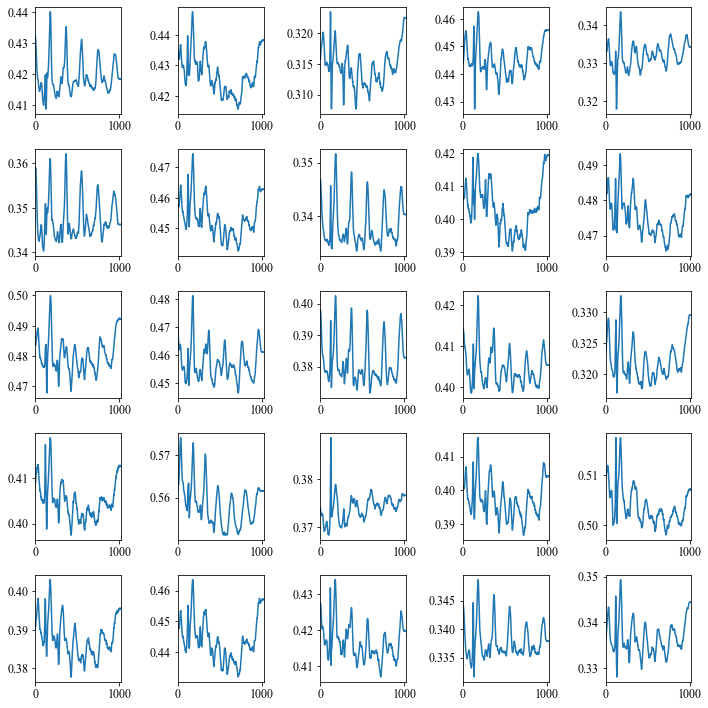

Epoch  1121 / 2000
 3525 / 3525 - loss: 8.443708e-05 - Duration: 88 sec - ETA: 20 hour 28 min 7 sec
Epoch  1122 / 2000
 3525 / 3525 - loss: 8.510632e-05 - Duration: 88 sec - ETA: 20 hour 26 min 47 sec
Epoch  1123 / 2000
 3525 / 3525 - loss: 8.455996e-05 - Duration: 88 sec - ETA: 20 hour 25 min 26 sec
Epoch  1124 / 2000
 3525 / 3525 - loss: 8.341313e-05 - Duration: 88 sec - ETA: 20 hour 24 min 6 sec
Epoch  1125 / 2000
 3525 / 3525 - loss: 8.424892e-05 - Duration: 88 sec - ETA: 20 hour 22 min 45 sec
Epoch  1126 / 2000
 3525 / 3525 - loss: 8.445253e-05 - Duration: 88 sec - ETA: 20 hour 21 min 25 sec
Epoch  1127 / 2000
 3525 / 3525 - loss: 8.352396e-05 - Duration: 88 sec - ETA: 20 hour 20 min 4 sec
Epoch  1128 / 2000
 3525 / 3525 - loss: 8.436694e-05 - Duration: 87 sec - ETA: 20 hour 18 min 44 sec
Epoch  1129 / 2000
 3525 / 3525 - loss: 8.634383e-05 - Duration: 87 sec - ETA: 20 hour 17 min 23 sec
Epoch  1130 / 2000
 3525 / 3525 - loss: 8.383210e-05 - Duration: 87 sec - ETA: 20 hour 16 min 

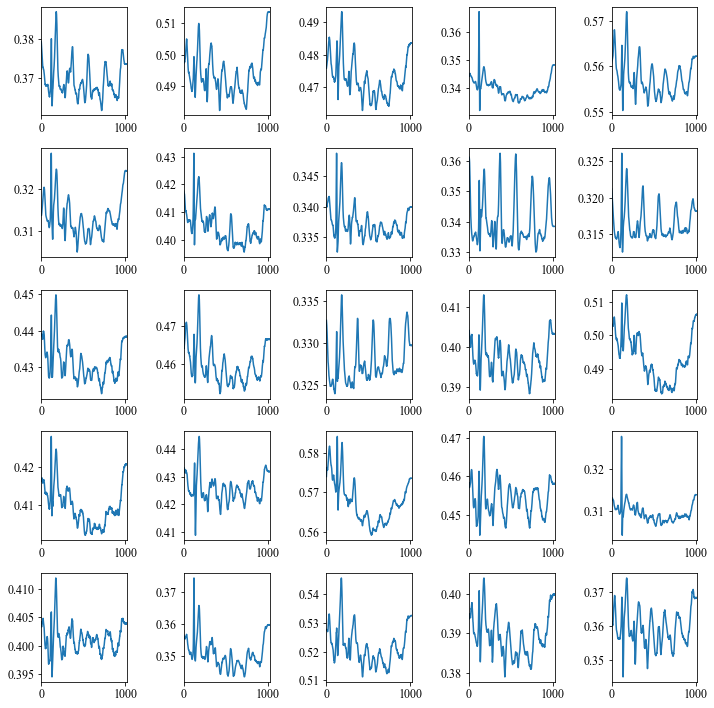

Epoch  1131 / 2000
 3525 / 3525 - loss: 8.462233e-05 - Duration: 88 sec - ETA: 20 hour 14 min 42 sec
Epoch  1132 / 2000
 3525 / 3525 - loss: 8.350783e-05 - Duration: 87 sec - ETA: 20 hour 13 min 21 sec
Epoch  1133 / 2000
 3525 / 3525 - loss: 8.344325e-05 - Duration: 88 sec - ETA: 20 hour 12 min 0 sec
Epoch  1134 / 2000
 3525 / 3525 - loss: 8.524074e-05 - Duration: 88 sec - ETA: 20 hour 10 min 40 sec
Epoch  1135 / 2000
 3525 / 3525 - loss: 8.505397e-05 - Duration: 88 sec - ETA: 20 hour 9 min 19 sec
Epoch  1136 / 2000
 3525 / 3525 - loss: 8.255599e-05 - Duration: 88 sec - ETA: 20 hour 7 min 58 sec
Epoch  1137 / 2000
 3525 / 3525 - loss: 8.376806e-05 - Duration: 88 sec - ETA: 20 hour 6 min 38 sec
Epoch  1138 / 2000
 3525 / 3525 - loss: 8.477381e-05 - Duration: 88 sec - ETA: 20 hour 5 min 17 sec
Epoch  1139 / 2000
 3525 / 3525 - loss: 8.436570e-05 - Duration: 88 sec - ETA: 20 hour 3 min 56 sec
Epoch  1140 / 2000
 3525 / 3525 - loss: 8.315972e-05 - Duration: 88 sec - ETA: 20 hour 2 min 35 s

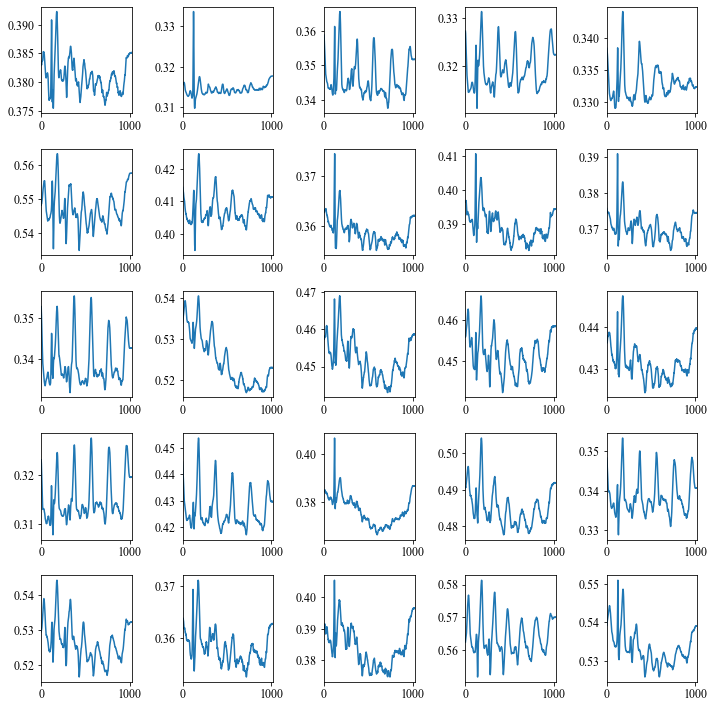

Epoch  1141 / 2000
 3525 / 3525 - loss: 8.451544e-05 - Duration: 88 sec - ETA: 20 hour 1 min 15 sec
Epoch  1142 / 2000
 3525 / 3525 - loss: 8.270637e-05 - Duration: 88 sec - ETA: 19 hour 59 min 54 sec
Epoch  1143 / 2000
 3525 / 3525 - loss: 8.386553e-05 - Duration: 88 sec - ETA: 19 hour 58 min 33 sec
Epoch  1144 / 2000
 3525 / 3525 - loss: 8.558586e-05 - Duration: 88 sec - ETA: 19 hour 57 min 12 sec
Epoch  1145 / 2000
 3525 / 3525 - loss: 8.407096e-05 - Duration: 88 sec - ETA: 19 hour 55 min 51 sec
Epoch  1146 / 2000
 3525 / 3525 - loss: 8.368375e-05 - Duration: 87 sec - ETA: 19 hour 54 min 30 sec
Epoch  1147 / 2000
 3525 / 3525 - loss: 8.311022e-05 - Duration: 88 sec - ETA: 19 hour 53 min 10 sec
Epoch  1148 / 2000
 3525 / 3525 - loss: 8.342605e-05 - Duration: 88 sec - ETA: 19 hour 51 min 49 sec
Epoch  1149 / 2000
 3525 / 3525 - loss: 8.354501e-05 - Duration: 87 sec - ETA: 19 hour 50 min 28 sec
Epoch  1150 / 2000
 3525 / 3525 - loss: 8.359289e-05 - Duration: 87 sec - ETA: 19 hour 49 mi

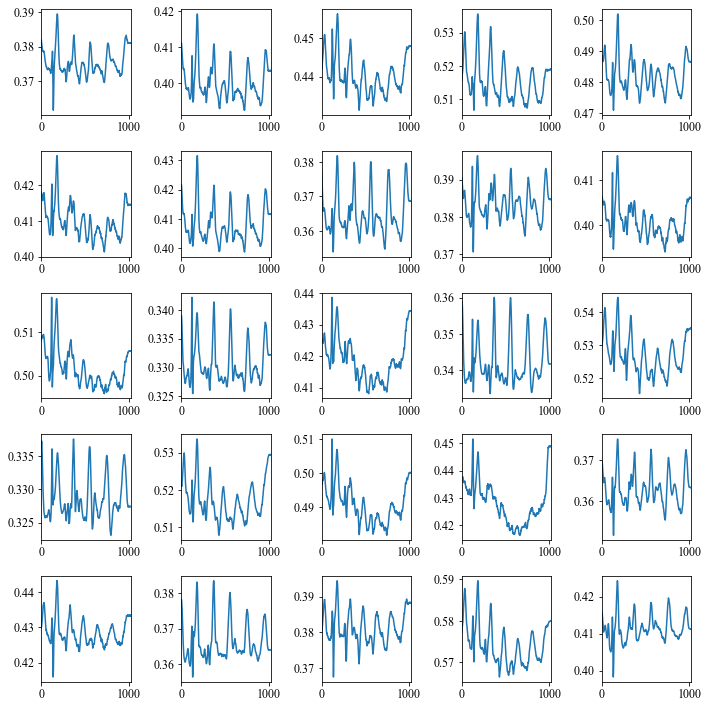

Epoch  1151 / 2000
 3525 / 3525 - loss: 8.415372e-05 - Duration: 88 sec - ETA: 19 hour 47 min 46 sec
Epoch  1152 / 2000
 3525 / 3525 - loss: 8.341238e-05 - Duration: 88 sec - ETA: 19 hour 46 min 25 sec
Epoch  1153 / 2000
 3525 / 3525 - loss: 8.408880e-05 - Duration: 88 sec - ETA: 19 hour 45 min 4 sec
Epoch  1154 / 2000
 3525 / 3525 - loss: 8.501771e-05 - Duration: 88 sec - ETA: 19 hour 43 min 43 sec
Epoch  1155 / 2000
 3525 / 3525 - loss: 8.214427e-05 - Duration: 87 sec - ETA: 19 hour 42 min 22 sec
Epoch  1156 / 2000
 3525 / 3525 - loss: 8.592647e-05 - Duration: 88 sec - ETA: 19 hour 41 min 1 sec
Epoch  1157 / 2000
 3525 / 3525 - loss: 8.198979e-05 - Duration: 88 sec - ETA: 19 hour 39 min 40 sec
Epoch  1158 / 2000
 3525 / 3525 - loss: 8.336876e-05 - Duration: 88 sec - ETA: 19 hour 38 min 19 sec
Epoch  1159 / 2000
 3525 / 3525 - loss: 8.351982e-05 - Duration: 88 sec - ETA: 19 hour 36 min 58 sec
Epoch  1160 / 2000
 3525 / 3525 - loss: 8.335956e-05 - Duration: 88 sec - ETA: 19 hour 35 min

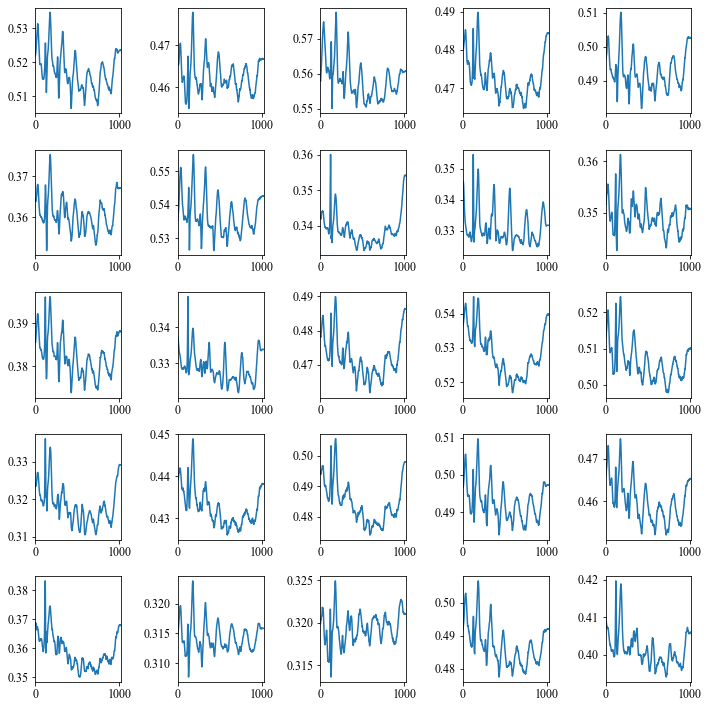

Epoch  1161 / 2000
 3525 / 3525 - loss: 8.362066e-05 - Duration: 87 sec - ETA: 19 hour 34 min 17 sec
Epoch  1162 / 2000
 3525 / 3525 - loss: 8.322461e-05 - Duration: 87 sec - ETA: 19 hour 32 min 56 sec
Epoch  1163 / 2000
 3525 / 3525 - loss: 8.469895e-05 - Duration: 87 sec - ETA: 19 hour 31 min 35 sec
Epoch  1164 / 2000
 3525 / 3525 - loss: 8.267972e-05 - Duration: 87 sec - ETA: 19 hour 30 min 13 sec
Epoch  1165 / 2000
 3525 / 3525 - loss: 8.325661e-05 - Duration: 88 sec - ETA: 19 hour 28 min 52 sec
Epoch  1166 / 2000
 3525 / 3525 - loss: 8.287032e-05 - Duration: 87 sec - ETA: 19 hour 27 min 31 sec
Epoch  1167 / 2000
 3525 / 3525 - loss: 8.314686e-05 - Duration: 87 sec - ETA: 19 hour 26 min 10 sec
Epoch  1168 / 2000
 3525 / 3525 - loss: 8.419860e-05 - Duration: 87 sec - ETA: 19 hour 24 min 49 sec
Epoch  1169 / 2000
 3525 / 3525 - loss: 8.337775e-05 - Duration: 87 sec - ETA: 19 hour 23 min 28 sec
Epoch  1170 / 2000
 3525 / 3525 - loss: 8.346035e-05 - Duration: 87 sec - ETA: 19 hour 22 m

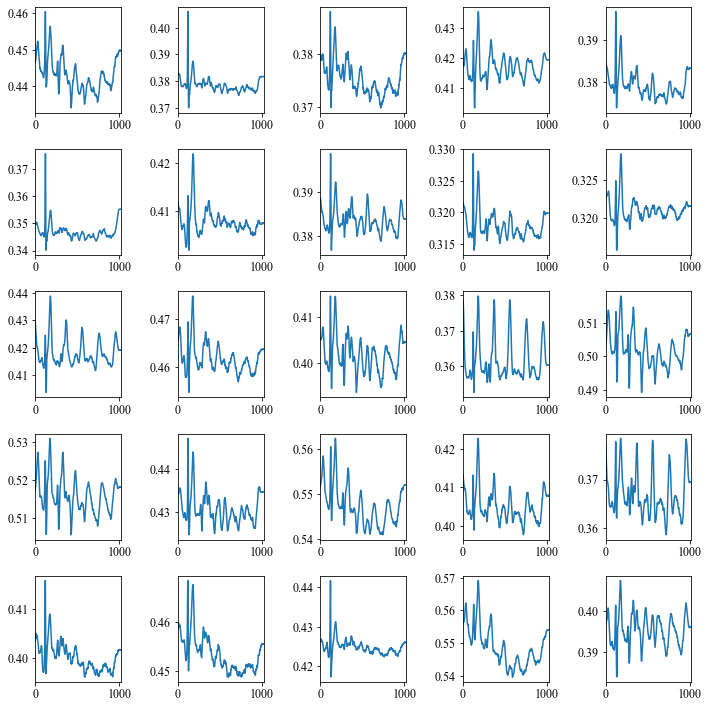

Epoch  1171 / 2000
 3525 / 3525 - loss: 8.267273e-05 - Duration: 87 sec - ETA: 19 hour 20 min 45 sec
Epoch  1172 / 2000
 3525 / 3525 - loss: 8.235078e-05 - Duration: 88 sec - ETA: 19 hour 19 min 24 sec
Epoch  1173 / 2000
 3525 / 3525 - loss: 8.437862e-05 - Duration: 87 sec - ETA: 19 hour 18 min 3 sec
Epoch  1174 / 2000
 3525 / 3525 - loss: 8.292049e-05 - Duration: 87 sec - ETA: 19 hour 16 min 41 sec
Epoch  1175 / 2000
 3525 / 3525 - loss: 8.436975e-05 - Duration: 88 sec - ETA: 19 hour 15 min 20 sec
Epoch  1176 / 2000
 3525 / 3525 - loss: 8.207019e-05 - Duration: 88 sec - ETA: 19 hour 13 min 59 sec
Epoch  1177 / 2000
 3525 / 3525 - loss: 8.434049e-05 - Duration: 87 sec - ETA: 19 hour 12 min 38 sec
Epoch  1178 / 2000
 3525 / 3525 - loss: 8.163622e-05 - Duration: 87 sec - ETA: 19 hour 11 min 16 sec
Epoch  1179 / 2000
 3525 / 3525 - loss: 8.277241e-05 - Duration: 87 sec - ETA: 19 hour 9 min 55 sec
Epoch  1180 / 2000
 3525 / 3525 - loss: 8.256344e-05 - Duration: 87 sec - ETA: 19 hour 8 min 

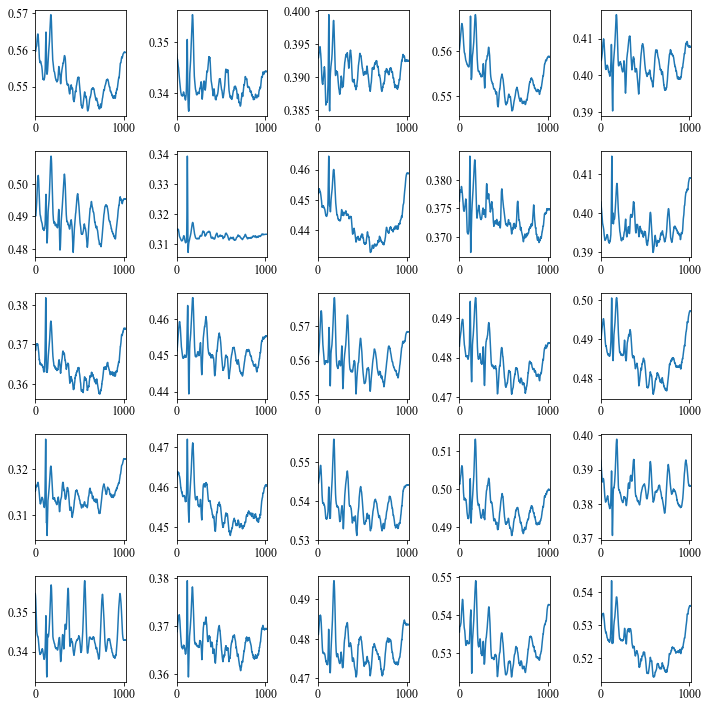

Epoch  1181 / 2000
 3525 / 3525 - loss: 8.289892e-05 - Duration: 88 sec - ETA: 19 hour 7 min 12 sec
Epoch  1182 / 2000
 3525 / 3525 - loss: 8.311404e-05 - Duration: 88 sec - ETA: 19 hour 5 min 51 sec
Epoch  1183 / 2000
 3525 / 3525 - loss: 8.272808e-05 - Duration: 87 sec - ETA: 19 hour 4 min 30 sec
Epoch  1184 / 2000
 3525 / 3525 - loss: 8.272343e-05 - Duration: 88 sec - ETA: 19 hour 3 min 9 sec
Epoch  1185 / 2000
 3525 / 3525 - loss: 8.403798e-05 - Duration: 88 sec - ETA: 19 hour 1 min 47 sec
Epoch  1186 / 2000
 3525 / 3525 - loss: 8.295159e-05 - Duration: 88 sec - ETA: 19 hour 0 min 26 sec
Epoch  1187 / 2000
 3525 / 3525 - loss: 8.265915e-05 - Duration: 88 sec - ETA: 18 hour 59 min 5 sec
Epoch  1188 / 2000
 3525 / 3525 - loss: 8.201616e-05 - Duration: 88 sec - ETA: 18 hour 57 min 43 sec
Epoch  1189 / 2000
 3525 / 3525 - loss: 8.205294e-05 - Duration: 88 sec - ETA: 18 hour 56 min 22 sec
Epoch  1190 / 2000
 3525 / 3525 - loss: 8.282705e-05 - Duration: 88 sec - ETA: 18 hour 55 min 1 sec

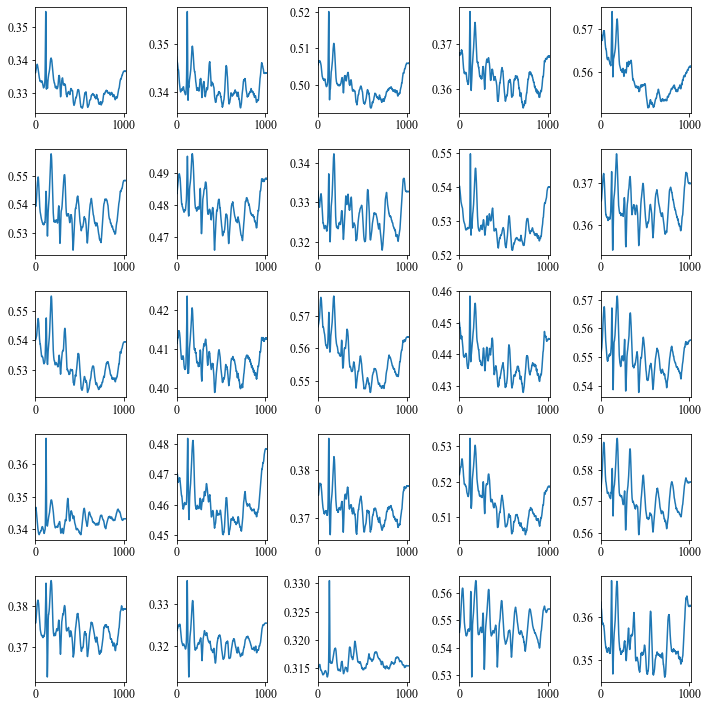

Epoch  1191 / 2000
 3525 / 3525 - loss: 8.191947e-05 - Duration: 88 sec - ETA: 18 hour 53 min 39 sec
Epoch  1192 / 2000
 3525 / 3525 - loss: 8.129928e-05 - Duration: 88 sec - ETA: 18 hour 52 min 18 sec
Epoch  1193 / 2000
 3525 / 3525 - loss: 8.313964e-05 - Duration: 88 sec - ETA: 18 hour 50 min 57 sec
Epoch  1194 / 2000
 3525 / 3525 - loss: 8.254697e-05 - Duration: 88 sec - ETA: 18 hour 49 min 36 sec
Epoch  1195 / 2000
 3525 / 3525 - loss: 8.143495e-05 - Duration: 88 sec - ETA: 18 hour 48 min 15 sec
Epoch  1196 / 2000
 3525 / 3525 - loss: 8.229593e-05 - Duration: 88 sec - ETA: 18 hour 46 min 53 sec
Epoch  1197 / 2000
 3525 / 3525 - loss: 8.217348e-05 - Duration: 88 sec - ETA: 18 hour 45 min 32 sec
Epoch  1198 / 2000
 3525 / 3525 - loss: 8.395193e-05 - Duration: 88 sec - ETA: 18 hour 44 min 11 sec
Epoch  1199 / 2000
 3525 / 3525 - loss: 8.027370e-05 - Duration: 88 sec - ETA: 18 hour 42 min 49 sec
Epoch  1200 / 2000
 3525 / 3525 - loss: 8.226299e-05 - Duration: 88 sec - ETA: 18 hour 41 m

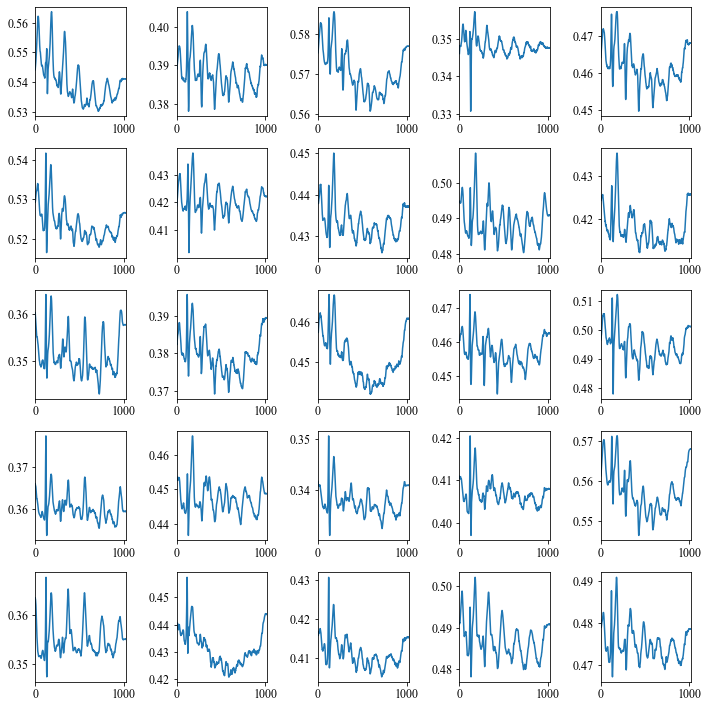

Epoch  1201 / 2000
 3525 / 3525 - loss: 8.126706e-05 - Duration: 88 sec - ETA: 18 hour 40 min 6 sec
Epoch  1202 / 2000
 3525 / 3525 - loss: 8.247250e-05 - Duration: 88 sec - ETA: 18 hour 38 min 45 sec
Epoch  1203 / 2000
 3525 / 3525 - loss: 8.233393e-05 - Duration: 87 sec - ETA: 18 hour 37 min 23 sec
Epoch  1204 / 2000
 3525 / 3525 - loss: 8.172390e-05 - Duration: 87 sec - ETA: 18 hour 36 min 2 sec
Epoch  1205 / 2000
 3525 / 3525 - loss: 8.348133e-05 - Duration: 87 sec - ETA: 18 hour 34 min 40 sec
Epoch  1206 / 2000
 3525 / 3525 - loss: 8.153918e-05 - Duration: 88 sec - ETA: 18 hour 33 min 19 sec
Epoch  1207 / 2000
 3525 / 3525 - loss: 8.176571e-05 - Duration: 87 sec - ETA: 18 hour 31 min 57 sec
Epoch  1208 / 2000
 3525 / 3525 - loss: 8.141206e-05 - Duration: 87 sec - ETA: 18 hour 30 min 35 sec
Epoch  1209 / 2000
 3525 / 3525 - loss: 8.097745e-05 - Duration: 87 sec - ETA: 18 hour 29 min 14 sec
Epoch  1210 / 2000
 3525 / 3525 - loss: 8.280270e-05 - Duration: 87 sec - ETA: 18 hour 27 min

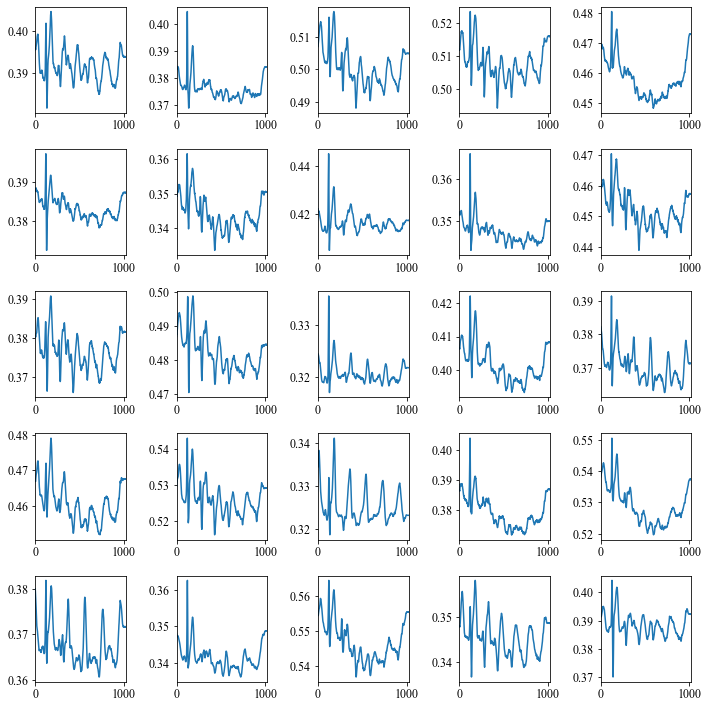

Epoch  1211 / 2000
 3525 / 3525 - loss: 8.171202e-05 - Duration: 88 sec - ETA: 18 hour 26 min 30 sec
Epoch  1212 / 2000
 3525 / 3525 - loss: 8.329220e-05 - Duration: 88 sec - ETA: 18 hour 25 min 9 sec
Epoch  1213 / 2000
 3525 / 3525 - loss: 8.090371e-05 - Duration: 88 sec - ETA: 18 hour 23 min 47 sec
Epoch  1214 / 2000
 3525 / 3525 - loss: 8.215971e-05 - Duration: 87 sec - ETA: 18 hour 22 min 26 sec
Epoch  1215 / 2000
 3525 / 3525 - loss: 7.950052e-05 - Duration: 87 sec - ETA: 18 hour 21 min 4 sec
Epoch  1216 / 2000
 3525 / 3525 - loss: 8.193157e-05 - Duration: 87 sec - ETA: 18 hour 19 min 42 sec
Epoch  1217 / 2000
 3525 / 3525 - loss: 8.168494e-05 - Duration: 87 sec - ETA: 18 hour 18 min 20 sec
Epoch  1218 / 2000
 3525 / 3525 - loss: 8.112610e-05 - Duration: 87 sec - ETA: 18 hour 16 min 59 sec
Epoch  1219 / 2000
 3525 / 3525 - loss: 8.264567e-05 - Duration: 87 sec - ETA: 18 hour 15 min 37 sec
Epoch  1220 / 2000
 3525 / 3525 - loss: 8.142457e-05 - Duration: 87 sec - ETA: 18 hour 14 min

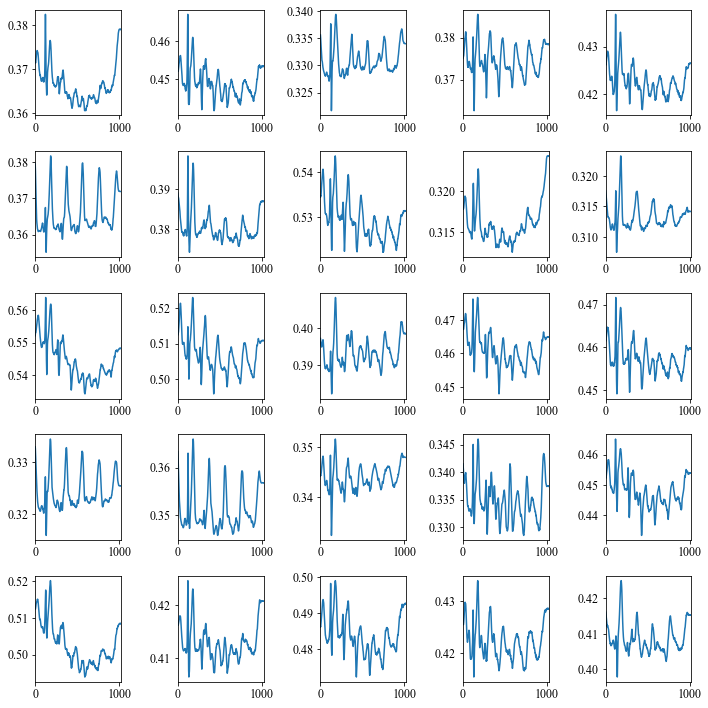

Epoch  1221 / 2000
 3525 / 3525 - loss: 8.210577e-05 - Duration: 88 sec - ETA: 18 hour 12 min 53 sec
Epoch  1222 / 2000
 3525 / 3525 - loss: 8.056719e-05 - Duration: 87 sec - ETA: 18 hour 11 min 32 sec
Epoch  1223 / 2000
 3525 / 3525 - loss: 8.206858e-05 - Duration: 87 sec - ETA: 18 hour 10 min 10 sec
Epoch  1224 / 2000
 3525 / 3525 - loss: 7.972012e-05 - Duration: 88 sec - ETA: 18 hour 8 min 48 sec
Epoch  1225 / 2000
 3525 / 3525 - loss: 8.021336e-05 - Duration: 87 sec - ETA: 18 hour 7 min 26 sec
Epoch  1226 / 2000
 3525 / 3525 - loss: 8.368222e-05 - Duration: 88 sec - ETA: 18 hour 6 min 5 sec
Epoch  1227 / 2000
 3525 / 3525 - loss: 8.070250e-05 - Duration: 87 sec - ETA: 18 hour 4 min 43 sec
Epoch  1228 / 2000
 3525 / 3525 - loss: 8.118225e-05 - Duration: 87 sec - ETA: 18 hour 3 min 21 sec
Epoch  1229 / 2000
 3525 / 3525 - loss: 7.971270e-05 - Duration: 87 sec - ETA: 18 hour 1 min 59 sec
Epoch  1230 / 2000
 3525 / 3525 - loss: 8.131696e-05 - Duration: 87 sec - ETA: 18 hour 0 min 37 se

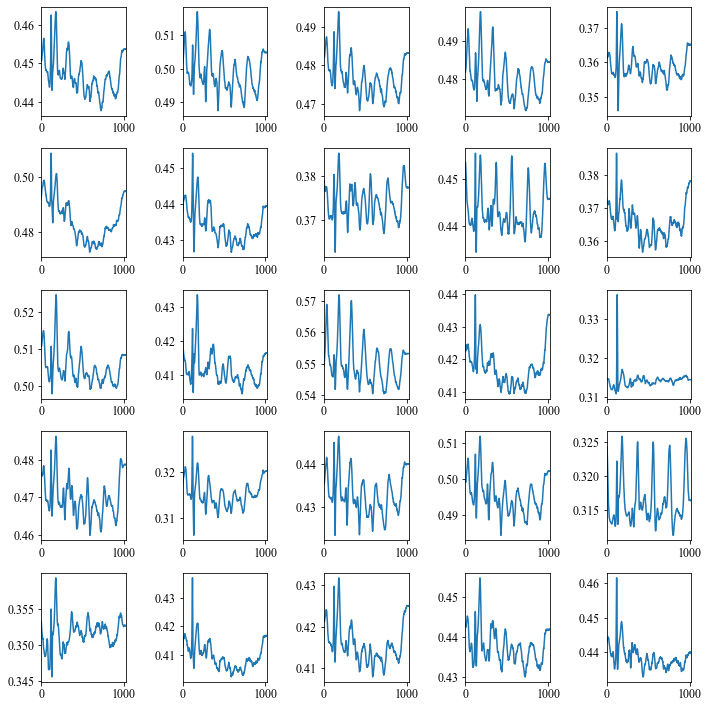

Epoch  1231 / 2000
 3525 / 3525 - loss: 8.152112e-05 - Duration: 87 sec - ETA: 17 hour 59 min 15 sec
Epoch  1232 / 2000
 3525 / 3525 - loss: 8.106356e-05 - Duration: 87 sec - ETA: 17 hour 57 min 53 sec
Epoch  1233 / 2000
 3525 / 3525 - loss: 8.061038e-05 - Duration: 87 sec - ETA: 17 hour 56 min 31 sec
Epoch  1234 / 2000
 3525 / 3525 - loss: 8.065925e-05 - Duration: 87 sec - ETA: 17 hour 55 min 9 sec
Epoch  1235 / 2000
 3525 / 3525 - loss: 7.996519e-05 - Duration: 87 sec - ETA: 17 hour 53 min 47 sec
Epoch  1236 / 2000
 3525 / 3525 - loss: 8.201097e-05 - Duration: 87 sec - ETA: 17 hour 52 min 26 sec
Epoch  1237 / 2000
 3525 / 3525 - loss: 8.150134e-05 - Duration: 87 sec - ETA: 17 hour 51 min 4 sec
Epoch  1238 / 2000
 3525 / 3525 - loss: 8.059366e-05 - Duration: 87 sec - ETA: 17 hour 49 min 42 sec
Epoch  1239 / 2000
 3525 / 3525 - loss: 8.032859e-05 - Duration: 88 sec - ETA: 17 hour 48 min 20 sec
Epoch  1240 / 2000
 3525 / 3525 - loss: 8.049284e-05 - Duration: 87 sec - ETA: 17 hour 46 min

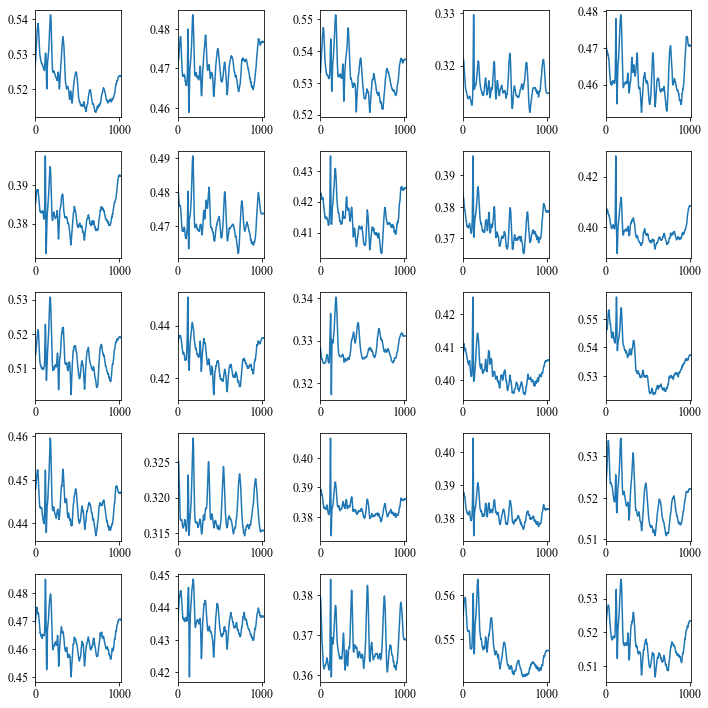

Epoch  1241 / 2000
 3525 / 3525 - loss: 8.146675e-05 - Duration: 87 sec - ETA: 17 hour 45 min 36 sec
Epoch  1242 / 2000
 3525 / 3525 - loss: 8.069700e-05 - Duration: 87 sec - ETA: 17 hour 44 min 14 sec
Epoch  1243 / 2000
 3525 / 3525 - loss: 8.107011e-05 - Duration: 88 sec - ETA: 17 hour 42 min 52 sec
Epoch  1244 / 2000
 3525 / 3525 - loss: 7.992006e-05 - Duration: 87 sec - ETA: 17 hour 41 min 30 sec
Epoch  1245 / 2000
 3525 / 3525 - loss: 8.056234e-05 - Duration: 87 sec - ETA: 17 hour 40 min 8 sec
Epoch  1246 / 2000
 3525 / 3525 - loss: 8.178522e-05 - Duration: 87 sec - ETA: 17 hour 38 min 46 sec
Epoch  1247 / 2000
 3525 / 3525 - loss: 7.907470e-05 - Duration: 87 sec - ETA: 17 hour 37 min 24 sec
Epoch  1248 / 2000
 3525 / 3525 - loss: 7.936015e-05 - Duration: 87 sec - ETA: 17 hour 36 min 2 sec
Epoch  1249 / 2000
 3525 / 3525 - loss: 8.053107e-05 - Duration: 87 sec - ETA: 17 hour 34 min 39 sec
Epoch  1250 / 2000
 3525 / 3525 - loss: 8.066796e-05 - Duration: 87 sec - ETA: 17 hour 33 min

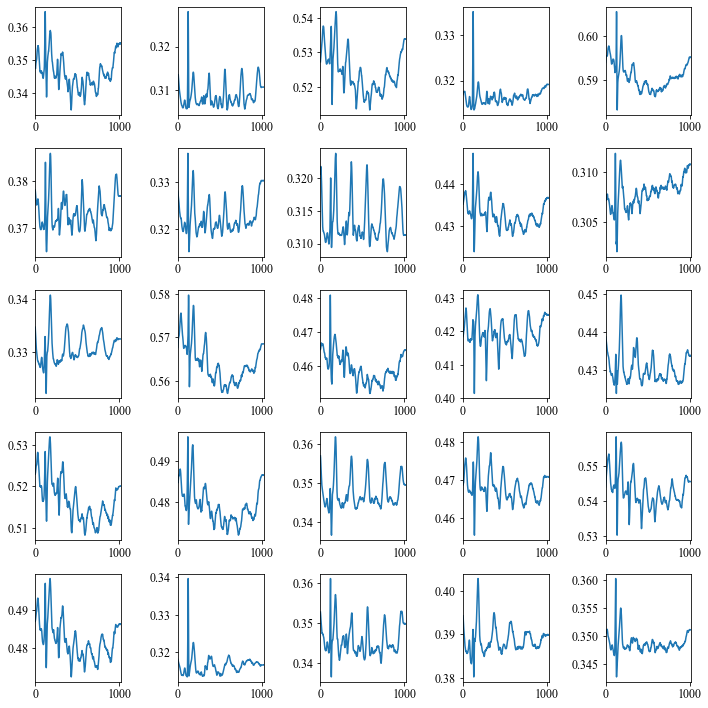

Epoch  1251 / 2000
 3525 / 3525 - loss: 8.117350e-05 - Duration: 87 sec - ETA: 17 hour 31 min 55 sec
Epoch  1252 / 2000
 3525 / 3525 - loss: 7.972293e-05 - Duration: 87 sec - ETA: 17 hour 30 min 33 sec
Epoch  1253 / 2000
 3525 / 3525 - loss: 8.130338e-05 - Duration: 87 sec - ETA: 17 hour 29 min 11 sec
Epoch  1254 / 2000
 3525 / 3525 - loss: 8.017785e-05 - Duration: 87 sec - ETA: 17 hour 27 min 49 sec
Epoch  1255 / 2000
 3525 / 3525 - loss: 8.101059e-05 - Duration: 87 sec - ETA: 17 hour 26 min 27 sec
Epoch  1256 / 2000
 3525 / 3525 - loss: 8.119974e-05 - Duration: 87 sec - ETA: 17 hour 25 min 5 sec
Epoch  1257 / 2000
 3525 / 3525 - loss: 8.066154e-05 - Duration: 87 sec - ETA: 17 hour 23 min 43 sec
Epoch  1258 / 2000
 3525 / 3525 - loss: 8.148777e-05 - Duration: 87 sec - ETA: 17 hour 22 min 20 sec
Epoch  1259 / 2000
 3525 / 3525 - loss: 7.955933e-05 - Duration: 87 sec - ETA: 17 hour 20 min 58 sec
Epoch  1260 / 2000
 3525 / 3525 - loss: 8.135186e-05 - Duration: 88 sec - ETA: 17 hour 19 mi

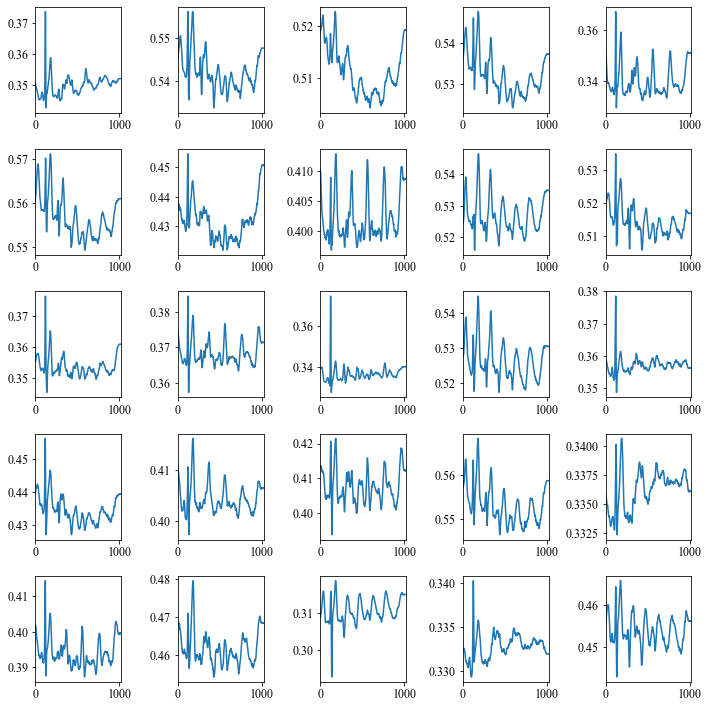

Epoch  1261 / 2000
 3525 / 3525 - loss: 7.895986e-05 - Duration: 87 sec - ETA: 17 hour 18 min 14 sec
Epoch  1262 / 2000
 3525 / 3525 - loss: 8.212134e-05 - Duration: 87 sec - ETA: 17 hour 16 min 52 sec
Epoch  1263 / 2000
 3525 / 3525 - loss: 8.049593e-05 - Duration: 87 sec - ETA: 17 hour 15 min 30 sec
Epoch  1264 / 2000
 3525 / 3525 - loss: 8.062382e-05 - Duration: 87 sec - ETA: 17 hour 14 min 8 sec
Epoch  1265 / 2000
 3525 / 3525 - loss: 7.978027e-05 - Duration: 87 sec - ETA: 17 hour 12 min 45 sec
Epoch  1266 / 2000
 3525 / 3525 - loss: 8.054215e-05 - Duration: 87 sec - ETA: 17 hour 11 min 23 sec
Epoch  1267 / 2000
 3525 / 3525 - loss: 7.969523e-05 - Duration: 87 sec - ETA: 17 hour 10 min 1 sec
Epoch  1268 / 2000
 3525 / 3525 - loss: 8.009469e-05 - Duration: 87 sec - ETA: 17 hour 8 min 39 sec
Epoch  1269 / 2000
 3525 / 3525 - loss: 7.986678e-05 - Duration: 87 sec - ETA: 17 hour 7 min 16 sec
Epoch  1270 / 2000
 3525 / 3525 - loss: 8.047043e-05 - Duration: 87 sec - ETA: 17 hour 5 min 54

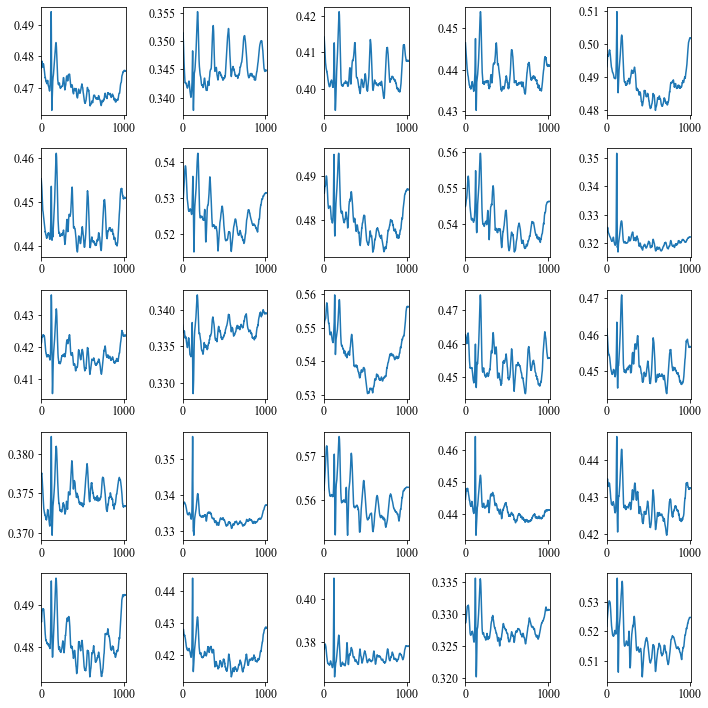

Epoch  1271 / 2000
 3525 / 3525 - loss: 8.002833e-05 - Duration: 88 sec - ETA: 17 hour 4 min 32 sec
Epoch  1272 / 2000
 3525 / 3525 - loss: 7.976787e-05 - Duration: 87 sec - ETA: 17 hour 3 min 10 sec
Epoch  1273 / 2000
 3525 / 3525 - loss: 8.025294e-05 - Duration: 88 sec - ETA: 17 hour 1 min 47 sec
Epoch  1274 / 2000
 3525 / 3525 - loss: 8.029021e-05 - Duration: 87 sec - ETA: 17 hour 0 min 25 sec
Epoch  1275 / 2000
 3525 / 3525 - loss: 8.022954e-05 - Duration: 87 sec - ETA: 16 hour 59 min 3 sec
Epoch  1276 / 2000
 3525 / 3525 - loss: 7.906092e-05 - Duration: 87 sec - ETA: 16 hour 57 min 41 sec
Epoch  1277 / 2000
 3525 / 3525 - loss: 7.938341e-05 - Duration: 87 sec - ETA: 16 hour 56 min 18 sec
Epoch  1278 / 2000
 3525 / 3525 - loss: 7.955730e-05 - Duration: 87 sec - ETA: 16 hour 54 min 56 sec
Epoch  1279 / 2000
 3525 / 3525 - loss: 8.074099e-05 - Duration: 87 sec - ETA: 16 hour 53 min 33 sec
Epoch  1280 / 2000
 3525 / 3525 - loss: 7.949059e-05 - Duration: 87 sec - ETA: 16 hour 52 min 11

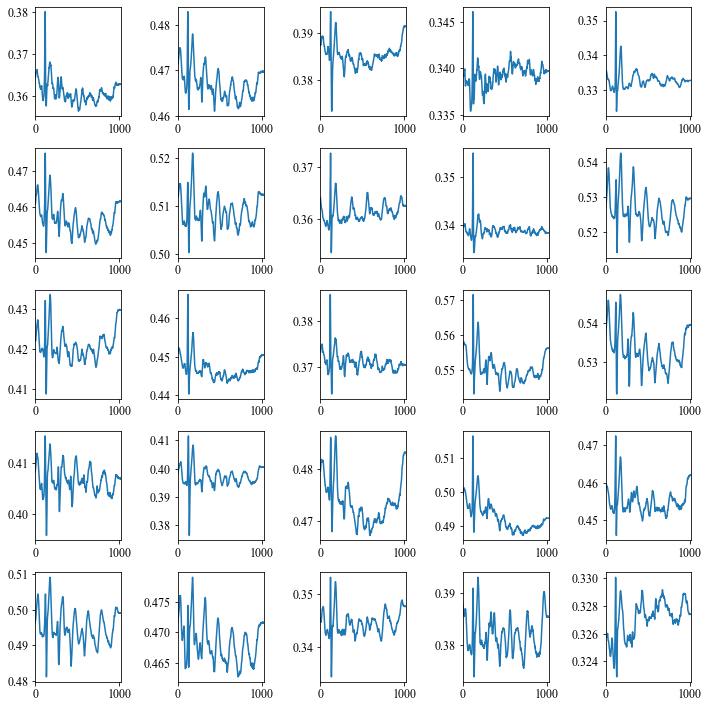

Epoch  1281 / 2000
 3525 / 3525 - loss: 8.029473e-05 - Duration: 87 sec - ETA: 16 hour 50 min 49 sec
Epoch  1282 / 2000
 3525 / 3525 - loss: 7.899452e-05 - Duration: 87 sec - ETA: 16 hour 49 min 26 sec
Epoch  1283 / 2000
 3525 / 3525 - loss: 8.110945e-05 - Duration: 87 sec - ETA: 16 hour 48 min 4 sec
Epoch  1284 / 2000
 3525 / 3525 - loss: 7.975775e-05 - Duration: 88 sec - ETA: 16 hour 46 min 42 sec
Epoch  1285 / 2000
 3525 / 3525 - loss: 7.980409e-05 - Duration: 87 sec - ETA: 16 hour 45 min 19 sec
Epoch  1286 / 2000
 3525 / 3525 - loss: 7.949335e-05 - Duration: 87 sec - ETA: 16 hour 43 min 57 sec
Epoch  1287 / 2000
 3525 / 3525 - loss: 8.009533e-05 - Duration: 87 sec - ETA: 16 hour 42 min 35 sec
Epoch  1288 / 2000
 3525 / 3525 - loss: 7.882482e-05 - Duration: 87 sec - ETA: 16 hour 41 min 12 sec
Epoch  1289 / 2000
 3525 / 3525 - loss: 7.745107e-05 - Duration: 87 sec - ETA: 16 hour 39 min 50 sec
Epoch  1290 / 2000
 3525 / 3525 - loss: 8.046150e-05 - Duration: 87 sec - ETA: 16 hour 38 mi

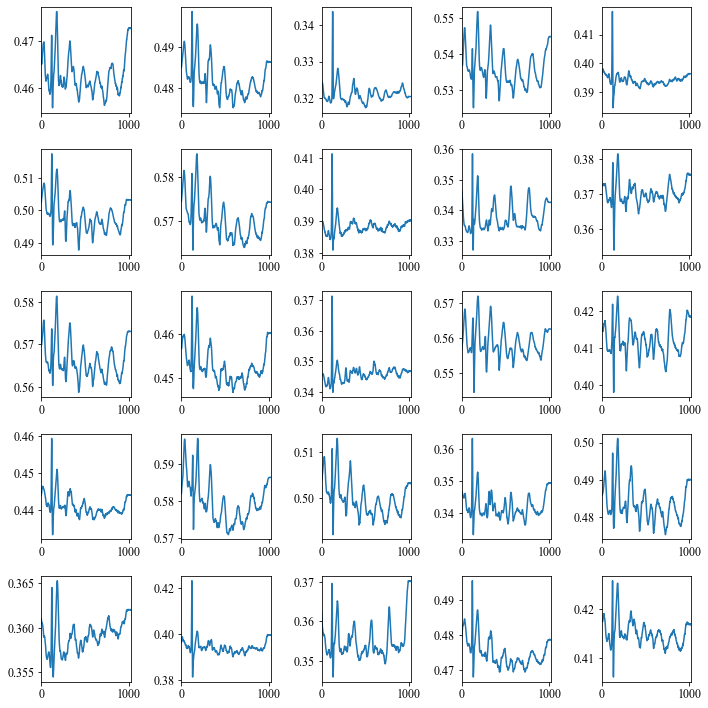

Epoch  1291 / 2000
 3525 / 3525 - loss: 8.067583e-05 - Duration: 87 sec - ETA: 16 hour 37 min 5 sec
Epoch  1292 / 2000
 3525 / 3525 - loss: 7.969893e-05 - Duration: 87 sec - ETA: 16 hour 35 min 42 sec
Epoch  1293 / 2000
 3525 / 3525 - loss: 7.897252e-05 - Duration: 87 sec - ETA: 16 hour 34 min 20 sec
Epoch  1294 / 2000
 3525 / 3525 - loss: 7.967429e-05 - Duration: 88 sec - ETA: 16 hour 32 min 57 sec
Epoch  1295 / 2000
 3525 / 3525 - loss: 7.881978e-05 - Duration: 87 sec - ETA: 16 hour 31 min 35 sec
Epoch  1296 / 2000
 3525 / 3525 - loss: 7.949340e-05 - Duration: 87 sec - ETA: 16 hour 30 min 12 sec
Epoch  1297 / 2000
 3525 / 3525 - loss: 7.836833e-05 - Duration: 87 sec - ETA: 16 hour 28 min 50 sec
Epoch  1298 / 2000
 3525 / 3525 - loss: 7.896680e-05 - Duration: 87 sec - ETA: 16 hour 27 min 27 sec
Epoch  1299 / 2000
 3525 / 3525 - loss: 7.930141e-05 - Duration: 87 sec - ETA: 16 hour 26 min 5 sec
Epoch  1300 / 2000
 3525 / 3525 - loss: 7.969486e-05 - Duration: 87 sec - ETA: 16 hour 24 min

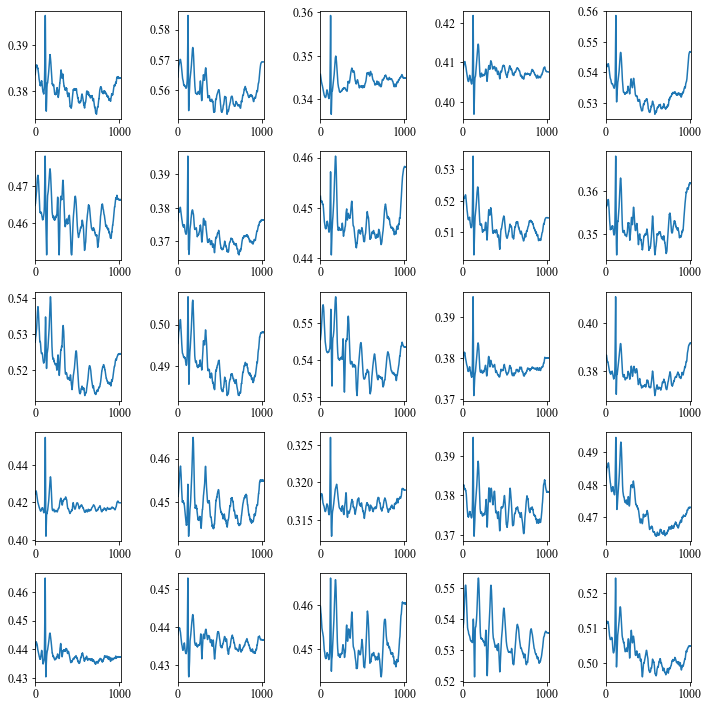

Epoch  1301 / 2000
 3525 / 3525 - loss: 7.943733e-05 - Duration: 87 sec - ETA: 16 hour 23 min 20 sec
Epoch  1302 / 2000
 3525 / 3525 - loss: 7.887300e-05 - Duration: 87 sec - ETA: 16 hour 21 min 57 sec
Epoch  1303 / 2000
 3525 / 3525 - loss: 7.972483e-05 - Duration: 87 sec - ETA: 16 hour 20 min 35 sec
Epoch  1304 / 2000
 3525 / 3525 - loss: 7.983031e-05 - Duration: 87 sec - ETA: 16 hour 19 min 12 sec
Epoch  1305 / 2000
 3525 / 3525 - loss: 7.889301e-05 - Duration: 88 sec - ETA: 16 hour 17 min 50 sec
Epoch  1306 / 2000
 3525 / 3525 - loss: 7.998529e-05 - Duration: 87 sec - ETA: 16 hour 16 min 27 sec
Epoch  1307 / 2000
 3525 / 3525 - loss: 7.972535e-05 - Duration: 87 sec - ETA: 16 hour 15 min 4 sec
Epoch  1308 / 2000
 3525 / 3525 - loss: 7.828351e-05 - Duration: 87 sec - ETA: 16 hour 13 min 42 sec
Epoch  1309 / 2000
 3525 / 3525 - loss: 7.900044e-05 - Duration: 87 sec - ETA: 16 hour 12 min 19 sec
Epoch  1310 / 2000
 3525 / 3525 - loss: 7.910897e-05 - Duration: 87 sec - ETA: 16 hour 10 mi

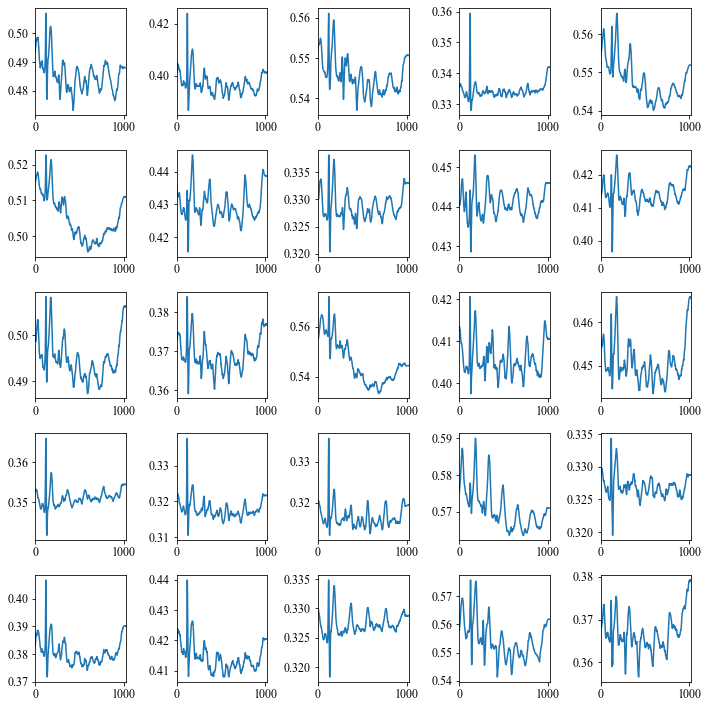

Epoch  1311 / 2000
 3525 / 3525 - loss: 7.941091e-05 - Duration: 87 sec - ETA: 16 hour 9 min 34 sec
Epoch  1312 / 2000
 3525 / 3525 - loss: 7.894427e-05 - Duration: 87 sec - ETA: 16 hour 8 min 11 sec
Epoch  1313 / 2000
 3525 / 3525 - loss: 7.875397e-05 - Duration: 87 sec - ETA: 16 hour 6 min 49 sec
Epoch  1314 / 2000
 3525 / 3525 - loss: 7.787369e-05 - Duration: 87 sec - ETA: 16 hour 5 min 26 sec
Epoch  1315 / 2000
 3525 / 3525 - loss: 7.826396e-05 - Duration: 87 sec - ETA: 16 hour 4 min 3 sec
Epoch  1316 / 2000
 3525 / 3525 - loss: 7.783983e-05 - Duration: 89 sec - ETA: 16 hour 2 min 41 sec
Epoch  1317 / 2000
 3525 / 3525 - loss: 7.801880e-05 - Duration: 89 sec - ETA: 16 hour 1 min 20 sec
Epoch  1318 / 2000
 3525 / 3525 - loss: 7.887141e-05 - Duration: 89 sec - ETA: 15 hour 59 min 58 sec
Epoch  1319 / 2000
 3525 / 3525 - loss: 7.877836e-05 - Duration: 89 sec - ETA: 15 hour 58 min 36 sec
Epoch  1320 / 2000
 3525 / 3525 - loss: 7.818013e-05 - Duration: 87 sec - ETA: 15 hour 57 min 13 se

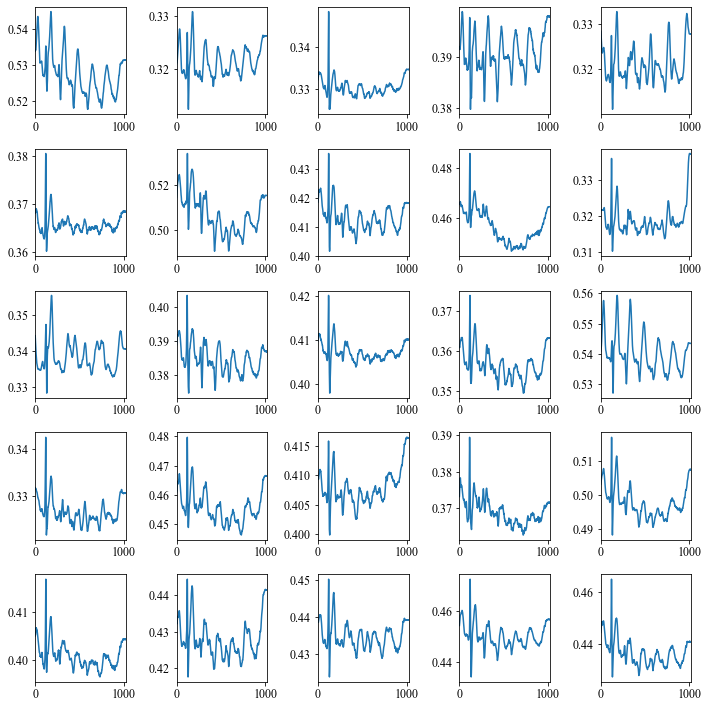

Epoch  1321 / 2000
 3525 / 3525 - loss: 7.895657e-05 - Duration: 87 sec - ETA: 15 hour 55 min 50 sec
Epoch  1322 / 2000
 3525 / 3525 - loss: 7.738887e-05 - Duration: 87 sec - ETA: 15 hour 54 min 28 sec
Epoch  1323 / 2000
 3525 / 3525 - loss: 7.878222e-05 - Duration: 87 sec - ETA: 15 hour 53 min 5 sec
Epoch  1324 / 2000
 3525 / 3525 - loss: 7.950009e-05 - Duration: 87 sec - ETA: 15 hour 51 min 42 sec
Epoch  1325 / 2000
 3525 / 3525 - loss: 7.801473e-05 - Duration: 87 sec - ETA: 15 hour 50 min 19 sec
Epoch  1326 / 2000
 3525 / 3525 - loss: 7.823535e-05 - Duration: 87 sec - ETA: 15 hour 48 min 57 sec
Epoch  1327 / 2000
 3525 / 3525 - loss: 7.726309e-05 - Duration: 87 sec - ETA: 15 hour 47 min 34 sec
Epoch  1328 / 2000
 3525 / 3525 - loss: 7.871565e-05 - Duration: 87 sec - ETA: 15 hour 46 min 11 sec
Epoch  1329 / 2000
 3525 / 3525 - loss: 7.800632e-05 - Duration: 87 sec - ETA: 15 hour 44 min 48 sec
Epoch  1330 / 2000
 3525 / 3525 - loss: 7.941207e-05 - Duration: 87 sec - ETA: 15 hour 43 mi

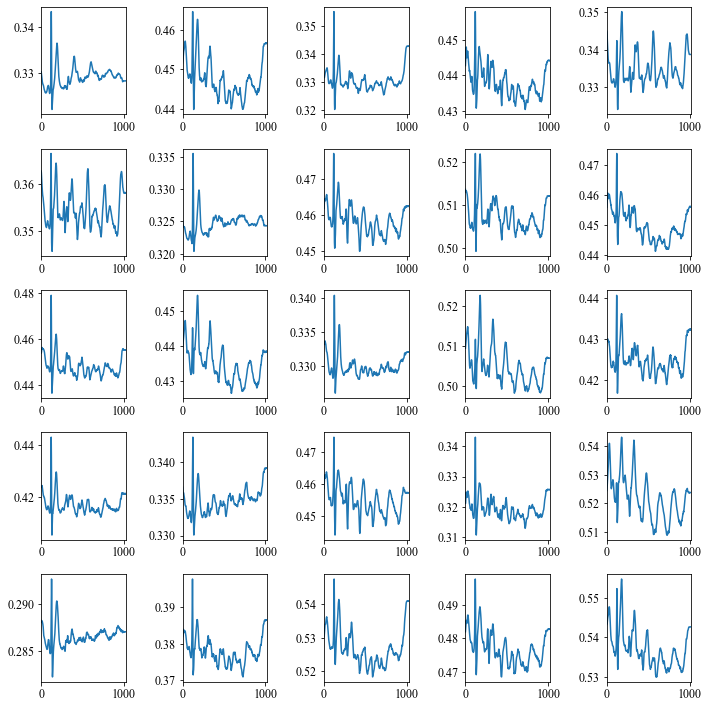

Epoch  1331 / 2000
 3525 / 3525 - loss: 7.878072e-05 - Duration: 87 sec - ETA: 15 hour 42 min 3 sec
Epoch  1332 / 2000
 3525 / 3525 - loss: 8.035374e-05 - Duration: 87 sec - ETA: 15 hour 40 min 40 sec
Epoch  1333 / 2000
 3525 / 3525 - loss: 7.796393e-05 - Duration: 87 sec - ETA: 15 hour 39 min 17 sec
Epoch  1334 / 2000
 3525 / 3525 - loss: 7.707337e-05 - Duration: 87 sec - ETA: 15 hour 37 min 54 sec
Epoch  1335 / 2000
 3525 / 3525 - loss: 7.938038e-05 - Duration: 87 sec - ETA: 15 hour 36 min 31 sec
Epoch  1336 / 2000
 3525 / 3525 - loss: 7.747743e-05 - Duration: 87 sec - ETA: 15 hour 35 min 9 sec
Epoch  1337 / 2000
 3525 / 3525 - loss: 7.970474e-05 - Duration: 87 sec - ETA: 15 hour 33 min 46 sec
Epoch  1338 / 2000
 3525 / 3525 - loss: 7.980911e-05 - Duration: 87 sec - ETA: 15 hour 32 min 23 sec
Epoch  1339 / 2000
 3525 / 3525 - loss: 7.777020e-05 - Duration: 87 sec - ETA: 15 hour 31 min 0 sec
Epoch  1340 / 2000
 3525 / 3525 - loss: 7.922275e-05 - Duration: 87 sec - ETA: 15 hour 29 min 

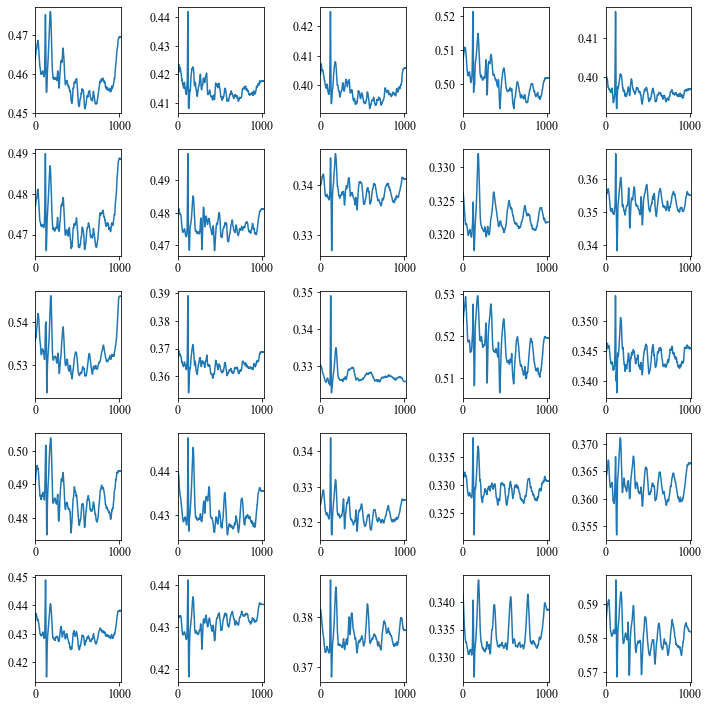

Epoch  1341 / 2000
 3525 / 3525 - loss: 7.895271e-05 - Duration: 88 sec - ETA: 15 hour 28 min 14 sec
Epoch  1342 / 2000
 3525 / 3525 - loss: 7.839661e-05 - Duration: 87 sec - ETA: 15 hour 26 min 51 sec
Epoch  1343 / 2000
 3525 / 3525 - loss: 7.833494e-05 - Duration: 87 sec - ETA: 15 hour 25 min 29 sec
Epoch  1344 / 2000
 3525 / 3525 - loss: 7.848510e-05 - Duration: 87 sec - ETA: 15 hour 24 min 6 sec
Epoch  1345 / 2000
 3525 / 3525 - loss: 7.826921e-05 - Duration: 87 sec - ETA: 15 hour 22 min 43 sec
Epoch  1346 / 2000
 3525 / 3525 - loss: 7.902938e-05 - Duration: 87 sec - ETA: 15 hour 21 min 20 sec
Epoch  1347 / 2000
 3525 / 3525 - loss: 7.913191e-05 - Duration: 87 sec - ETA: 15 hour 19 min 57 sec
Epoch  1348 / 2000
 3525 / 3525 - loss: 7.829637e-05 - Duration: 87 sec - ETA: 15 hour 18 min 34 sec
Epoch  1349 / 2000
 3525 / 3525 - loss: 7.914832e-05 - Duration: 87 sec - ETA: 15 hour 17 min 11 sec
Epoch  1350 / 2000
 3525 / 3525 - loss: 7.576509e-05 - Duration: 87 sec - ETA: 15 hour 15 mi

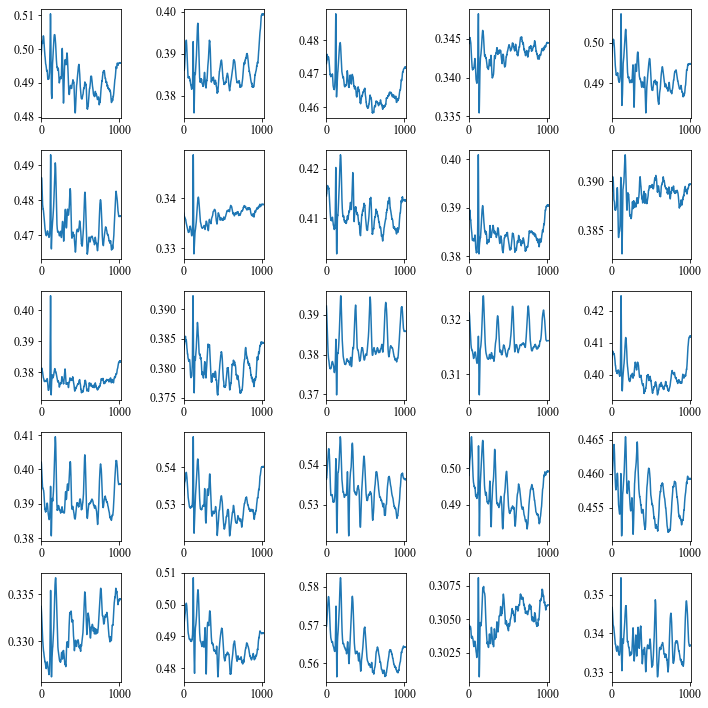

Epoch  1351 / 2000
 3525 / 3525 - loss: 7.871250e-05 - Duration: 87 sec - ETA: 15 hour 14 min 25 sec
Epoch  1352 / 2000
 3525 / 3525 - loss: 7.852834e-05 - Duration: 88 sec - ETA: 15 hour 13 min 2 sec
Epoch  1353 / 2000
 3525 / 3525 - loss: 7.737671e-05 - Duration: 89 sec - ETA: 15 hour 11 min 40 sec
Epoch  1354 / 2000
 3525 / 3525 - loss: 7.836206e-05 - Duration: 88 sec - ETA: 15 hour 10 min 17 sec
Epoch  1355 / 2000
 3525 / 3525 - loss: 7.948918e-05 - Duration: 87 sec - ETA: 15 hour 8 min 54 sec
Epoch  1356 / 2000
 3525 / 3525 - loss: 7.780233e-05 - Duration: 87 sec - ETA: 15 hour 7 min 31 sec
Epoch  1357 / 2000
 3525 / 3525 - loss: 7.927564e-05 - Duration: 87 sec - ETA: 15 hour 6 min 8 sec
Epoch  1358 / 2000
 3525 / 3525 - loss: 7.886470e-05 - Duration: 87 sec - ETA: 15 hour 4 min 45 sec
Epoch  1359 / 2000
 3525 / 3525 - loss: 7.633653e-05 - Duration: 87 sec - ETA: 15 hour 3 min 22 sec
Epoch  1360 / 2000
 3525 / 3525 - loss: 7.841381e-05 - Duration: 87 sec - ETA: 15 hour 1 min 59 se

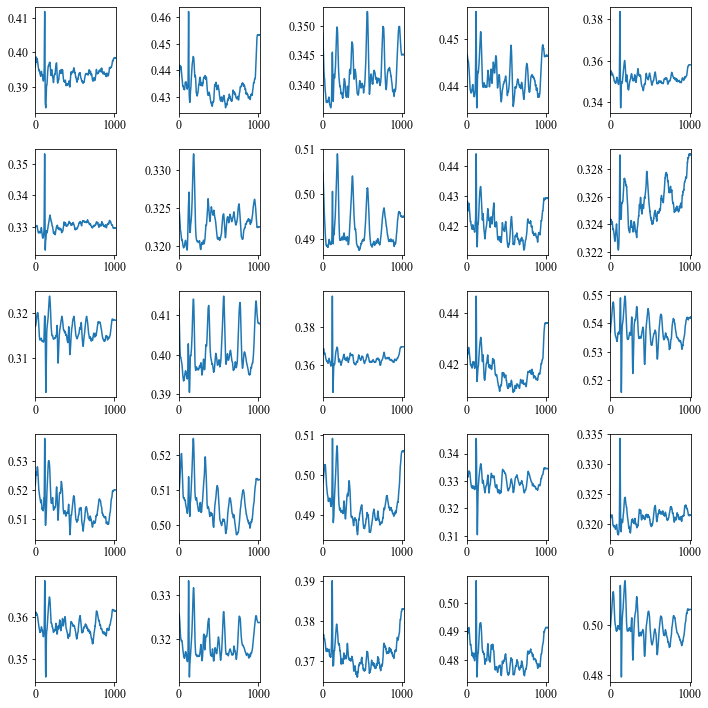

Epoch  1361 / 2000
 3525 / 3525 - loss: 7.835414e-05 - Duration: 87 sec - ETA: 15 hour 0 min 36 sec
Epoch  1362 / 2000
 3525 / 3525 - loss: 7.599102e-05 - Duration: 87 sec - ETA: 14 hour 59 min 13 sec
Epoch  1363 / 2000
 3525 / 3525 - loss: 7.796699e-05 - Duration: 87 sec - ETA: 14 hour 57 min 50 sec
Epoch  1364 / 2000
 3525 / 3525 - loss: 7.769388e-05 - Duration: 87 sec - ETA: 14 hour 56 min 27 sec
Epoch  1365 / 2000
 3525 / 3525 - loss: 7.765343e-05 - Duration: 87 sec - ETA: 14 hour 55 min 4 sec
Epoch  1366 / 2000
 3525 / 3525 - loss: 7.725432e-05 - Duration: 87 sec - ETA: 14 hour 53 min 41 sec
Epoch  1367 / 2000
 3525 / 3525 - loss: 7.566538e-05 - Duration: 87 sec - ETA: 14 hour 52 min 18 sec
Epoch  1368 / 2000
 3525 / 3525 - loss: 7.827896e-05 - Duration: 87 sec - ETA: 14 hour 50 min 55 sec
Epoch  1369 / 2000
 3525 / 3525 - loss: 7.740420e-05 - Duration: 88 sec - ETA: 14 hour 49 min 32 sec
Epoch  1370 / 2000
 3525 / 3525 - loss: 7.627556e-05 - Duration: 88 sec - ETA: 14 hour 48 min

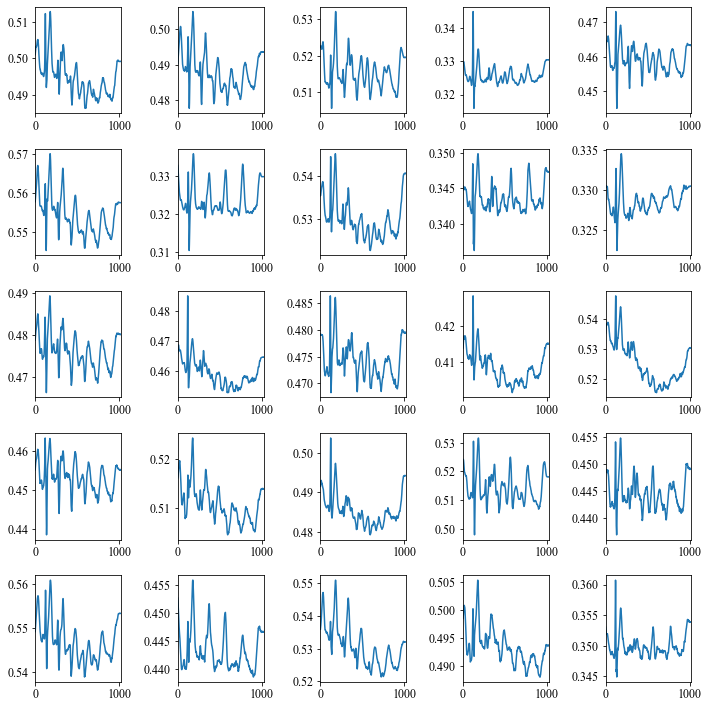

Epoch  1371 / 2000
 3525 / 3525 - loss: 7.905948e-05 - Duration: 87 sec - ETA: 14 hour 46 min 46 sec
Epoch  1372 / 2000
 3525 / 3525 - loss: 7.775764e-05 - Duration: 87 sec - ETA: 14 hour 45 min 23 sec
Epoch  1373 / 2000
 3525 / 3525 - loss: 7.707692e-05 - Duration: 87 sec - ETA: 14 hour 44 min 0 sec
Epoch  1374 / 2000
 3525 / 3525 - loss: 7.700382e-05 - Duration: 87 sec - ETA: 14 hour 42 min 37 sec
Epoch  1375 / 2000
 3525 / 3525 - loss: 7.781953e-05 - Duration: 87 sec - ETA: 14 hour 41 min 13 sec
Epoch  1376 / 2000
 3525 / 3525 - loss: 7.839860e-05 - Duration: 87 sec - ETA: 14 hour 39 min 50 sec
Epoch  1377 / 2000
 3525 / 3525 - loss: 7.654883e-05 - Duration: 87 sec - ETA: 14 hour 38 min 27 sec
Epoch  1378 / 2000
 3525 / 3525 - loss: 7.780211e-05 - Duration: 87 sec - ETA: 14 hour 37 min 4 sec
Epoch  1379 / 2000
 3525 / 3525 - loss: 7.632537e-05 - Duration: 87 sec - ETA: 14 hour 35 min 41 sec
Epoch  1380 / 2000
 3525 / 3525 - loss: 7.806705e-05 - Duration: 87 sec - ETA: 14 hour 34 min

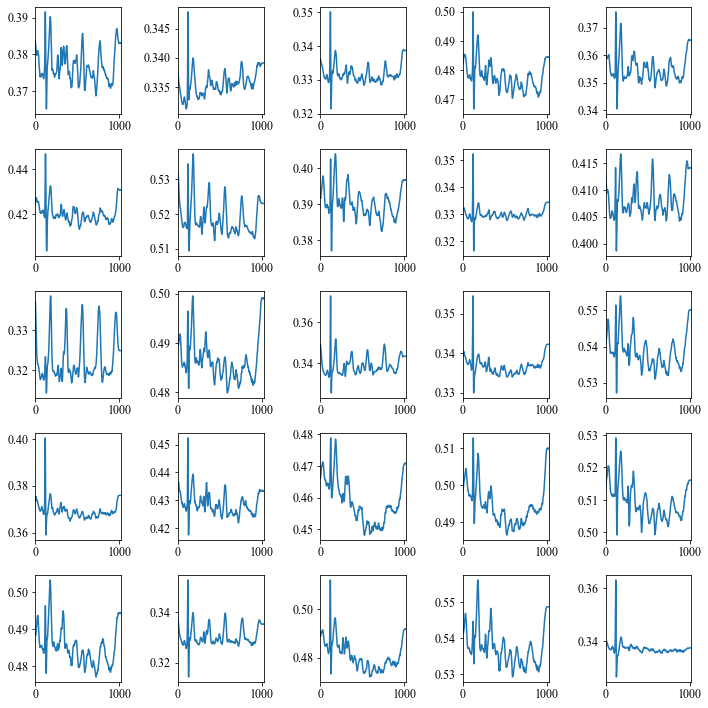

Epoch  1381 / 2000
 3525 / 3525 - loss: 7.789596e-05 - Duration: 87 sec - ETA: 14 hour 32 min 54 sec
Epoch  1382 / 2000
 3525 / 3525 - loss: 7.840445e-05 - Duration: 87 sec - ETA: 14 hour 31 min 31 sec
Epoch  1383 / 2000
 3525 / 3525 - loss: 7.792699e-05 - Duration: 87 sec - ETA: 14 hour 30 min 8 sec
Epoch  1384 / 2000
 3525 / 3525 - loss: 7.939863e-05 - Duration: 87 sec - ETA: 14 hour 28 min 45 sec
Epoch  1385 / 2000
 3525 / 3525 - loss: 7.764527e-05 - Duration: 87 sec - ETA: 14 hour 27 min 22 sec
Epoch  1386 / 2000
 3525 / 3525 - loss: 7.656564e-05 - Duration: 87 sec - ETA: 14 hour 25 min 59 sec
Epoch  1387 / 2000
 3525 / 3525 - loss: 7.663465e-05 - Duration: 87 sec - ETA: 14 hour 24 min 35 sec
Epoch  1388 / 2000
 3525 / 3525 - loss: 7.768843e-05 - Duration: 87 sec - ETA: 14 hour 23 min 12 sec
Epoch  1389 / 2000
 3525 / 3525 - loss: 7.783732e-05 - Duration: 87 sec - ETA: 14 hour 21 min 49 sec
Epoch  1390 / 2000
 3525 / 3525 - loss: 7.869787e-05 - Duration: 87 sec - ETA: 14 hour 20 mi

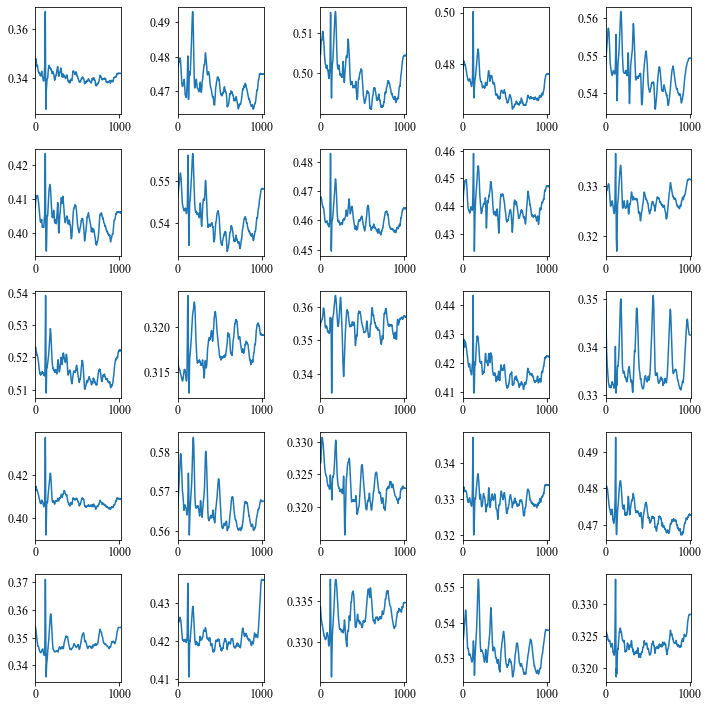

Epoch  1391 / 2000
 3525 / 3525 - loss: 7.712477e-05 - Duration: 87 sec - ETA: 14 hour 19 min 2 sec
Epoch  1392 / 2000
 3525 / 3525 - loss: 7.632863e-05 - Duration: 87 sec - ETA: 14 hour 17 min 39 sec
Epoch  1393 / 2000
 3525 / 3525 - loss: 7.686110e-05 - Duration: 87 sec - ETA: 14 hour 16 min 16 sec
Epoch  1394 / 2000
 3525 / 3525 - loss: 7.714012e-05 - Duration: 87 sec - ETA: 14 hour 14 min 53 sec
Epoch  1395 / 2000
 3525 / 3525 - loss: 7.672886e-05 - Duration: 87 sec - ETA: 14 hour 13 min 30 sec
Epoch  1396 / 2000
 3525 / 3525 - loss: 7.569066e-05 - Duration: 87 sec - ETA: 14 hour 12 min 6 sec
Epoch  1397 / 2000
 3525 / 3525 - loss: 7.742277e-05 - Duration: 87 sec - ETA: 14 hour 10 min 43 sec
Epoch  1398 / 2000
 3525 / 3525 - loss: 7.741436e-05 - Duration: 87 sec - ETA: 14 hour 9 min 20 sec
Epoch  1399 / 2000
 3525 / 3525 - loss: 7.754882e-05 - Duration: 88 sec - ETA: 14 hour 7 min 57 sec
Epoch  1400 / 2000
 3525 / 3525 - loss: 7.534268e-05 - Duration: 87 sec - ETA: 14 hour 6 min 33

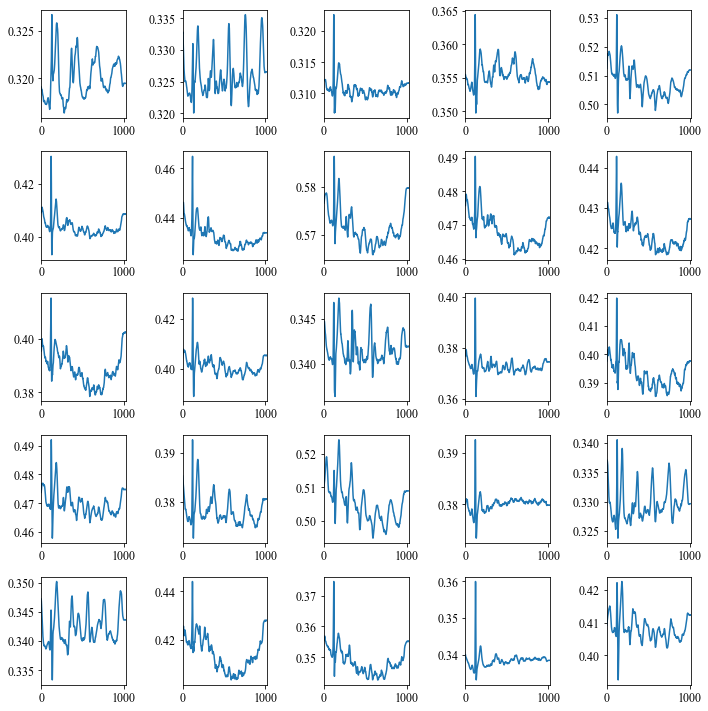

Epoch  1401 / 2000
 3525 / 3525 - loss: 7.729368e-05 - Duration: 87 sec - ETA: 14 hour 5 min 10 sec
Epoch  1402 / 2000
 3525 / 3525 - loss: 7.572829e-05 - Duration: 87 sec - ETA: 14 hour 3 min 46 sec
Epoch  1403 / 2000
 3525 / 3525 - loss: 7.583365e-05 - Duration: 87 sec - ETA: 14 hour 2 min 23 sec
Epoch  1404 / 2000
 3525 / 3525 - loss: 7.659554e-05 - Duration: 87 sec - ETA: 14 hour 1 min 0 sec
Epoch  1405 / 2000
 3525 / 3525 - loss: 7.586846e-05 - Duration: 87 sec - ETA: 13 hour 59 min 37 sec
Epoch  1406 / 2000
 3525 / 3525 - loss: 7.600967e-05 - Duration: 87 sec - ETA: 13 hour 58 min 13 sec
Epoch  1407 / 2000
 3525 / 3525 - loss: 7.654977e-05 - Duration: 87 sec - ETA: 13 hour 56 min 50 sec
Epoch  1408 / 2000
 3525 / 3525 - loss: 7.777102e-05 - Duration: 87 sec - ETA: 13 hour 55 min 27 sec
Epoch  1409 / 2000
 3525 / 3525 - loss: 7.727458e-05 - Duration: 87 sec - ETA: 13 hour 54 min 3 sec
Epoch  1410 / 2000
 3525 / 3525 - loss: 7.728575e-05 - Duration: 98 sec - ETA: 13 hour 52 min 44 

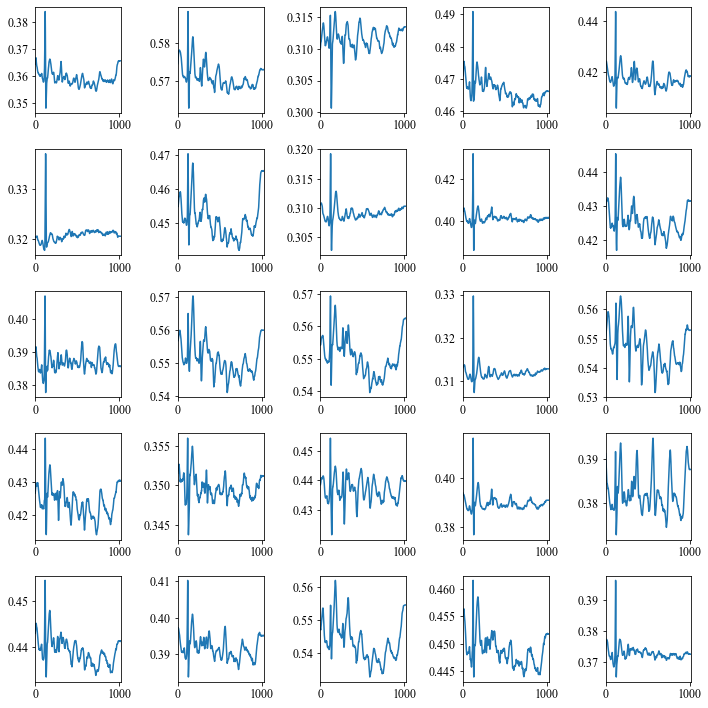

Epoch  1411 / 2000
 3525 / 3525 - loss: 7.614497e-05 - Duration: 85 sec - ETA: 13 hour 51 min 20 sec
Epoch  1412 / 2000
 3525 / 3525 - loss: 7.613222e-05 - Duration: 85 sec - ETA: 13 hour 49 min 56 sec
Epoch  1413 / 2000
 3525 / 3525 - loss: 7.623116e-05 - Duration: 85 sec - ETA: 13 hour 48 min 32 sec
Epoch  1414 / 2000
 3525 / 3525 - loss: 7.570774e-05 - Duration: 85 sec - ETA: 13 hour 47 min 7 sec
Epoch  1415 / 2000
 3525 / 3525 - loss: 7.571382e-05 - Duration: 85 sec - ETA: 13 hour 45 min 43 sec
Epoch  1416 / 2000
 3525 / 3525 - loss: 7.509084e-05 - Duration: 86 sec - ETA: 13 hour 44 min 19 sec
Epoch  1417 / 2000
 3525 / 3525 - loss: 7.798449e-05 - Duration: 88 sec - ETA: 13 hour 42 min 56 sec
Epoch  1418 / 2000
 3525 / 3525 - loss: 7.500461e-05 - Duration: 88 sec - ETA: 13 hour 41 min 32 sec
Epoch  1419 / 2000
 3525 / 3525 - loss: 7.700008e-05 - Duration: 87 sec - ETA: 13 hour 40 min 9 sec
Epoch  1420 / 2000
 3525 / 3525 - loss: 7.500433e-05 - Duration: 86 sec - ETA: 13 hour 38 min

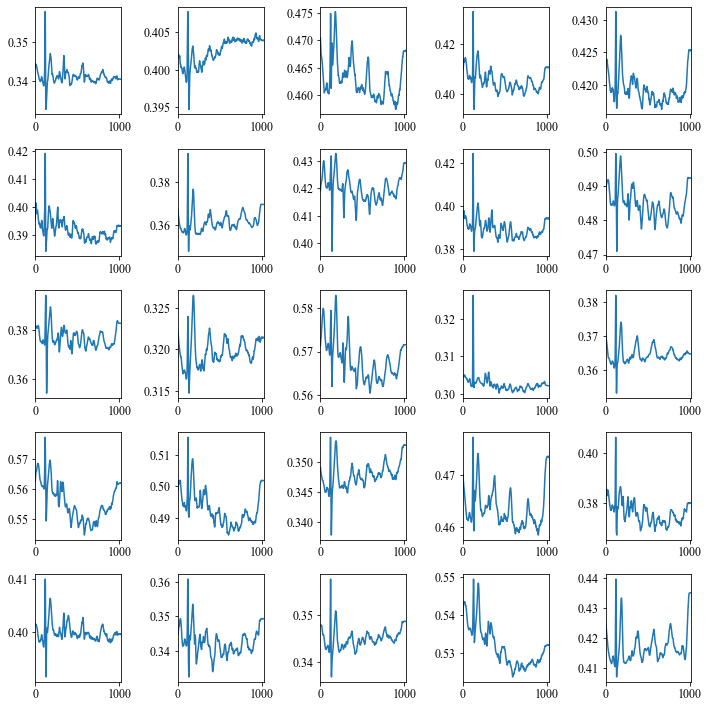

Epoch  1421 / 2000
 3525 / 3525 - loss: 7.547723e-05 - Duration: 86 sec - ETA: 13 hour 37 min 21 sec
Epoch  1422 / 2000
 3525 / 3525 - loss: 7.598805e-05 - Duration: 88 sec - ETA: 13 hour 35 min 58 sec
Epoch  1423 / 2000
 3525 / 3525 - loss: 7.733356e-05 - Duration: 89 sec - ETA: 13 hour 34 min 35 sec
Epoch  1424 / 2000
 3525 / 3525 - loss: 7.527149e-05 - Duration: 96 sec - ETA: 13 hour 33 min 15 sec
Epoch  1425 / 2000
 3525 / 3525 - loss: 7.626057e-05 - Duration: 87 sec - ETA: 13 hour 31 min 51 sec
Epoch  1426 / 2000
 3525 / 3525 - loss: 7.670702e-05 - Duration: 86 sec - ETA: 13 hour 30 min 27 sec
Epoch  1427 / 2000
 3525 / 3525 - loss: 7.637458e-05 - Duration: 92 sec - ETA: 13 hour 29 min 6 sec
Epoch  1428 / 2000
 3525 / 3525 - loss: 7.553563e-05 - Duration: 94 sec - ETA: 13 hour 27 min 45 sec
Epoch  1429 / 2000
 3525 / 3525 - loss: 7.665816e-05 - Duration: 92 sec - ETA: 13 hour 26 min 23 sec
Epoch  1430 / 2000
 3525 / 3525 - loss: 7.615780e-05 - Duration: 92 sec - ETA: 13 hour 25 mi

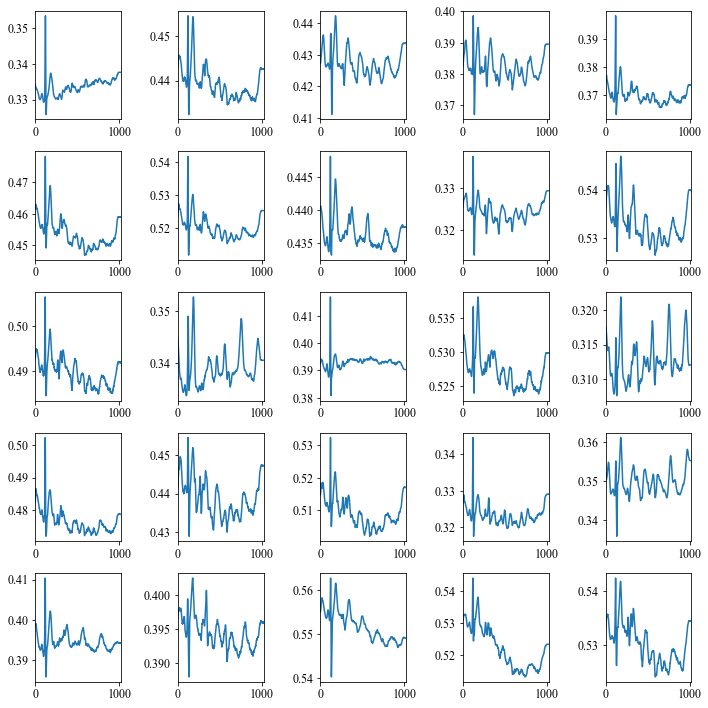

Epoch  1431 / 2000
 3525 / 3525 - loss: 7.630043e-05 - Duration: 88 sec - ETA: 13 hour 23 min 38 sec
Epoch  1432 / 2000
 3525 / 3525 - loss: 7.631561e-05 - Duration: 89 sec - ETA: 13 hour 22 min 16 sec
Epoch  1433 / 2000
 3525 / 3525 - loss: 7.763634e-05 - Duration: 88 sec - ETA: 13 hour 20 min 52 sec
Epoch  1434 / 2000
 3525 / 3525 - loss: 7.583708e-05 - Duration: 88 sec - ETA: 13 hour 19 min 29 sec
Epoch  1435 / 2000
 3525 / 3525 - loss: 7.619080e-05 - Duration: 90 sec - ETA: 13 hour 18 min 7 sec
Epoch  1436 / 2000
 3525 / 3525 - loss: 7.636802e-05 - Duration: 87 sec - ETA: 13 hour 16 min 43 sec
Epoch  1437 / 2000
 3525 / 3525 - loss: 7.561634e-05 - Duration: 90 sec - ETA: 13 hour 15 min 20 sec
Epoch  1438 / 2000
 3525 / 3525 - loss: 7.659488e-05 - Duration: 92 sec - ETA: 13 hour 13 min 59 sec
Epoch  1439 / 2000
 3525 / 3525 - loss: 7.575888e-05 - Duration: 94 sec - ETA: 13 hour 12 min 38 sec
Epoch  1440 / 2000
 3525 / 3525 - loss: 7.536925e-05 - Duration: 92 sec - ETA: 13 hour 11 mi

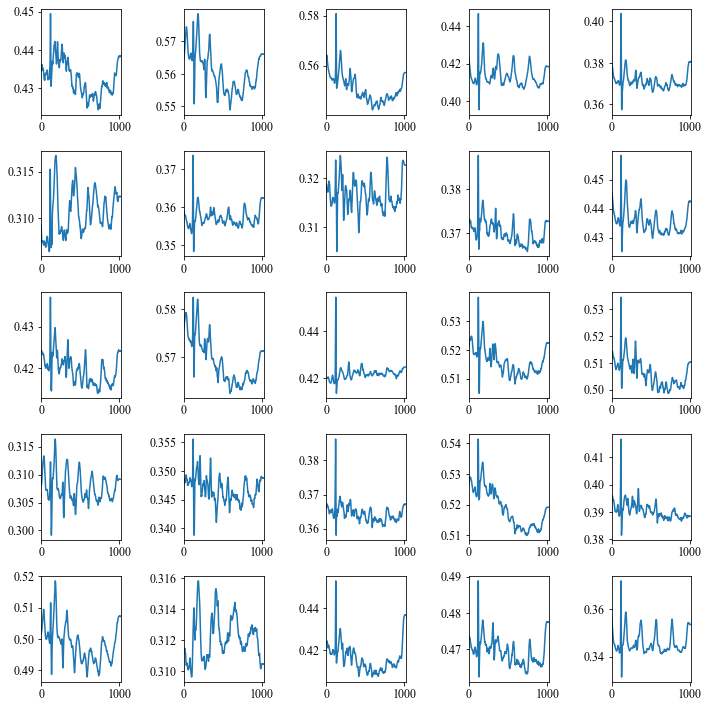

Epoch  1441 / 2000
 3525 / 3525 - loss: 7.533235e-05 - Duration: 92 sec - ETA: 13 hour 9 min 54 sec
Epoch  1442 / 2000
 3525 / 3525 - loss: 7.560106e-05 - Duration: 91 sec - ETA: 13 hour 8 min 32 sec
Epoch  1443 / 2000
 3525 / 3525 - loss: 7.599087e-05 - Duration: 87 sec - ETA: 13 hour 7 min 8 sec
Epoch  1444 / 2000
 3525 / 3525 - loss: 7.569365e-05 - Duration: 85 sec - ETA: 13 hour 5 min 44 sec
Epoch  1445 / 2000
 3525 / 3525 - loss: 7.702456e-05 - Duration: 87 sec - ETA: 13 hour 4 min 20 sec
Epoch  1446 / 2000
 3525 / 3525 - loss: 7.583895e-05 - Duration: 86 sec - ETA: 13 hour 2 min 56 sec
Epoch  1447 / 2000
 3525 / 3525 - loss: 7.585114e-05 - Duration: 85 sec - ETA: 13 hour 1 min 31 sec
Epoch  1448 / 2000
 3525 / 3525 - loss: 7.560355e-05 - Duration: 85 sec - ETA: 13 hour 0 min 6 sec
Epoch  1449 / 2000
 3525 / 3525 - loss: 7.539909e-05 - Duration: 91 sec - ETA: 12 hour 58 min 44 sec
Epoch  1450 / 2000
 3525 / 3525 - loss: 7.592091e-05 - Duration: 95 sec - ETA: 12 hour 57 min 23 sec


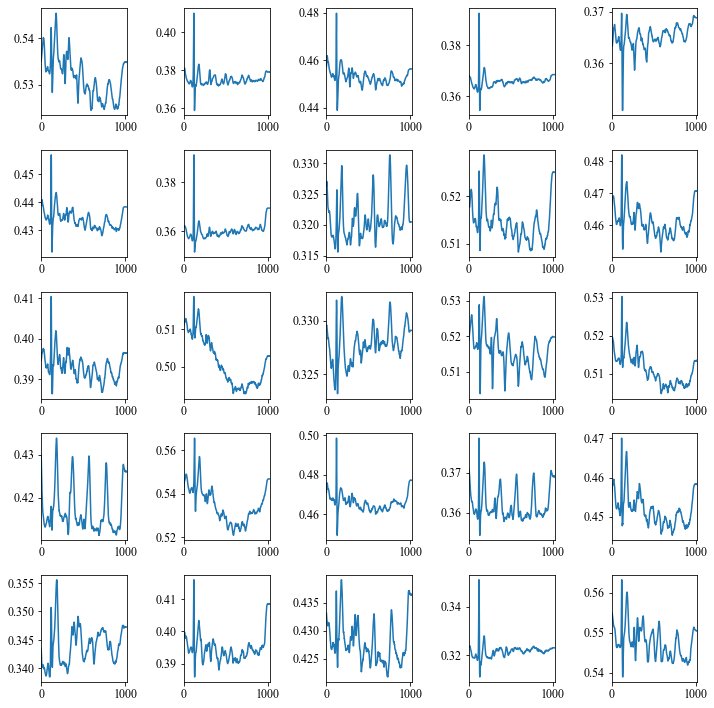

Epoch  1451 / 2000
 3525 / 3525 - loss: 7.504171e-05 - Duration: 94 sec - ETA: 12 hour 56 min 2 sec
Epoch  1452 / 2000
 3525 / 3525 - loss: 7.516638e-05 - Duration: 89 sec - ETA: 12 hour 54 min 39 sec
Epoch  1453 / 2000
 3525 / 3525 - loss: 7.601098e-05 - Duration: 90 sec - ETA: 12 hour 53 min 16 sec
Epoch  1454 / 2000
 3525 / 3525 - loss: 7.534999e-05 - Duration: 88 sec - ETA: 12 hour 51 min 53 sec
Epoch  1455 / 2000
 3525 / 3525 - loss: 7.538318e-05 - Duration: 90 sec - ETA: 12 hour 50 min 30 sec
Epoch  1456 / 2000
 3525 / 3525 - loss: 7.442941e-05 - Duration: 88 sec - ETA: 12 hour 49 min 7 sec
Epoch  1457 / 2000
 3525 / 3525 - loss: 7.591765e-05 - Duration: 92 sec - ETA: 12 hour 47 min 45 sec
Epoch  1458 / 2000
 3525 / 3525 - loss: 7.520755e-05 - Duration: 93 sec - ETA: 12 hour 46 min 23 sec
Epoch  1459 / 2000
 3525 / 3525 - loss: 7.547409e-05 - Duration: 91 sec - ETA: 12 hour 45 min 1 sec
Epoch  1460 / 2000
 3525 / 3525 - loss: 7.434990e-05 - Duration: 92 sec - ETA: 12 hour 43 min 

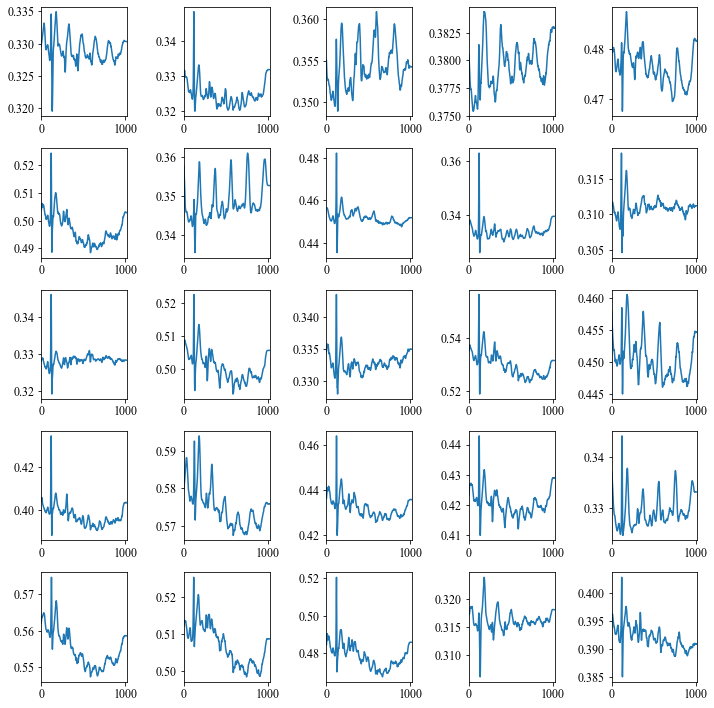

Epoch  1461 / 2000
 3525 / 3525 - loss: 7.537406e-05 - Duration: 90 sec - ETA: 12 hour 42 min 16 sec
Epoch  1462 / 2000
 3525 / 3525 - loss: 7.529377e-05 - Duration: 87 sec - ETA: 12 hour 40 min 52 sec
Epoch  1463 / 2000
 3525 / 3525 - loss: 7.507456e-05 - Duration: 89 sec - ETA: 12 hour 39 min 29 sec
Epoch  1464 / 2000
 3525 / 3525 - loss: 7.631873e-05 - Duration: 87 sec - ETA: 12 hour 38 min 5 sec
Epoch  1465 / 2000
 3525 / 3525 - loss: 7.517734e-05 - Duration: 87 sec - ETA: 12 hour 36 min 41 sec
Epoch  1466 / 2000
 3525 / 3525 - loss: 7.553253e-05 - Duration: 86 sec - ETA: 12 hour 35 min 17 sec
Epoch  1467 / 2000
 3525 / 3525 - loss: 7.529090e-05 - Duration: 84 sec - ETA: 12 hour 33 min 52 sec
Epoch  1468 / 2000
 3525 / 3525 - loss: 7.417362e-05 - Duration: 83 sec - ETA: 12 hour 32 min 27 sec
Epoch  1469 / 2000
 3525 / 3525 - loss: 7.330202e-05 - Duration: 83 sec - ETA: 12 hour 31 min 2 sec
Epoch  1470 / 2000
 3525 / 3525 - loss: 7.582238e-05 - Duration: 84 sec - ETA: 12 hour 29 min

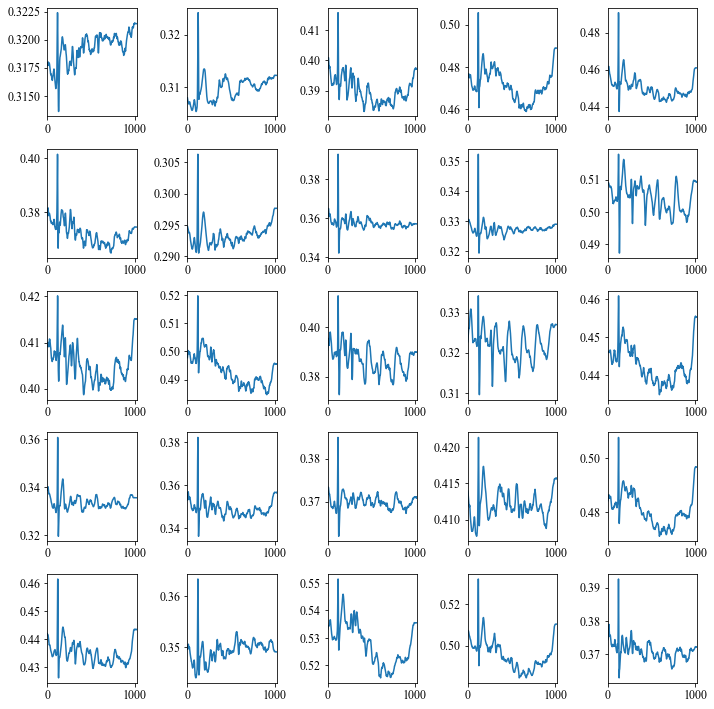

Epoch  1471 / 2000
 3525 / 3525 - loss: 7.687936e-05 - Duration: 83 sec - ETA: 12 hour 28 min 11 sec
Epoch  1472 / 2000
 3525 / 3525 - loss: 7.429540e-05 - Duration: 82 sec - ETA: 12 hour 26 min 45 sec
Epoch  1473 / 2000
 3525 / 3525 - loss: 7.558142e-05 - Duration: 82 sec - ETA: 12 hour 25 min 20 sec
Epoch  1474 / 2000
 3525 / 3525 - loss: 7.532336e-05 - Duration: 83 sec - ETA: 12 hour 23 min 54 sec
Epoch  1475 / 2000
 3525 / 3525 - loss: 7.570799e-05 - Duration: 82 sec - ETA: 12 hour 22 min 28 sec
Epoch  1476 / 2000
 3525 / 3525 - loss: 7.589696e-05 - Duration: 82 sec - ETA: 12 hour 21 min 3 sec
Epoch  1477 / 2000
 3525 / 3525 - loss: 7.502250e-05 - Duration: 82 sec - ETA: 12 hour 19 min 37 sec
Epoch  1478 / 2000
 3525 / 3525 - loss: 7.426894e-05 - Duration: 82 sec - ETA: 12 hour 18 min 11 sec
Epoch  1479 / 2000
 3525 / 3525 - loss: 7.450799e-05 - Duration: 82 sec - ETA: 12 hour 16 min 46 sec
Epoch  1480 / 2000
 3525 / 3525 - loss: 7.459945e-05 - Duration: 82 sec - ETA: 12 hour 15 mi

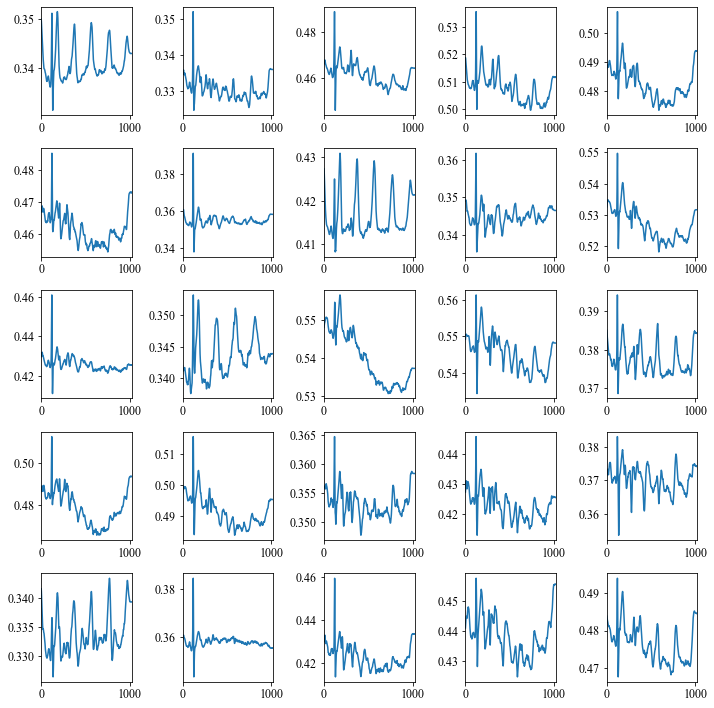

Epoch  1481 / 2000
 3525 / 3525 - loss: 7.629191e-05 - Duration: 82 sec - ETA: 12 hour 13 min 54 sec
Epoch  1482 / 2000
 3525 / 3525 - loss: 7.492810e-05 - Duration: 82 sec - ETA: 12 hour 12 min 28 sec
Epoch  1483 / 2000
 3525 / 3525 - loss: 7.392040e-05 - Duration: 82 sec - ETA: 12 hour 11 min 3 sec
Epoch  1484 / 2000
 3525 / 3525 - loss: 7.431636e-05 - Duration: 82 sec - ETA: 12 hour 9 min 37 sec
Epoch  1485 / 2000
 3525 / 3525 - loss: 7.397710e-05 - Duration: 82 sec - ETA: 12 hour 8 min 11 sec
Epoch  1486 / 2000
 3525 / 3525 - loss: 7.535582e-05 - Duration: 82 sec - ETA: 12 hour 6 min 45 sec
Epoch  1487 / 2000
 3525 / 3525 - loss: 7.460802e-05 - Duration: 82 sec - ETA: 12 hour 5 min 20 sec
Epoch  1488 / 2000
 3525 / 3525 - loss: 7.453375e-05 - Duration: 82 sec - ETA: 12 hour 3 min 54 sec
Epoch  1489 / 2000
 3525 / 3525 - loss: 7.503269e-05 - Duration: 82 sec - ETA: 12 hour 2 min 28 sec
Epoch  1490 / 2000
 3525 / 3525 - loss: 7.279562e-05 - Duration: 82 sec - ETA: 12 hour 1 min 3 sec

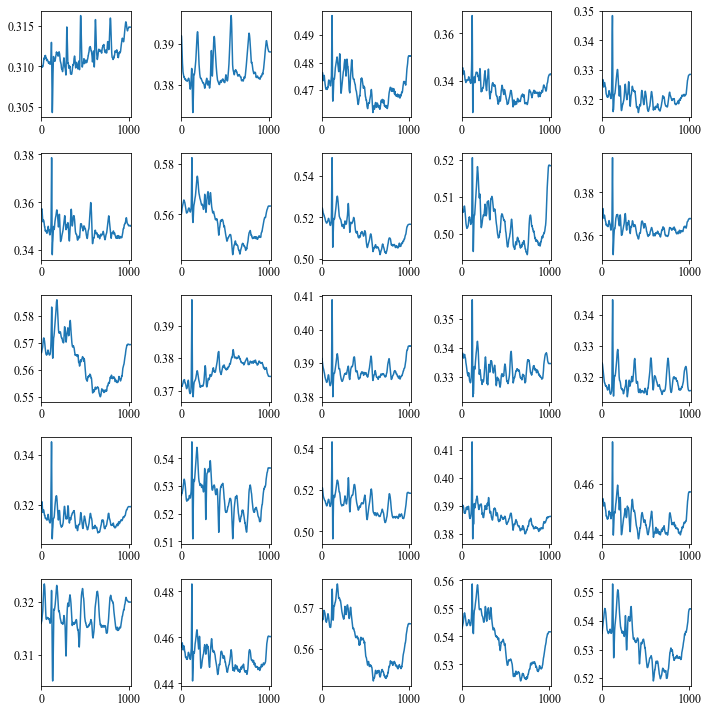

Epoch  1491 / 2000
 3525 / 3525 - loss: 7.435841e-05 - Duration: 82 sec - ETA: 11 hour 59 min 37 sec
Epoch  1492 / 2000
 3525 / 3525 - loss: 7.315060e-05 - Duration: 82 sec - ETA: 11 hour 58 min 11 sec
Epoch  1493 / 2000
 3525 / 3525 - loss: 7.473454e-05 - Duration: 82 sec - ETA: 11 hour 56 min 46 sec
Epoch  1494 / 2000
 3525 / 3525 - loss: 7.390210e-05 - Duration: 82 sec - ETA: 11 hour 55 min 20 sec
Epoch  1495 / 2000
 3525 / 3525 - loss: 7.478176e-05 - Duration: 82 sec - ETA: 11 hour 53 min 54 sec
Epoch  1496 / 2000
 3525 / 3525 - loss: 7.571681e-05 - Duration: 82 sec - ETA: 11 hour 52 min 29 sec
Epoch  1497 / 2000
 3525 / 3525 - loss: 7.475109e-05 - Duration: 82 sec - ETA: 11 hour 51 min 3 sec
Epoch  1498 / 2000
 3525 / 3525 - loss: 7.501004e-05 - Duration: 82 sec - ETA: 11 hour 49 min 37 sec
Epoch  1499 / 2000
 3525 / 3525 - loss: 7.318004e-05 - Duration: 82 sec - ETA: 11 hour 48 min 12 sec
Epoch  1500 / 2000
 3525 / 3525 - loss: 7.473141e-05 - Duration: 82 sec - ETA: 11 hour 46 mi

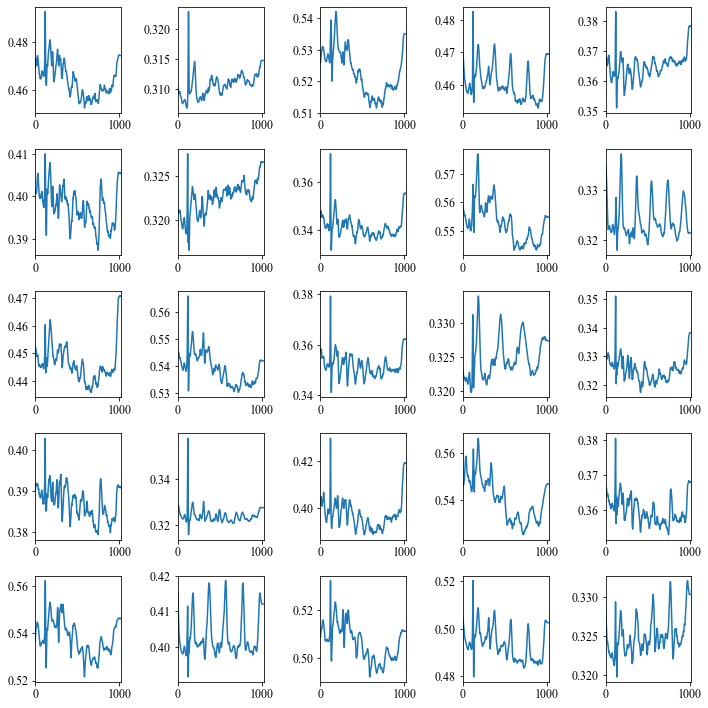

Epoch  1501 / 2000
 3525 / 3525 - loss: 7.451055e-05 - Duration: 82 sec - ETA: 11 hour 45 min 20 sec
Epoch  1502 / 2000
 3525 / 3525 - loss: 7.391381e-05 - Duration: 82 sec - ETA: 11 hour 43 min 55 sec
Epoch  1503 / 2000
 3525 / 3525 - loss: 7.404613e-05 - Duration: 82 sec - ETA: 11 hour 42 min 29 sec
Epoch  1504 / 2000
 3525 / 3525 - loss: 7.428369e-05 - Duration: 82 sec - ETA: 11 hour 41 min 4 sec
Epoch  1505 / 2000
 3525 / 3525 - loss: 7.465017e-05 - Duration: 82 sec - ETA: 11 hour 39 min 38 sec
Epoch  1506 / 2000
 3525 / 3525 - loss: 7.482985e-05 - Duration: 82 sec - ETA: 11 hour 38 min 12 sec
Epoch  1507 / 2000
 3525 / 3525 - loss: 7.384018e-05 - Duration: 82 sec - ETA: 11 hour 36 min 47 sec
Epoch  1508 / 2000
 3525 / 3525 - loss: 7.282041e-05 - Duration: 82 sec - ETA: 11 hour 35 min 21 sec
Epoch  1509 / 2000
 3525 / 3525 - loss: 7.606502e-05 - Duration: 82 sec - ETA: 11 hour 33 min 56 sec
Epoch  1510 / 2000
 3525 / 3525 - loss: 7.352935e-05 - Duration: 82 sec - ETA: 11 hour 32 mi

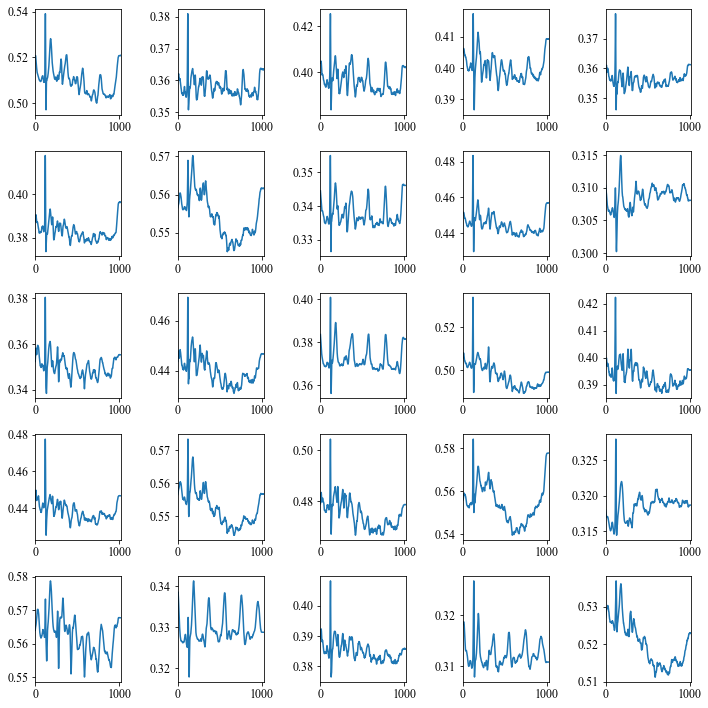

Epoch  1511 / 2000
 3525 / 3525 - loss: 7.412063e-05 - Duration: 82 sec - ETA: 11 hour 31 min 4 sec
Epoch  1512 / 2000
 3525 / 3525 - loss: 7.616371e-05 - Duration: 82 sec - ETA: 11 hour 29 min 39 sec
Epoch  1513 / 2000
 3525 / 3525 - loss: 7.355336e-05 - Duration: 82 sec - ETA: 11 hour 28 min 13 sec
Epoch  1514 / 2000


In [ ]:
optimizer = torch.optim.Adam(vae.parameters(), lr=learningRate)

trainLosses = []
valLosses   = []
sumDuration = 0
for epoch in range(1, epochs + 1):
    startTime = time.time()
    print('Epoch {:5d} / {}'.format(epoch, epochs))
    
    trainLoss = fit(vae, optimizer, trainLoader, True)
    trainLosses.append(trainLoss)
    if device == 'cuda':
        torch.cuda.empty_cache()
    
    endTime      = time.time()
    sumDuration += endTime - startTime
    remainSec    = int(sumDuration / epoch * (epochs - epoch))
    print('- Duration: {} sec - ETA: {} hour {} min {} sec'.format(int(endTime - startTime), remainSec // 3600, (remainSec % 3600) // 60, remainSec % 60))
    
    if epoch % 10 == 0:
        drawResult(vae, 'Epoch{:04d}'.format(epoch))
        
torch.save(vae.state_dict(), resultFolder + '/vae')

In [ ]:
plt.figure(figsize=(8, 6))
plt.plot(trainLosses)
plt.title('Loss',   fontsize=titleFontSize)
plt.ylabel('Loss',  fontsize=axisFontSize)
plt.xlabel('Epoch', fontsize=axisFontSize)
plt.xlim(0, len(trainLosses)-1)
plt.savefig(resultFolder + '/generatorLosses.png', dpi=200)
plt.show()

In [ ]:
drawResult(vae)

In [ ]:
plt.figure(figsize=(10, 10))
minimum = poisonedData[:25].min()
maximum = poisonedData[:25].max()
for i in range(1, 26):
    plt.subplot(5, 5, i)
    plt.plot(poisonedData[i])
    plt.xlim(0, poisonedData.shape[1]-1)
    plt.ylim(minimum, maximum)
plt.tight_layout()
plt.savefig(resultFolder + '/original.png', dpi=200)
plt.show()

In [ ]:
vae.eval()
with torch.no_grad():
    testData = torch.tensor(poisonedData[:5], dtype=torch.float).to(device)
    reconstruct, _, _ = vae(testData)
    reconstruct = reconstruct.squeeze().to('cpu').numpy()

plt.figure(figsize=(16, 6))
for i in range(5):
    yMin = min(min(poisonedData[i]), min(reconstruct[i]))
    yMax = max(max(poisonedData[i]), max(reconstruct[i]))
    
    plt.subplot(2, 5, i+1)
    plt.plot(poisonedData[i])
    plt.xlim(0, len(poisonedData[i])-1)
    plt.ylim(yMin, yMax)
    
    plt.subplot(2, 5, i+6)
    plt.plot(reconstruct[i])
    plt.xlim(0, len(poisonedData[i])-1)
    plt.ylim(yMin, yMax)

plt.tight_layout()
plt.savefig(resultFolder + '/reconstruct.png', dpi=200)
plt.show()

In [ ]:
# Draw the distribution of original data by t-SNE
testData   = np.array(poisonedData[:10000])
tsne       = TSNE(n_components=2)
testData2D = np.array(tsne.fit_transform(testData))
plt.figure(figsize=(10, 10))
plt.scatter(testData2D[:, 0], testData2D[:, 1])
plt.title('Distribution of Original Data', fontsize=titleFontSize)
plt.savefig(resultFolder + '/originDistribution.png', dpi=200)
plt.show()

# Get the latent vector of the testData
with torch.no_grad():
    testData     = torch.tensor(testData, dtype=torch.float).to(device)
    mean, logVar = vae.encode(testData)
    z            = vae.reparameterize(mean, logVar)

# Draw the distribution of latent vector by t-SNE
tsne = TSNE(n_components=2)
z2D  = np.array(tsne.fit_transform(z.squeeze().to('cpu').numpy()))
plt.figure(figsize=(10, 10))
plt.scatter(z2D[:, 0], z2D[:, 1])
plt.title('Distribution of Latent Vector', fontsize=titleFontSize)
plt.savefig(resultFolder + '/latentDistribution.png', dpi=200)
plt.show()